In [1]:
import time
import torch
import json
import warnings
import torchvision
import os
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import torchvision.models as models

from pathlib import Path
from tqdm import tqdm
from PIL import Image
from sklearn import metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report, precision_recall_fscore_support
from torch.utils.data import Dataset, DataLoader
from torchvision.models import EfficientNet
from utils.loss_functions import tkd_kdloss
from utils.loss_functions import tkd_kdloss, DD_loss, AD_loss, RKDDistanceLoss, RKDAngleLoss
from torch.optim import lr_scheduler

# Suppress all warnings
warnings.filterwarnings("ignore")

In [2]:
# Hyperparameters / Inputs
teacher_learning_rate = 0.001 # 0.096779
student_learning_rate = teacher_learning_rate
teacher_epochs = 200
student_epochs = teacher_epochs
teacher_patience = 2
student_patience = 10
temperature = 4.0
alpha = 0.9
momentum = 0.9
batch_size = 64
num_workers = 4
weight_decay = 1e-5
epsilon = 0.05
margin = 0.01
num_classes = 16
base_save_dir = "Test_Dir2"

# list of lambda values to loop through for grid search
teacher_lambda_factor_list = [0]
student_lambda_factor_list = [180,160,140,120,100,80,60,40,20,0]

In [3]:
# labels used including for plotting
class_labels = [0, 1, 3, 4, 6, 7, 11, 15, 17, 18, 19, 20, 22, 25, 27, 28, 30, 31, 33, 35, 36, 37, 39, 43, 44, 50, 51, 54, 57, 58]
class_labels_new = torch.tensor([i for i in range(len(class_labels))])
class_names_new = [f"Class {label}" for label in range(num_classes)]


In [4]:
# set device to cuda if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [5]:
file_path = './WIDER/Annotations/wider_attribute_trainval.json'

with open(file_path, 'r') as file:
    # Load the JSON data from the file
    data = json.load(file)

class_idx = data['scene_id_map']

In [6]:
new_label_mapping = {
    0: "Team_Sports",
    1: "Celebration",
    2: "Parade",
    3: "Waiter_Or_Waitress",
    4: "Individual_Sports",
    5: "Surgeons",
    6: "Spa",
    7: "Law_Enforcement",
    8: "Business",
    9: "Dresses",
    10: "Water_Activities",
    11: "Picnic",
    12: "Rescue",
    13: "Cheering",
    14: "Performance_And_Entertainment",
    15: "Family"
}

# Ensure that all 16 new classes are covered
# If some classes are not explicitly mentioned in new_label_mapping, add them
for i in range(num_classes):
    if i not in new_label_mapping:
        new_label_mapping[i] = "Additional Category {}".format(i)

class_idx = new_label_mapping

In [7]:
class DataSet(Dataset):
    def __init__(self, ann_files, augs, img_size, dataset):

        # Create a mapping from old labels to new labels
        self.label_mapping = {old_label: new_label for new_label, old_label in enumerate(sorted(class_labels))}

        self.new_label_mapping = {
            0: 2,  # Parade
            1: 8,  # Business
            2: 7,  # Law Enforcement
            3: 14,  # Performance and Entertainment
            4: 1,  # Celebration
            5: 13,  # Cheering
            6: 8,  # Business
            7: 8,  # Business
            8: 1,  # Celebration
            9: 14,  # Performance and Entertainment
            10: 15, # Family
            11: 15, # Family
            12: 11, # Picnic
            13: 7, # Law Enforcement
            14: 6, # Spa
            15: 13, # Cheering
            16: 5, # Surgeons
            17: 3, # Waiter or Waitress
            18: 4, # Individual Sports
            19: 0, # Team Sports
            20: 0, # Team Sports
            21: 0, # Team Sports
            22: 4, # Individual Sports
            23: 10, # Water Activities
            24: 4, # Individual Sports
            25: 1, # Celebration
            26: 9, # Dresses
            27: 12, # Rescue
            28: 10,# Water Activities
            29: 0  # Team Sports
        }

        self.dataset = dataset
        self.ann_files = ann_files
        self.augment = self.augs_function(augs, img_size)
        # Initialize transformations directly
        self.transform = transforms.Compose(
            [
                transforms.ToTensor(),
                transforms.Normalize(mean=[0, 0, 0], std=[1, 1, 1])
            ] 
        )
        if self.dataset == "wider":
            self.transform = transforms.Compose(
                [
                    transforms.ToTensor(),
                    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])                ] 
            )        

        self.anns = []
        self.load_anns()
        print(self.augment)

    def augs_function(self, augs, img_size):            
        t = []
        if 'randomflip' in augs:
            t.append(transforms.RandomHorizontalFlip())
        if 'ColorJitter' in augs:
            t.append(transforms.ColorJitter(brightness=0.5, contrast=0.5, saturation=0.5, hue=0))
        if 'resizedcrop' in augs:
            t.append(transforms.RandomResizedCrop(img_size, scale=(0.7, 1.0)))
        if 'RandAugment' in augs:
            t.append(transforms.RandAugment())

        t.append(transforms.Resize((img_size, img_size)))

        return transforms.Compose(t)
    
    def load_anns(self):
        self.anns = []
        for ann_file in self.ann_files:
            json_data = json.load(open(ann_file, "r"))
            self.anns += json_data

    def __len__(self):
        return len(self.anns)

    def __getitem__(self, idx):
        # Make sure the index is within bounds
        idx = idx % len(self)
        ann = self.anns[idx]
        
        try:
            # Attempt to open the image file
            img = Image.open(f'WIDER/Image/{ann["file_name"]}').convert("RGB")

            # If this is the wider dataset, proceed with specific processing
            # x, y, w, h = ann['bbox']
            # img_area = img.crop([x, y, x+w, y+h])
            img_area = self.augment(img)
            img_area = self.transform(img_area)
            attributes_list = [target['attribute'] for target in ann['targets']]
            num_people = len(attributes_list)
            attributes_distribution = [max(sum(attribute), 0)/num_people for attribute in zip(*attributes_list)]
            # Extract label from image path
            img_path = f'WIDER/Image/{ann["file_name"]}'
            label = self.extract_label(img_path)  # You might need to implement this method
            
            return {
                "label": label,
                "target": torch.tensor([attributes_distribution[0]], dtype=torch.float32),
                "img": img_area
            }
            
        except Exception as e:
            # If any error occurs during the processing of an image, log the error and the index
            print(f"Error processing image at index {idx}: {e}")
            # Instead of returning None, raise the exception
            raise

    def extract_label(self, img_path):
        original_label = None
    
        if "WIDER/Image/train" in img_path:
            label_str = img_path.split("WIDER/Image/train/")[1].split("/")[0]
            original_label = int(label_str.split("--")[0])
        elif "WIDER/Image/test" in img_path:
            label_str = img_path.split("WIDER/Image/test/")[1].split("/")[0]
            original_label = int(label_str.split("--")[0])
        elif "WIDER/Image/val" in img_path:  # Handle validation images
            label_str = img_path.split("WIDER/Image/val/")[1].split("/")[0]
            original_label = int(label_str.split("--")[0])
    
        if original_label is not None:
            remapped_label = self.label_mapping[original_label]
            new_label_mapping = self.new_label_mapping[remapped_label]
            return new_label_mapping
        else:
            raise ValueError(f"Label could not be extracted from path: {img_path}")


In [8]:
train_file = ['data/wider/trainval_wider.json']
test_file = ['data/wider/test_wider.json']


In [9]:
def custom_collate(batch):
    # Filter out any None items in the batch
    batch = [item for item in batch if item is not None]
    # If after filtering the batch is empty, handle this case by either returning an empty tensor or raising an exception
    if len(batch) == 0:
        raise ValueError("Batch is empty after filtering out None items.")
    return torch.utils.data.dataloader.default_collate(batch)


In [10]:
# train_dataset = DataSet(train_file, augs = ['RandAugment'], img_size = 226, dataset = 'wider')
train_dataset = DataSet(train_file, augs = [], img_size = 226, dataset = 'wider')
test_dataset = DataSet(test_file, augs = [], img_size = 226, dataset = 'wider')

trainloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, 
                         num_workers=num_workers, collate_fn=custom_collate)
testloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers, collate_fn=custom_collate)


Compose(
    Resize(size=(226, 226), interpolation=bilinear, max_size=None, antialias=warn)
)
Compose(
    Resize(size=(226, 226), interpolation=bilinear, max_size=None, antialias=warn)
)


In [11]:
def one_hot_encode(labels, num_classes):
    return np.eye(num_classes)[labels]

def calculate_recall_multiclass(conf_matrix):
    recalls = np.diag(conf_matrix) / np.sum(conf_matrix, axis=1)
    recalls[np.isnan(recalls)] = 0
    return recalls

def evaluate_model_with_gender_multiclass(pred, label, gender, num_classes):
    predictions = pred.cpu()
    true_labels = label.cpu()
    gender = gender.cpu()

    # Identify male and female indices based on the gender threshold
    male_indices = np.where(gender >= 0.5)[0]
    female_indices = np.where(gender < 0.5)[0]

    # Convert labels to one-hot encoding
    one_hot_labels = one_hot_encode(true_labels, num_classes=num_classes)
    one_hot_preds = one_hot_encode(predictions, num_classes=num_classes)

    # Initialize recall arrays
    male_recall = np.zeros(num_classes)
    female_recall = np.zeros(num_classes)

    # Extract predictions and labels for male and female indices
    male_predictions = np.argmax(one_hot_preds[male_indices], axis=1)
    female_predictions = np.argmax(one_hot_preds[female_indices], axis=1)
    male_labels = np.argmax(one_hot_labels[male_indices], axis=1)
    female_labels = np.argmax(one_hot_labels[female_indices], axis=1)

    # Check if the class labels are within the expected range
    assert (0 <= male_predictions.min() < num_classes) and (0 <= male_predictions.max() < num_classes), "Invalid class indices in male predictions"
    assert (0 <= female_predictions.min() < num_classes) and (0 <= female_predictions.max() < num_classes), "Invalid class indices in female predictions"
    assert (0 <= male_labels.min() < num_classes) and (0 <= male_labels.max() < num_classes), "Invalid class indices in male labels"
    assert (0 <= female_labels.min() < num_classes) and (0 <= female_labels.max() < num_classes), "Invalid class indices in female labels"

    # Calculate confusion matrices for each gender
    male_conf_matrix = confusion_matrix(male_labels, male_predictions, labels=np.arange(num_classes))
    female_conf_matrix = confusion_matrix(female_labels, female_predictions, labels=np.arange(num_classes))

    # Calculate recall for each class and gender
    male_recall[:len(male_conf_matrix)] = calculate_recall_multiclass(male_conf_matrix)
    female_recall[:len(female_conf_matrix)] = calculate_recall_multiclass(female_conf_matrix)

    return male_recall - female_recall, male_conf_matrix, female_conf_matrix


In [12]:
class Critic(nn.Module):
    def __init__(self, input_size, hidden_size=256):
        super(Critic, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.fc2 = nn.Linear(hidden_size, 1)  # Outputting a single value for bias

    def forward(self, x):
        x = F.relu(self.fc1(x))
        x = torch.sigmoid(self.fc2(x))
        return x
        

In [13]:
def train_teacher(teacher, teacher_optimizer, teacher_loss_fn, patience=teacher_patience, 
                  epochs=teacher_epochs, device=device, base_save_dir=base_save_dir):
    
    train_accuracies = []
    train_disparities = []
    train_mean_non_zero_abs_disparities = []
    train_losses = []
    train_main_losses = []
    val_accuracies = []
    val_disparities = []
    val_mean_non_zero_abs_disparities = []
    val_losses = []
    val_main_losses = []
    
    patience_counter = 0 
    best_val_accuracy = 0
    best_val_loss = float('inf')
    best_val_mean_abs_disparity = 0
    teacher_best_model_state = None

    # Create a subdirectory for the current lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lambda_factor}')
    os.makedirs(lambda_dir, exist_ok=True)

    print(f'Training Teacher with Lambda Value of {lambda_factor}')
    
    # Training and Validation Loop
    for epoch in range(epochs):
        # Initialize metrics for each epoch
        epoch_train_disparities = []
        epoch_train_losses = []
        epoch_train_accuracies = []
        epoch_val_disparities = []
        epoch_val_losses = []
        epoch_val_accuracies = []
    
        confusion_male = np.zeros((num_classes, num_classes))
        confusion_female = np.zeros((num_classes, num_classes))
        total_correct = 0
        total_samples = 0
        total_val_loss = 0.0
        num_batches = 0
        
        # Training
        for batch_data in tqdm(trainloader, desc=f'Epoch {epoch+1}/{epochs}, Training'):
            # Load data to device
            teacher.train()
            teacher.to(device)
            images = batch_data["img"].to(device)
            labels = batch_data["label"].to(device)
            gender_scores = batch_data["target"].to(device)
    
            teacher_optimizer.zero_grad()            
            # Forward pass through actor
            teacher_output = teacher(images)
    
            main_loss = teacher_loss_fn(teacher_output, labels)
            class_predictions = torch.argmax(teacher_output, dim=1)

            main_loss.backward()
            teacher_optimizer.step()
    
            # Calculate and accumulate metrics
            accuracy = (class_predictions == labels).float().mean().item()
            epoch_train_accuracies.append(accuracy)
    
            total_samples += labels.size(0)
            total_correct += (class_predictions == labels).sum().item()
            num_batches += 1
            recall_diff = evaluate_model_with_gender_multiclass(class_predictions, labels, gender_scores, num_classes=num_classes)
            confusion_male += recall_diff[1]
            confusion_female += recall_diff[2]
            bias = np.mean(recall_diff[0])
            epoch_train_disparities.append(bias)        
            # Record the losses
            epoch_train_losses.append(main_loss.item())
    
        confusion_male /= num_batches
        confusion_female /= num_batches
    
        # Calculate training metrics for the epoch
        train_epoch_disparity = calculate_recall_multiclass(confusion_male) - calculate_recall_multiclass(confusion_female)
        train_non_zero_abs_values = np.abs(train_epoch_disparity[train_epoch_disparity != 0])
        
        # Store average training metrics for the epoch
        train_accuracy = np.mean(epoch_train_accuracies)
        train_disparity = np.mean(epoch_train_disparities)
        train_mean_non_zero_abs_disparity = np.mean(train_non_zero_abs_values)
        train_main_loss = np.mean([x for x in epoch_train_losses])
        train_accuracies.append(train_accuracy)
        train_disparities.append(train_disparity)
        train_mean_non_zero_abs_disparities.append(train_mean_non_zero_abs_disparity)
        train_main_losses.append(train_main_loss)

        # Validation Phase
        confusion_male = np.zeros((num_classes, num_classes))
        confusion_female = np.zeros((num_classes, num_classes))
        total_correct = 0
        total_samples = 0
        num_batches = 0
        
        teacher.eval()
        with torch.no_grad():
            for batch_data in tqdm(testloader, desc=f'Epoch {epoch+1}/{epochs}, Validation'):
                # Load data to device
                images = batch_data["img"].to(device)
                labels = batch_data["label"].to(device)
                gender_scores = batch_data["target"].to(device)
        
                # Forward pass
                teacher_output = teacher(images)
                class_predictions = torch.argmax(teacher_output, dim=1)
        
                # Calculate and accumulate validation metrics
                accuracy = (class_predictions == labels).float().mean().item()
    
                # Compute bias
                num_batches += 1
                recall_diff = evaluate_model_with_gender_multiclass(class_predictions, labels, gender_scores, num_classes=num_classes)
                confusion_male += recall_diff[1]
                confusion_female += recall_diff[2]
                
                # Calculate validation losses (similar to training losses)
                batch_bias = np.mean(recall_diff[0])
                val_main_loss = teacher_loss_fn(teacher_output, labels)
            
                epoch_val_accuracies.append(accuracy)
                epoch_val_losses.append(val_main_loss.item())
                
            confusion_male /= num_batches
            confusion_female /= num_batches
    
            val_epoch_disparity = calculate_recall_multiclass(confusion_male) - calculate_recall_multiclass(confusion_female)
            val_non_zero_abs_values = np.abs(val_epoch_disparity[val_epoch_disparity != 0])
    
            # Store average training metrics for the epoch
            val_accuracy = np.mean(epoch_val_accuracies)
            val_disparity = np.mean(epoch_val_disparities)
            val_mean_non_zero_abs_disparity = np.mean(val_non_zero_abs_values)
            val_main_loss = np.mean([x for x in epoch_val_losses])

        
            val_accuracies.append(val_accuracy)
            val_disparities.append(val_disparity)
            val_mean_non_zero_abs_disparities.append(val_mean_non_zero_abs_disparity)
            val_main_losses.append(val_main_loss)


            # Check if current validation combined loss is lower than the best combined loss
        if val_main_loss < best_val_loss:
            best_val_loss = val_main_loss
            best_val_accuracy = val_accuracy
            best_val_mean_non_zero_abs_disparity = val_mean_non_zero_abs_disparity
        
            # Create a mapping of class recall disparities
            class_recall_mapping = {class_name: val_epoch_disparity[int(class_label)] for class_label, class_name in class_idx.items()}
        
            teacher_best_model_state = {
                'epoch': epoch,
                'teacher_state_dict': teacher.state_dict(),
                'best_val_loss': best_val_loss,
                'best_val_accuracy': best_val_accuracy,
                'best_val_mean_abs_disparity': best_val_mean_non_zero_abs_disparity,
                'class_recall_mapping': class_recall_mapping
            }
            save_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lambda_factor}.pth')
            torch.save(teacher_best_model_state, save_path)
            patience_counter = 0
        else:
            patience_counter += 1

        if patience_counter >= patience:
            print(f"Early stopping triggered at epoch {epoch+1}")
            break

        print("\n" + "="*50)
        print(f"TEACHER - Lambda {lambda_factor} - Epoch {epoch + 1} Metrics:")
        print("-"*50)
        print(f"TRAINING Accuracy: {train_accuracy:.6f}, VALIDATION Accuracy: {val_accuracy:.4f}")
        print(f"TRAINING Disparity: {train_mean_non_zero_abs_disparity:.6f}, VALIDATION Disparity: {val_mean_non_zero_abs_disparity:.4f}")
        print(f"TRAINING Main Loss: {train_main_loss:.6f}, VALIDATION Main Loss: {val_main_loss:.4f}")
        print("-"*50 + "\n")
        # Print disparities by class label
        for class_label, recall_diff in class_recall_mapping.items():
            print(f"Class {class_label}: Val Disparity = {recall_diff}")
        print("="*50 + "\n")
      
        # Plotting
        plt.figure(figsize=(15, 10))
        
        # Plot Training and Validation Accuracy
        plt.subplot(2, 2, 1)
        plt.plot(train_accuracies, label='Training Accuracy')
        plt.plot(val_accuracies, label='Validation Accuracy')
        plt.title('Teacher Training and Validation Accuracy')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()
        
        # Plot Training and Validation Disparity
        plt.subplot(2, 2, 2)
        plt.plot(train_mean_non_zero_abs_disparities, label='Training Mean Absolute Disparity')
        plt.plot(val_mean_non_zero_abs_disparities, label='Validation Mean Absolute Disparity')
        plt.title('Teacher Training and Validation Mean Absolute Disparity')
        plt.xlabel('Epoch')
        plt.ylabel('Mean Absolute Disparity')
        plt.legend()
        
        # Plot Training Loss Components, Including Combined Loss
        plt.subplot(2, 2, 3)
        plt.plot(train_main_losses, label='Training Main Loss')
        plt.title('Teacher Training Loss Components')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()
    
        # Plot Validation Loss Components, Including Combined Loss
        plt.subplot(2, 2, 4)
        plt.plot(val_main_losses, label='Validation Main Loss')
        plt.title('Teacher Validation Loss Components')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()
            
        plt.tight_layout()
        plt.show()

    best_epoch = teacher_best_model_state['epoch'] + 1 if teacher_best_model_state else epochs
    print(f"Finished Training TEACHER with lambda value of {lambda_factor}. Best epoch number: {best_epoch}")

    return teacher_best_model_state

In [14]:
def train_student(student, teacher, student_optimizer, student_loss_fn, critic, critic_optimizer, critic_loss_fn,
                  lambda_factor, temperature, alpha, epsilon=epsilon, margin=margin, patience=student_patience, 
                  epochs=student_epochs, device=device, base_save_dir=base_save_dir,
                  student_scheduler=None, critic_scheduler=None):

    
    train_accuracies = []
    train_disparities = []
    train_mean_non_zero_abs_disparities = []
    train_losses = []
    train_main_losses = []
    train_critic_losses = []
    train_kd_losses = []
    val_accuracies = []
    val_disparities = []
    val_mean_non_zero_abs_disparities = []
    val_losses = []
    val_main_losses = []
    val_critic_losses = []
    val_kd_losses = []
    
    patience_counter = 0 
    best_val_accuracy = 0
    best_val_loss = float('inf')
    best_val_mean_abs_disparity = 0
    student_best_model_state = None

    teacher.eval()
    teacher.to(device)

    student.to(device)
    critic.to(device)
    
    # Create a subdirectory for the current lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lambda_factor}')
    os.makedirs(lambda_dir, exist_ok=True)

    print(f'Training Student with Lambda Value of {lambda_factor}')
    
    # Training and Validation Loop
    for epoch in range(epochs):
        # Initialize metrics for each epoch
        epoch_train_disparities = []
        epoch_train_losses = []
        epoch_train_accuracies = []
        epoch_val_disparities = []
        epoch_val_losses = []
        epoch_val_accuracies = []
    
        confusion_male = np.zeros((num_classes, num_classes))
        confusion_female = np.zeros((num_classes, num_classes))
        total_correct = 0
        total_samples = 0
        total_val_loss = 0.0
        num_batches = 0

        # Training
        student.train()
        for batch_data in tqdm(trainloader, desc=f'Epoch {epoch+1}/{epochs}, Training'):
            # Load data to device
            images = batch_data["img"].to(device)
            labels = batch_data["label"].to(device)
            gender_scores = batch_data["target"].to(device)
            
            # Forward pass through student
            student_output = student(images)
            class_predictions = torch.argmax(student_output, dim=1)
            
            # Compute bias
            total_samples += labels.size(0)
            total_correct += (class_predictions == labels).sum().item()
            num_batches += 1
            recall_diff = evaluate_model_with_gender_multiclass(class_predictions, labels, gender_scores, num_classes=num_classes)
            confusion_male += recall_diff[1]
            confusion_female += recall_diff[2]
            bias = np.mean(recall_diff[0])
            bias_mean = torch.tensor([bias], device=device, dtype=torch.float32)

            critic_optimizer.zero_grad()
            
            for param in critic.parameters():
                param.requires_grad = True
            for param in student.parameters():
                param.requires_grad = False
                
            critic.train()
            student.eval()
            
            critic_output = critic(student_output)
            critic_loss = critic_loss_fn(critic_output, bias_mean)
            critic_loss.backward(retain_graph=True)
    
            critic_optimizer.step()
    
            for param in critic.parameters():
                param.requires_grad = False
            for param in student.parameters():
                param.requires_grad = True
                
            student.train()
            critic.eval()
    
            student_optimizer.zero_grad()
    
            critic_output = critic(student_output)
            main_loss = student_loss_fn(student_output, labels)

            with torch.no_grad():
                teacher_output = teacher(images)


            distance_loss = RKDDistanceLoss()(student_output, teacher_output)
            angle_loss = RKDAngleLoss()(student_output, teacher_output)
            kd_loss = main_loss + 0.1 * (distance_loss + angle_loss)
            
            
            combined_loss = (kd_loss) * max(1, lambda_factor * (abs(critic_output[0][0]) - epsilon + margin) + 1) 
    
            combined_loss.backward()
            student_optimizer.step()
    
            # Calculate and accumulate metrics
            accuracy = (class_predictions == labels).float().mean().item()
            epoch_train_accuracies.append(accuracy)
            epoch_train_disparities.append(bias)
        
            # Record the losses
            epoch_train_losses.append((combined_loss.item(), main_loss.item(), critic_loss.item(), kd_loss.item()))
    
        confusion_male /= num_batches
        confusion_female /= num_batches
    
        # Calculate training metrics for the epoch
        train_epoch_disparity = calculate_recall_multiclass(confusion_male) - calculate_recall_multiclass(confusion_female)
        train_non_zero_abs_values = np.abs(train_epoch_disparity[train_epoch_disparity != 0])
        
        # Store average training metrics for the epoch
        train_accuracy = np.mean(epoch_train_accuracies)
        train_disparity = np.mean(epoch_train_disparities)
        train_mean_non_zero_abs_disparity = np.mean(train_non_zero_abs_values)
        train_combined_loss = np.mean([x[0] for x in epoch_train_losses])
        train_main_loss = np.mean([x[1] for x in epoch_train_losses])
        train_critic_loss = np.mean([x[2] for x in epoch_train_losses])
        train_kd_loss = np.mean([x[3] for x in epoch_train_losses])

        train_accuracies.append(train_accuracy)
        train_disparities.append(train_disparity)
        train_mean_non_zero_abs_disparities.append(train_mean_non_zero_abs_disparity)
        train_losses.append(train_combined_loss)
        train_main_losses.append(train_main_loss)
        train_critic_losses.append(train_critic_loss)
        train_kd_losses.append(train_kd_loss)

        # Validation Phase
        confusion_male = np.zeros((num_classes, num_classes))
        confusion_female = np.zeros((num_classes, num_classes))
        total_correct = 0
        total_samples = 0
        num_batches = 0
        
        student.eval()
        with torch.no_grad():
            for batch_data in tqdm(testloader, desc=f'Epoch {epoch+1}/{epochs}, Validation'):
                # Load data to device
                images = batch_data["img"].to(device)
                labels = batch_data["label"].to(device)
                gender_scores = batch_data["target"].to(device)
        
                # Forward pass
                student_output = student(images)
                val_critic_output = critic(student_output)
                class_predictions = torch.argmax(student_output, dim=1)
                teacher_output = teacher(images)
                
                # Calculate and accumulate validation metrics
                accuracy = (class_predictions == labels).float().mean().item()
    
                # Compute bias
                num_batches += 1
                recall_diff = evaluate_model_with_gender_multiclass(class_predictions, labels, gender_scores, num_classes=num_classes)
                confusion_male += recall_diff[1]
                confusion_female += recall_diff[2]
                
                # Calculate validation losses (similar to training losses)
                batch_bias = np.mean(recall_diff[0])
                mean_batch_bias = torch.tensor([batch_bias], device=device, dtype=torch.float32)
                val_main_loss = student_loss_fn(student_output, labels)
                val_critic_loss = critic_loss_fn(val_critic_output, mean_batch_bias)
                val_distance_loss = RKDDistanceLoss()(student_output, teacher_output)
                val_angle_loss = RKDAngleLoss()(student_output, teacher_output) 
                val_kd_loss = val_main_loss + 0.1 * (val_distance_loss + val_angle_loss)
                val_combined_loss = (val_kd_loss) * max(1, lambda_factor * (abs(val_critic_output[0][0]) - epsilon + margin) + 1)
        
                
                # val_combined_loss = (alpha * val_kd_loss + (1 - alpha) * val_main_loss) * max(1, lambda_factor * (abs(val_critic_output[0][0]) - epsilon + margin) + 1)
                val_combined_loss = alpha * val_kd_loss + (1 - alpha) * max(1, lambda_factor * (abs(val_critic_output[0][0]) - epsilon + margin) + 1) * val_main_loss
                # val_combined_loss = max(1, lambda_factor * (abs(val_critic_output[0][0]) - epsilon + margin) + 1) * val_main_loss

                epoch_val_accuracies.append(accuracy)
                epoch_val_losses.append((val_combined_loss.item(), val_main_loss.item(), val_critic_loss.item(), val_kd_loss.item()))
                
            confusion_male /= num_batches
            confusion_female /= num_batches
    
            val_epoch_disparity = calculate_recall_multiclass(confusion_male) - calculate_recall_multiclass(confusion_female)
            val_non_zero_abs_values = np.abs(val_epoch_disparity[val_epoch_disparity != 0])
    
            # Store average training metrics for the epoch
            val_accuracy = np.mean(epoch_val_accuracies)
            val_disparity = np.mean(epoch_val_disparities)
            val_mean_non_zero_abs_disparity = np.mean(val_non_zero_abs_values)
            val_combined_loss = np.mean([x[0] for x in epoch_val_losses])
            val_main_loss = np.mean([x[1] for x in epoch_val_losses])
            val_critic_loss = np.mean([x[2] for x in epoch_val_losses])
            val_kd_loss = np.mean([x[3] for x in epoch_val_losses])

            val_accuracies.append(val_accuracy)
            val_disparities.append(val_disparity)
            val_mean_non_zero_abs_disparities.append(val_mean_non_zero_abs_disparity)
            val_losses.append(val_combined_loss)
            val_main_losses.append(val_main_loss)
            val_critic_losses.append(val_critic_loss)
            val_kd_losses.append(val_kd_loss)

            critic_scheduler.step(val_critic_loss)
            student_scheduler.step(val_main_loss)
        
            # Check if current validation combined loss is lower than the best combined loss
        if val_combined_loss < best_val_loss:
            best_val_loss = val_combined_loss
            best_val_accuracy = val_accuracy
            best_val_mean_non_zero_abs_disparity = val_mean_non_zero_abs_disparity
        
            # Create a mapping of class recall disparities
            class_recall_mapping = {class_name: val_epoch_disparity[int(class_label)] for class_label, class_name in class_idx.items()}
        
            student_best_model_state = {
                'epoch': epoch,
                'student_state_dict': student.state_dict(),
                'critic_state_dict': critic.state_dict(),
                'best_val_loss': best_val_loss,
                'best_val_accuracy': best_val_accuracy,
                'best_val_mean_abs_disparity': best_val_mean_non_zero_abs_disparity,
                'class_recall_mapping': class_recall_mapping
            }
            save_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lambda_factor}.pth')
            torch.save(student_best_model_state, save_path)
            patience_counter = 0
        else:
            patience_counter += 1

        if patience_counter >= patience:
            print(f"Early stopping triggered at epoch {epoch+1}")
            break

        print("\n" + "="*50)
        print(f"STUDENT - Lambda {lambda_factor} - Epoch {epoch + 1} Metrics:")
        print("-"*50)
        print(f"TRAINING Accuracy: {train_accuracy:.6f}, VALIDATION Accuracy: {val_accuracy:.4f}")
        print(f"TRAINING Disparity: {train_mean_non_zero_abs_disparity:.6f}, VALIDATION Disparity: {val_mean_non_zero_abs_disparity:.4f}")
        print(f"TRAINING Combined Loss: {train_combined_loss:.6f}, VALIDATION Combined Loss: {val_combined_loss:.4f}")
        print("-"*50 + "\n")
        # Print disparities by class label
        for class_label, recall_diff in class_recall_mapping.items():
            print(f"Class {class_label}: Val Disparity = {recall_diff}")
        print("="*50 + "\n")
      
        # Plotting
        plt.figure(figsize=(15, 10))
        
        # Plot Training and Validation Accuracy
        plt.subplot(2, 2, 1)
        plt.plot(train_accuracies, label='Training Accuracy')
        plt.plot(val_accuracies, label='Validation Accuracy')
        plt.title('Student Training and Validation Accuracy')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()
        
        # Plot Training and Validation Disparity
        plt.subplot(2, 2, 2)
        plt.plot(train_mean_non_zero_abs_disparities, label='Training Mean Absolute Disparity')
        plt.plot(val_mean_non_zero_abs_disparities, label='Validation Mean Absolute Disparity')
        plt.title('Student Training and Validation Mean Absolute Disparity')
        plt.xlabel('Epoch')
        plt.ylabel('Mean Absolute Disparity')
        plt.legend()
        
        # Plot Training Loss Components, Including Combined Loss
        plt.subplot(2, 2, 3)
        plt.plot(train_losses, label='Training Combined Loss')
        plt.plot(train_main_losses, label='Training Main Loss')
        plt.plot(train_critic_losses, label='Training Critic Loss')
        plt.plot(train_kd_losses, label='Training KD Loss')
        plt.title('Student Training Loss Components')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()
    
        # Plot Validation Loss Components, Including Combined Loss
        plt.subplot(2, 2, 4)
        plt.plot(val_losses, label='Validation Combined Loss')
        plt.plot(val_main_losses, label='Validation Main Loss')
        plt.plot(val_critic_losses, label='Validation Critic Loss')
        plt.plot(val_kd_losses, label='Validation KD Loss')
        plt.title('Student Validation Loss Components')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()
            
        plt.tight_layout()
        plt.show()

    best_epoch = student_best_model_state['epoch'] + 1 if student_best_model_state else epochs
    print(f"Finished Training STUDENT with lambda value of {lambda_factor}. Best epoch number: {best_epoch}")

    return student_best_model_state

In [15]:
# # TEACHER
# # Create dict to store best model states
# teacher_model_states_best = {}

# # Loop through the lambda_factor_list
# for lambda_factor in teacher_lambda_factor_list:
#     # Load EfficientNet B3 model for Teacher
#     teacher = models.efficientnet_b3(pretrained=True)
    
#     # Determine the number of output features from the feature extractor part of EfficientNet B3
#     num_ftrs = teacher.classifier[1].in_features
    
#     # Modify the classifier layer of the EfficientNet model to match your number of classes
#     teacher.classifier[1] = nn.Linear(num_ftrs, num_classes)
    
#     # Redefine your main model optimizer if needed
#     teacher_optimizer = optim.Adam(teacher.parameters(), lr=teacher_learning_rate)
#     teacher_loss_fn = nn.CrossEntropyLoss()

#     # Train the model
#     best_model_state = train_teacher(teacher, teacher_optimizer, teacher_loss_fn,
#                                    teacher_patience, teacher_epochs, device, base_save_dir=base_save_dir)
#     teacher_model_states_best[lambda_factor] = best_model_state

# # Save the collective best model states to a file
# teacher_collective_save_path = os.path.join(base_save_dir, 'teacher_model_states_best.pth')
# torch.save(teacher_model_states_best, teacher_collective_save_path)


Training Student with Lambda Value of 180


Epoch 1/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 180 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.145370, VALIDATION Accuracy: 0.1462
TRAINING Disparity: 0.038350, VALIDATION Disparity: 0.0304
TRAINING Combined Loss: 43.137020, VALIDATION Combined Loss: 5.9435
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.013055409587201527
Class Celebration: Val Disparity = -0.048837209302325574
Class Parade: Val Disparity = 0.08773164438189071
Class Waiter_Or_Waitress: Val Disparity = 0.0014184397163120588
Class Individual_Sports: Val Disparity = -0.0069167731749492575
Class Surgeons: Val Disparity = -0.02857142857142857
Class Spa: Val Disparity = -0.08510638297872339
Class Law_Enforcement: Val Disparity = 0.04190613026819924
Class Business: Val Disparity = 0.00980392156862745
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.016634050880626215
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class

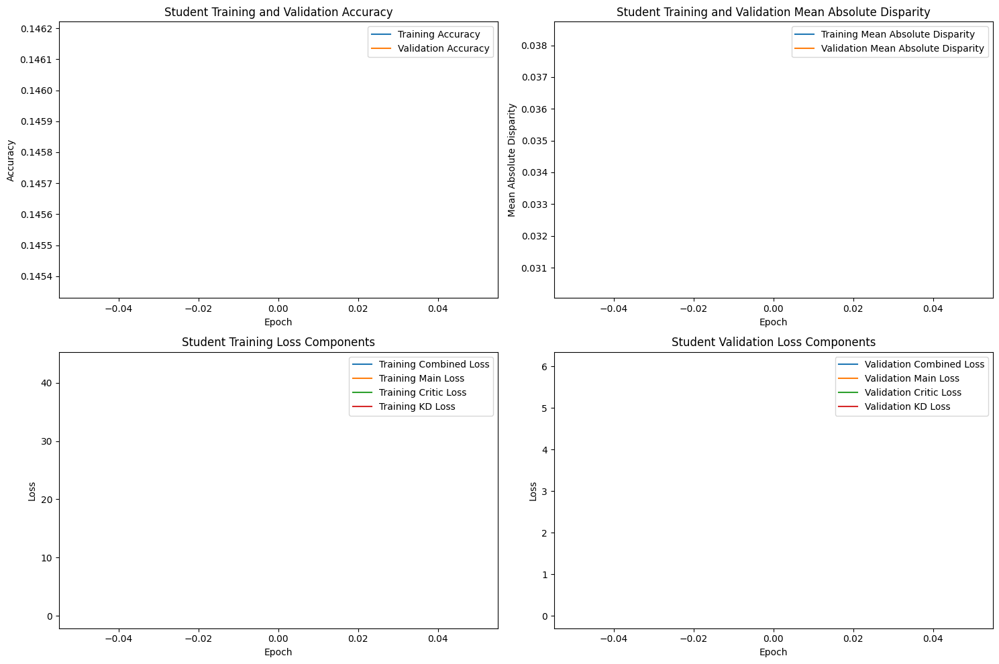

Epoch 2/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.75it/s]



STUDENT - Lambda 180 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.118036, VALIDATION Accuracy: 0.1116
TRAINING Disparity: 0.025398, VALIDATION Disparity: 0.0353
TRAINING Combined Loss: 6.727196, VALIDATION Combined Loss: 4.8969
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.04440941203946985
Class Celebration: Val Disparity = -0.023255813953488372
Class Parade: Val Disparity = -0.08949096880131364
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.01759266220584919
Class Surgeons: Val Disparity = -0.0029304029304029304
Class Spa: Val Disparity = -0.1276595744680851
Class Law_Enforcement: Val Disparity = 0.0174808429118774
Class Business: Val Disparity = 0.03196930946291565
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.042617960426179574
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Dispa

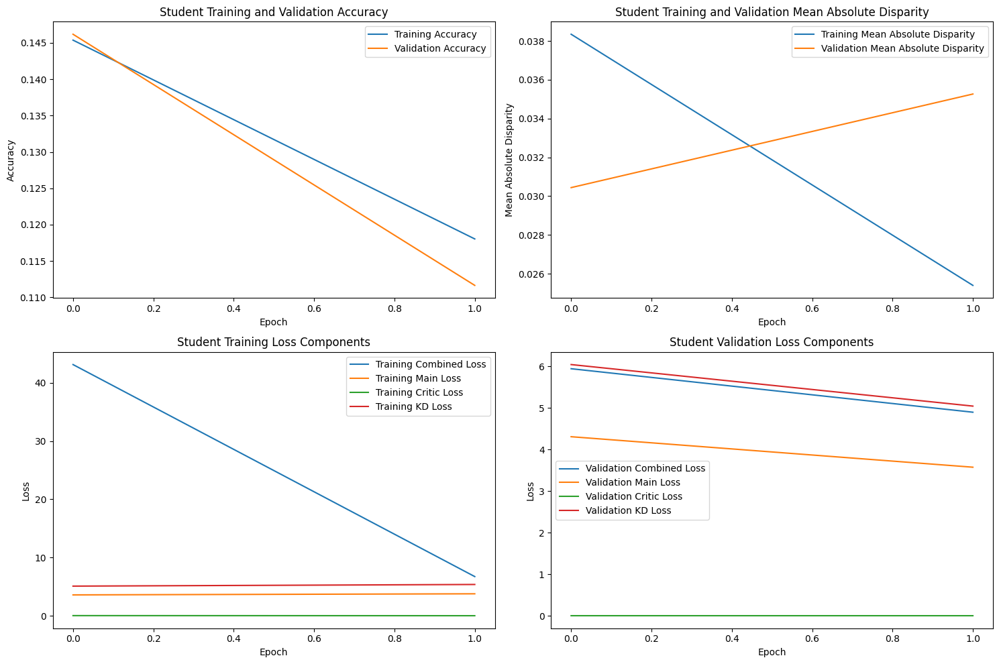

Epoch 3/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.70it/s]



STUDENT - Lambda 180 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.107176, VALIDATION Accuracy: 0.1062
TRAINING Disparity: 0.023752, VALIDATION Disparity: 0.0465
TRAINING Combined Loss: 6.174229, VALIDATION Combined Loss: 5.4622
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.04440941203946985
Class Celebration: Val Disparity = -0.023255813953488372
Class Parade: Val Disparity = -0.08949096880131364
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.01759266220584919
Class Surgeons: Val Disparity = -0.0029304029304029304
Class Spa: Val Disparity = -0.1276595744680851
Class Law_Enforcement: Val Disparity = 0.0174808429118774
Class Business: Val Disparity = 0.03196930946291565
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.042617960426179574
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Dispa

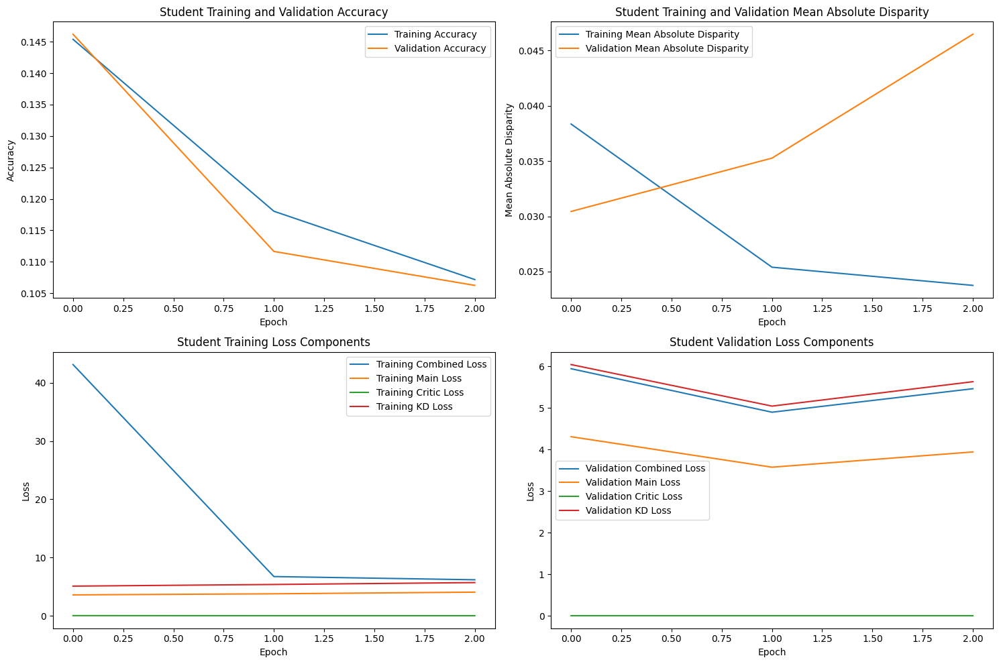

Epoch 4/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.80it/s]



STUDENT - Lambda 180 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.120255, VALIDATION Accuracy: 0.1815
TRAINING Disparity: 0.053041, VALIDATION Disparity: 0.0568
TRAINING Combined Loss: 5.339133, VALIDATION Combined Loss: 4.1101
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.02084428095988783
Class Celebration: Val Disparity = 0.04651162790697677
Class Parade: Val Disparity = 0.049847525216983324
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.05732651680324791
Class Surgeons: Val Disparity = -0.05714285714285714
Class Spa: Val Disparity = -0.021276595744680847
Class Law_Enforcement: Val Disparity = 0.03520114942528736
Class Business: Val Disparity = 0.00980392156862745
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.11404653185475103
Class Picnic: Val Disparity = 0.09259259259259257
Class Rescue: Val Disparity = 0.0
Class Cheeri

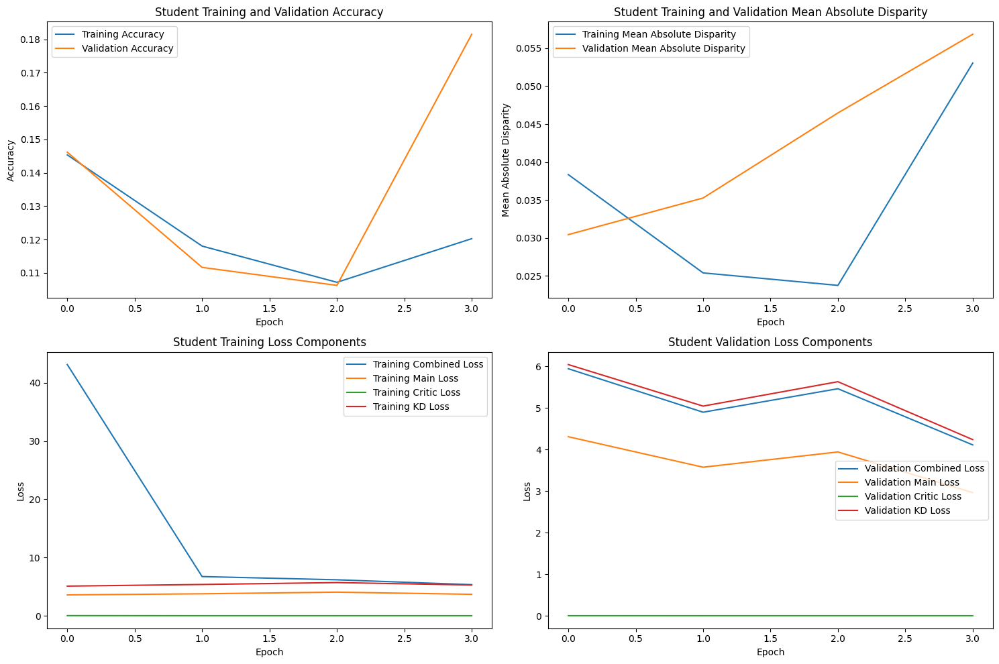

Epoch 5/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.72it/s]



STUDENT - Lambda 180 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.152373, VALIDATION Accuracy: 0.1852
TRAINING Disparity: 0.025450, VALIDATION Disparity: 0.0388
TRAINING Combined Loss: 4.644910, VALIDATION Combined Loss: 3.8538
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.022981257663338583
Class Celebration: Val Disparity = 0.025581395348837216
Class Parade: Val Disparity = -0.050199390100867936
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.027930230809713547
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = -0.0425531914893617
Class Law_Enforcement: Val Disparity = 0.006944444444444444
Class Business: Val Disparity = -0.015132139812446717
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0442487497282017
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.024754

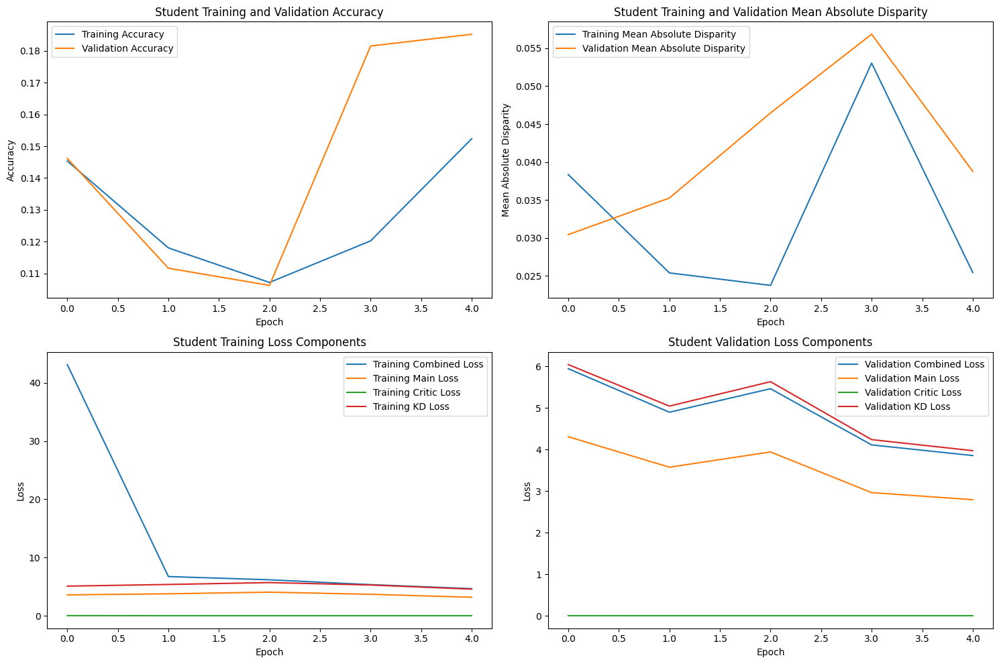

Epoch 6/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.78it/s]



STUDENT - Lambda 180 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.193441, VALIDATION Accuracy: 0.2256
TRAINING Disparity: 0.028715, VALIDATION Disparity: 0.0774
TRAINING Combined Loss: 3.830670, VALIDATION Combined Loss: 3.4608
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.03573305307409358
Class Celebration: Val Disparity = -0.018604651162790697
Class Parade: Val Disparity = -0.04902650715458601
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.021840463123073445
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.3120567375886525
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = -0.00213128729752771
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.14524896716677532
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_En

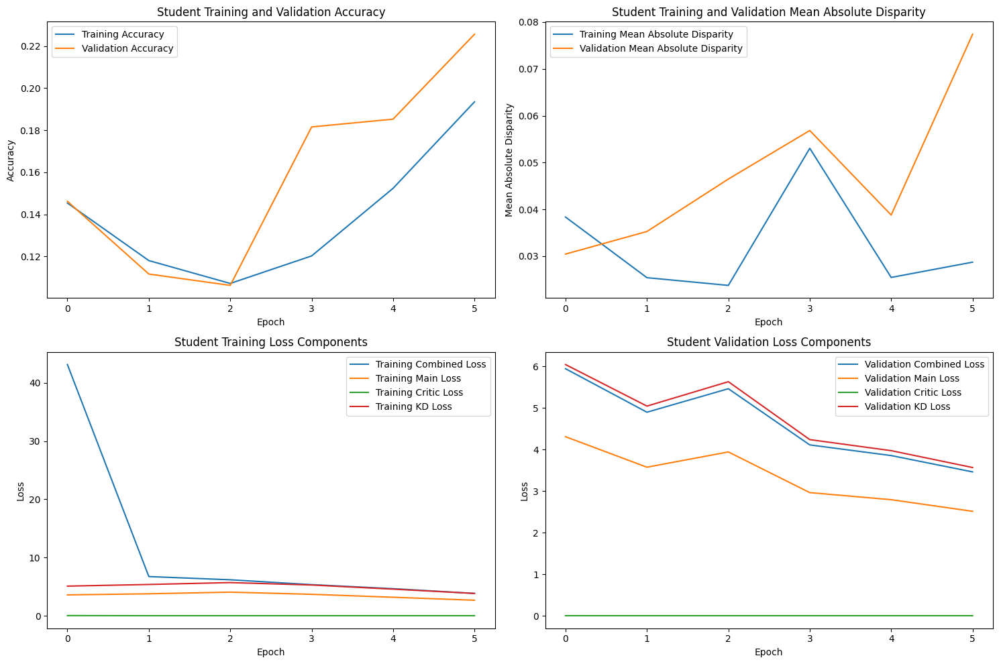

Epoch 7/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 180 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.218750, VALIDATION Accuracy: 0.2338
TRAINING Disparity: 0.021629, VALIDATION Disparity: 0.0389
TRAINING Combined Loss: 3.600957, VALIDATION Combined Loss: 3.3202
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.03837216091551332
Class Celebration: Val Disparity = 0.05348837209302326
Class Parade: Val Disparity = 0.021815622800844536
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.018494850011277375
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = -0.02127659574468085
Class Law_Enforcement: Val Disparity = -0.010296934865900383
Class Business: Val Disparity = 0.01854219948849105
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.16253533376821055
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class P

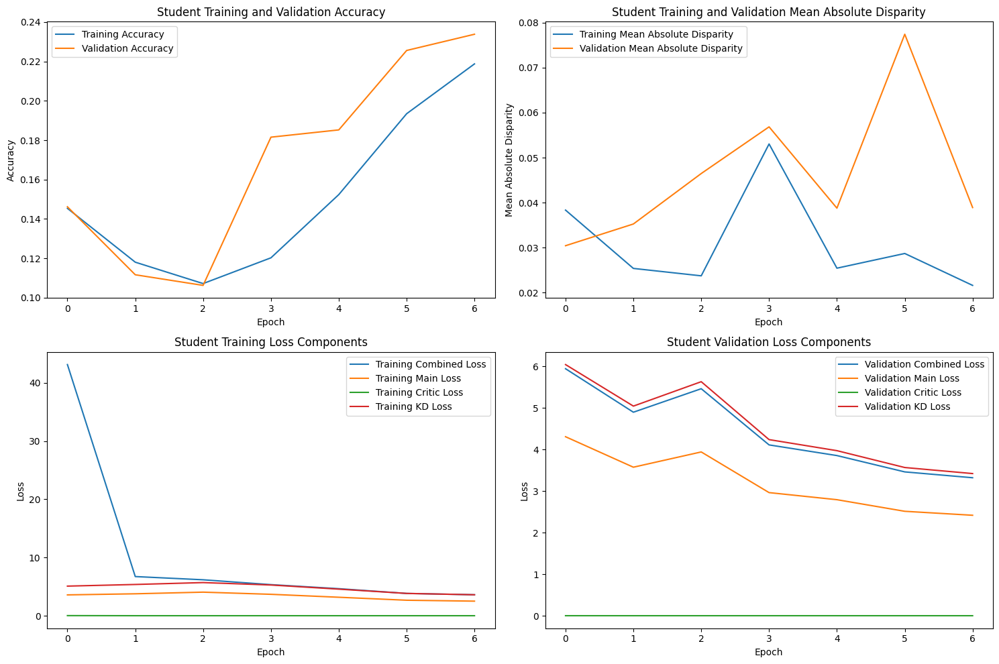

Epoch 8/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 180 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.236304, VALIDATION Accuracy: 0.2474
TRAINING Disparity: 0.014555, VALIDATION Disparity: 0.0362
TRAINING Combined Loss: 3.479606, VALIDATION Combined Loss: 3.2435
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.04437437963449531
Class Celebration: Val Disparity = 0.034883720930232565
Class Parade: Val Disparity = -0.00504339666901249
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.005976994210961595
Class Surgeons: Val Disparity = 0.02564102564102564
Class Spa: Val Disparity = -0.02127659574468085
Class Law_Enforcement: Val Disparity = -0.013649425287356323
Class Business: Val Disparity = 0.008738277919863598
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.13948684496629699
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disp

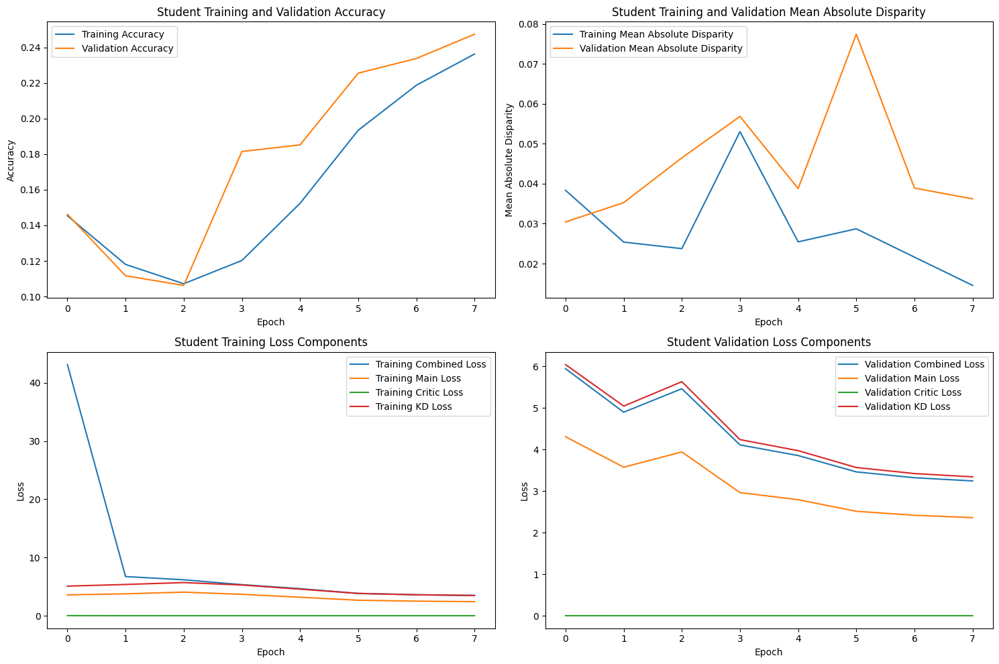

Epoch 9/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 180 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.250039, VALIDATION Accuracy: 0.2560
TRAINING Disparity: 0.018659, VALIDATION Disparity: 0.0461
TRAINING Combined Loss: 3.403373, VALIDATION Combined Loss: 3.1722
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.035674665732469246
Class Celebration: Val Disparity = 0.06046511627906974
Class Parade: Val Disparity = -0.005043396669012434
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.044808661002932015
Class Surgeons: Val Disparity = 0.025641025641025644
Class Spa: Val Disparity = -0.02127659574468085
Class Law_Enforcement: Val Disparity = -0.027298850574712645
Class Business: Val Disparity = 0.0087382779198636
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.16764514024787985
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disp

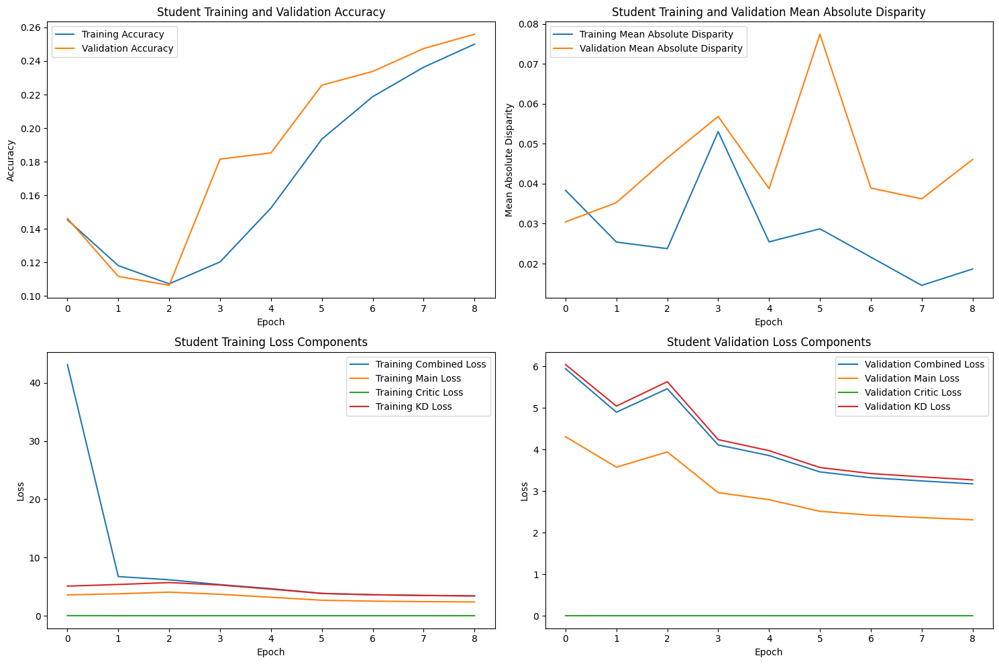

Epoch 10/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 180 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.265046, VALIDATION Accuracy: 0.2767
TRAINING Disparity: 0.019059, VALIDATION Disparity: 0.0461
TRAINING Combined Loss: 3.322164, VALIDATION Combined Loss: 3.1107
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.00991417060781219
Class Celebration: Val Disparity = 0.020930232558139528
Class Parade: Val Disparity = -0.04785362420830408
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.030448838433200454
Class Surgeons: Val Disparity = 0.02564102564102564
Class Spa: Val Disparity = -0.02127659574468085
Class Law_Enforcement: Val Disparity = 0.042145593869731796
Class Business: Val Disparity = -0.0074595055413469585
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.1597086323113721
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Dis

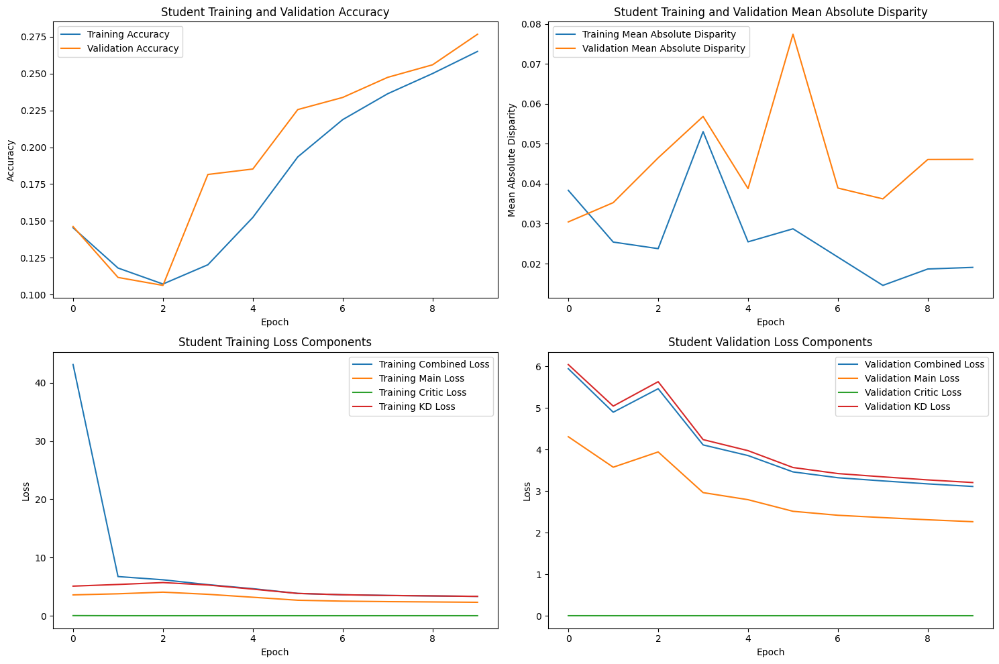

Epoch 11/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.72it/s]



STUDENT - Lambda 180 - Epoch 11 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.281636, VALIDATION Accuracy: 0.2895
TRAINING Disparity: 0.028398, VALIDATION Disparity: 0.0507
TRAINING Combined Loss: 3.266651, VALIDATION Combined Loss: 3.0582
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.032229812576633265
Class Celebration: Val Disparity = 0.04883720930232563
Class Parade: Val Disparity = -0.07260145437485344
Class Waiter_Or_Waitress: Val Disparity = -0.02127659574468085
Class Individual_Sports: Val Disparity = -0.04447034057589655
Class Surgeons: Val Disparity = 0.02564102564102564
Class Spa: Val Disparity = -0.02127659574468085
Class Law_Enforcement: Val Disparity = 0.06681034482758622
Class Business: Val Disparity = -0.01939471440750211
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.16764514024787996
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Chee

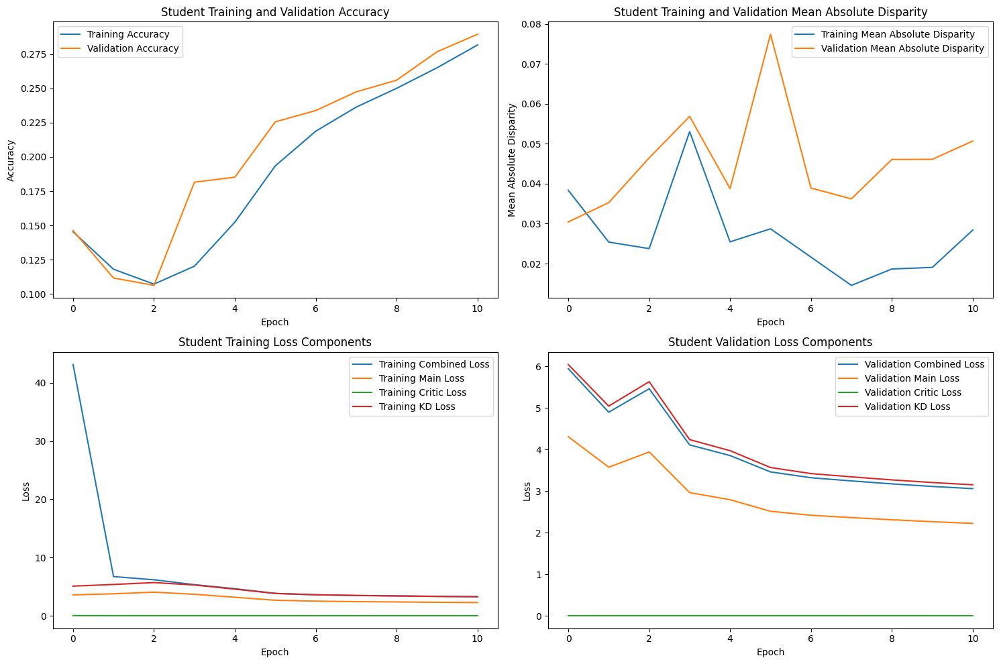

Epoch 12/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 180 - Epoch 12 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.291184, VALIDATION Accuracy: 0.3063
TRAINING Disparity: 0.029044, VALIDATION Disparity: 0.0569
TRAINING Combined Loss: 3.209881, VALIDATION Combined Loss: 2.9977
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.014328253634612098
Class Celebration: Val Disparity = -0.025581395348837244
Class Parade: Val Disparity = -0.0547736335913675
Class Waiter_Or_Waitress: Val Disparity = -0.05319148936170213
Class Individual_Sports: Val Disparity = -0.005601082625366516
Class Surgeons: Val Disparity = 0.02564102564102564
Class Spa: Val Disparity = -0.02127659574468085
Class Law_Enforcement: Val Disparity = 0.12954980842911878
Class Business: Val Disparity = -0.054134697357203734
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.14818438791041538
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class C

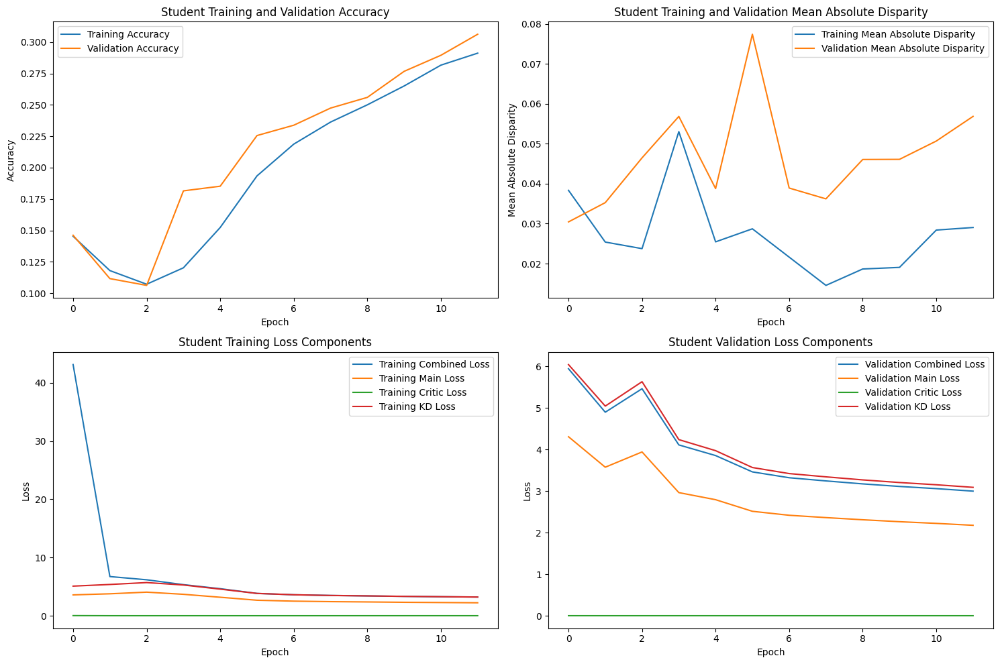

Epoch 13/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 180 - Epoch 13 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.308777, VALIDATION Accuracy: 0.3165
TRAINING Disparity: 0.037806, VALIDATION Disparity: 0.0760
TRAINING Combined Loss: 3.153059, VALIDATION Combined Loss: 2.9507
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.00220704151340001
Class Celebration: Val Disparity = -0.037209302325581395
Class Parade: Val Disparity = -0.012667135819845188
Class Waiter_Or_Waitress: Val Disparity = -0.0851063829787234
Class Individual_Sports: Val Disparity = -0.019735358243741008
Class Surgeons: Val Disparity = 0.02564102564102564
Class Spa: Val Disparity = 0.3120567375886525
Class Law_Enforcement: Val Disparity = 0.1539750957854406
Class Business: Val Disparity = -0.06500426257459506
Class Dresses: Val Disparity = -0.017857142857142856
Class Water_Activities: Val Disparity = 0.11502500543596439
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity

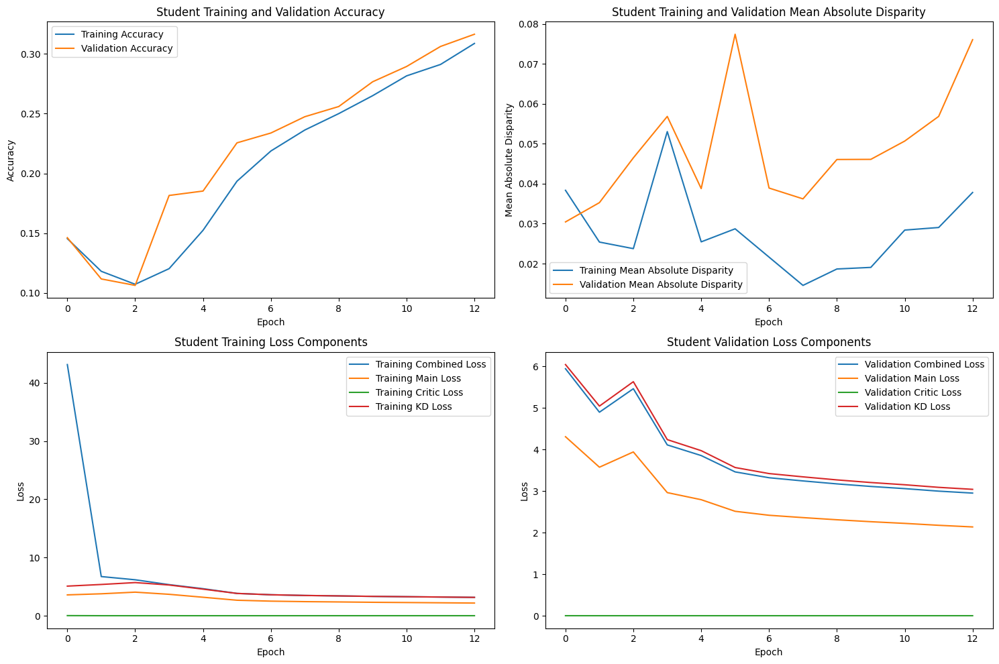

Epoch 14/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.81it/s]



STUDENT - Lambda 180 - Epoch 14 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.317226, VALIDATION Accuracy: 0.3295
TRAINING Disparity: 0.042167, VALIDATION Disparity: 0.0771
TRAINING Combined Loss: 3.094764, VALIDATION Combined Loss: 2.8972
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.036328603958661776
Class Celebration: Val Disparity = 0.0023255813953487747
Class Parade: Val Disparity = -0.04468684025334274
Class Waiter_Or_Waitress: Val Disparity = -0.10638297872340427
Class Individual_Sports: Val Disparity = -0.06563416284489881
Class Surgeons: Val Disparity = 0.02564102564102564
Class Spa: Val Disparity = 0.2907801418439716
Class Law_Enforcement: Val Disparity = 0.1922892720306513
Class Business: Val Disparity = -0.06820119352088663
Class Dresses: Val Disparity = -0.07142857142857144
Class Water_Activities: Val Disparity = 0.12154816264405305
Class Picnic: Val Disparity = -0.018518518518518517
Class Resc

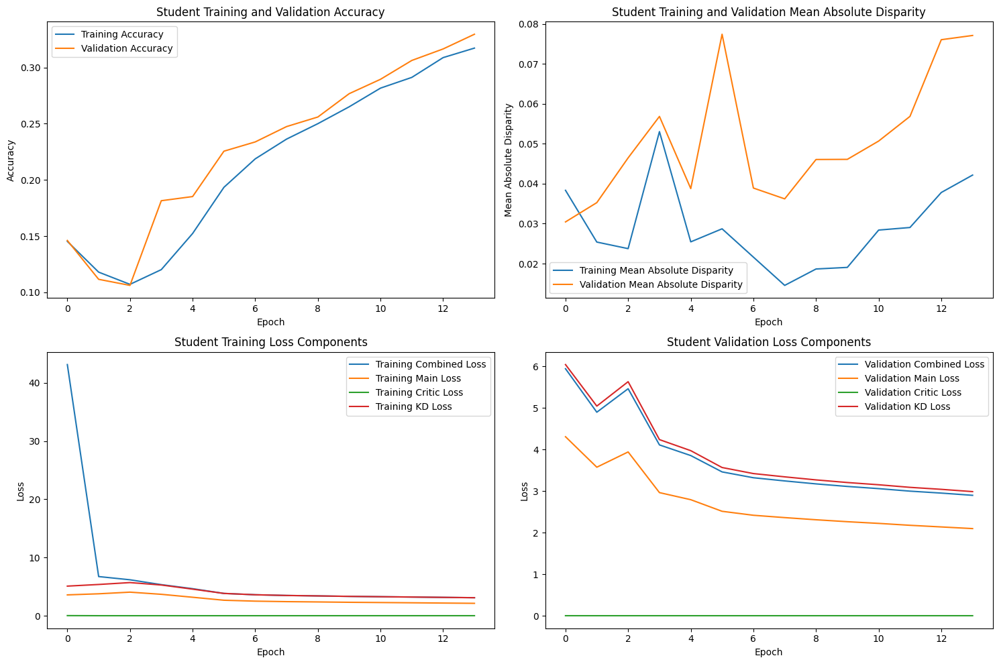

Epoch 15/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.80it/s]



STUDENT - Lambda 180 - Epoch 15 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.335764, VALIDATION Accuracy: 0.3500
TRAINING Disparity: 0.035925, VALIDATION Disparity: 0.0952
TRAINING Combined Loss: 3.037411, VALIDATION Combined Loss: 2.8530
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.009447071874817525
Class Celebration: Val Disparity = -0.020930232558139528
Class Parade: Val Disparity = -0.017827820783485715
Class Waiter_Or_Waitress: Val Disparity = -0.11560283687943262
Class Individual_Sports: Val Disparity = -0.0586422073528306
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.2907801418439716
Class Law_Enforcement: Val Disparity = 0.2689176245210728
Class Business: Val Disparity = -0.06159420289855075
Class Dresses: Val Disparity = -0.1488095238095238
Class Water_Activities: Val Disparity = 0.12731028484453144
Class Picnic: Val Disparity = 0.09259259259259259
Class Rescue: Val Disparity =

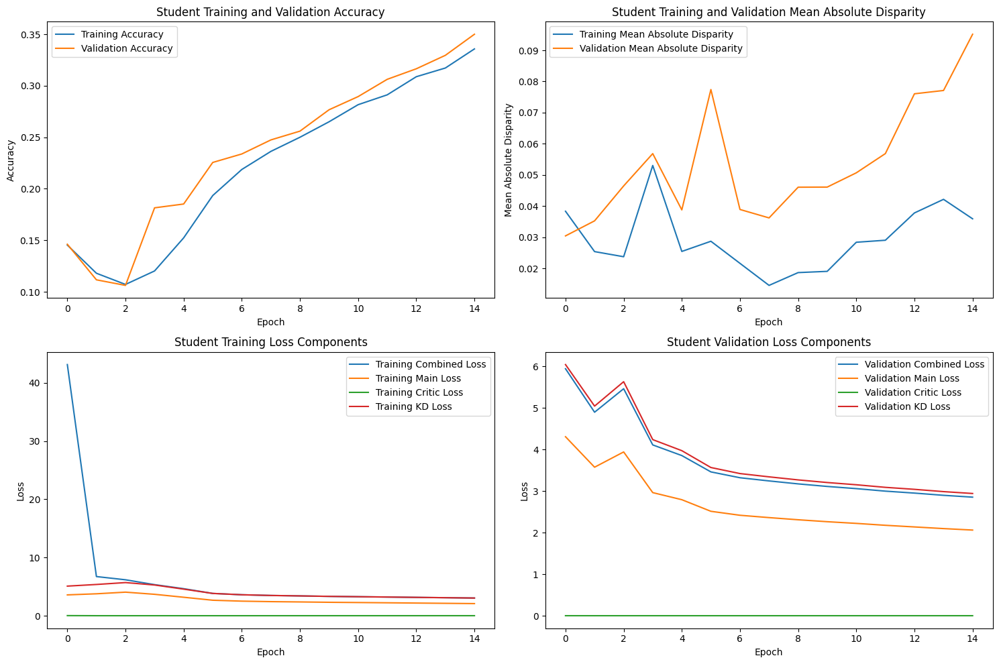

Epoch 16/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 180 - Epoch 16 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.349016, VALIDATION Accuracy: 0.3560
TRAINING Disparity: 0.030705, VALIDATION Disparity: 0.0990
TRAINING Combined Loss: 2.984857, VALIDATION Combined Loss: 2.8037
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.02852805511765044
Class Celebration: Val Disparity = -0.08139534883720934
Class Parade: Val Disparity = 0.014074595355383523
Class Waiter_Or_Waitress: Val Disparity = -0.10354609929078014
Class Individual_Sports: Val Disparity = -0.06570934516201782
Class Surgeons: Val Disparity = 0.02564102564102564
Class Spa: Val Disparity = 0.2907801418439716
Class Law_Enforcement: Val Disparity = 0.24473180076628354
Class Business: Val Disparity = -0.053921568627450955
Class Dresses: Val Disparity = -0.20238095238095236
Class Water_Activities: Val Disparity = 0.11578604044357471
Class Picnic: Val Disparity = 0.09259259259259259
Class Rescue

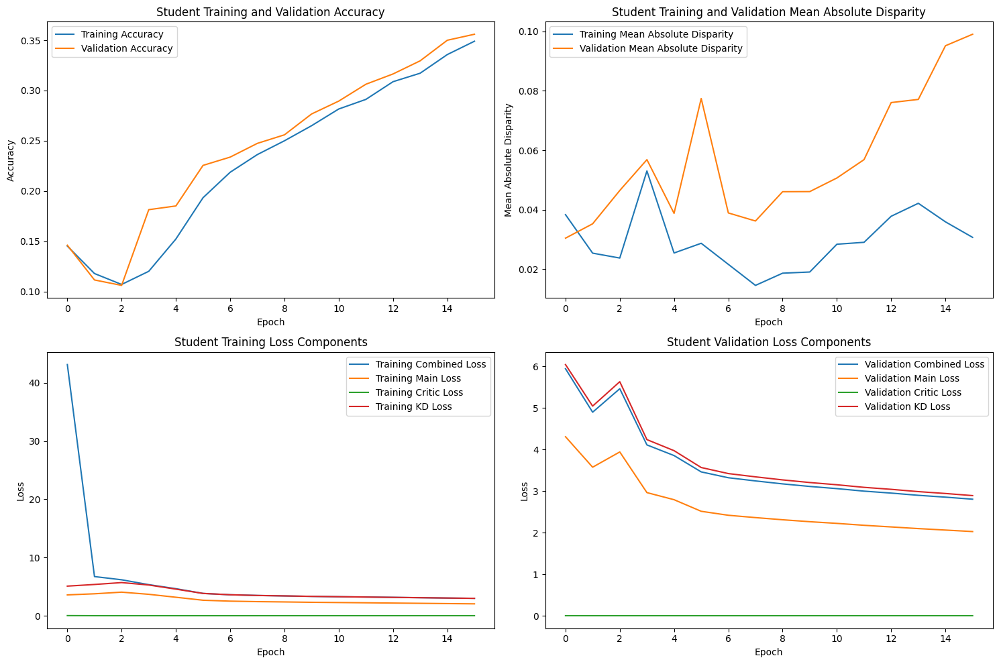

Epoch 17/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.81it/s]



STUDENT - Lambda 180 - Epoch 17 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.366319, VALIDATION Accuracy: 0.3759
TRAINING Disparity: 0.045537, VALIDATION Disparity: 0.0986
TRAINING Combined Loss: 2.920068, VALIDATION Combined Loss: 2.7535
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.015227418695626715
Class Celebration: Val Disparity = -0.011627906976744207
Class Parade: Val Disparity = 0.027445460942997935
Class Waiter_Or_Waitress: Val Disparity = -0.08865248226950351
Class Individual_Sports: Val Disparity = -0.07634764303435826
Class Surgeons: Val Disparity = 0.02564102564102564
Class Spa: Val Disparity = 0.22695035460992904
Class Law_Enforcement: Val Disparity = 0.2863984674329502
Class Business: Val Disparity = -0.04731457800511507
Class Dresses: Val Disparity = -0.25595238095238093
Class Water_Activities: Val Disparity = 0.14176994998912812
Class Picnic: Val Disparity = 0.11111111111111108
Class Rescu

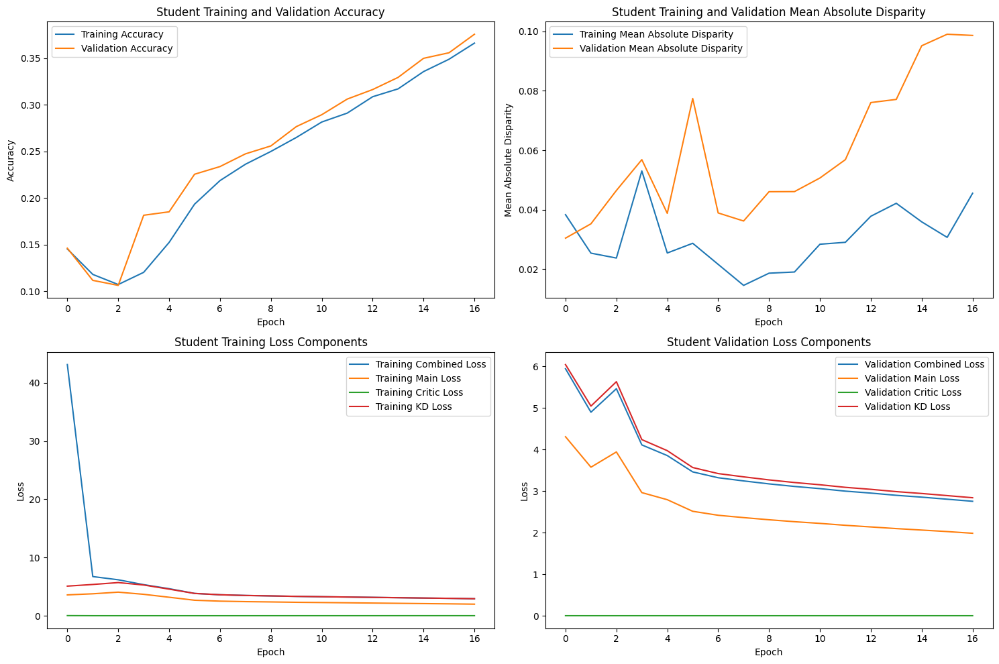

Epoch 18/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.75it/s]



STUDENT - Lambda 180 - Epoch 18 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.388465, VALIDATION Accuracy: 0.3903
TRAINING Disparity: 0.059182, VALIDATION Disparity: 0.0905
TRAINING Combined Loss: 2.861403, VALIDATION Combined Loss: 2.6984
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.03604834471886498
Class Celebration: Val Disparity = -0.0488372093023256
Class Parade: Val Disparity = 0.00891391039174283
Class Waiter_Or_Waitress: Val Disparity = -0.10992907801418439
Class Individual_Sports: Val Disparity = -0.07273889181264576
Class Surgeons: Val Disparity = 0.02564102564102564
Class Spa: Val Disparity = 0.20567375886524822
Class Law_Enforcement: Val Disparity = 0.27610153256704983
Class Business: Val Disparity = -0.038576300085251536
Class Dresses: Val Disparity = -0.23452380952380955
Class Water_Activities: Val Disparity = 0.09415090237008045
Class Picnic: Val Disparity = 0.1111111111111111
Class Rescue: 

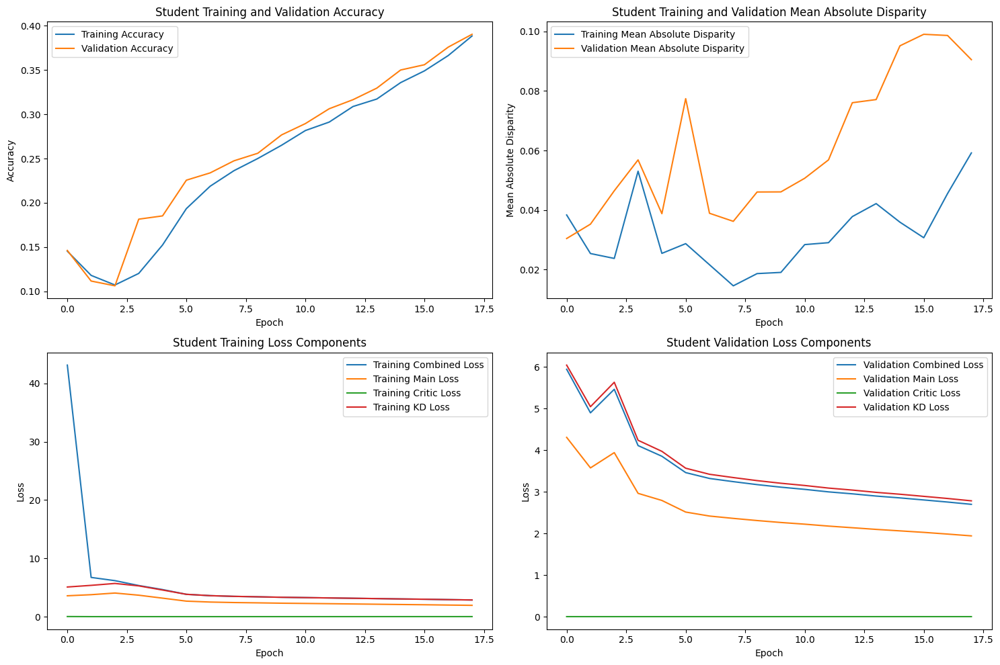

Epoch 19/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.82it/s]



STUDENT - Lambda 180 - Epoch 19 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.402701, VALIDATION Accuracy: 0.4099
TRAINING Disparity: 0.062713, VALIDATION Disparity: 0.0964
TRAINING Combined Loss: 2.797492, VALIDATION Combined Loss: 2.6509
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.03834880597886381
Class Celebration: Val Disparity = -0.1395348837209302
Class Parade: Val Disparity = 0.024278676988036596
Class Waiter_Or_Waitress: Val Disparity = -0.09787234042553189
Class Individual_Sports: Val Disparity = -0.07991880309751154
Class Surgeons: Val Disparity = 0.02564102564102564
Class Spa: Val Disparity = 0.14184397163120566
Class Law_Enforcement: Val Disparity = 0.25550766283524895
Class Business: Val Disparity = -0.0505115089514066
Class Dresses: Val Disparity = -0.305952380952381
Class Water_Activities: Val Disparity = 0.14829310719721678
Class Picnic: Val Disparity = -0.01851851851851849
Class Rescue: V

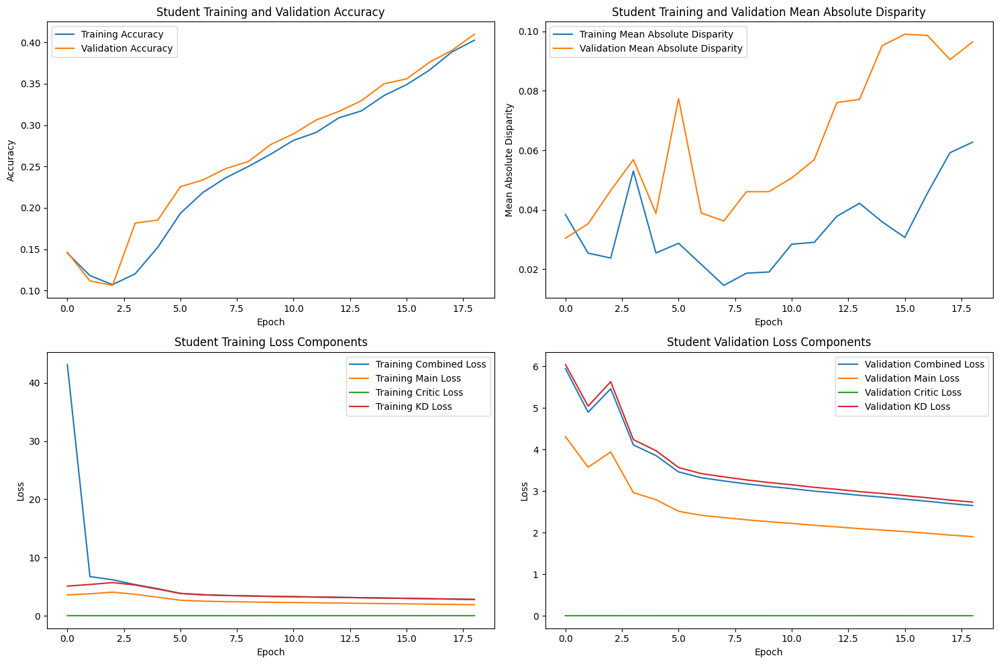

Epoch 20/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 180 - Epoch 20 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.425135, VALIDATION Accuracy: 0.4159
TRAINING Disparity: 0.080363, VALIDATION Disparity: 0.1094
TRAINING Combined Loss: 2.730420, VALIDATION Combined Loss: 2.6027
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04412915279967311
Class Celebration: Val Disparity = -0.10697674418604658
Class Parade: Val Disparity = 0.0037532254281023025
Class Waiter_Or_Waitress: Val Disparity = -0.16312056737588648
Class Individual_Sports: Val Disparity = -0.10799939854146301
Class Surgeons: Val Disparity = 0.02564102564102564
Class Spa: Val Disparity = 0.1631205673758865
Class Law_Enforcement: Val Disparity = 0.28328544061302685
Class Business: Val Disparity = -0.04283887468030684
Class Dresses: Val Disparity = -0.3297619047619049
Class Water_Activities: Val Disparity = 0.07110241356816693
Class Picnic: Val Disparity = -0.055555555555555636
Class Rescu

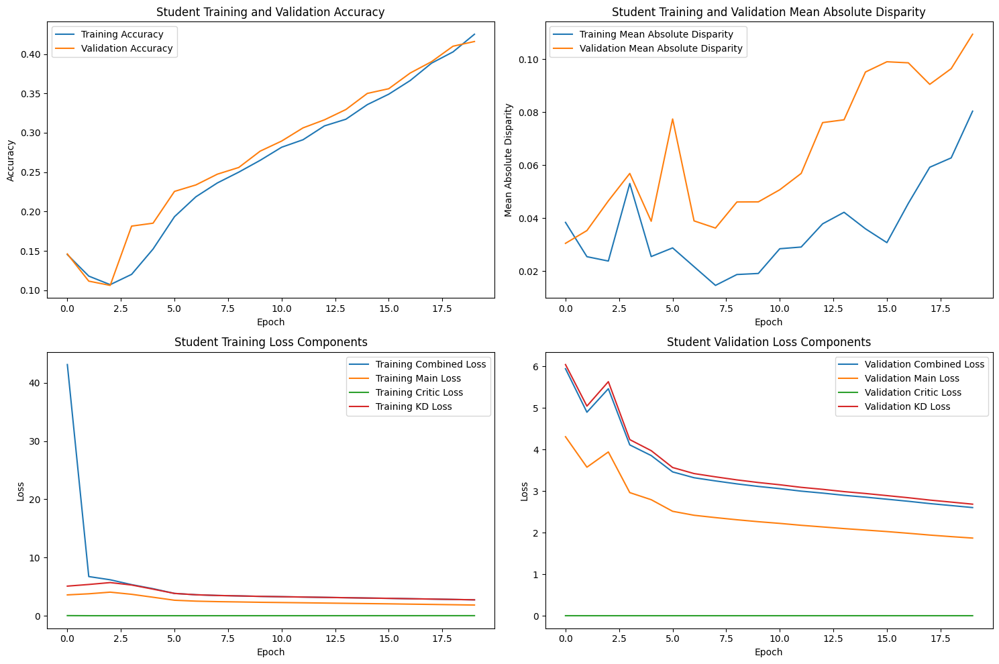

Epoch 21/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 180 - Epoch 21 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.442207, VALIDATION Accuracy: 0.4344
TRAINING Disparity: 0.085971, VALIDATION Disparity: 0.1003
TRAINING Combined Loss: 2.657346, VALIDATION Combined Loss: 2.5519
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07847258714310734
Class Celebration: Val Disparity = -0.06279069767441858
Class Parade: Val Disparity = 0.040112596762842956
Class Waiter_Or_Waitress: Val Disparity = -0.20283687943262413
Class Individual_Sports: Val Disparity = -0.0726261183369672
Class Surgeons: Val Disparity = 0.02564102564102564
Class Spa: Val Disparity = 0.12056737588652477
Class Law_Enforcement: Val Disparity = 0.2416187739463601
Class Business: Val Disparity = -0.02216538789428807
Class Dresses: Val Disparity = -0.35357142857142865
Class Water_Activities: Val Disparity = 0.08914981517721254
Class Picnic: Val Disparity = 0.0925925925925925
Class Rescue: V

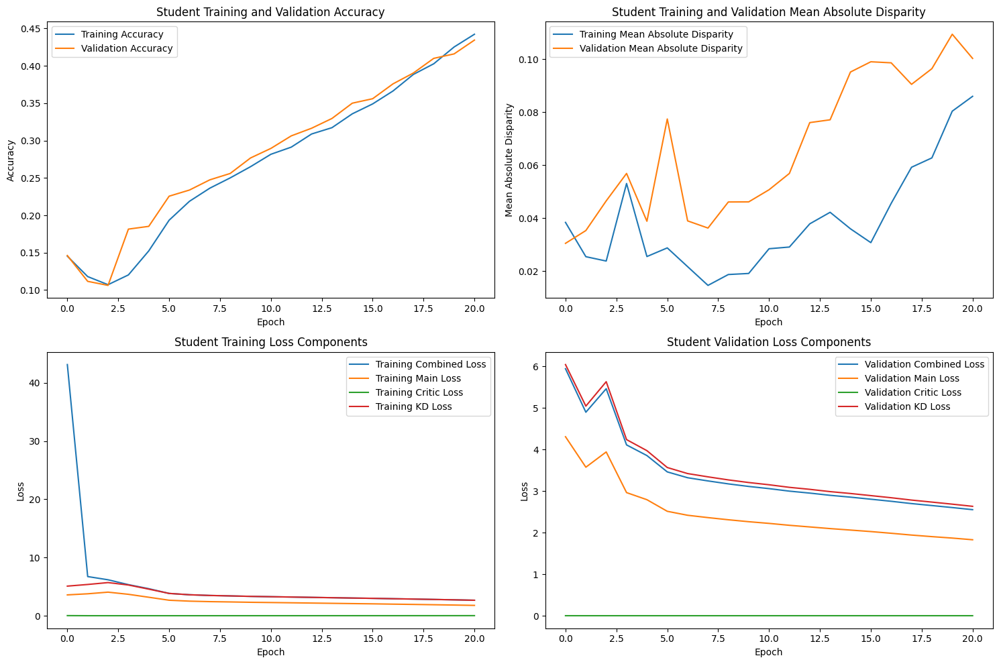

Epoch 22/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.78it/s]



STUDENT - Lambda 180 - Epoch 22 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.458989, VALIDATION Accuracy: 0.4443
TRAINING Disparity: 0.092953, VALIDATION Disparity: 0.1053
TRAINING Combined Loss: 2.577996, VALIDATION Combined Loss: 2.4956
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.03391136801541417
Class Celebration: Val Disparity = -0.0790697674418604
Class Parade: Val Disparity = 0.05876143560872621
Class Waiter_Or_Waitress: Val Disparity = -0.22553191489361707
Class Individual_Sports: Val Disparity = -0.08315164273362902
Class Surgeons: Val Disparity = -0.0029304029304029304
Class Spa: Val Disparity = 0.035460992907801414
Class Law_Enforcement: Val Disparity = 0.2519157088122606
Class Business: Val Disparity = -0.03623188405797101
Class Dresses: Val Disparity = -0.3476190476190476
Class Water_Activities: Val Disparity = 0.1280713198521417
Class Picnic: Val Disparity = 0.09259259259259262
Class Rescue:

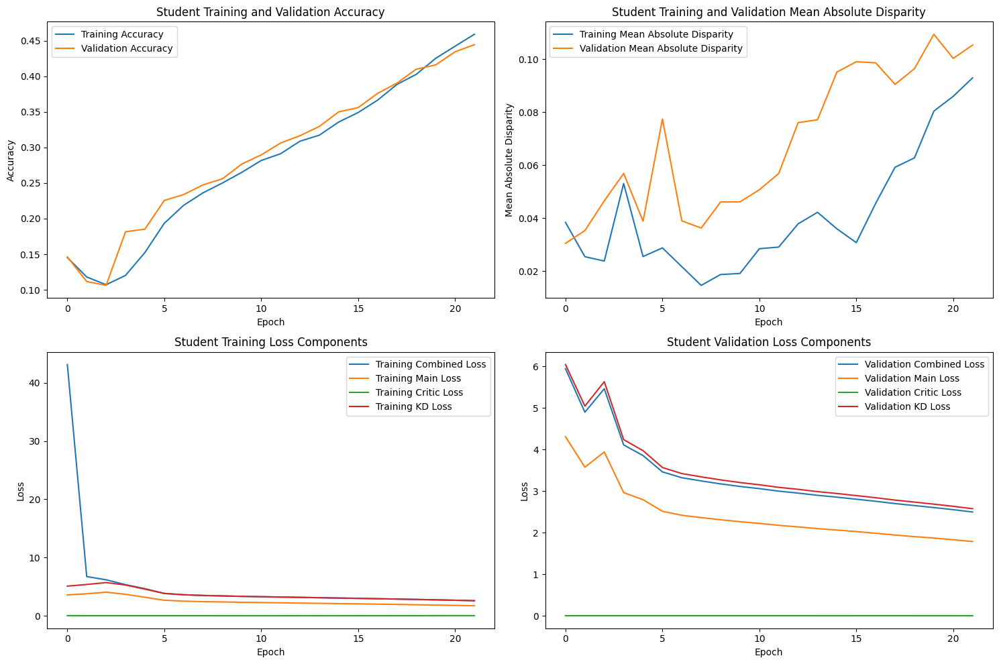

Epoch 23/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.76it/s]



STUDENT - Lambda 180 - Epoch 23 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.471991, VALIDATION Accuracy: 0.4580
TRAINING Disparity: 0.105107, VALIDATION Disparity: 0.1031
TRAINING Combined Loss: 2.515280, VALIDATION Combined Loss: 2.4468
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.036270216617037554
Class Celebration: Val Disparity = -0.016279069767441923
Class Parade: Val Disparity = -0.01536476659629371
Class Waiter_Or_Waitress: Val Disparity = -0.21205673758865257
Class Individual_Sports: Val Disparity = -0.11142019397037811
Class Surgeons: Val Disparity = -0.034432234432234435
Class Spa: Val Disparity = 0.035460992907801414
Class Law_Enforcement: Val Disparity = 0.2763409961685824
Class Business: Val Disparity = -0.01982097186700771
Class Dresses: Val Disparity = -0.4130952380952382
Class Water_Activities: Val Disparity = 0.14829310719721678
Class Picnic: Val Disparity = 0.05555555555555558
Class Res

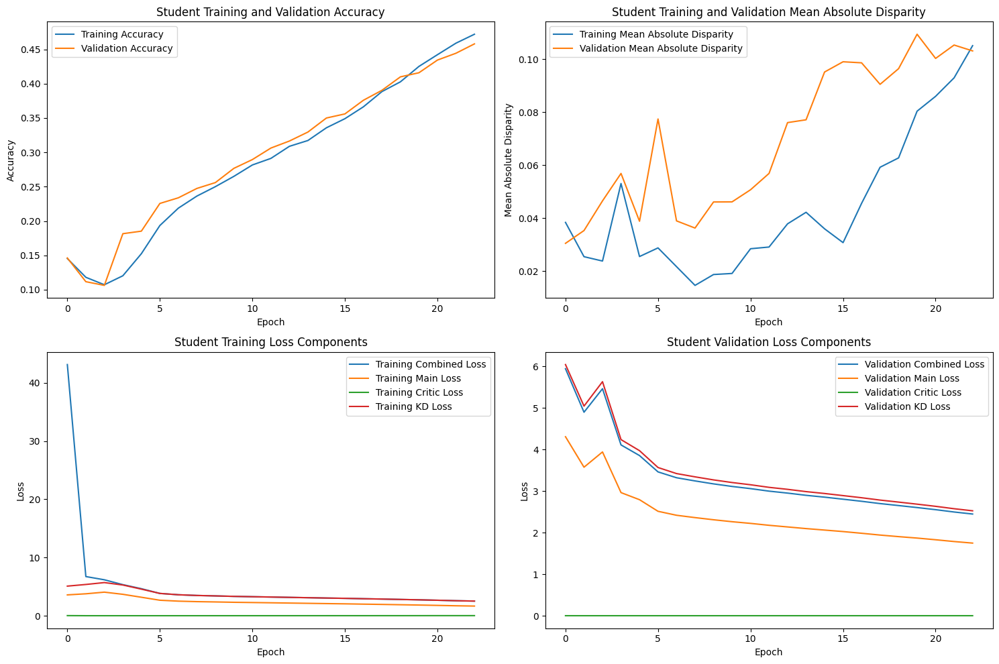

Epoch 24/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 180 - Epoch 24 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.495833, VALIDATION Accuracy: 0.4710
TRAINING Disparity: 0.099401, VALIDATION Disparity: 0.1290
TRAINING Combined Loss: 2.430069, VALIDATION Combined Loss: 2.4093
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06921235476148768
Class Celebration: Val Disparity = -0.016279069767441923
Class Parade: Val Disparity = 0.022871217452498205
Class Waiter_Or_Waitress: Val Disparity = -0.16666666666666669
Class Individual_Sports: Val Disparity = -0.10799939854146312
Class Surgeons: Val Disparity = -0.06593406593406596
Class Spa: Val Disparity = 0.36879432624113473
Class Law_Enforcement: Val Disparity = 0.2418582375478927
Class Business: Val Disparity = -0.03623188405797101
Class Dresses: Val Disparity = -0.44285714285714295
Class Water_Activities: Val Disparity = 0.16057838660578383
Class Picnic: Val Disparity = 0.05555555555555547
Class Rescu

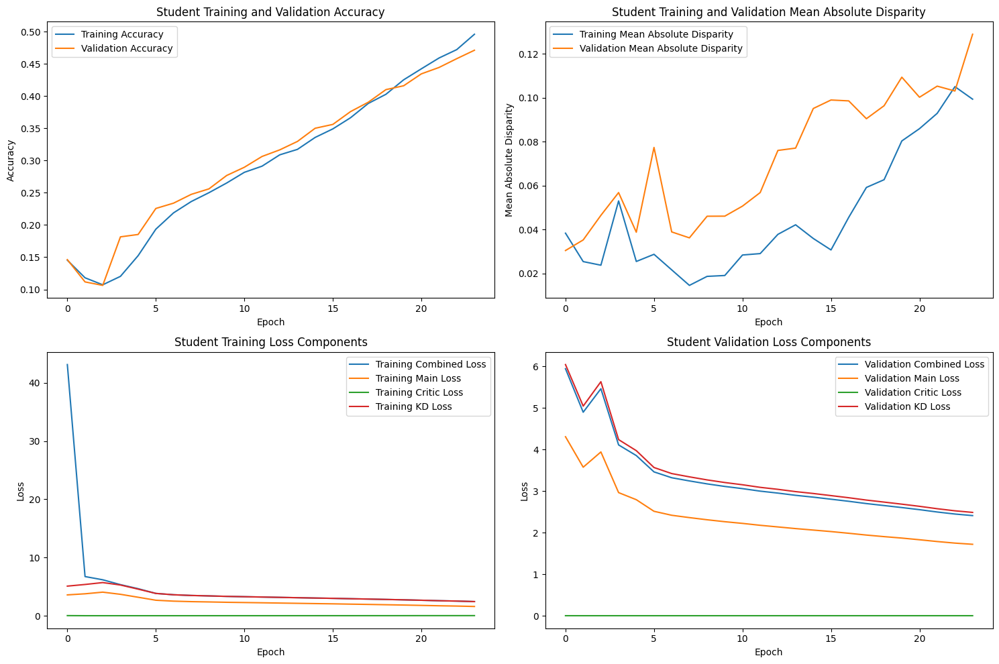

Epoch 25/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.83it/s]



STUDENT - Lambda 180 - Epoch 25 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.516397, VALIDATION Accuracy: 0.4821
TRAINING Disparity: 0.121971, VALIDATION Disparity: 0.1250
TRAINING Combined Loss: 2.365011, VALIDATION Combined Loss: 2.3537
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.049512465697436836
Class Celebration: Val Disparity = -0.05813953488372087
Class Parade: Val Disparity = 0.012667135819845132
Class Waiter_Or_Waitress: Val Disparity = -0.16524822695035463
Class Individual_Sports: Val Disparity = -0.15761972784001205
Class Surgeons: Val Disparity = -0.07179487179487179
Class Spa: Val Disparity = 0.07801418439716312
Class Law_Enforcement: Val Disparity = 0.35296934865900387
Class Business: Val Disparity = -0.04390451832907072
Class Dresses: Val Disparity = -0.47857142857142865
Class Water_Activities: Val Disparity = 0.10502283105022825
Class Picnic: Val Disparity = 0.05555555555555547
Class Resc

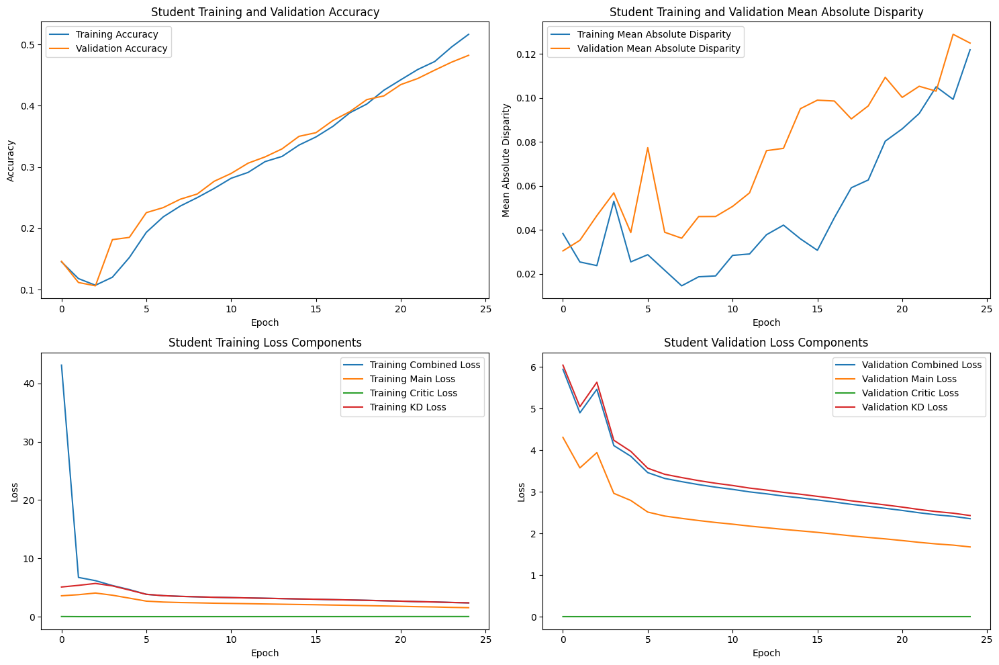

Epoch 26/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.81it/s]



STUDENT - Lambda 180 - Epoch 26 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.540123, VALIDATION Accuracy: 0.4997
TRAINING Disparity: 0.111573, VALIDATION Disparity: 0.1547
TRAINING Combined Loss: 2.270638, VALIDATION Combined Loss: 2.3104
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.08795469142289936
Class Celebration: Val Disparity = -0.04418604651162794
Class Parade: Val Disparity = 0.05031667839549614
Class Waiter_Or_Waitress: Val Disparity = -0.2624113475177306
Class Individual_Sports: Val Disparity = -0.12912562965190588
Class Surgeons: Val Disparity = 0.07619047619047614
Class Spa: Val Disparity = 0.28368794326241137
Class Law_Enforcement: Val Disparity = 0.26293103448275856
Class Business: Val Disparity = -0.03729752770673489
Class Dresses: Val Disparity = -0.6666666666666665
Class Water_Activities: Val Disparity = 0.13176777560339203
Class Picnic: Val Disparity = 0.11111111111111105
Class Rescue: V

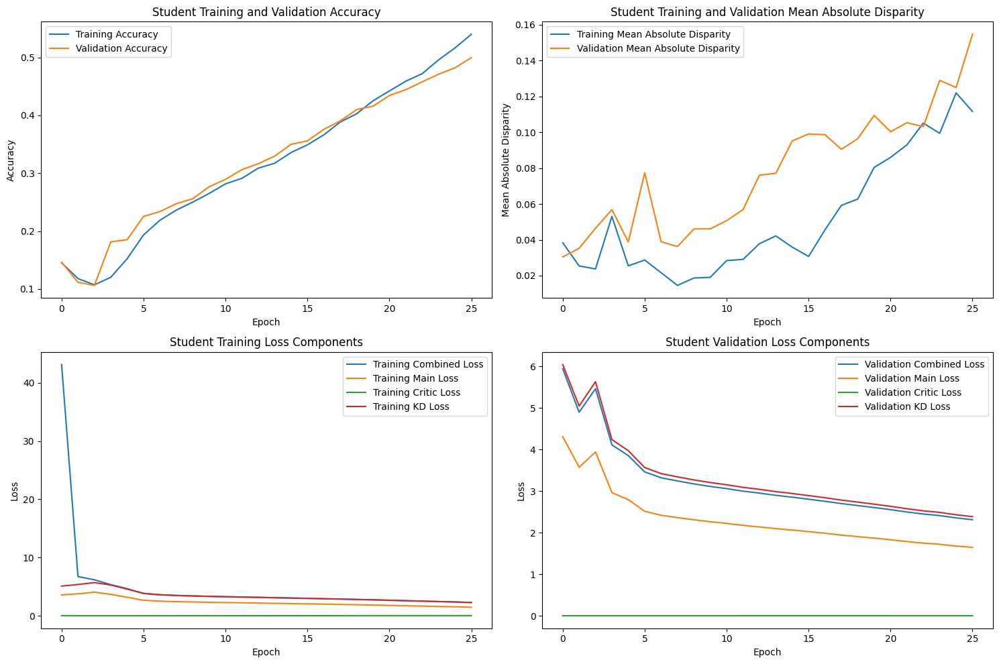

Epoch 27/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 180 - Epoch 27 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.563985, VALIDATION Accuracy: 0.5003
TRAINING Disparity: 0.091326, VALIDATION Disparity: 0.1311
TRAINING Combined Loss: 2.188337, VALIDATION Combined Loss: 2.2582
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07841419980148312
Class Celebration: Val Disparity = -0.011627906976744207
Class Parade: Val Disparity = 0.01196340605207602
Class Waiter_Or_Waitress: Val Disparity = -0.25035460992907804
Class Individual_Sports: Val Disparity = -0.18216675437937008
Class Surgeons: Val Disparity = -0.054945054945054944
Class Spa: Val Disparity = -0.049645390070921946
Class Law_Enforcement: Val Disparity = 0.2387452107279694
Class Business: Val Disparity = -0.05136402387041772
Class Dresses: Val Disparity = -0.6488095238095238
Class Water_Activities: Val Disparity = 0.09132420091324212
Class Picnic: Val Disparity = 0.055555555555555525
Class Res

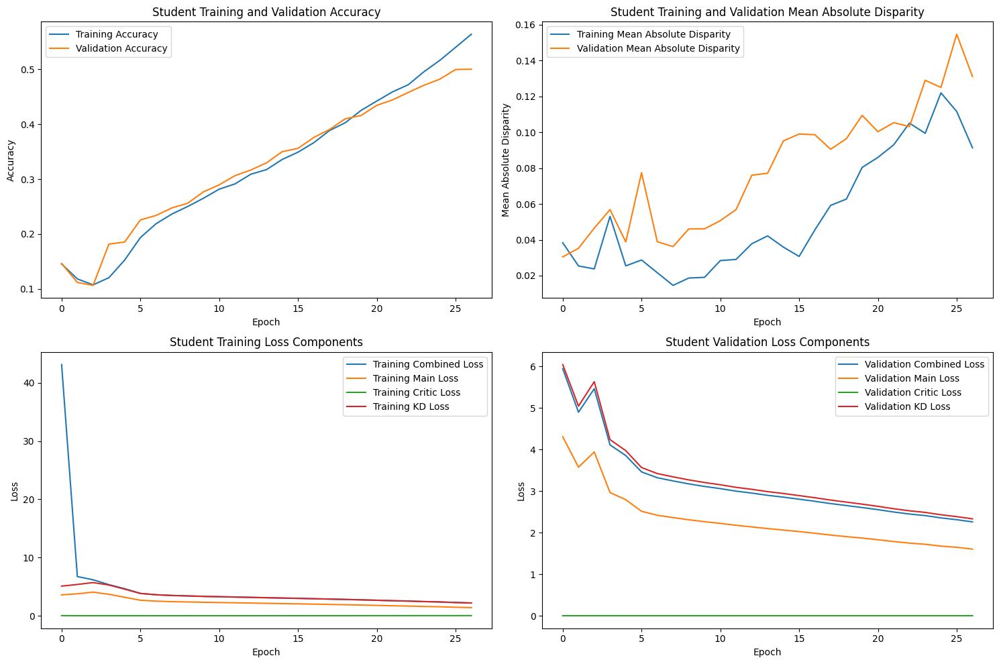

Epoch 28/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.82it/s]



STUDENT - Lambda 180 - Epoch 28 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.575077, VALIDATION Accuracy: 0.5165
TRAINING Disparity: 0.118864, VALIDATION Disparity: 0.1397
TRAINING Combined Loss: 2.121877, VALIDATION Combined Loss: 2.2185
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.096876277223098
Class Celebration: Val Disparity = -0.009302325581395432
Class Parade: Val Disparity = 0.02861834388927975
Class Waiter_Or_Waitress: Val Disparity = -0.2716312056737589
Class Individual_Sports: Val Disparity = -0.1361175851439742
Class Surgeons: Val Disparity = 0.019047619047619035
Class Spa: Val Disparity = -0.028368794326241176
Class Law_Enforcement: Val Disparity = 0.2938218390804598
Class Business: Val Disparity = -0.059036658141517484
Class Dresses: Val Disparity = -0.6726190476190476
Class Water_Activities: Val Disparity = 0.12089584692324418
Class Picnic: Val Disparity = 0.16666666666666669
Class Rescue: 

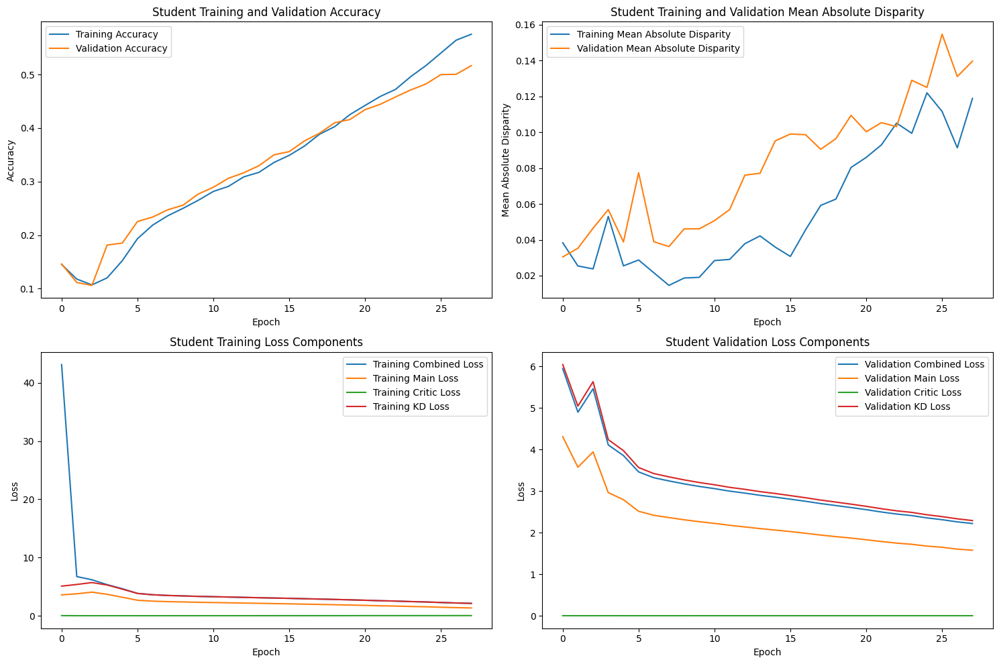

Epoch 29/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.70it/s]



STUDENT - Lambda 180 - Epoch 29 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.605382, VALIDATION Accuracy: 0.5247
TRAINING Disparity: 0.131768, VALIDATION Disparity: 0.1505
TRAINING Combined Loss: 2.032599, VALIDATION Combined Loss: 2.2081
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.08851520990249317
Class Celebration: Val Disparity = -0.013953488372093037
Class Parade: Val Disparity = 0.03811869575416371
Class Waiter_Or_Waitress: Val Disparity = -0.348936170212766
Class Individual_Sports: Val Disparity = -0.15739418088865498
Class Surgeons: Val Disparity = -0.012454212454212521
Class Spa: Val Disparity = 0.21985815602836878
Class Law_Enforcement: Val Disparity = 0.31824712643678166
Class Business: Val Disparity = -0.05903665814151743
Class Dresses: Val Disparity = -0.6488095238095238
Class Water_Activities: Val Disparity = 0.12524461839530332
Class Picnic: Val Disparity = 0.018518518518518545
Class Rescue

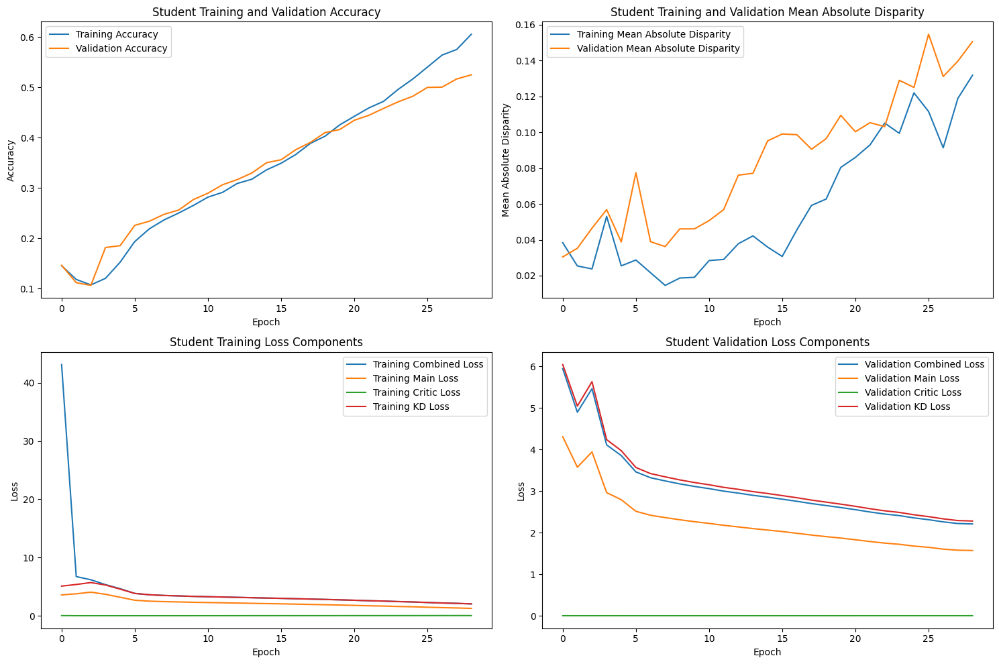

Epoch 30/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.68it/s]



STUDENT - Lambda 180 - Epoch 30 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.628318, VALIDATION Accuracy: 0.5267
TRAINING Disparity: 0.127895, VALIDATION Disparity: 0.1633
TRAINING Combined Loss: 1.935226, VALIDATION Combined Loss: 2.2143
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.08851520990249317
Class Celebration: Val Disparity = -0.013953488372093037
Class Parade: Val Disparity = 0.03811869575416371
Class Waiter_Or_Waitress: Val Disparity = -0.348936170212766
Class Individual_Sports: Val Disparity = -0.15739418088865498
Class Surgeons: Val Disparity = -0.012454212454212521
Class Spa: Val Disparity = 0.21985815602836878
Class Law_Enforcement: Val Disparity = 0.31824712643678166
Class Business: Val Disparity = -0.05903665814151743
Class Dresses: Val Disparity = -0.6488095238095238
Class Water_Activities: Val Disparity = 0.12524461839530332
Class Picnic: Val Disparity = 0.018518518518518545
Class Rescue

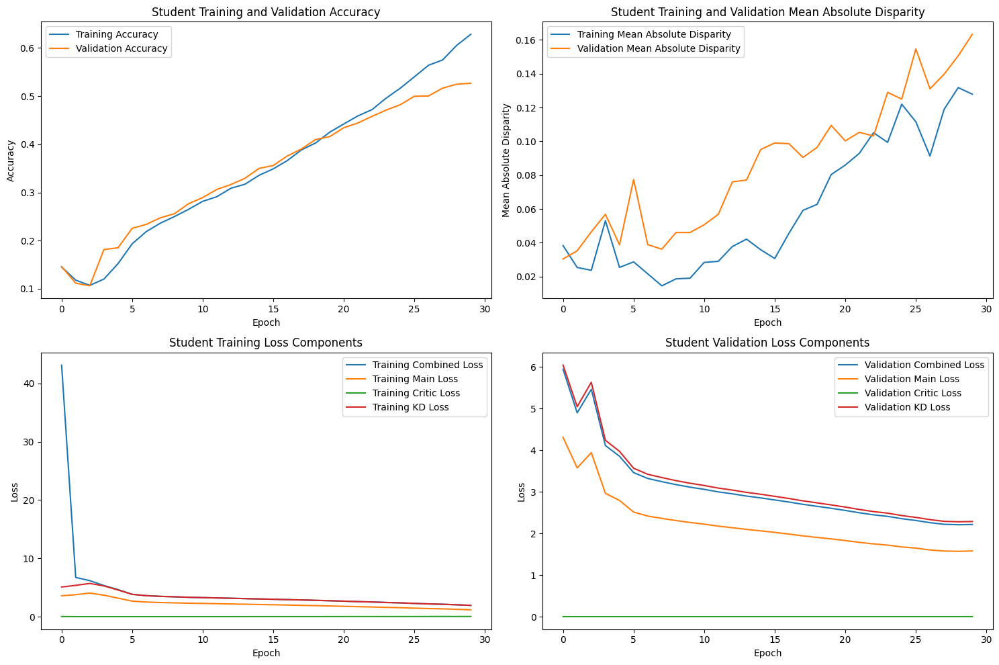

Epoch 31/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 180 - Epoch 31 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.655729, VALIDATION Accuracy: 0.5264
TRAINING Disparity: 0.124233, VALIDATION Disparity: 0.1600
TRAINING Combined Loss: 1.848329, VALIDATION Combined Loss: 2.2176
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.08851520990249317
Class Celebration: Val Disparity = -0.013953488372093037
Class Parade: Val Disparity = 0.03811869575416371
Class Waiter_Or_Waitress: Val Disparity = -0.348936170212766
Class Individual_Sports: Val Disparity = -0.15739418088865498
Class Surgeons: Val Disparity = -0.012454212454212521
Class Spa: Val Disparity = 0.21985815602836878
Class Law_Enforcement: Val Disparity = 0.31824712643678166
Class Business: Val Disparity = -0.05903665814151743
Class Dresses: Val Disparity = -0.6488095238095238
Class Water_Activities: Val Disparity = 0.12524461839530332
Class Picnic: Val Disparity = 0.018518518518518545
Class Rescue

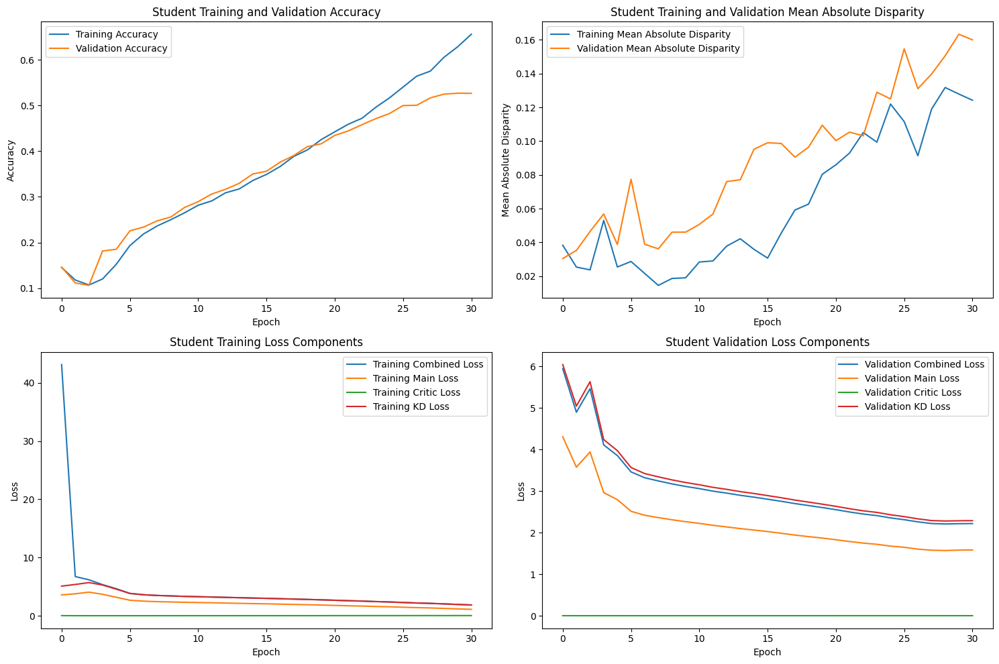

Epoch 32/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 180 - Epoch 32 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.677180, VALIDATION Accuracy: 0.5347
TRAINING Disparity: 0.129506, VALIDATION Disparity: 0.1491
TRAINING Combined Loss: 1.765310, VALIDATION Combined Loss: 2.2037
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.09193670812167931
Class Celebration: Val Disparity = 0.023255813953488413
Class Parade: Val Disparity = -0.01536476659629371
Class Waiter_Or_Waitress: Val Disparity = -0.39148936170212767
Class Individual_Sports: Val Disparity = -0.16788211412675746
Class Surgeons: Val Disparity = -0.07252747252747255
Class Spa: Val Disparity = 0.1985815602836879
Class Law_Enforcement: Val Disparity = 0.22820881226053646
Class Business: Val Disparity = -0.06756180733162825
Class Dresses: Val Disparity = -0.5773809523809526
Class Water_Activities: Val Disparity = 0.1353555120678409
Class Picnic: Val Disparity = 0.12962962962962965
Class Rescue: 

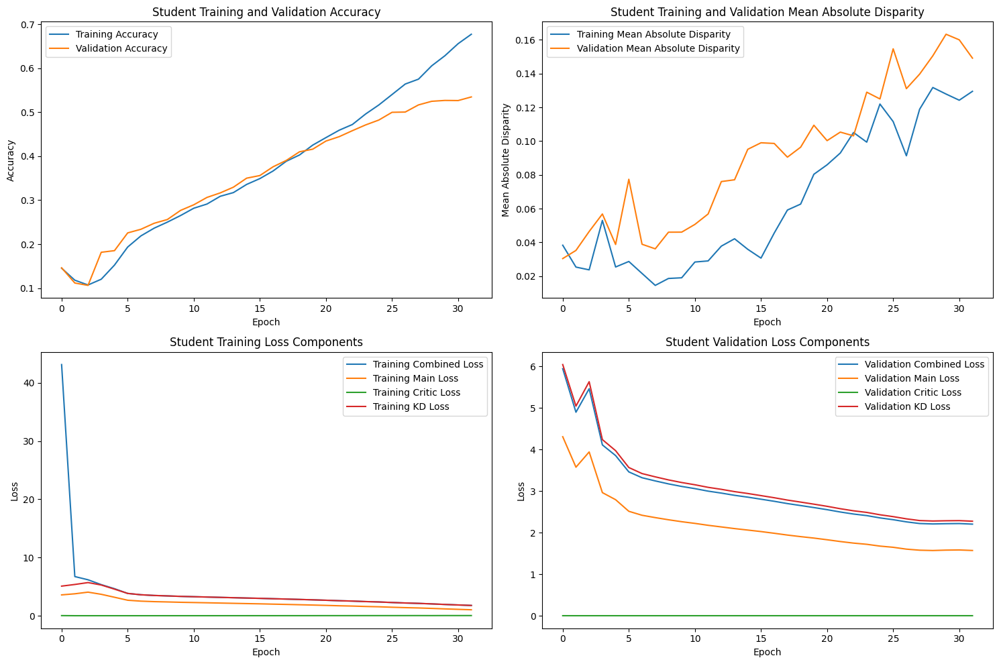

Epoch 33/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 180 - Epoch 33 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.704070, VALIDATION Accuracy: 0.5463
TRAINING Disparity: 0.108580, VALIDATION Disparity: 0.1535
TRAINING Combined Loss: 1.681497, VALIDATION Combined Loss: 2.1953
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.1289192503065335
Class Celebration: Val Disparity = -0.013953488372092981
Class Parade: Val Disparity = 0.028031902416138954
Class Waiter_Or_Waitress: Val Disparity = -0.43546099290780144
Class Individual_Sports: Val Disparity = -0.17859559431621685
Class Surgeons: Val Disparity = -0.06959706959706963
Class Spa: Val Disparity = 0.1985815602836879
Class Law_Enforcement: Val Disparity = 0.21815134099616856
Class Business: Val Disparity = -0.02941176470588236
Class Dresses: Val Disparity = -0.6488095238095238
Class Water_Activities: Val Disparity = 0.14687975646879758
Class Picnic: Val Disparity = 0.01851851851851849
Class Rescue:

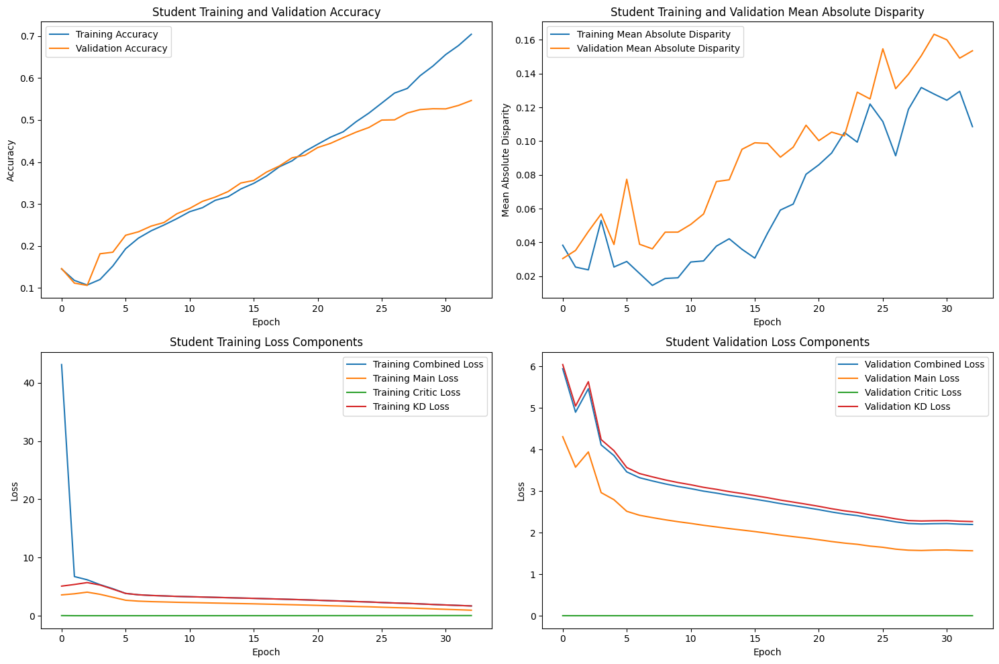

Epoch 34/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 180 - Epoch 34 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.740355, VALIDATION Accuracy: 0.5335
TRAINING Disparity: 0.161986, VALIDATION Disparity: 0.1615
TRAINING Combined Loss: 1.575587, VALIDATION Combined Loss: 2.2270
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.1289192503065335
Class Celebration: Val Disparity = -0.013953488372092981
Class Parade: Val Disparity = 0.028031902416138954
Class Waiter_Or_Waitress: Val Disparity = -0.43546099290780144
Class Individual_Sports: Val Disparity = -0.17859559431621685
Class Surgeons: Val Disparity = -0.06959706959706963
Class Spa: Val Disparity = 0.1985815602836879
Class Law_Enforcement: Val Disparity = 0.21815134099616856
Class Business: Val Disparity = -0.02941176470588236
Class Dresses: Val Disparity = -0.6488095238095238
Class Water_Activities: Val Disparity = 0.14687975646879758
Class Picnic: Val Disparity = 0.01851851851851849
Class Rescue:

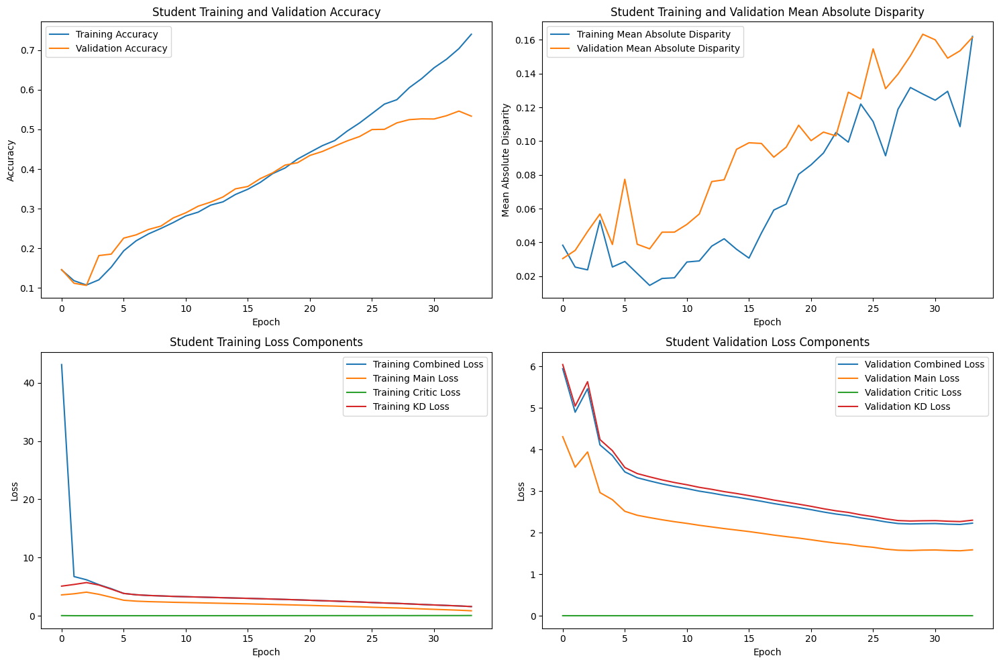

Epoch 35/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.80it/s]



STUDENT - Lambda 180 - Epoch 35 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.765278, VALIDATION Accuracy: 0.5472
TRAINING Disparity: 0.119874, VALIDATION Disparity: 0.1260
TRAINING Combined Loss: 1.485905, VALIDATION Combined Loss: 2.2023
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.1289192503065335
Class Celebration: Val Disparity = -0.013953488372092981
Class Parade: Val Disparity = 0.028031902416138954
Class Waiter_Or_Waitress: Val Disparity = -0.43546099290780144
Class Individual_Sports: Val Disparity = -0.17859559431621685
Class Surgeons: Val Disparity = -0.06959706959706963
Class Spa: Val Disparity = 0.1985815602836879
Class Law_Enforcement: Val Disparity = 0.21815134099616856
Class Business: Val Disparity = -0.02941176470588236
Class Dresses: Val Disparity = -0.6488095238095238
Class Water_Activities: Val Disparity = 0.14687975646879758
Class Picnic: Val Disparity = 0.01851851851851849
Class Rescue:

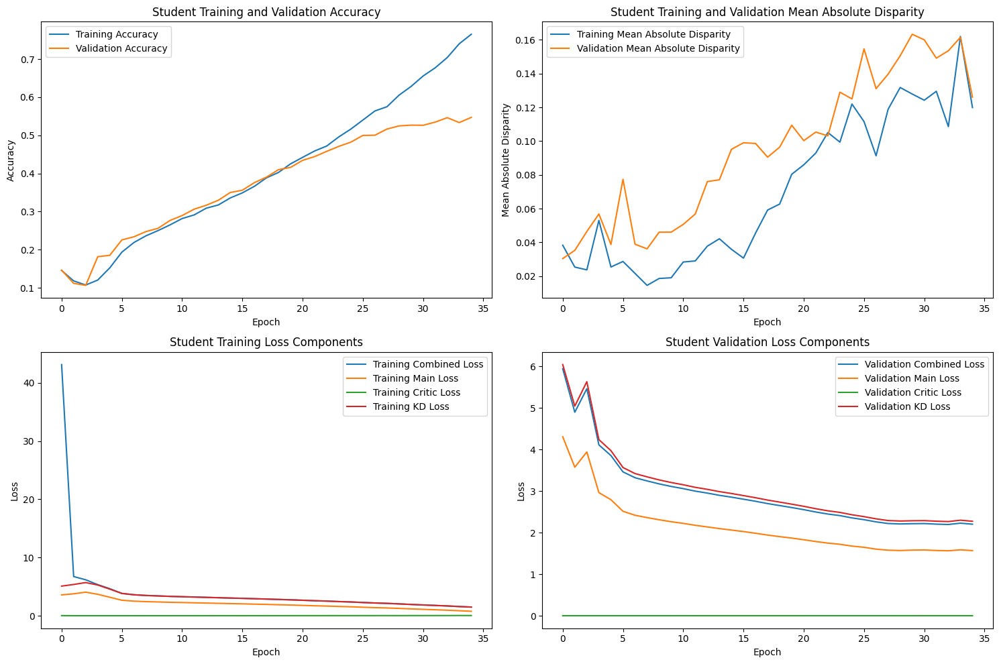

Epoch 36/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.80it/s]



STUDENT - Lambda 180 - Epoch 36 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.797589, VALIDATION Accuracy: 0.5435
TRAINING Disparity: 0.103843, VALIDATION Disparity: 0.1554
TRAINING Combined Loss: 1.385820, VALIDATION Combined Loss: 2.2179
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.1289192503065335
Class Celebration: Val Disparity = -0.013953488372092981
Class Parade: Val Disparity = 0.028031902416138954
Class Waiter_Or_Waitress: Val Disparity = -0.43546099290780144
Class Individual_Sports: Val Disparity = -0.17859559431621685
Class Surgeons: Val Disparity = -0.06959706959706963
Class Spa: Val Disparity = 0.1985815602836879
Class Law_Enforcement: Val Disparity = 0.21815134099616856
Class Business: Val Disparity = -0.02941176470588236
Class Dresses: Val Disparity = -0.6488095238095238
Class Water_Activities: Val Disparity = 0.14687975646879758
Class Picnic: Val Disparity = 0.01851851851851849
Class Rescue:

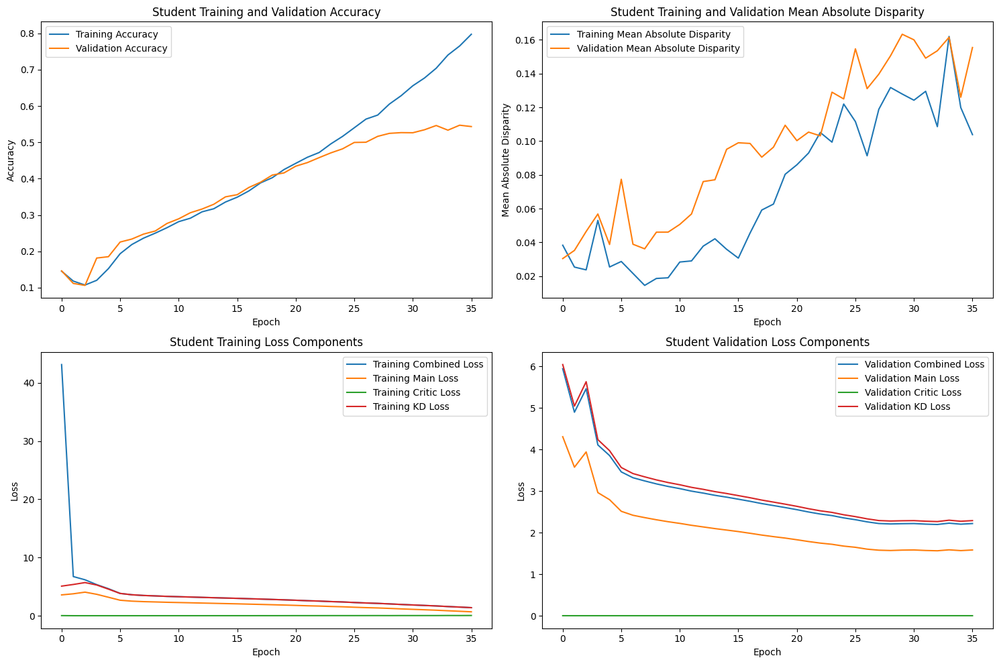

Epoch 37/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.76it/s]



STUDENT - Lambda 180 - Epoch 37 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.826119, VALIDATION Accuracy: 0.5538
TRAINING Disparity: 0.127115, VALIDATION Disparity: 0.1463
TRAINING Combined Loss: 1.313797, VALIDATION Combined Loss: 2.2662
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.1289192503065335
Class Celebration: Val Disparity = -0.013953488372092981
Class Parade: Val Disparity = 0.028031902416138954
Class Waiter_Or_Waitress: Val Disparity = -0.43546099290780144
Class Individual_Sports: Val Disparity = -0.17859559431621685
Class Surgeons: Val Disparity = -0.06959706959706963
Class Spa: Val Disparity = 0.1985815602836879
Class Law_Enforcement: Val Disparity = 0.21815134099616856
Class Business: Val Disparity = -0.02941176470588236
Class Dresses: Val Disparity = -0.6488095238095238
Class Water_Activities: Val Disparity = 0.14687975646879758
Class Picnic: Val Disparity = 0.01851851851851849
Class Rescue:

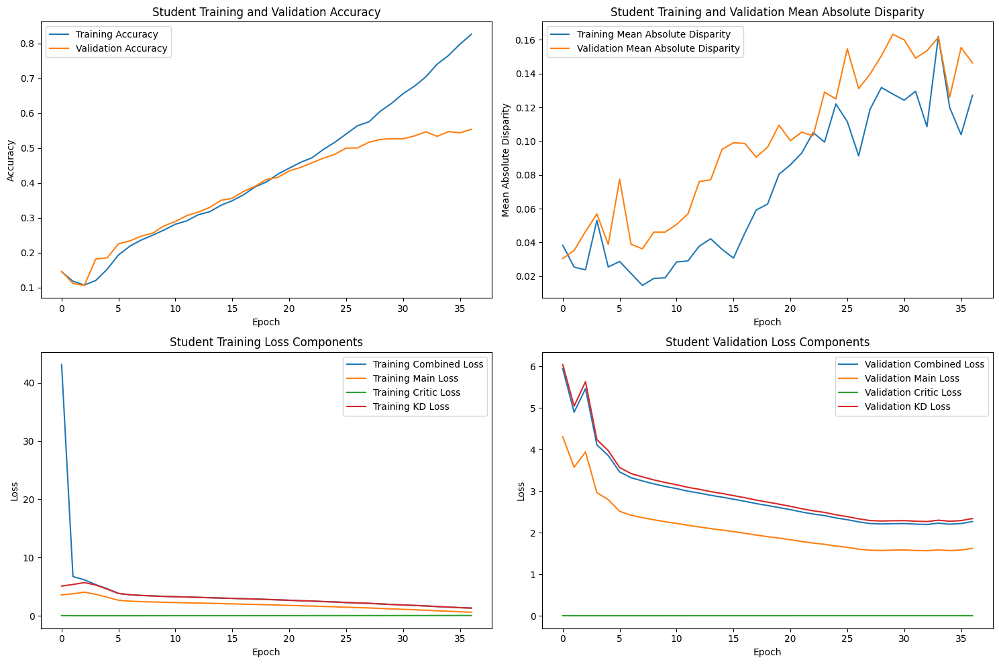

Epoch 38/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.76it/s]



STUDENT - Lambda 180 - Epoch 38 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.846836, VALIDATION Accuracy: 0.5580
TRAINING Disparity: 0.082499, VALIDATION Disparity: 0.1434
TRAINING Combined Loss: 1.236870, VALIDATION Combined Loss: 2.2610
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.1289192503065335
Class Celebration: Val Disparity = -0.013953488372092981
Class Parade: Val Disparity = 0.028031902416138954
Class Waiter_Or_Waitress: Val Disparity = -0.43546099290780144
Class Individual_Sports: Val Disparity = -0.17859559431621685
Class Surgeons: Val Disparity = -0.06959706959706963
Class Spa: Val Disparity = 0.1985815602836879
Class Law_Enforcement: Val Disparity = 0.21815134099616856
Class Business: Val Disparity = -0.02941176470588236
Class Dresses: Val Disparity = -0.6488095238095238
Class Water_Activities: Val Disparity = 0.14687975646879758
Class Picnic: Val Disparity = 0.01851851851851849
Class Rescue:

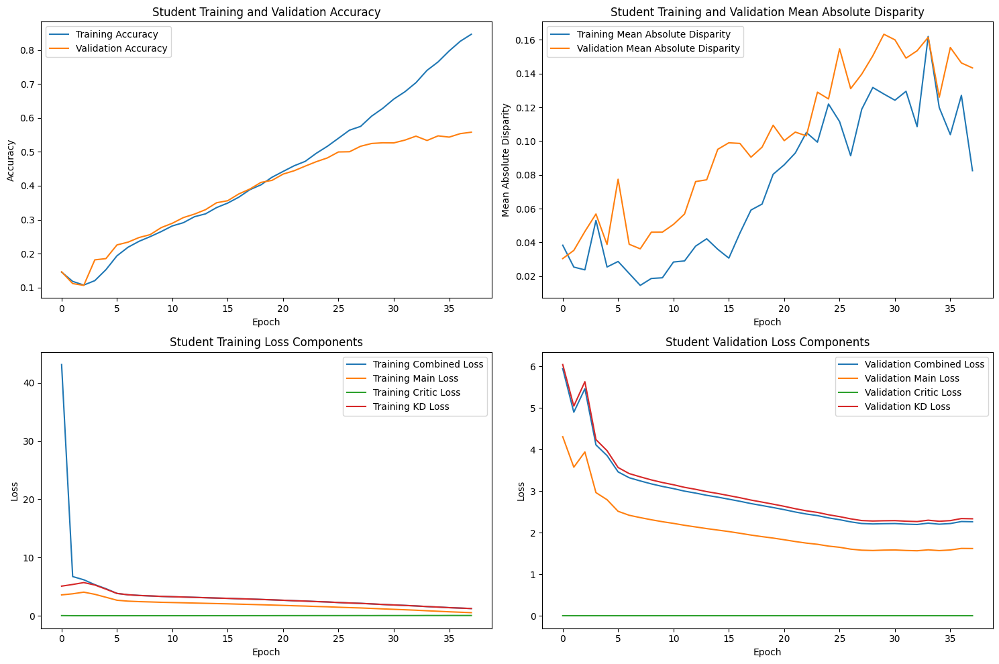

Epoch 39/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 180 - Epoch 39 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.867901, VALIDATION Accuracy: 0.5469
TRAINING Disparity: 0.092835, VALIDATION Disparity: 0.1338
TRAINING Combined Loss: 1.172030, VALIDATION Combined Loss: 2.4370
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.1289192503065335
Class Celebration: Val Disparity = -0.013953488372092981
Class Parade: Val Disparity = 0.028031902416138954
Class Waiter_Or_Waitress: Val Disparity = -0.43546099290780144
Class Individual_Sports: Val Disparity = -0.17859559431621685
Class Surgeons: Val Disparity = -0.06959706959706963
Class Spa: Val Disparity = 0.1985815602836879
Class Law_Enforcement: Val Disparity = 0.21815134099616856
Class Business: Val Disparity = -0.02941176470588236
Class Dresses: Val Disparity = -0.6488095238095238
Class Water_Activities: Val Disparity = 0.14687975646879758
Class Picnic: Val Disparity = 0.01851851851851849
Class Rescue:

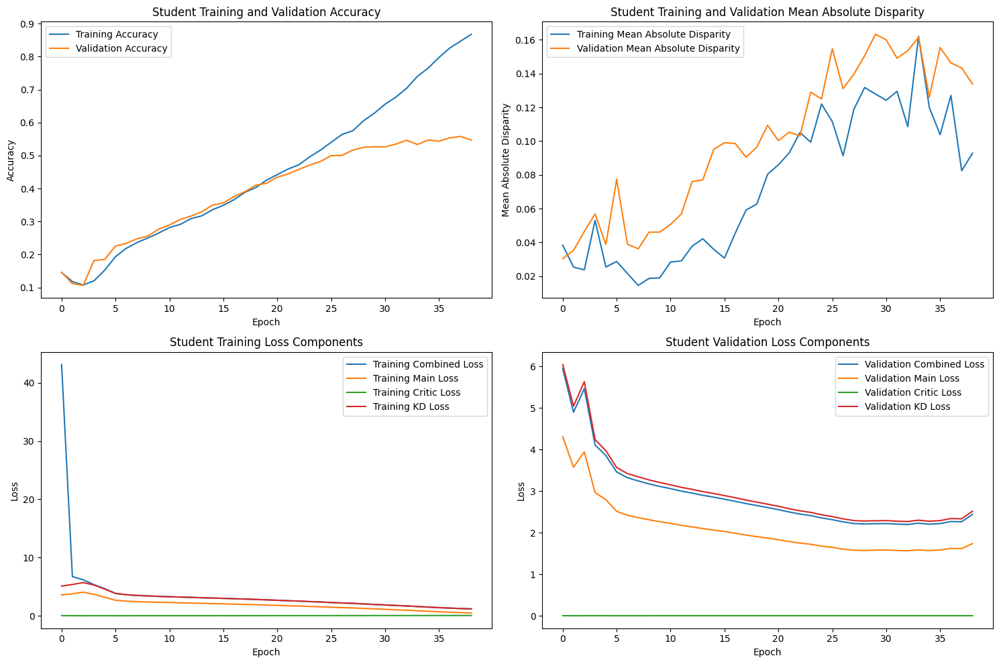

Epoch 40/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.73it/s]



STUDENT - Lambda 180 - Epoch 40 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.912076, VALIDATION Accuracy: 0.5660
TRAINING Disparity: 0.064113, VALIDATION Disparity: 0.1418
TRAINING Combined Loss: 1.051016, VALIDATION Combined Loss: 2.2155
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.1289192503065335
Class Celebration: Val Disparity = -0.013953488372092981
Class Parade: Val Disparity = 0.028031902416138954
Class Waiter_Or_Waitress: Val Disparity = -0.43546099290780144
Class Individual_Sports: Val Disparity = -0.17859559431621685
Class Surgeons: Val Disparity = -0.06959706959706963
Class Spa: Val Disparity = 0.1985815602836879
Class Law_Enforcement: Val Disparity = 0.21815134099616856
Class Business: Val Disparity = -0.02941176470588236
Class Dresses: Val Disparity = -0.6488095238095238
Class Water_Activities: Val Disparity = 0.14687975646879758
Class Picnic: Val Disparity = 0.01851851851851849
Class Rescue:

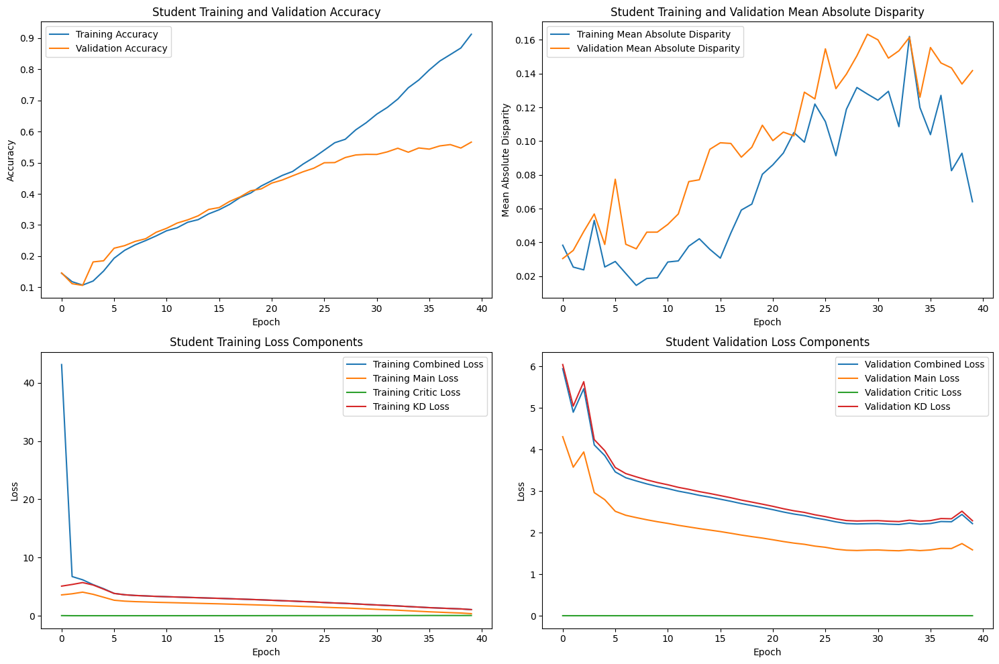

Epoch 41/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.81it/s]



STUDENT - Lambda 180 - Epoch 41 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.925791, VALIDATION Accuracy: 0.5685
TRAINING Disparity: 0.034835, VALIDATION Disparity: 0.1381
TRAINING Combined Loss: 0.998128, VALIDATION Combined Loss: 2.2441
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.1289192503065335
Class Celebration: Val Disparity = -0.013953488372092981
Class Parade: Val Disparity = 0.028031902416138954
Class Waiter_Or_Waitress: Val Disparity = -0.43546099290780144
Class Individual_Sports: Val Disparity = -0.17859559431621685
Class Surgeons: Val Disparity = -0.06959706959706963
Class Spa: Val Disparity = 0.1985815602836879
Class Law_Enforcement: Val Disparity = 0.21815134099616856
Class Business: Val Disparity = -0.02941176470588236
Class Dresses: Val Disparity = -0.6488095238095238
Class Water_Activities: Val Disparity = 0.14687975646879758
Class Picnic: Val Disparity = 0.01851851851851849
Class Rescue:

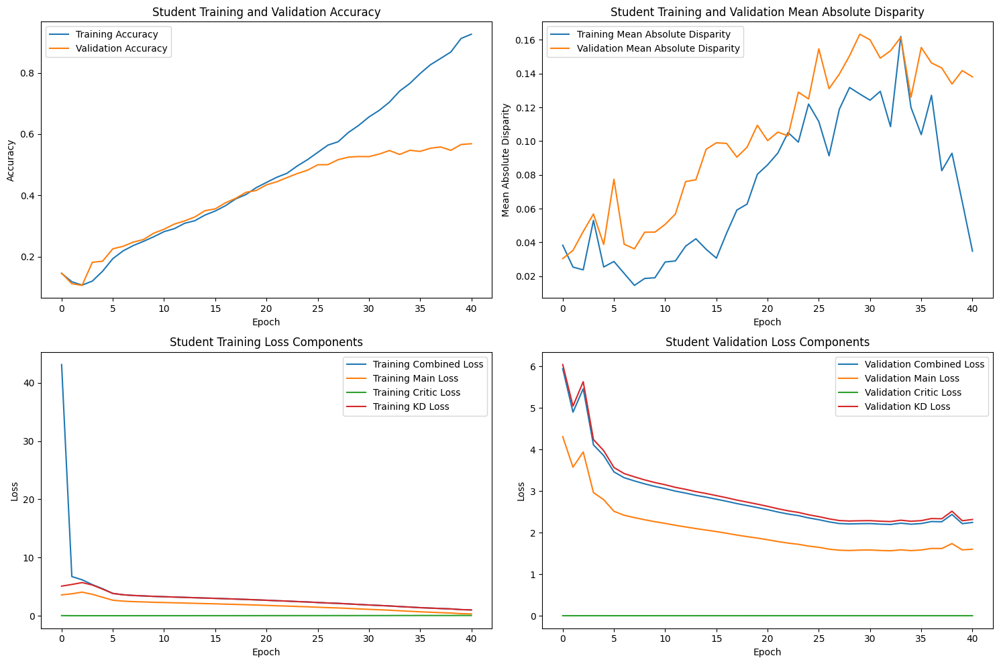

Epoch 42/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 180 - Epoch 42 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.932195, VALIDATION Accuracy: 0.5700
TRAINING Disparity: 0.042236, VALIDATION Disparity: 0.1426
TRAINING Combined Loss: 0.980459, VALIDATION Combined Loss: 2.2090
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.1289192503065335
Class Celebration: Val Disparity = -0.013953488372092981
Class Parade: Val Disparity = 0.028031902416138954
Class Waiter_Or_Waitress: Val Disparity = -0.43546099290780144
Class Individual_Sports: Val Disparity = -0.17859559431621685
Class Surgeons: Val Disparity = -0.06959706959706963
Class Spa: Val Disparity = 0.1985815602836879
Class Law_Enforcement: Val Disparity = 0.21815134099616856
Class Business: Val Disparity = -0.02941176470588236
Class Dresses: Val Disparity = -0.6488095238095238
Class Water_Activities: Val Disparity = 0.14687975646879758
Class Picnic: Val Disparity = 0.01851851851851849
Class Rescue:

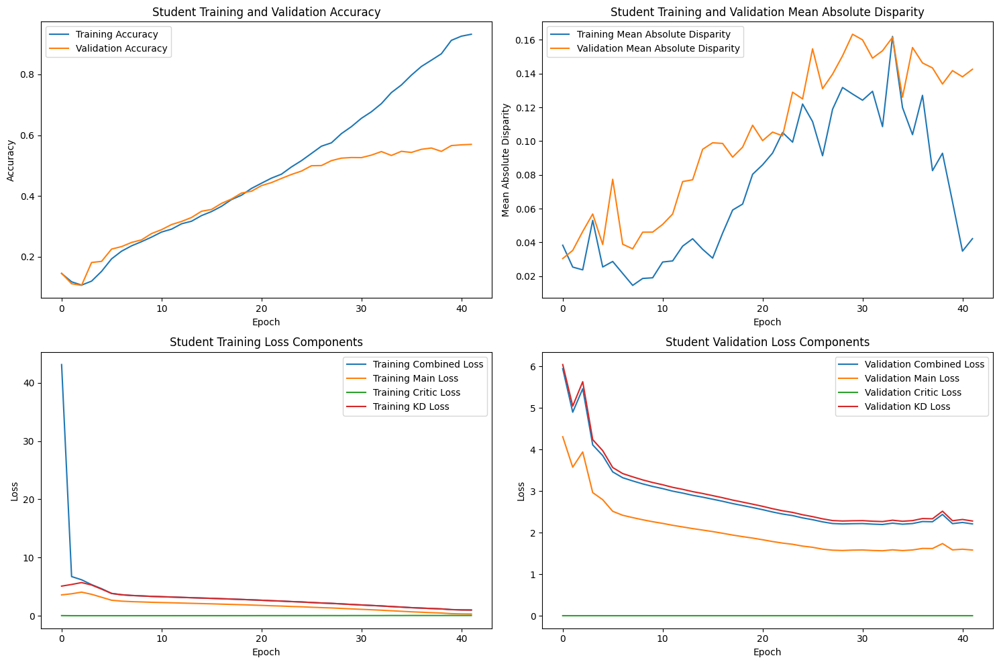

Epoch 43/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.73it/s]


Early stopping triggered at epoch 43
Finished Training STUDENT with lambda value of 180. Best epoch number: 33
Training Student with Lambda Value of 160


Epoch 1/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 160 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.132157, VALIDATION Accuracy: 0.0693
TRAINING Disparity: 0.008831, VALIDATION Disparity: 0.0279
TRAINING Combined Loss: 38.978895, VALIDATION Combined Loss: 7.7006
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.006796286565072696
Class Celebration: Val Disparity = -0.023255813953488375
Class Parade: Val Disparity = 0.060168895144264656
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.04229005337944516
Class Surgeons: Val Disparity = 0.0073260073260073555
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = -0.051484674329501906
Class Business: Val Disparity = -0.004262574595055406
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performanc

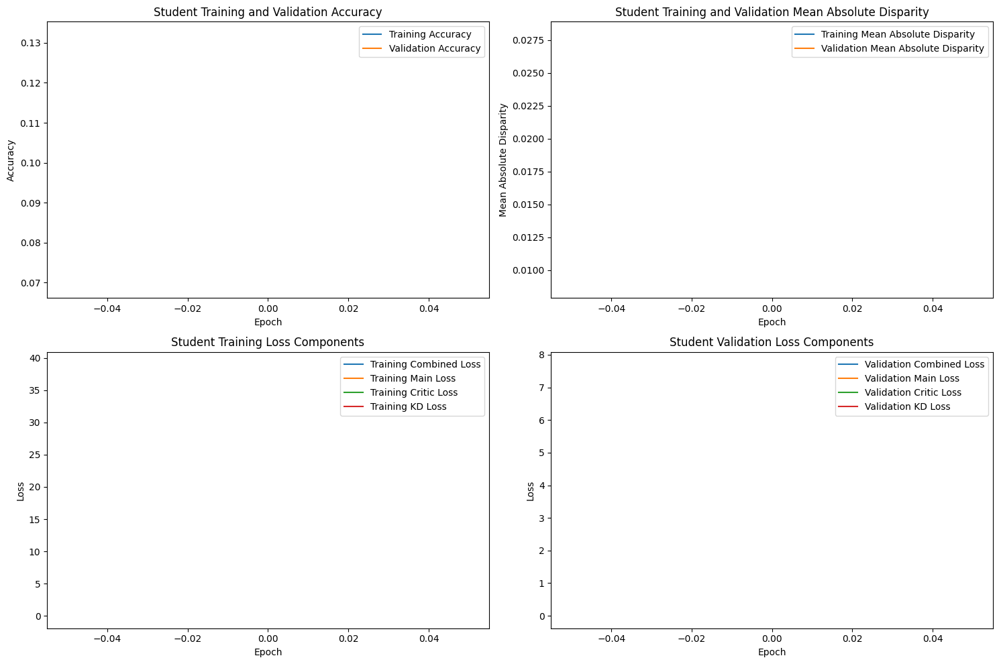

Epoch 2/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.78it/s]



STUDENT - Lambda 160 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.078935, VALIDATION Accuracy: 0.0940
TRAINING Disparity: 0.012813, VALIDATION Disparity: 0.0379
TRAINING Combined Loss: 5.726134, VALIDATION Combined Loss: 4.6597
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.033374204472470415
Class Celebration: Val Disparity = -0.009302325581395349
Class Parade: Val Disparity = -0.07283603096410979
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.05973235095105631
Class Surgeons: Val Disparity = 0.09010989010989023
Class Spa: Val Disparity = -0.0425531914893617
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = -0.018518518518518517
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.009615384615384616
Class

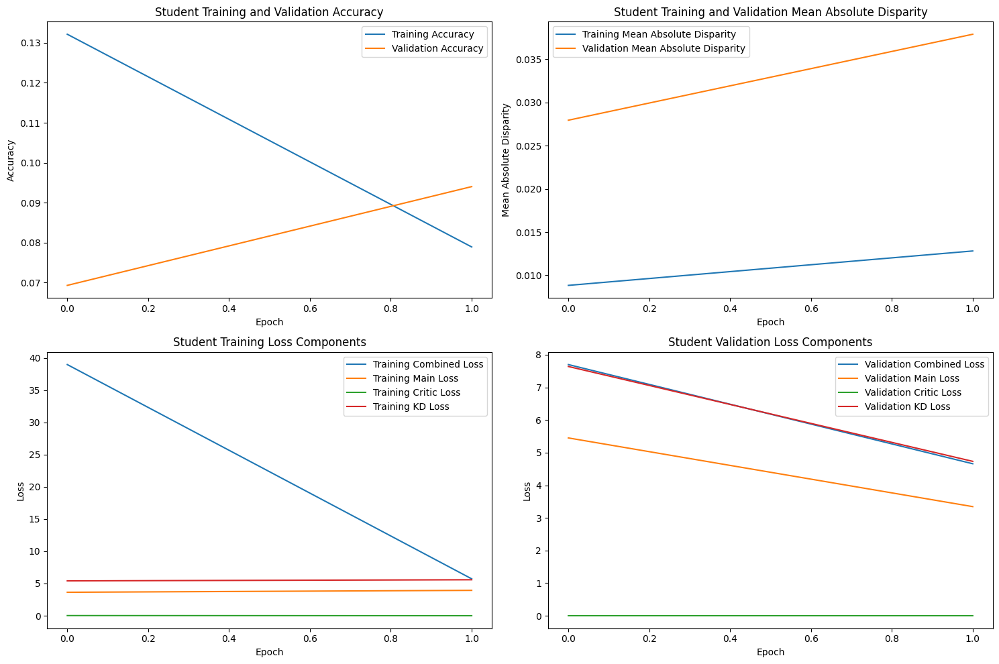

Epoch 3/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.78it/s]



STUDENT - Lambda 160 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.093075, VALIDATION Accuracy: 0.1091
TRAINING Disparity: 0.021160, VALIDATION Disparity: 0.0570
TRAINING Combined Loss: 5.433069, VALIDATION Combined Loss: 4.9058
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.033374204472470415
Class Celebration: Val Disparity = -0.009302325581395349
Class Parade: Val Disparity = -0.07283603096410979
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.05973235095105631
Class Surgeons: Val Disparity = 0.09010989010989023
Class Spa: Val Disparity = -0.0425531914893617
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = -0.018518518518518517
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.009615384615384616
Class

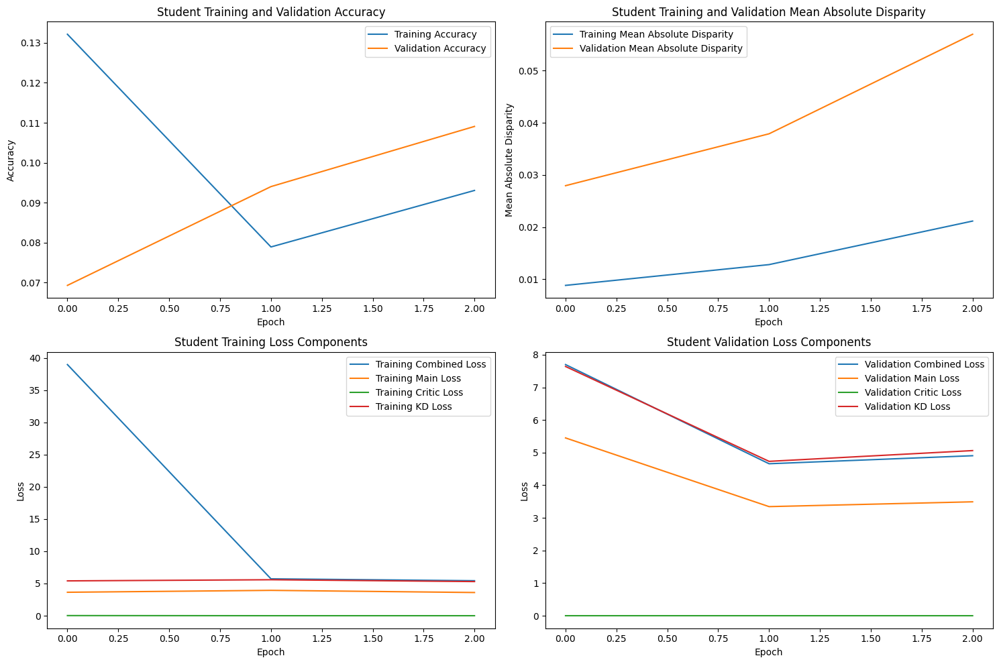

Epoch 4/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.82it/s]



STUDENT - Lambda 160 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.130170, VALIDATION Accuracy: 0.1426
TRAINING Disparity: 0.025793, VALIDATION Disparity: 0.0389
TRAINING Combined Loss: 4.646950, VALIDATION Combined Loss: 3.8451
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.013604250598470258
Class Celebration: Val Disparity = -0.020930232558139528
Class Parade: Val Disparity = 0.027914614121510667
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.011089391775054525
Class Surgeons: Val Disparity = 0.024908424908424875
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.006944444444444444
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.16666666666666666
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_

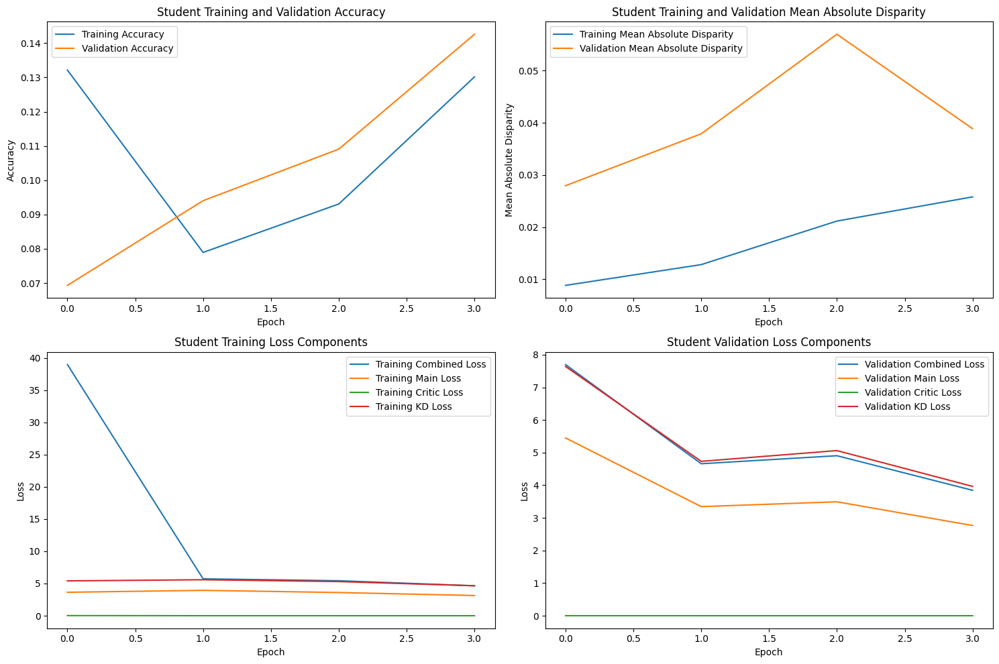

Epoch 5/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.75it/s]



STUDENT - Lambda 160 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.163735, VALIDATION Accuracy: 0.1801
TRAINING Disparity: 0.023544, VALIDATION Disparity: 0.0422
TRAINING Combined Loss: 4.006045, VALIDATION Combined Loss: 3.6024
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.0335143340923687
Class Celebration: Val Disparity = 0.002325581395348837
Class Parade: Val Disparity = 0.03811869575416374
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.006728817382151711
Class Surgeons: Val Disparity = 0.06813186813186814
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.047619047619047616
Class Picnic: Val Disparity = 0.16666666666666666
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Ente

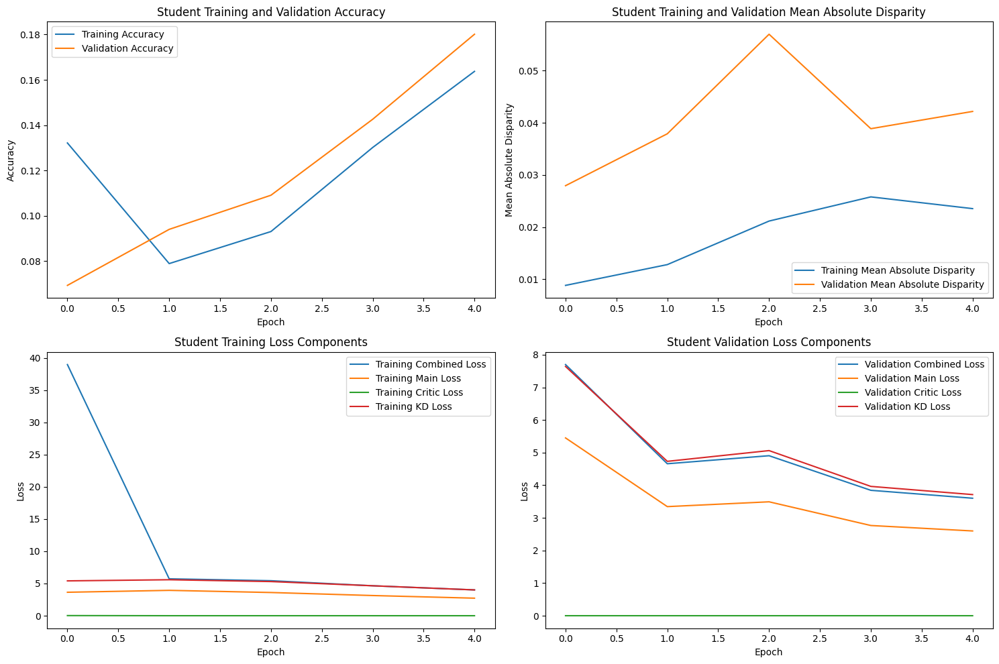

Epoch 6/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 160 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.188522, VALIDATION Accuracy: 0.2071
TRAINING Disparity: 0.015729, VALIDATION Disparity: 0.0318
TRAINING Combined Loss: 3.727989, VALIDATION Combined Loss: 3.4600
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.024008874875926955
Class Celebration: Val Disparity = -0.004651162790697678
Class Parade: Val Disparity = 0.08773164438189066
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.04653785429666943
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.05207653837790818
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: Val Disparity = 0.00

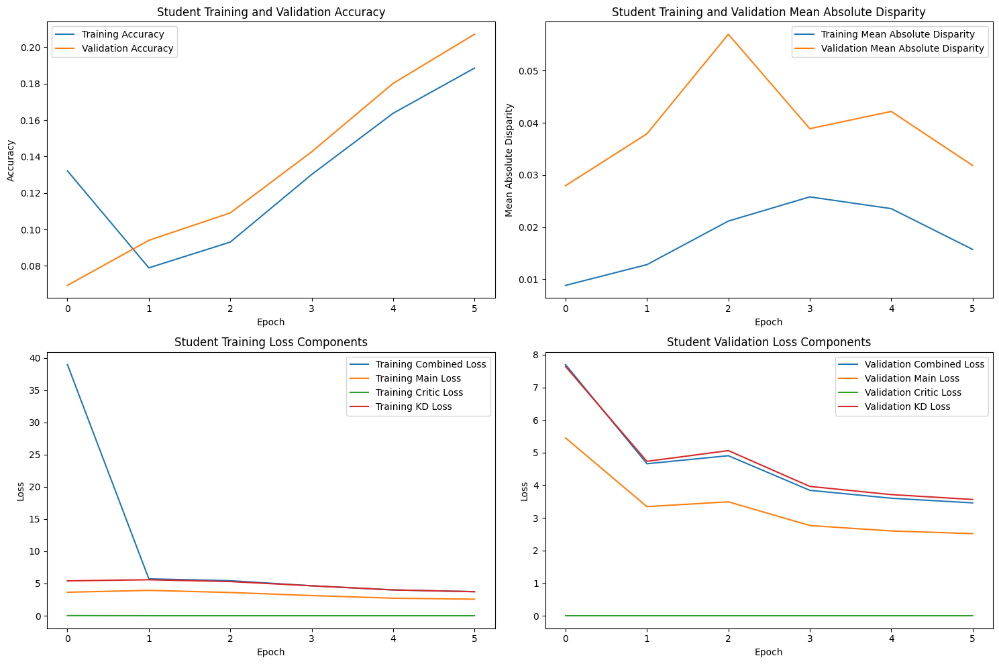

Epoch 7/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 160 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.207504, VALIDATION Accuracy: 0.1861
TRAINING Disparity: 0.011255, VALIDATION Disparity: 0.0341
TRAINING Combined Loss: 3.618928, VALIDATION Combined Loss: 3.7992
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.024008874875926955
Class Celebration: Val Disparity = -0.004651162790697678
Class Parade: Val Disparity = 0.08773164438189066
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.04653785429666943
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.05207653837790818
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: Val Disparity = 0.00

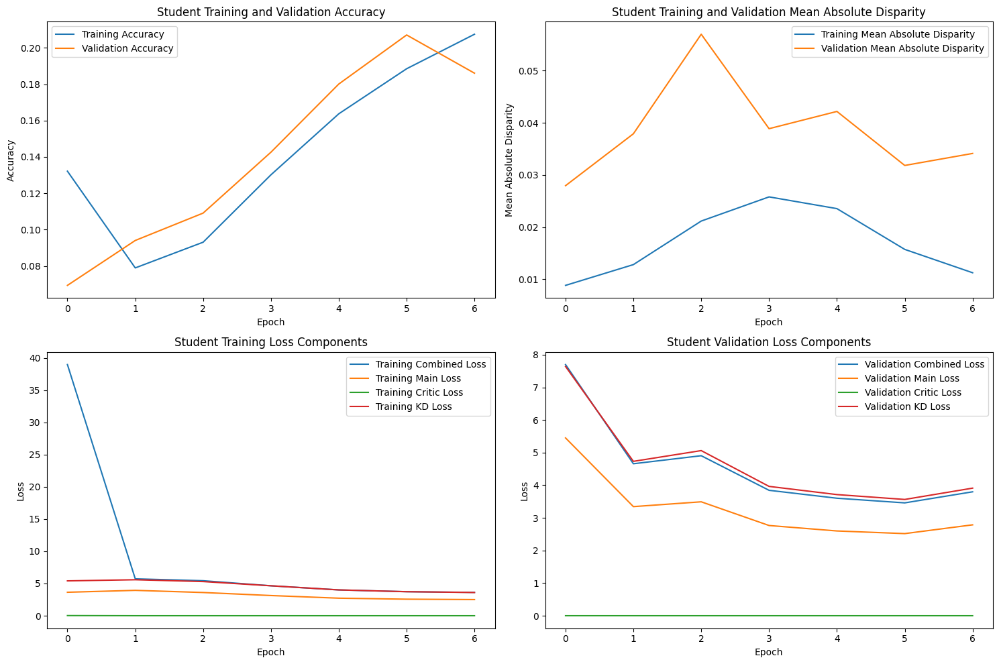

Epoch 8/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.76it/s]



STUDENT - Lambda 160 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.204803, VALIDATION Accuracy: 0.2105
TRAINING Disparity: 0.019351, VALIDATION Disparity: 0.0390
TRAINING Combined Loss: 3.774283, VALIDATION Combined Loss: 3.3881
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.0580720499795645
Class Celebration: Val Disparity = -0.002325581395348837
Class Parade: Val Disparity = 0.03729767769176634
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.08224945492820085
Class Surgeons: Val Disparity = 0.025641025641025644
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.00980392156862745
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.034029136768862794
Class Picnic: Val Disparity = 0.14814814814814814
Class Rescue: Val Disparity = -0.021739130434782605
Class Cheering: Val Dispari

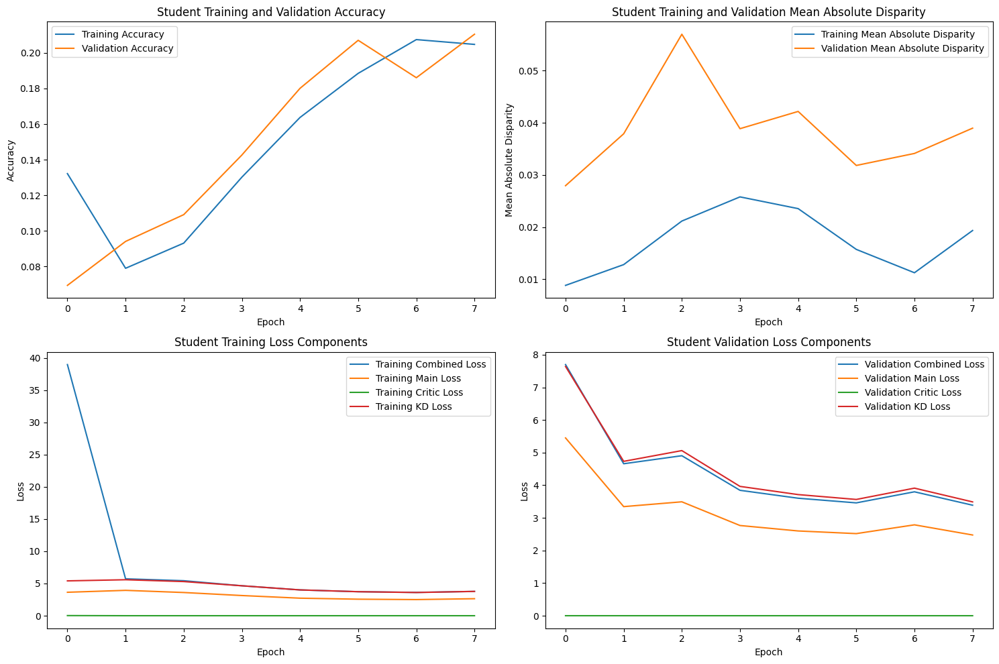

Epoch 9/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 160 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.216146, VALIDATION Accuracy: 0.2128
TRAINING Disparity: 0.014686, VALIDATION Disparity: 0.0595
TRAINING Combined Loss: 3.528485, VALIDATION Combined Loss: 3.3101
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.06553395223915459
Class Celebration: Val Disparity = 0.0069767441860465115
Class Parade: Val Disparity = 0.05125498475252166
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.1035260506728817
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.00980392156862745
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.10404435746901511
Class Picnic: Val Disparity = 0.16666666666666666
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Enter

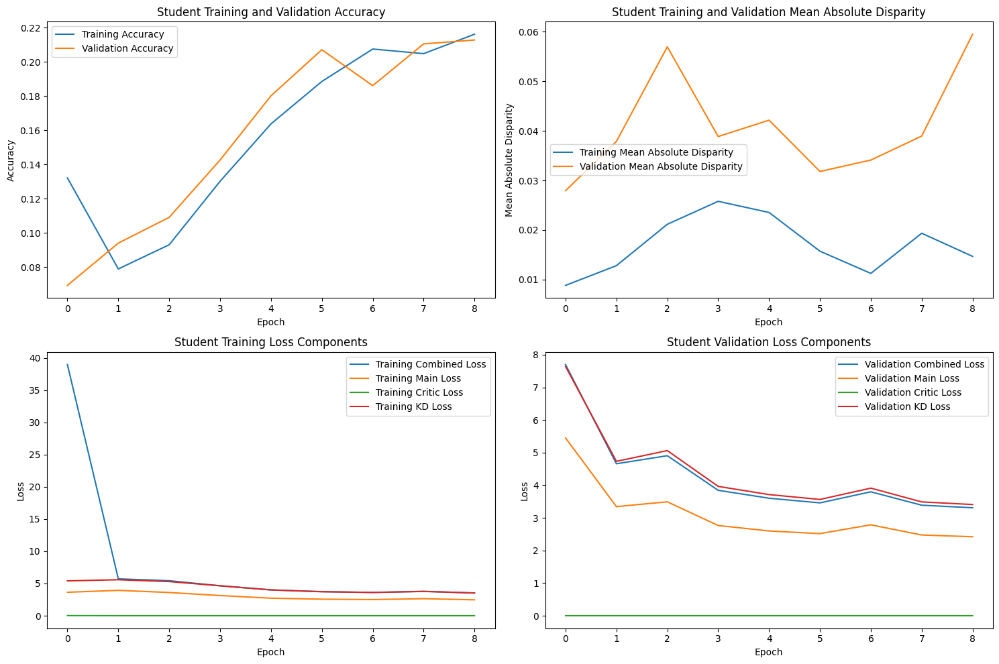

Epoch 10/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.72it/s]



STUDENT - Lambda 160 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.227681, VALIDATION Accuracy: 0.2284
TRAINING Disparity: 0.017253, VALIDATION Disparity: 0.0592
TRAINING Combined Loss: 3.458667, VALIDATION Combined Loss: 3.2634
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.050551760378350075
Class Celebration: Val Disparity = -0.0023255813953488354
Class Parade: Val Disparity = 0.08257095941825005
Class Waiter_Or_Waitress: Val Disparity = 0.0014184397163120518
Class Individual_Sports: Val Disparity = 0.06461920156379222
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = -0.014066496163682864
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.11350293542074369
Class Picnic: Val Disparity = 0.14814814814814814
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Cla

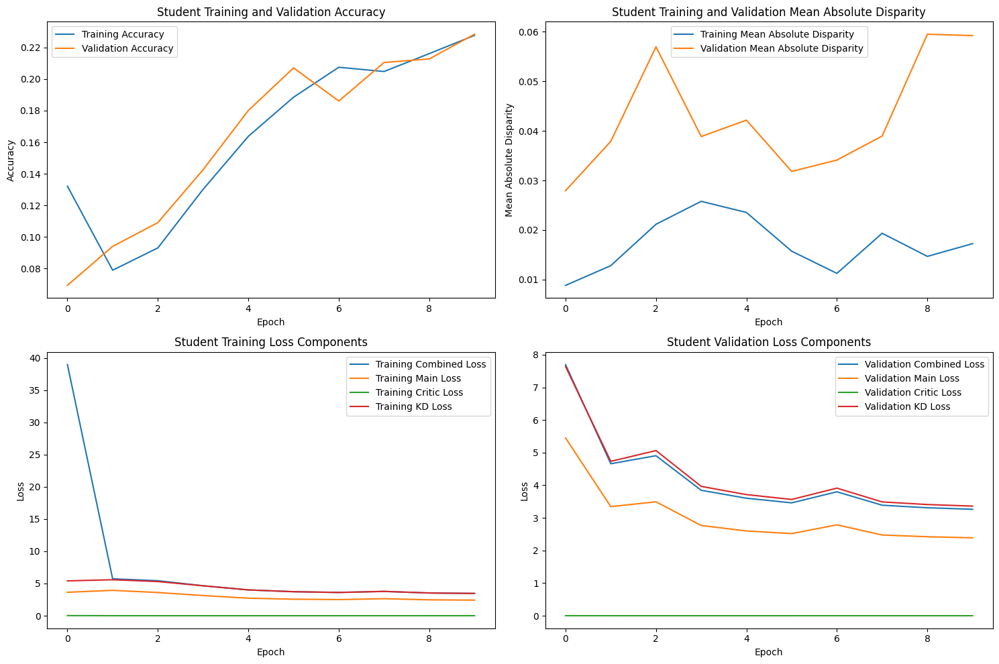

Epoch 11/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.69it/s]



STUDENT - Lambda 160 - Epoch 11 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.239815, VALIDATION Accuracy: 0.2381
TRAINING Disparity: 0.019408, VALIDATION Disparity: 0.0515
TRAINING Combined Loss: 3.409950, VALIDATION Combined Loss: 3.2108
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.046452968996321564
Class Celebration: Val Disparity = 0.02790697674418604
Class Parade: Val Disparity = 0.07037297677691762
Class Waiter_Or_Waitress: Val Disparity = -0.02907801418439719
Class Individual_Sports: Val Disparity = 0.06454401924667319
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = -0.01726342710997443
Class Dresses: Val Disparity = -0.07142857142857144
Class Water_Activities: Val Disparity = 0.09121548162644055
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class P

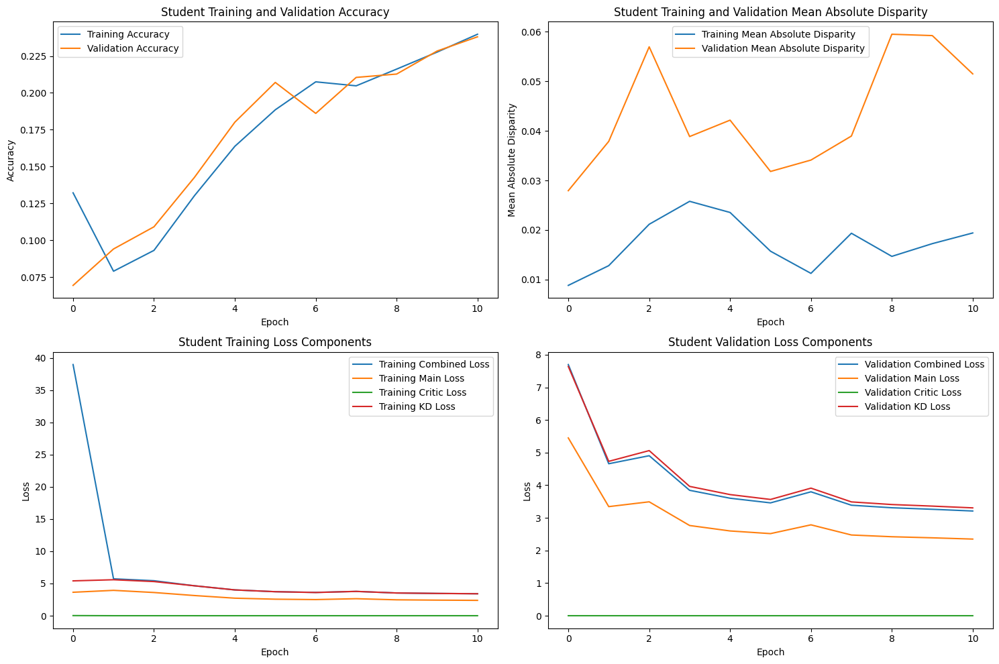

Epoch 12/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 160 - Epoch 12 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.250540, VALIDATION Accuracy: 0.2588
TRAINING Disparity: 0.030891, VALIDATION Disparity: 0.0813
TRAINING Combined Loss: 3.347952, VALIDATION Combined Loss: 3.1710
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.01631342324983942
Class Celebration: Val Disparity = 0.013953488372093016
Class Parade: Val Disparity = 0.055711939948393185
Class Waiter_Or_Waitress: Val Disparity = -0.05673758865248227
Class Individual_Sports: Val Disparity = 0.040147357341553225
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = -0.010296934865900383
Class Business: Val Disparity = -0.12809036658141523
Class Dresses: Val Disparity = -0.19642857142857142
Class Water_Activities: Val Disparity = 0.1171993911719938
Class Picnic: Val Disparity = 0.12962962962962962
Class Rescue: Val Disparity = 0.0
Class Ch

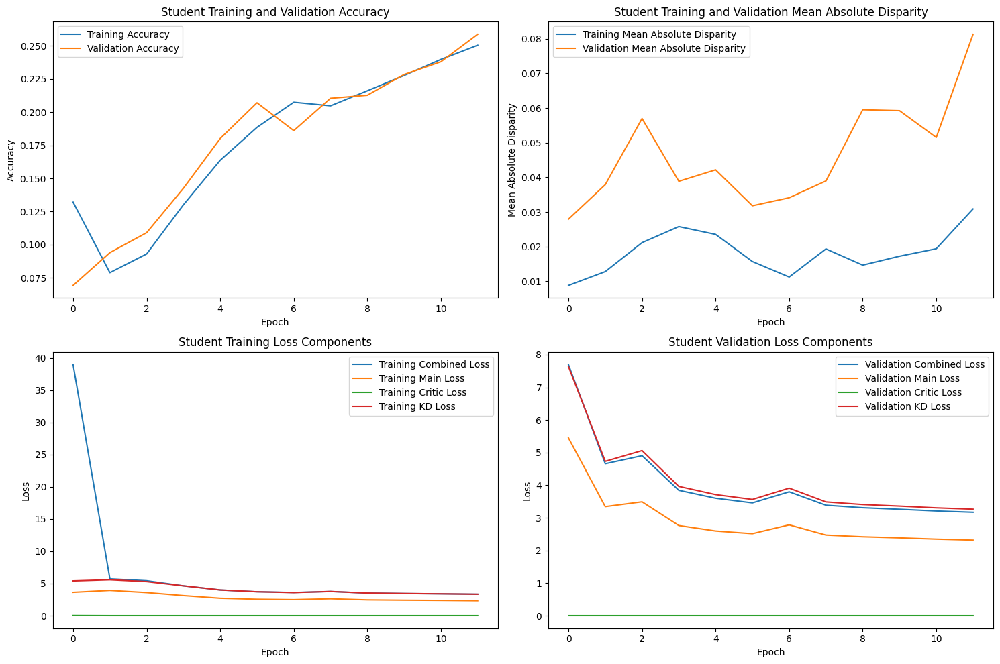

Epoch 13/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 160 - Epoch 13 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.267458, VALIDATION Accuracy: 0.2653
TRAINING Disparity: 0.043759, VALIDATION Disparity: 0.0837
TRAINING Combined Loss: 3.295799, VALIDATION Combined Loss: 3.1223
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.04785426519530578
Class Celebration: Val Disparity = 0.011627906976744182
Class Parade: Val Disparity = 0.07037297677691767
Class Waiter_Or_Waitress: Val Disparity = -0.034042553191489355
Class Individual_Sports: Val Disparity = 0.05774001954740243
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = -0.0067049808429118785
Class Business: Val Disparity = -0.08994032395566925
Class Dresses: Val Disparity = -0.21428571428571427
Class Water_Activities: Val Disparity = 0.15253315938247447
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Dis

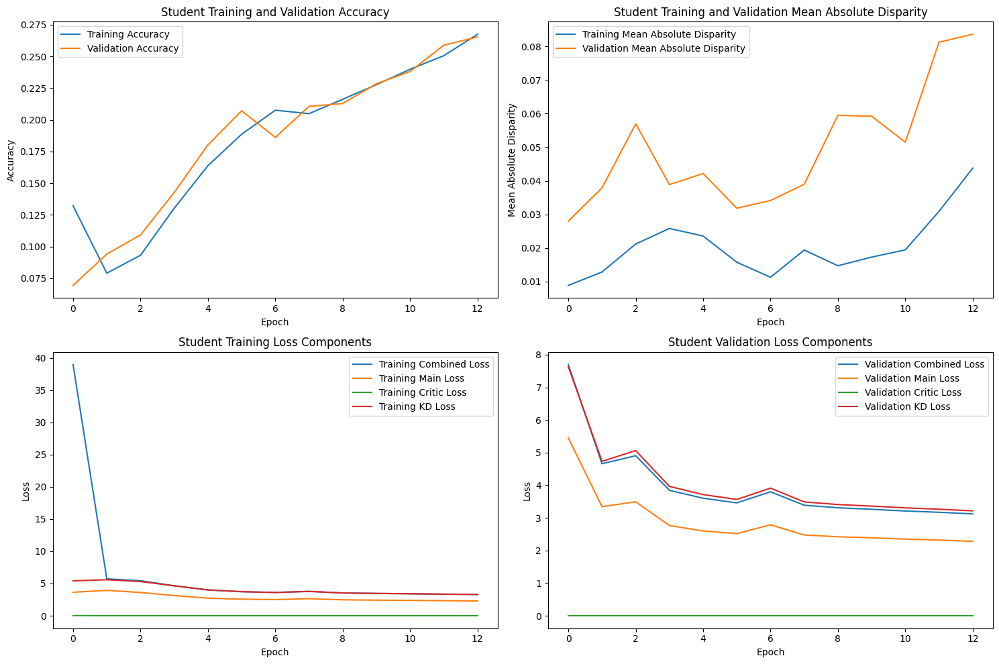

Epoch 14/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.76it/s]



STUDENT - Lambda 160 - Epoch 14 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.280594, VALIDATION Accuracy: 0.2824
TRAINING Disparity: 0.036699, VALIDATION Disparity: 0.0872
TRAINING Combined Loss: 3.234635, VALIDATION Combined Loss: 3.0584
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.001588135692181858
Class Celebration: Val Disparity = -0.03255813953488373
Class Parade: Val Disparity = 0.08761435608726242
Class Waiter_Or_Waitress: Val Disparity = -0.04468085106382977
Class Individual_Sports: Val Disparity = 0.008345237200210576
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.03520114942528735
Class Business: Val Disparity = -0.11487638533674338
Class Dresses: Val Disparity = -0.3154761904761905
Class Water_Activities: Val Disparity = 0.055881713415960155
Class Picnic: Val Disparity = 0.14814814814814814
Class Rescue: Val Disparity = 0.0
Class Chee

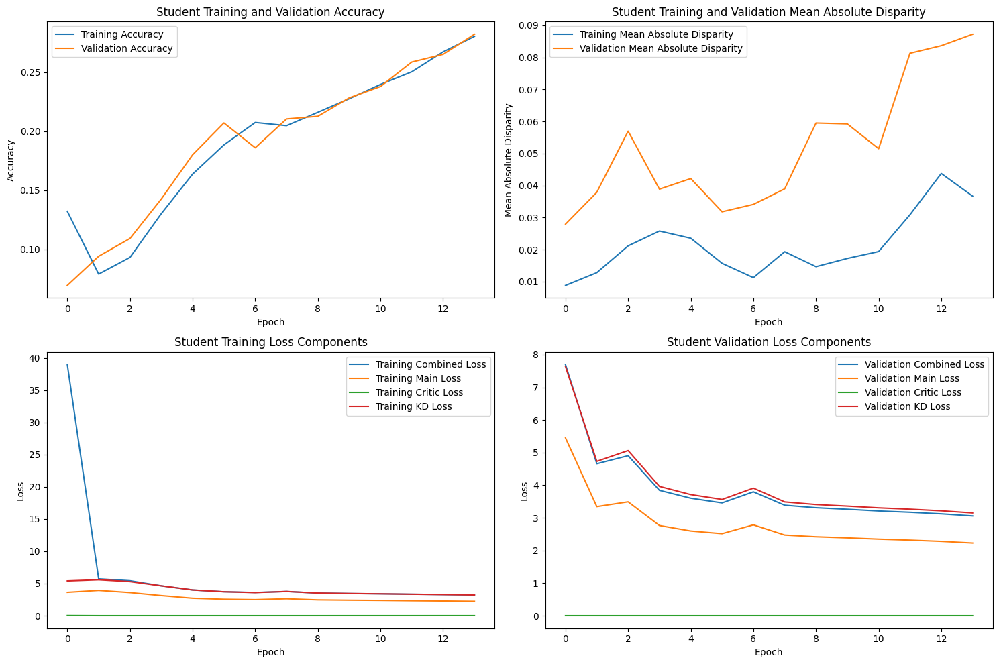

Epoch 15/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.76it/s]



STUDENT - Lambda 160 - Epoch 15 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.303530, VALIDATION Accuracy: 0.3028
TRAINING Disparity: 0.051668, VALIDATION Disparity: 0.1119
TRAINING Combined Loss: 3.167299, VALIDATION Combined Loss: 2.9923
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.046651485957844296
Class Celebration: Val Disparity = -0.07906976744186048
Class Parade: Val Disparity = 0.05383532723434198
Class Waiter_Or_Waitress: Val Disparity = -0.08865248226950354
Class Individual_Sports: Val Disparity = -0.0022554695135704184
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.052681992337164765
Class Business: Val Disparity = -0.13000852514919006
Class Dresses: Val Disparity = -0.4285714285714286
Class Water_Activities: Val Disparity = 0.1308980213089801
Class Picnic: Val Disparity = 0.09259259259259259
Class Rescue: Val Disparity = 0.0
Class Che

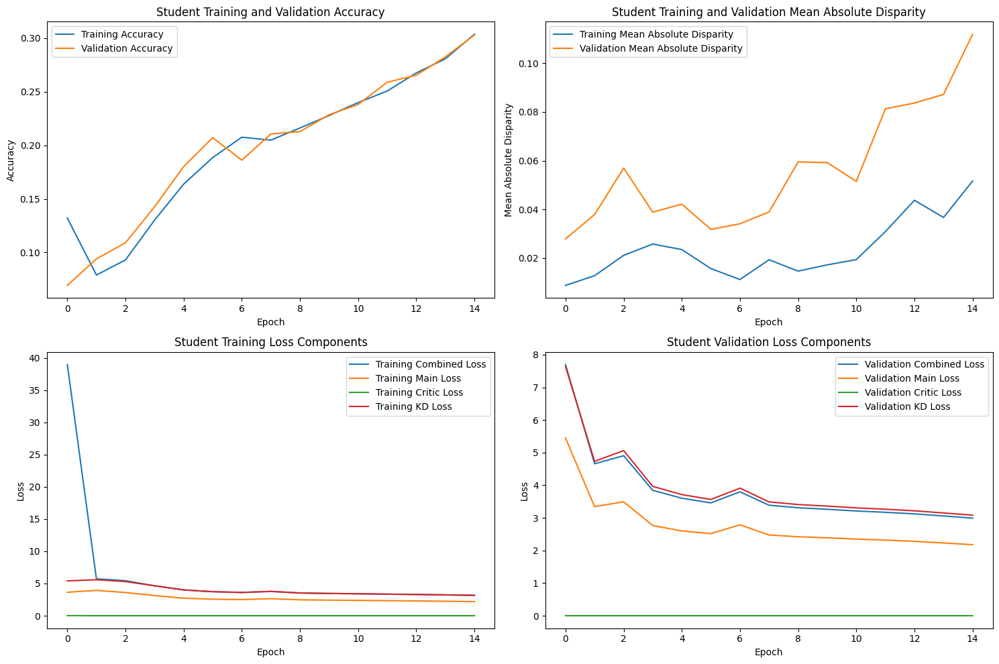

Epoch 16/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.75it/s]



STUDENT - Lambda 160 - Epoch 16 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.326813, VALIDATION Accuracy: 0.3358
TRAINING Disparity: 0.043912, VALIDATION Disparity: 0.1226
TRAINING Combined Loss: 3.089337, VALIDATION Combined Loss: 2.9210
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.03744964091784919
Class Celebration: Val Disparity = -0.055813953488372064
Class Parade: Val Disparity = 0.08374384236453203
Class Waiter_Or_Waitress: Val Disparity = -0.1418439716312057
Class Individual_Sports: Val Disparity = -0.06920532290805204
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.15349616858237547
Class Business: Val Disparity = -0.16794543904518336
Class Dresses: Val Disparity = -0.43452380952380953
Class Water_Activities: Val Disparity = 0.09773863883452921
Class Picnic: Val Disparity = -0.03703703703703703
Class Rescue: Val Disparity = 0.0
Class Chee

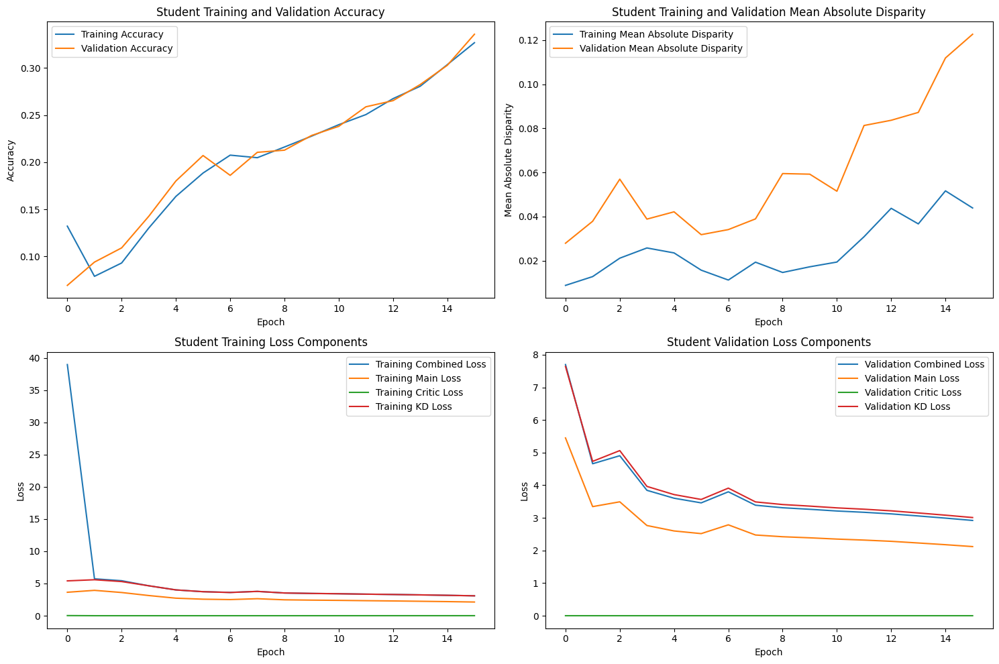

Epoch 17/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.81it/s]



STUDENT - Lambda 160 - Epoch 17 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.346624, VALIDATION Accuracy: 0.3449
TRAINING Disparity: 0.053631, VALIDATION Disparity: 0.1088
TRAINING Combined Loss: 3.003847, VALIDATION Combined Loss: 2.8511
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.030828516377649273
Class Celebration: Val Disparity = -0.0930232558139535
Class Parade: Val Disparity = 0.10602861834388916
Class Waiter_Or_Waitress: Val Disparity = -0.008510638297872297
Class Individual_Sports: Val Disparity = -0.05146229606796482
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.13649425287356326
Class Business: Val Disparity = -0.1395993179880648
Class Dresses: Val Disparity = -0.24642857142857147
Class Water_Activities: Val Disparity = 0.14318330071754715
Class Picnic: Val Disparity = 0.16666666666666666
Class Rescue: Val Disparity = 0.0
Class Cheer

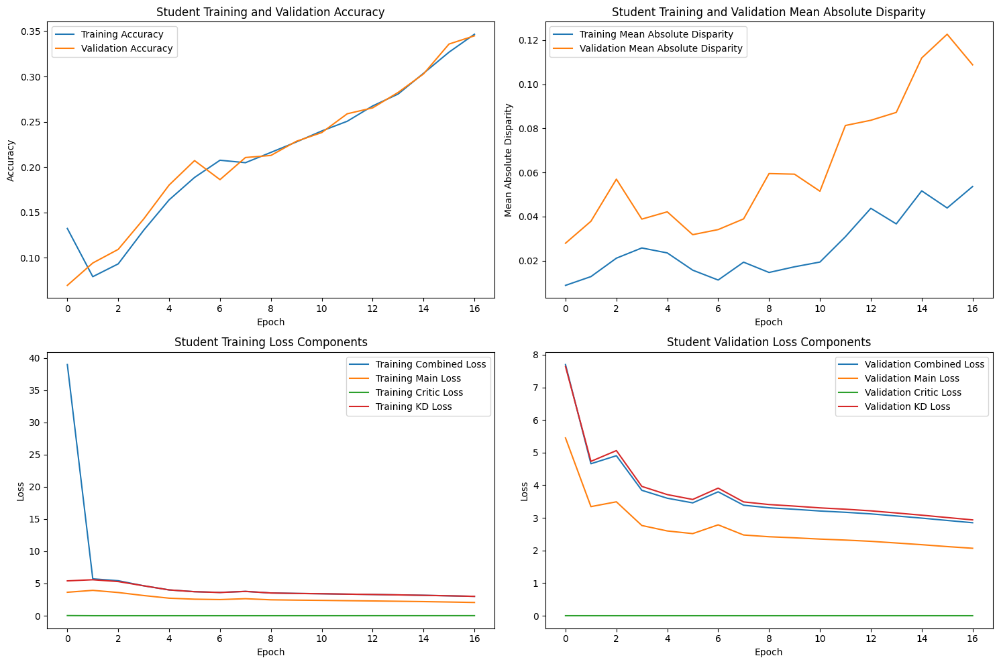

Epoch 18/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.75it/s]



STUDENT - Lambda 160 - Epoch 18 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.370448, VALIDATION Accuracy: 0.3619
TRAINING Disparity: 0.060506, VALIDATION Disparity: 0.0985
TRAINING Combined Loss: 2.921085, VALIDATION Combined Loss: 2.7774
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.0024873007531965863
Class Celebration: Val Disparity = -0.10465116279069772
Class Parade: Val Disparity = 0.03964344358433025
Class Waiter_Or_Waitress: Val Disparity = -0.12056737588652486
Class Individual_Sports: Val Disparity = 0.008683557627246097
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.1542145593869732
Class Business: Val Disparity = -0.1417306052855925
Class Dresses: Val Disparity = -0.35952380952380947
Class Water_Activities: Val Disparity = 0.13307240704500972
Class Picnic: Val Disparity = -0.05555555555555555
Class Rescue: Val Disparity = 0.012048192771

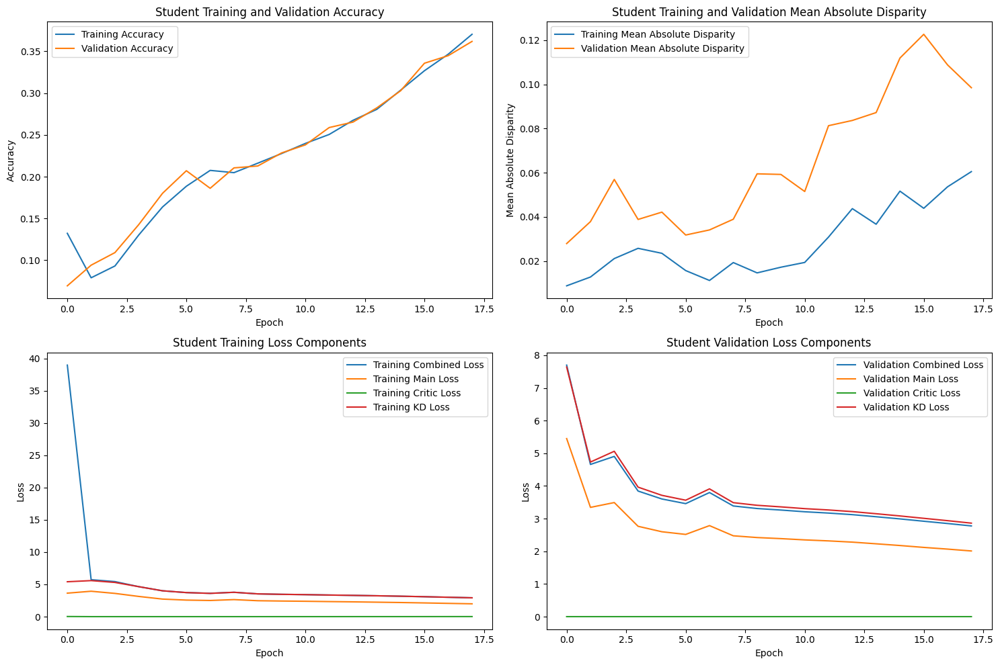

Epoch 19/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.80it/s]



STUDENT - Lambda 160 - Epoch 19 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.390239, VALIDATION Accuracy: 0.3835
TRAINING Disparity: 0.060286, VALIDATION Disparity: 0.1061
TRAINING Combined Loss: 2.838960, VALIDATION Combined Loss: 2.7046
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.0218485432358263
Class Celebration: Val Disparity = -0.0883720930232558
Class Parade: Val Disparity = -0.000586441473140964
Class Waiter_Or_Waitress: Val Disparity = -0.075177304964539
Class Individual_Sports: Val Disparity = 0.0016540109766183253
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.2064176245210728
Class Business: Val Disparity = -0.14940323955669227
Class Dresses: Val Disparity = -0.35357142857142865
Class Water_Activities: Val Disparity = 0.16264405305501195
Class Picnic: Val Disparity = -0.11111111111111113
Class Rescue: Val Disparity = 0.01204819277108

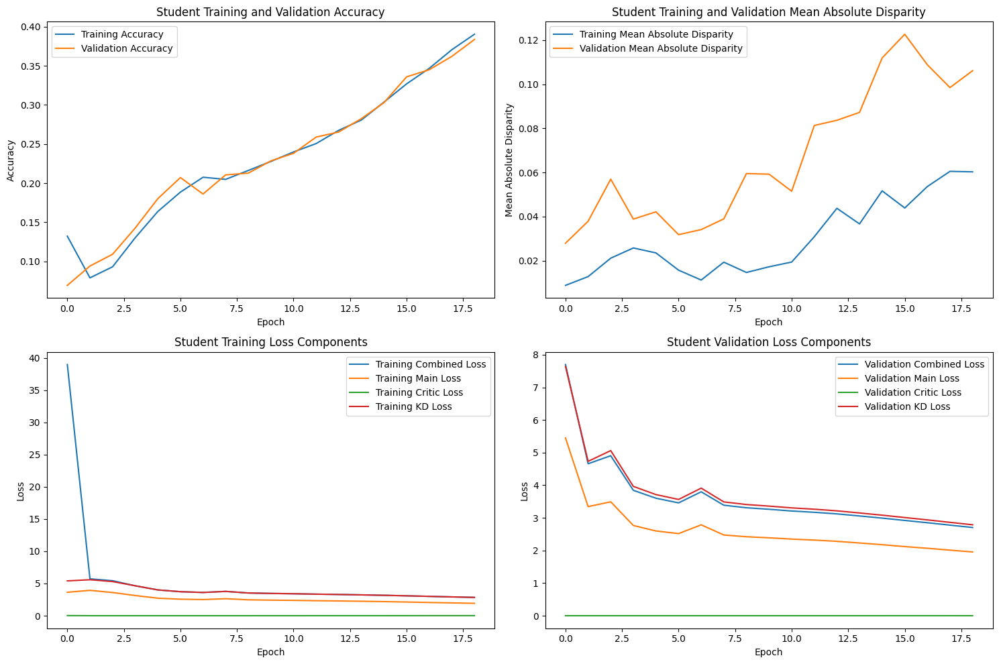

Epoch 20/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.71it/s]



STUDENT - Lambda 160 - Epoch 20 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.411593, VALIDATION Accuracy: 0.3977
TRAINING Disparity: 0.053403, VALIDATION Disparity: 0.0831
TRAINING Combined Loss: 2.756271, VALIDATION Combined Loss: 2.6490
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.003293046067612493
Class Celebration: Val Disparity = -0.037209302325581506
Class Parade: Val Disparity = -0.00445695519587147
Class Waiter_Or_Waitress: Val Disparity = -0.05390070921985812
Class Individual_Sports: Val Disparity = -0.02668972257724972
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = -0.0851063829787234
Class Law_Enforcement: Val Disparity = 0.21695402298850577
Class Business: Val Disparity = -0.11125319693094626
Class Dresses: Val Disparity = -0.3476190476190477
Class Water_Activities: Val Disparity = 0.1669928245270711
Class Picnic: Val Disparity = -0.0185185185185186
Class Rescue: Val Disparity

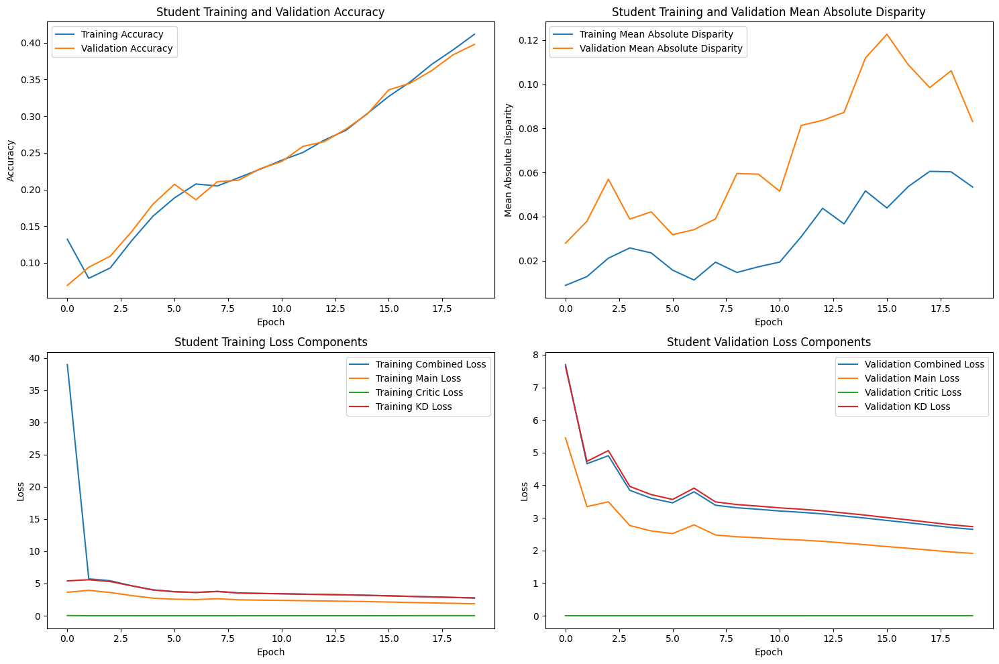

Epoch 21/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 160 - Epoch 21 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.428954, VALIDATION Accuracy: 0.4062
TRAINING Disparity: 0.066125, VALIDATION Disparity: 0.1061
TRAINING Combined Loss: 2.690278, VALIDATION Combined Loss: 2.5910
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.0932329071057395
Class Celebration: Val Disparity = -0.0790697674418605
Class Parade: Val Disparity = -0.023574947220267428
Class Waiter_Or_Waitress: Val Disparity = -0.06453900709219856
Class Individual_Sports: Val Disparity = -0.06548379821066086
Class Surgeons: Val Disparity = -0.02857142857142857
Class Spa: Val Disparity = 0.20567375886524822
Class Law_Enforcement: Val Disparity = 0.19971264367816094
Class Business: Val Disparity = -0.0579710144927536
Class Dresses: Val Disparity = -0.4309523809523811
Class Water_Activities: Val Disparity = 0.13742117851706886
Class Picnic: Val Disparity = 0.07407407407407407
Class Rescue: 

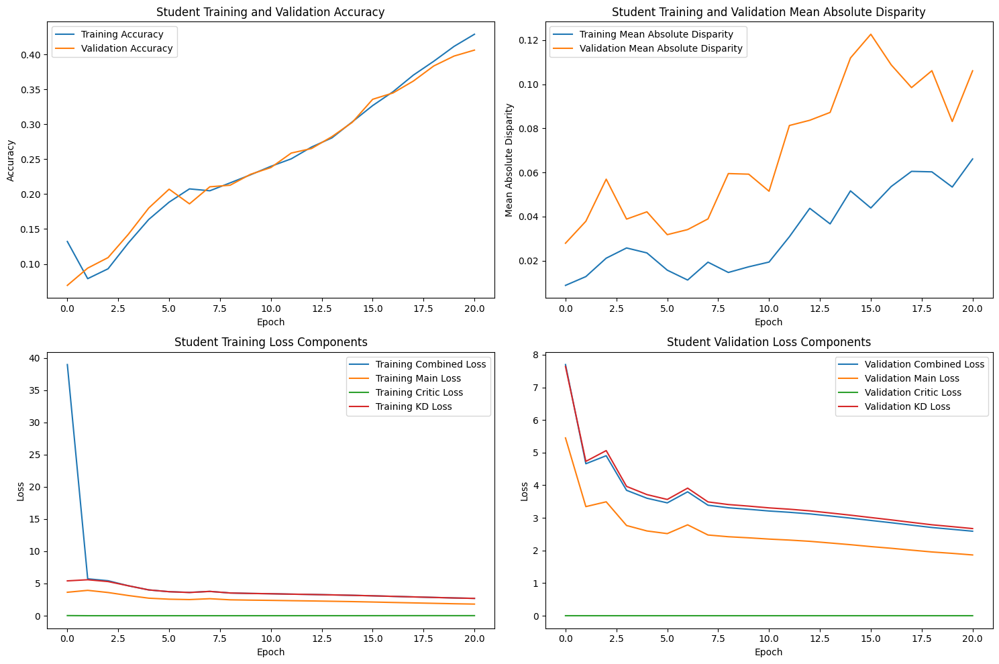

Epoch 22/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.70it/s]



STUDENT - Lambda 160 - Epoch 22 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.449846, VALIDATION Accuracy: 0.4230
TRAINING Disparity: 0.069663, VALIDATION Disparity: 0.0957
TRAINING Combined Loss: 2.604939, VALIDATION Combined Loss: 2.5175
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04031062065744151
Class Celebration: Val Disparity = 0.0
Class Parade: Val Disparity = 0.014661036828524487
Class Waiter_Or_Waitress: Val Disparity = -0.07092198581560283
Class Individual_Sports: Val Disparity = -0.06544620705210136
Class Surgeons: Val Disparity = -0.02857142857142857
Class Spa: Val Disparity = 0.14184397163120566
Class Law_Enforcement: Val Disparity = 0.18271072796934873
Class Business: Val Disparity = -0.07971014492753625
Class Dresses: Val Disparity = -0.37142857142857155
Class Water_Activities: Val Disparity = 0.1806914546640574
Class Picnic: Val Disparity = 0.11111111111111113
Class Rescue: Val Disparity =

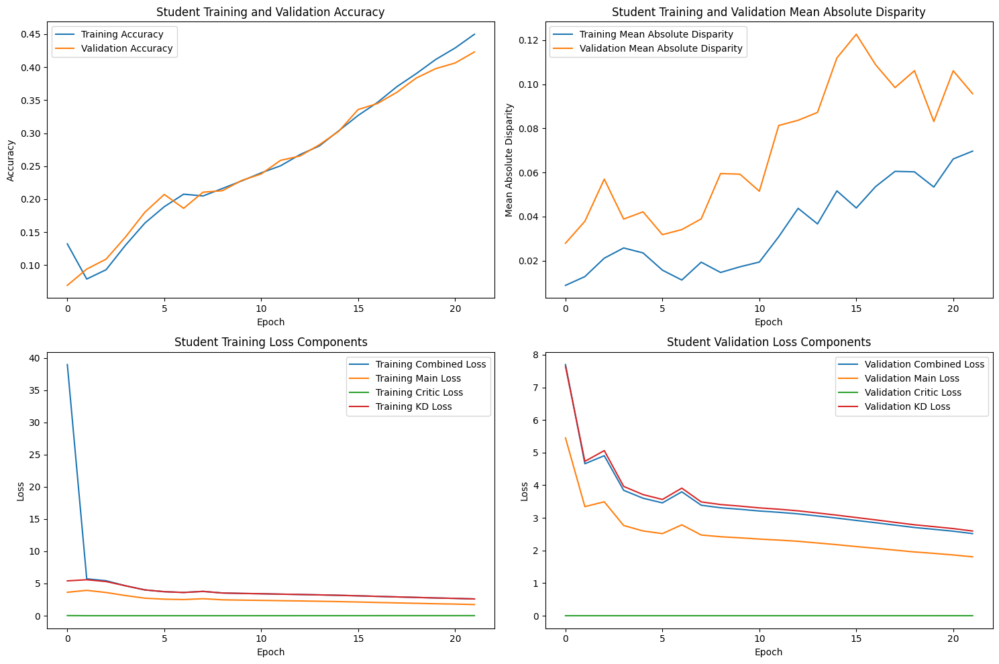

Epoch 23/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.71it/s]



STUDENT - Lambda 160 - Epoch 23 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.474884, VALIDATION Accuracy: 0.4429
TRAINING Disparity: 0.099702, VALIDATION Disparity: 0.0924
TRAINING Combined Loss: 2.513673, VALIDATION Combined Loss: 2.4673
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06455304489986569
Class Celebration: Val Disparity = -0.011627906976744151
Class Parade: Val Disparity = -0.03753225428102275
Class Waiter_Or_Waitress: Val Disparity = -0.03900709219858162
Class Individual_Sports: Val Disparity = -0.08661002932110368
Class Surgeons: Val Disparity = -0.034432234432234435
Class Spa: Val Disparity = 0.014184397163120588
Class Law_Enforcement: Val Disparity = 0.21408045977011492
Class Business: Val Disparity = -0.06670929241261725
Class Dresses: Val Disparity = -0.4547619047619048
Class Water_Activities: Val Disparity = 0.19080234833659482
Class Picnic: Val Disparity = -0.03703703703703709
Class Re

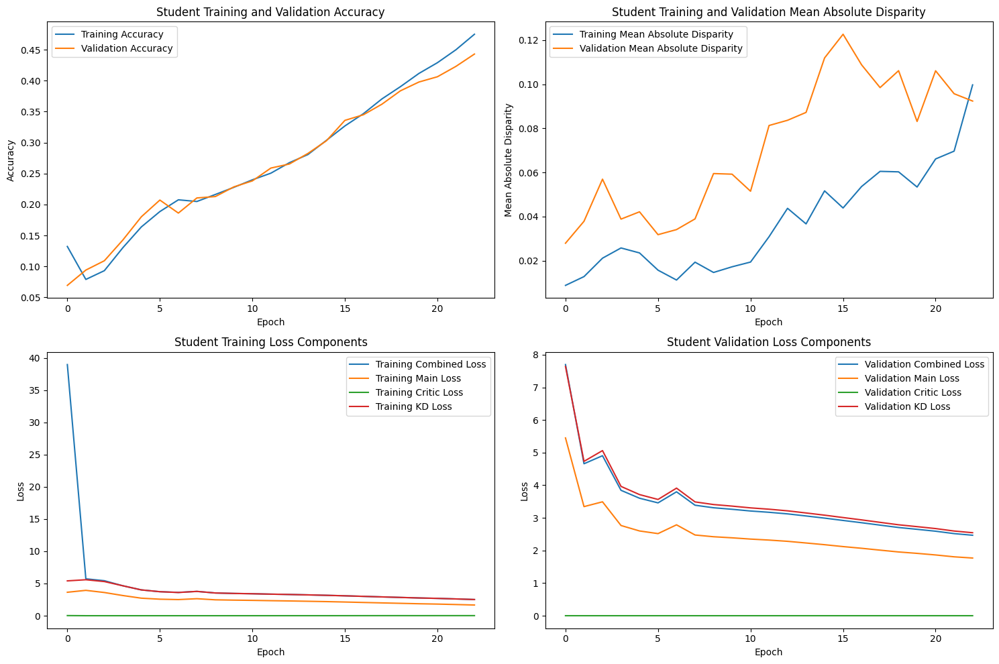

Epoch 24/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.73it/s]



STUDENT - Lambda 160 - Epoch 24 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.496971, VALIDATION Accuracy: 0.4554
TRAINING Disparity: 0.109308, VALIDATION Disparity: 0.0987
TRAINING Combined Loss: 2.428932, VALIDATION Combined Loss: 2.4028
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05243183277865349
Class Celebration: Val Disparity = -0.06976744186046513
Class Parade: Val Disparity = -0.07271874266948153
Class Waiter_Or_Waitress: Val Disparity = -0.016312056737588676
Class Individual_Sports: Val Disparity = -0.03349372227652048
Class Surgeons: Val Disparity = -0.09157509157509158
Class Spa: Val Disparity = -0.07092198581560283
Class Law_Enforcement: Val Disparity = 0.19659961685823768
Class Business: Val Disparity = -0.019820971867007597
Class Dresses: Val Disparity = -0.4190476190476191
Class Water_Activities: Val Disparity = 0.18721461187214605
Class Picnic: Val Disparity = -0.01851851851851849
Class Re

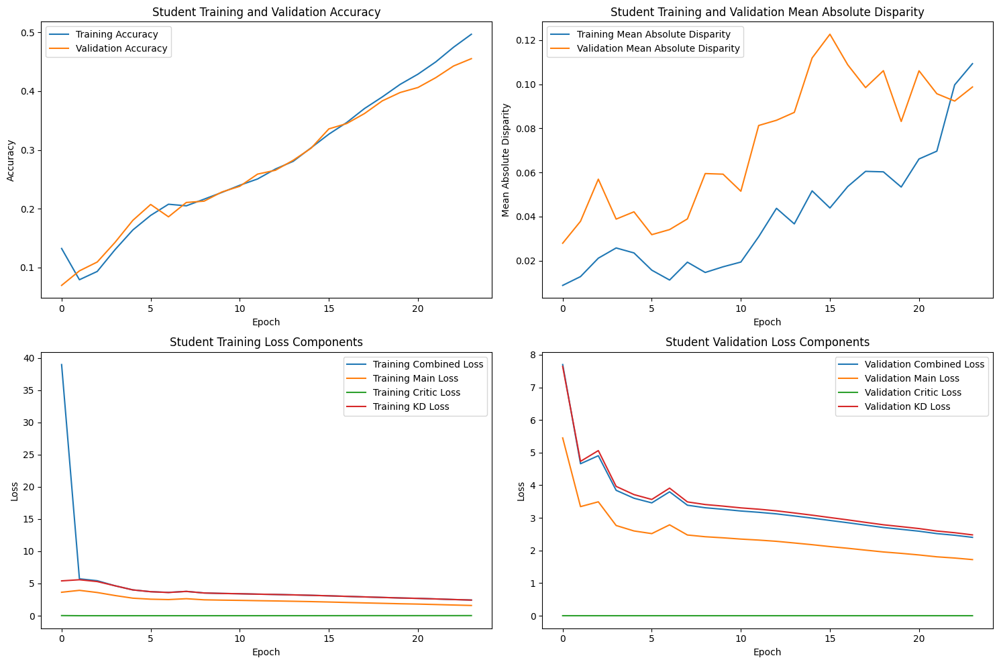

Epoch 25/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 160 - Epoch 25 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.522126, VALIDATION Accuracy: 0.4707
TRAINING Disparity: 0.110096, VALIDATION Disparity: 0.1092
TRAINING Combined Loss: 2.343138, VALIDATION Combined Loss: 2.3373
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04401237811642422
Class Celebration: Val Disparity = -0.046511627906976716
Class Parade: Val Disparity = -0.06896551724137923
Class Waiter_Or_Waitress: Val Disparity = -0.012056737588652444
Class Individual_Sports: Val Disparity = -0.10777385159010594
Class Surgeons: Val Disparity = -0.049084249084249104
Class Spa: Val Disparity = -0.049645390070921946
Class Law_Enforcement: Val Disparity = 0.2310823754789273
Class Business: Val Disparity = -0.09825234441602726
Class Dresses: Val Disparity = -0.430952380952381
Class Water_Activities: Val Disparity = 0.1691672102631006
Class Picnic: Val Disparity = -0.11111111111111108
Class Res

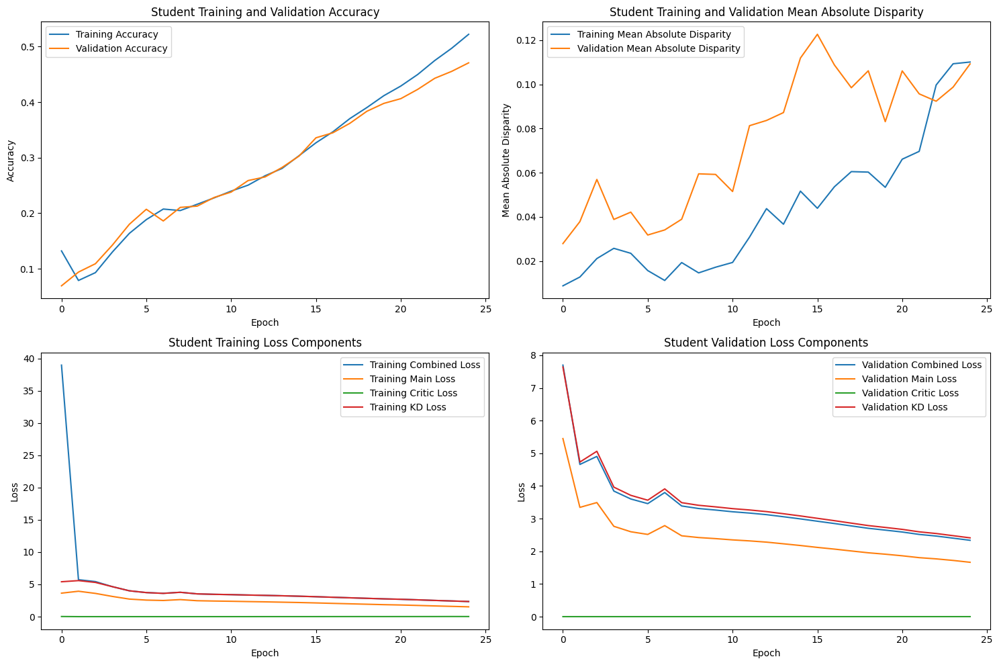

Epoch 26/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.80it/s]



STUDENT - Lambda 160 - Epoch 26 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.539718, VALIDATION Accuracy: 0.4921
TRAINING Disparity: 0.103335, VALIDATION Disparity: 0.1055
TRAINING Combined Loss: 2.259380, VALIDATION Combined Loss: 2.2887
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.053611257079465235
Class Celebration: Val Disparity = -0.04418604651162783
Class Parade: Val Disparity = -0.05242786769880359
Class Waiter_Or_Waitress: Val Disparity = -0.13191489361702124
Class Individual_Sports: Val Disparity = -0.1252913314788361
Class Surgeons: Val Disparity = -0.07765567765567771
Class Spa: Val Disparity = -0.028368794326241176
Class Law_Enforcement: Val Disparity = 0.2418582375478927
Class Business: Val Disparity = 0.008525149190110881
Class Dresses: Val Disparity = -0.40714285714285714
Class Water_Activities: Val Disparity = 0.157642965862144
Class Picnic: Val Disparity = -0.12962962962962965
Class Rescu

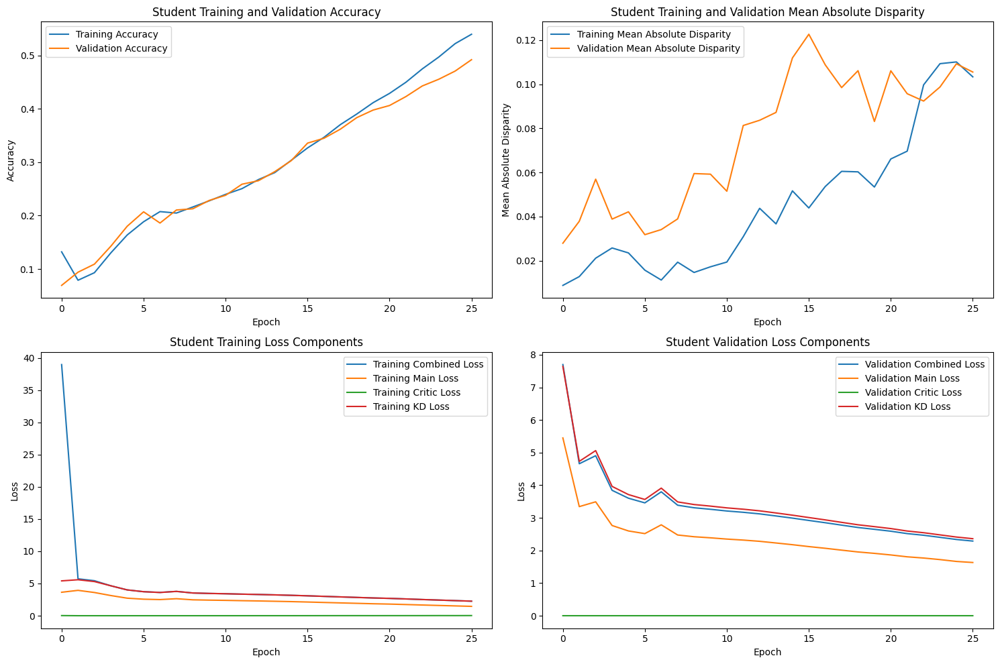

Epoch 27/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 160 - Epoch 27 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.567400, VALIDATION Accuracy: 0.4989
TRAINING Disparity: 0.136710, VALIDATION Disparity: 0.0976
TRAINING Combined Loss: 2.164454, VALIDATION Combined Loss: 2.2563
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04513341507561164
Class Celebration: Val Disparity = -0.0046511627906976605
Class Parade: Val Disparity = -0.0076237391508328645
Class Waiter_Or_Waitress: Val Disparity = -0.10921985815602842
Class Individual_Sports: Val Disparity = -0.10788662506578445
Class Surgeons: Val Disparity = -0.08351648351648358
Class Spa: Val Disparity = -0.028368794326241176
Class Law_Enforcement: Val Disparity = 0.23850574712643685
Class Business: Val Disparity = -0.06329923273657284
Class Dresses: Val Disparity = -0.4130952380952382
Class Water_Activities: Val Disparity = 0.20884974994564026
Class Picnic: Val Disparity = -0.037037037037037035
Clas

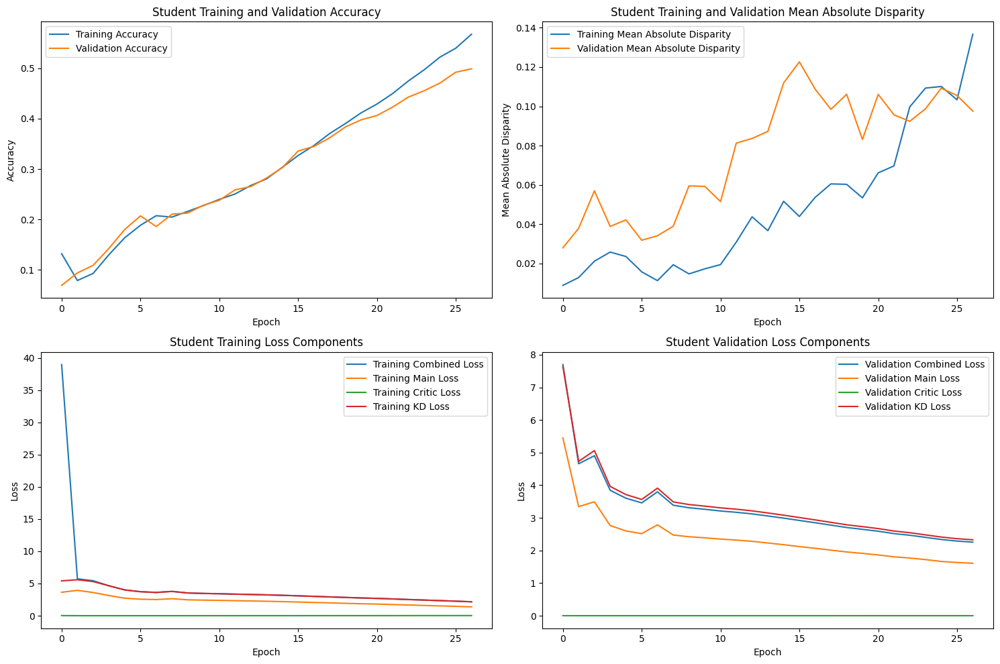

Epoch 28/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.82it/s]



STUDENT - Lambda 160 - Epoch 28 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.594985, VALIDATION Accuracy: 0.5114
TRAINING Disparity: 0.118388, VALIDATION Disparity: 0.1069
TRAINING Combined Loss: 2.057344, VALIDATION Combined Loss: 2.2214
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05153266771763876
Class Celebration: Val Disparity = -0.0674418604651163
Class Parade: Val Disparity = 0.00891391039174294
Class Waiter_Or_Waitress: Val Disparity = -0.08652482269503536
Class Individual_Sports: Val Disparity = -0.11476580708217443
Class Surgeons: Val Disparity = -0.035164835164835206
Class Spa: Val Disparity = -0.11347517730496454
Class Law_Enforcement: Val Disparity = 0.2246168582375479
Class Business: Val Disparity = -0.052429667519181544
Class Dresses: Val Disparity = -0.4726190476190477
Class Water_Activities: Val Disparity = 0.15840400086975426
Class Picnic: Val Disparity = -0.1296296296296297
Class Rescue

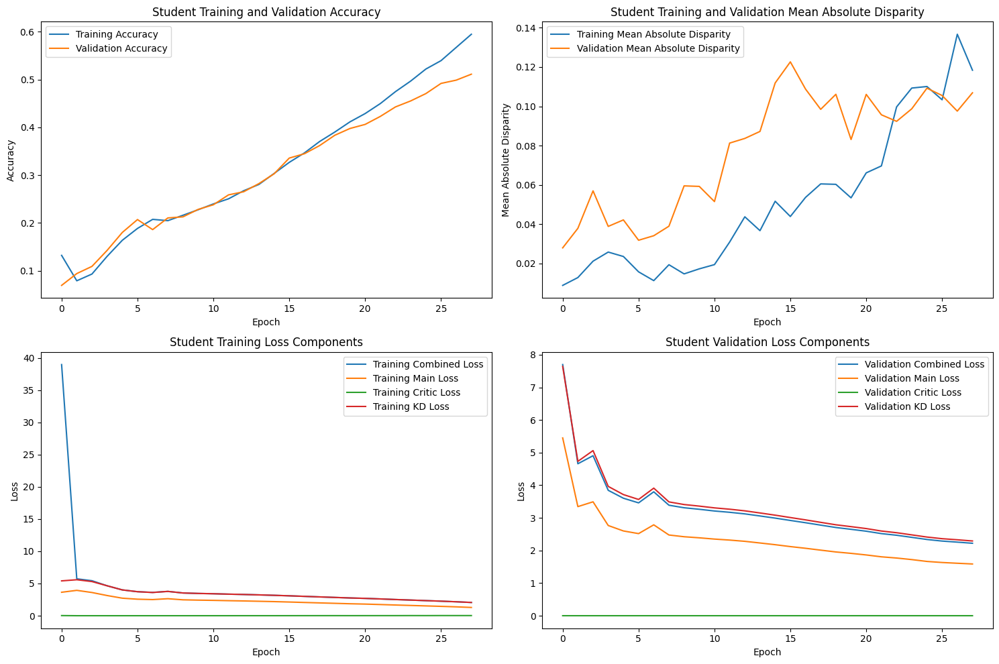

Epoch 29/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.78it/s]



STUDENT - Lambda 160 - Epoch 29 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.618634, VALIDATION Accuracy: 0.5199
TRAINING Disparity: 0.111344, VALIDATION Disparity: 0.1207
TRAINING Combined Loss: 1.976659, VALIDATION Combined Loss: 2.1920
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.030992000934197517
Class Celebration: Val Disparity = -0.09302325581395349
Class Parade: Val Disparity = 0.0049261083743842304
Class Waiter_Or_Waitress: Val Disparity = -0.1851063829787234
Class Individual_Sports: Val Disparity = -0.12905044733478688
Class Surgeons: Val Disparity = -0.009523809523809601
Class Spa: Val Disparity = -0.11347517730496454
Class Law_Enforcement: Val Disparity = 0.24545019157088127
Class Business: Val Disparity = -0.045822676896845604
Class Dresses: Val Disparity = -0.4845238095238096
Class Water_Activities: Val Disparity = 0.1187214611872146
Class Picnic: Val Disparity = -0.20370370370370378
Class Re

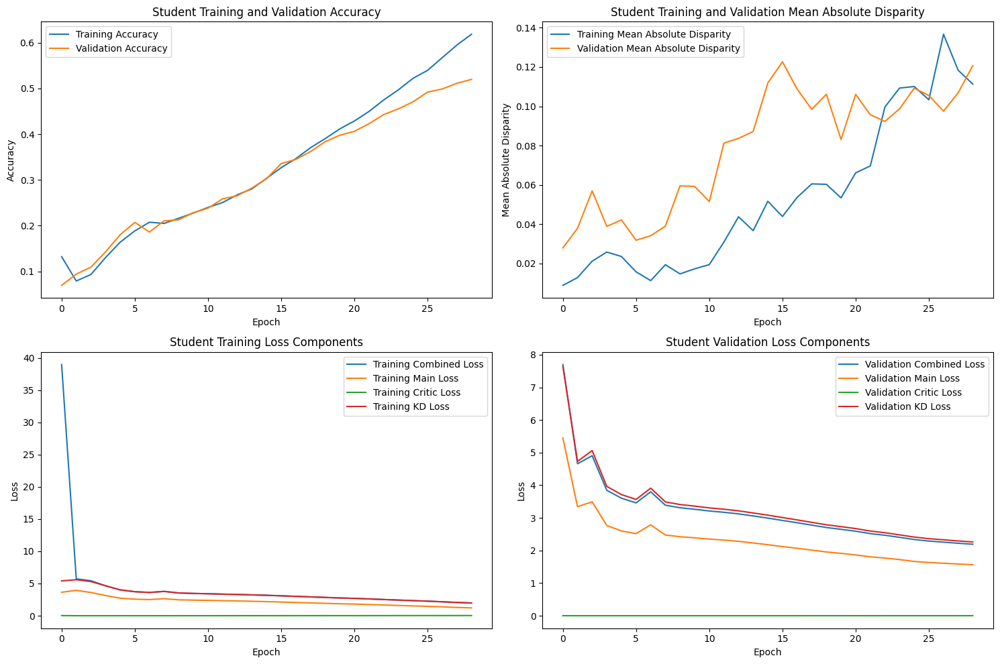

Epoch 30/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.76it/s]



STUDENT - Lambda 160 - Epoch 30 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.649961, VALIDATION Accuracy: 0.5353
TRAINING Disparity: 0.117188, VALIDATION Disparity: 0.1231
TRAINING Combined Loss: 1.865967, VALIDATION Combined Loss: 2.1750
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07661586967945344
Class Celebration: Val Disparity = -0.08837209302325583
Class Parade: Val Disparity = 0.04456955195871448
Class Waiter_Or_Waitress: Val Disparity = -0.18368794326241134
Class Individual_Sports: Val Disparity = -0.18558754980828523
Class Surgeons: Val Disparity = 0.01318681318681314
Class Spa: Val Disparity = -0.02836879432624112
Class Law_Enforcement: Val Disparity = 0.20426245210727978
Class Business: Val Disparity = -0.023017902813299185
Class Dresses: Val Disparity = -0.5142857142857143
Class Water_Activities: Val Disparity = 0.16992824527071104
Class Picnic: Val Disparity = -0.18518518518518517
Class Rescu

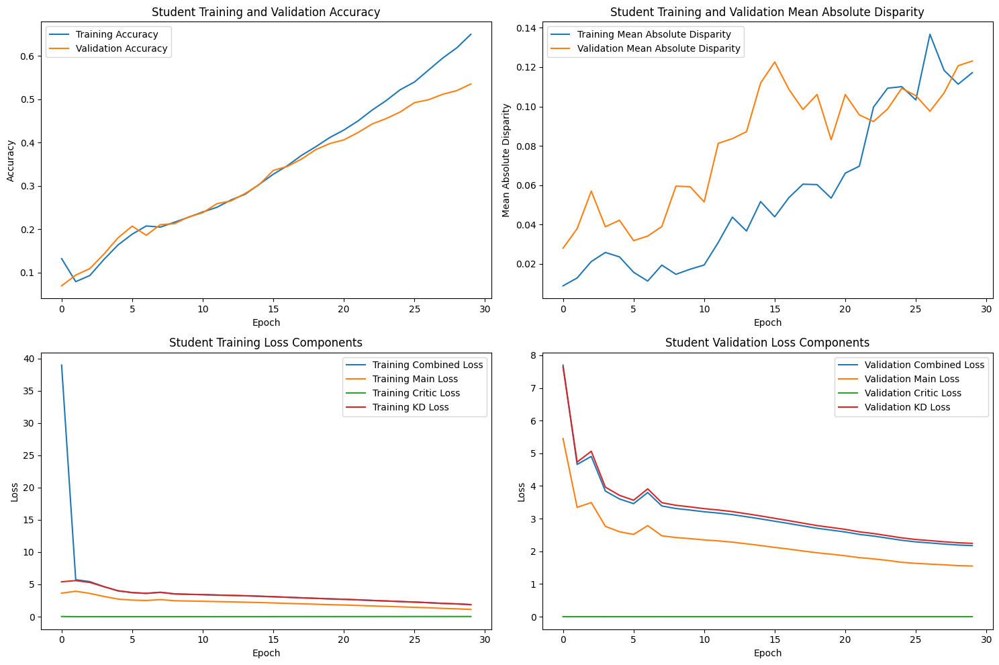

Epoch 31/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 160 - Epoch 31 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.677855, VALIDATION Accuracy: 0.5344
TRAINING Disparity: 0.115897, VALIDATION Disparity: 0.1289
TRAINING Combined Loss: 1.767785, VALIDATION Combined Loss: 2.1651
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05175453961581111
Class Celebration: Val Disparity = -0.011627906976744262
Class Parade: Val Disparity = 0.03506920009383063
Class Waiter_Or_Waitress: Val Disparity = -0.19432624113475183
Class Individual_Sports: Val Disparity = -0.14310954063604253
Class Surgeons: Val Disparity = -0.009523809523809545
Class Spa: Val Disparity = 0.21985815602836878
Class Law_Enforcement: Val Disparity = 0.29070881226053646
Class Business: Val Disparity = -0.002344416027280416
Class Dresses: Val Disparity = -0.49642857142857144
Class Water_Activities: Val Disparity = 0.1381822135246793
Class Picnic: Val Disparity = -0.24074074074074064
Class Res

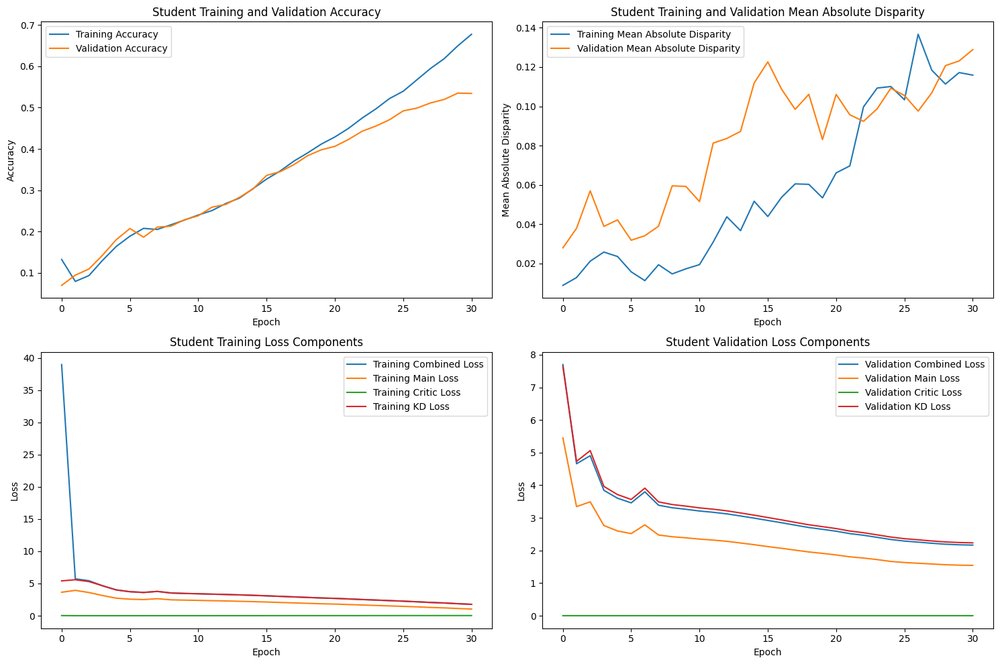

Epoch 32/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.73it/s]



STUDENT - Lambda 160 - Epoch 32 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.706038, VALIDATION Accuracy: 0.5387
TRAINING Disparity: 0.118888, VALIDATION Disparity: 0.1246
TRAINING Combined Loss: 1.667547, VALIDATION Combined Loss: 2.1388
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.024651135633794508
Class Celebration: Val Disparity = -0.027906976744186074
Class Parade: Val Disparity = 0.04198920947689422
Class Waiter_Or_Waitress: Val Disparity = -0.26879432624113475
Class Individual_Sports: Val Disparity = -0.17479888730170678
Class Surgeons: Val Disparity = 0.016117216117216115
Class Spa: Val Disparity = -0.19858156028368795
Class Law_Enforcement: Val Disparity = 0.2765804597701149
Class Business: Val Disparity = 0.03687127024722925
Class Dresses: Val Disparity = -0.42500000000000004
Class Water_Activities: Val Disparity = 0.12524461839530332
Class Picnic: Val Disparity = -0.16666666666666663
Class Resc

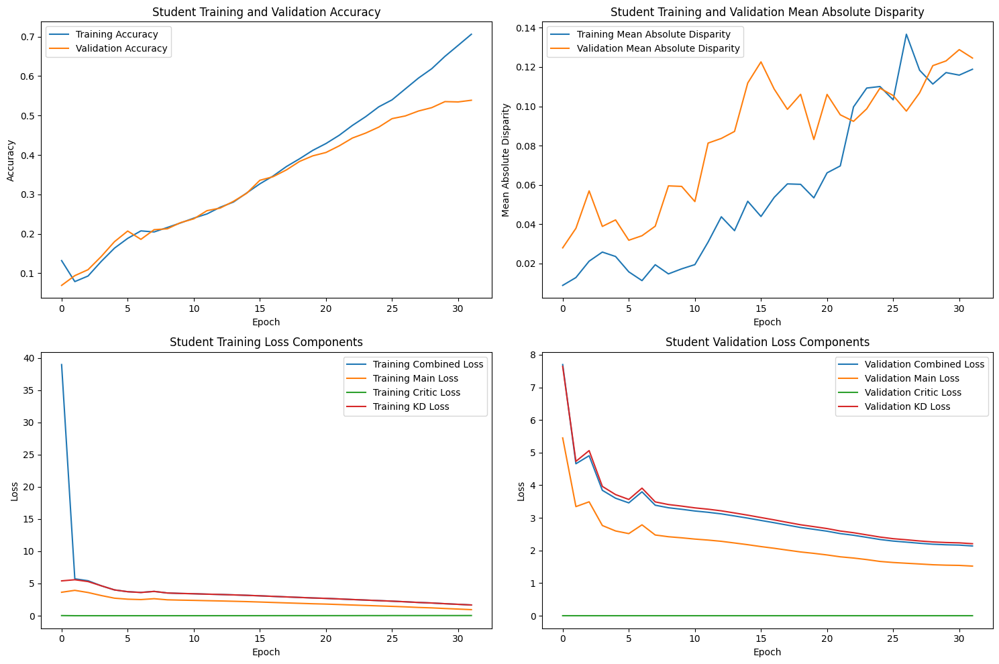

Epoch 33/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.76it/s]



STUDENT - Lambda 160 - Epoch 33 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.734317, VALIDATION Accuracy: 0.5341
TRAINING Disparity: 0.098428, VALIDATION Disparity: 0.1120
TRAINING Combined Loss: 1.560837, VALIDATION Combined Loss: 2.1600
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.024651135633794508
Class Celebration: Val Disparity = -0.027906976744186074
Class Parade: Val Disparity = 0.04198920947689422
Class Waiter_Or_Waitress: Val Disparity = -0.26879432624113475
Class Individual_Sports: Val Disparity = -0.17479888730170678
Class Surgeons: Val Disparity = 0.016117216117216115
Class Spa: Val Disparity = -0.19858156028368795
Class Law_Enforcement: Val Disparity = 0.2765804597701149
Class Business: Val Disparity = 0.03687127024722925
Class Dresses: Val Disparity = -0.42500000000000004
Class Water_Activities: Val Disparity = 0.12524461839530332
Class Picnic: Val Disparity = -0.16666666666666663
Class Resc

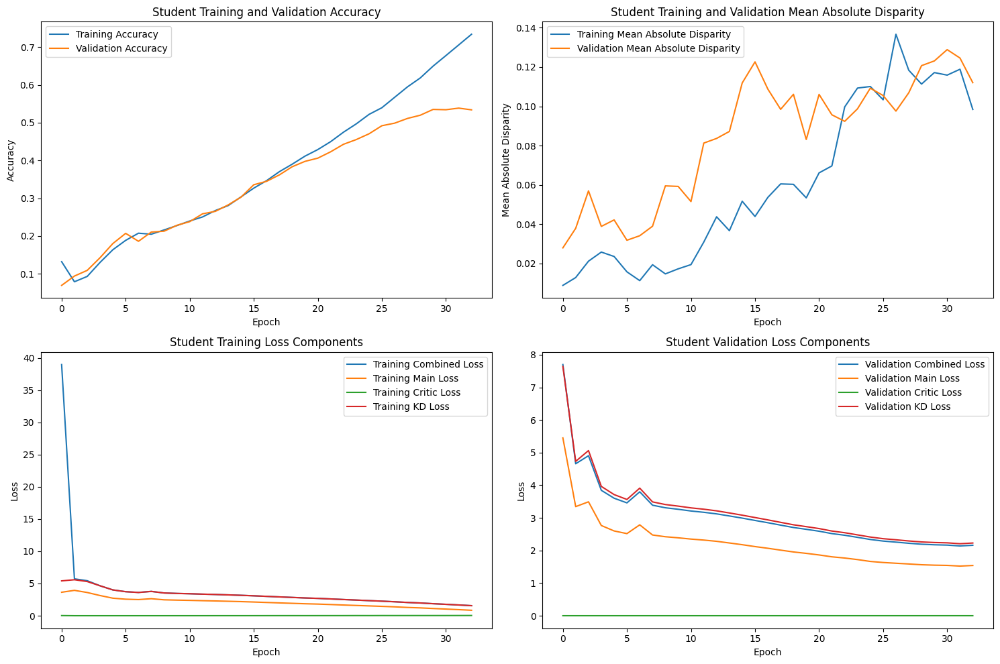

Epoch 34/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.75it/s]



STUDENT - Lambda 160 - Epoch 34 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.767149, VALIDATION Accuracy: 0.5441
TRAINING Disparity: 0.127177, VALIDATION Disparity: 0.1173
TRAINING Combined Loss: 1.472213, VALIDATION Combined Loss: 2.1815
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.024651135633794508
Class Celebration: Val Disparity = -0.027906976744186074
Class Parade: Val Disparity = 0.04198920947689422
Class Waiter_Or_Waitress: Val Disparity = -0.26879432624113475
Class Individual_Sports: Val Disparity = -0.17479888730170678
Class Surgeons: Val Disparity = 0.016117216117216115
Class Spa: Val Disparity = -0.19858156028368795
Class Law_Enforcement: Val Disparity = 0.2765804597701149
Class Business: Val Disparity = 0.03687127024722925
Class Dresses: Val Disparity = -0.42500000000000004
Class Water_Activities: Val Disparity = 0.12524461839530332
Class Picnic: Val Disparity = -0.16666666666666663
Class Resc

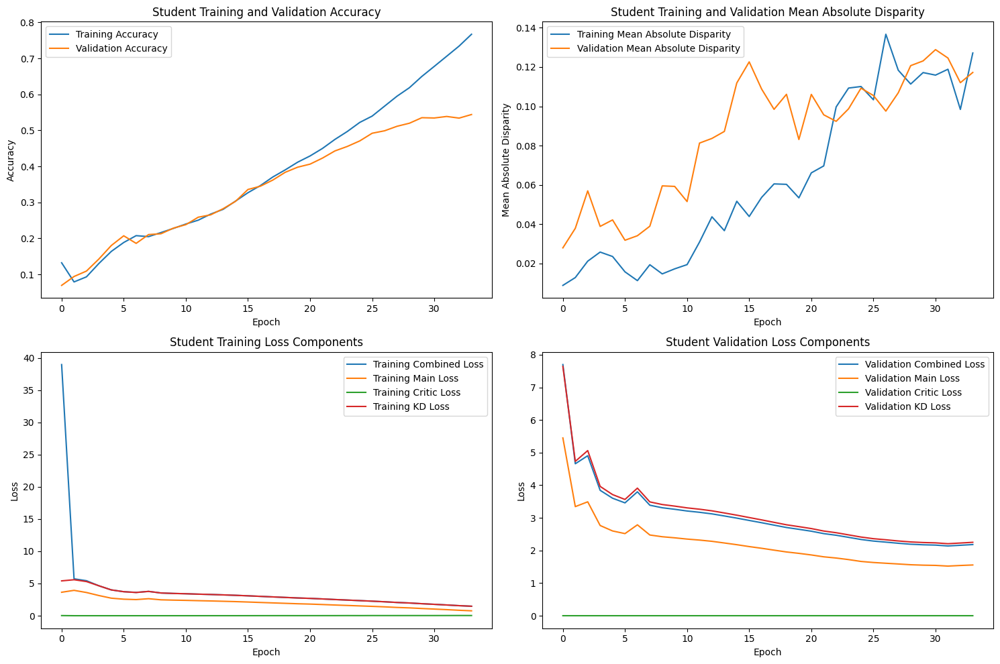

Epoch 35/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.81it/s]



STUDENT - Lambda 160 - Epoch 35 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.801119, VALIDATION Accuracy: 0.5478
TRAINING Disparity: 0.076640, VALIDATION Disparity: 0.1202
TRAINING Combined Loss: 1.366921, VALIDATION Combined Loss: 2.1797
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.024651135633794508
Class Celebration: Val Disparity = -0.027906976744186074
Class Parade: Val Disparity = 0.04198920947689422
Class Waiter_Or_Waitress: Val Disparity = -0.26879432624113475
Class Individual_Sports: Val Disparity = -0.17479888730170678
Class Surgeons: Val Disparity = 0.016117216117216115
Class Spa: Val Disparity = -0.19858156028368795
Class Law_Enforcement: Val Disparity = 0.2765804597701149
Class Business: Val Disparity = 0.03687127024722925
Class Dresses: Val Disparity = -0.42500000000000004
Class Water_Activities: Val Disparity = 0.12524461839530332
Class Picnic: Val Disparity = -0.16666666666666663
Class Resc

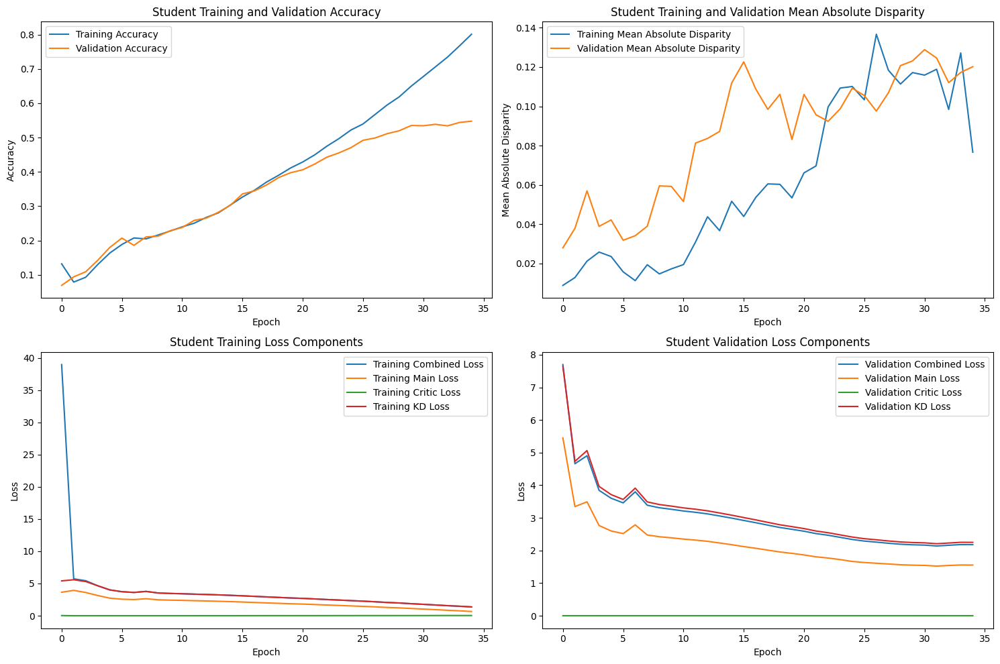

Epoch 36/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.69it/s]



STUDENT - Lambda 160 - Epoch 36 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.831732, VALIDATION Accuracy: 0.5486
TRAINING Disparity: 0.094983, VALIDATION Disparity: 0.1211
TRAINING Combined Loss: 1.279666, VALIDATION Combined Loss: 2.1997
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.024651135633794508
Class Celebration: Val Disparity = -0.027906976744186074
Class Parade: Val Disparity = 0.04198920947689422
Class Waiter_Or_Waitress: Val Disparity = -0.26879432624113475
Class Individual_Sports: Val Disparity = -0.17479888730170678
Class Surgeons: Val Disparity = 0.016117216117216115
Class Spa: Val Disparity = -0.19858156028368795
Class Law_Enforcement: Val Disparity = 0.2765804597701149
Class Business: Val Disparity = 0.03687127024722925
Class Dresses: Val Disparity = -0.42500000000000004
Class Water_Activities: Val Disparity = 0.12524461839530332
Class Picnic: Val Disparity = -0.16666666666666663
Class Resc

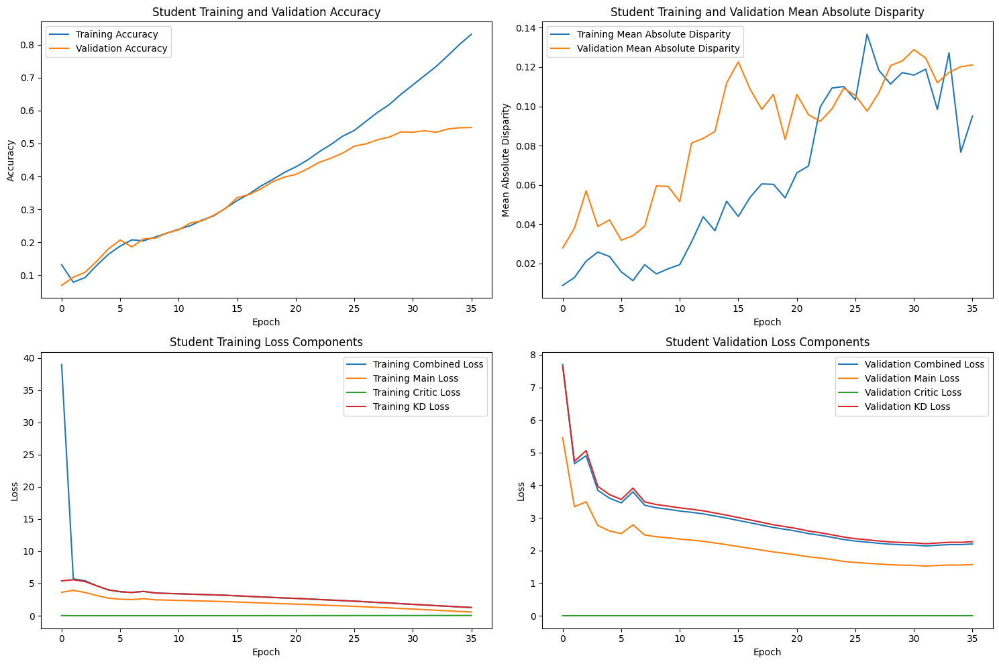

Epoch 37/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.78it/s]



STUDENT - Lambda 160 - Epoch 37 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.866956, VALIDATION Accuracy: 0.5486
TRAINING Disparity: 0.070350, VALIDATION Disparity: 0.1296
TRAINING Combined Loss: 1.183529, VALIDATION Combined Loss: 2.2150
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.024651135633794508
Class Celebration: Val Disparity = -0.027906976744186074
Class Parade: Val Disparity = 0.04198920947689422
Class Waiter_Or_Waitress: Val Disparity = -0.26879432624113475
Class Individual_Sports: Val Disparity = -0.17479888730170678
Class Surgeons: Val Disparity = 0.016117216117216115
Class Spa: Val Disparity = -0.19858156028368795
Class Law_Enforcement: Val Disparity = 0.2765804597701149
Class Business: Val Disparity = 0.03687127024722925
Class Dresses: Val Disparity = -0.42500000000000004
Class Water_Activities: Val Disparity = 0.12524461839530332
Class Picnic: Val Disparity = -0.16666666666666663
Class Resc

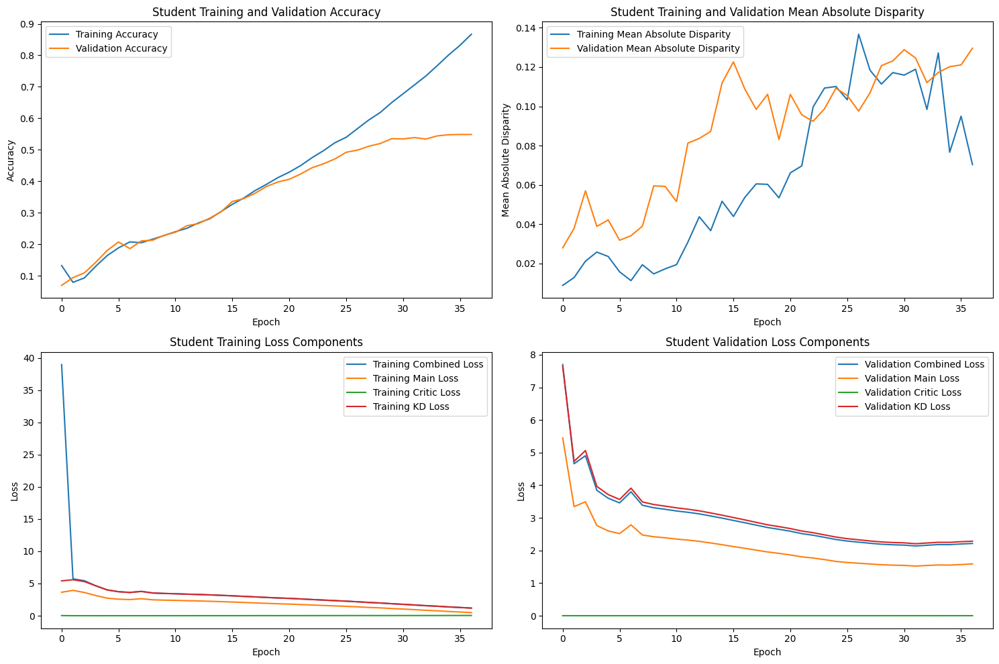

Epoch 38/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 160 - Epoch 38 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.888137, VALIDATION Accuracy: 0.5521
TRAINING Disparity: 0.041832, VALIDATION Disparity: 0.1335
TRAINING Combined Loss: 1.108574, VALIDATION Combined Loss: 2.2176
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.024651135633794508
Class Celebration: Val Disparity = -0.027906976744186074
Class Parade: Val Disparity = 0.04198920947689422
Class Waiter_Or_Waitress: Val Disparity = -0.26879432624113475
Class Individual_Sports: Val Disparity = -0.17479888730170678
Class Surgeons: Val Disparity = 0.016117216117216115
Class Spa: Val Disparity = -0.19858156028368795
Class Law_Enforcement: Val Disparity = 0.2765804597701149
Class Business: Val Disparity = 0.03687127024722925
Class Dresses: Val Disparity = -0.42500000000000004
Class Water_Activities: Val Disparity = 0.12524461839530332
Class Picnic: Val Disparity = -0.16666666666666663
Class Resc

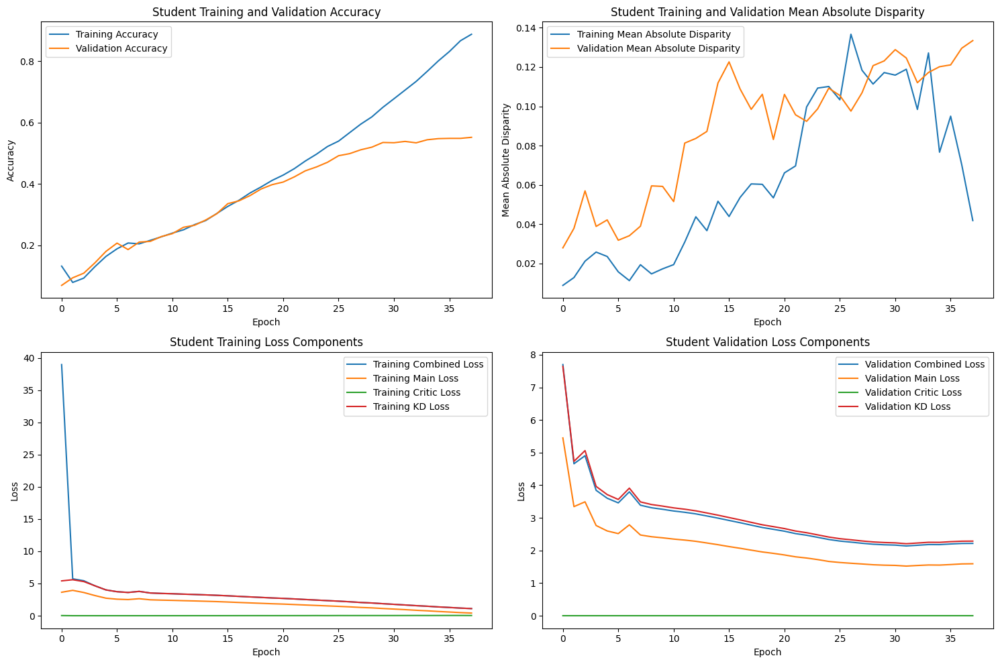

Epoch 39/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 160 - Epoch 39 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.921238, VALIDATION Accuracy: 0.5617
TRAINING Disparity: 0.082058, VALIDATION Disparity: 0.0963
TRAINING Combined Loss: 1.005150, VALIDATION Combined Loss: 2.1589
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.024651135633794508
Class Celebration: Val Disparity = -0.027906976744186074
Class Parade: Val Disparity = 0.04198920947689422
Class Waiter_Or_Waitress: Val Disparity = -0.26879432624113475
Class Individual_Sports: Val Disparity = -0.17479888730170678
Class Surgeons: Val Disparity = 0.016117216117216115
Class Spa: Val Disparity = -0.19858156028368795
Class Law_Enforcement: Val Disparity = 0.2765804597701149
Class Business: Val Disparity = 0.03687127024722925
Class Dresses: Val Disparity = -0.42500000000000004
Class Water_Activities: Val Disparity = 0.12524461839530332
Class Picnic: Val Disparity = -0.16666666666666663
Class Resc

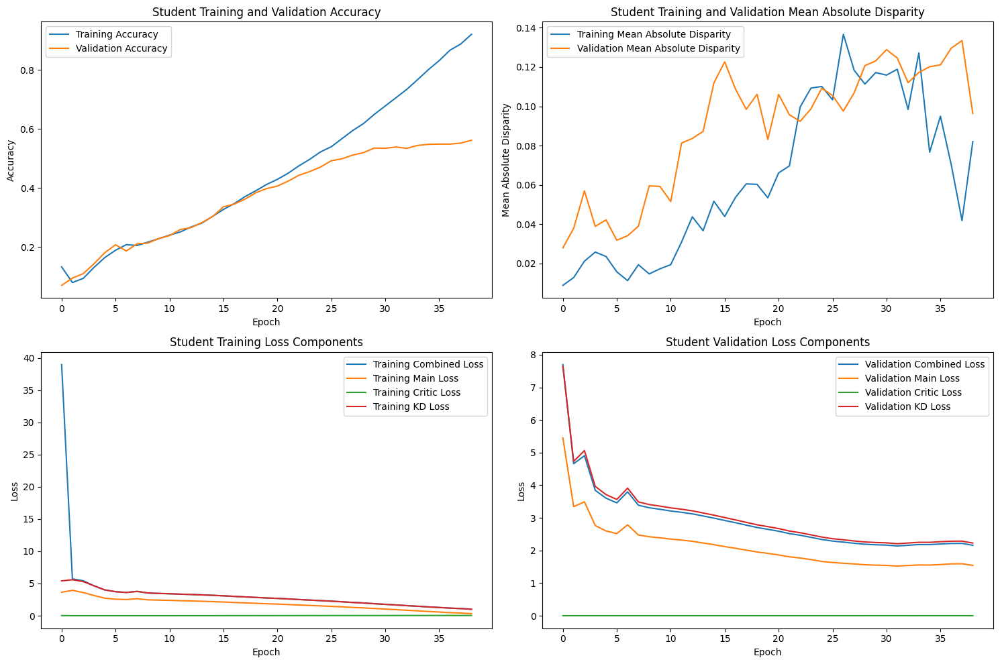

Epoch 40/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 160 - Epoch 40 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.936400, VALIDATION Accuracy: 0.5663
TRAINING Disparity: 0.044905, VALIDATION Disparity: 0.1219
TRAINING Combined Loss: 0.957327, VALIDATION Combined Loss: 2.1597
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.024651135633794508
Class Celebration: Val Disparity = -0.027906976744186074
Class Parade: Val Disparity = 0.04198920947689422
Class Waiter_Or_Waitress: Val Disparity = -0.26879432624113475
Class Individual_Sports: Val Disparity = -0.17479888730170678
Class Surgeons: Val Disparity = 0.016117216117216115
Class Spa: Val Disparity = -0.19858156028368795
Class Law_Enforcement: Val Disparity = 0.2765804597701149
Class Business: Val Disparity = 0.03687127024722925
Class Dresses: Val Disparity = -0.42500000000000004
Class Water_Activities: Val Disparity = 0.12524461839530332
Class Picnic: Val Disparity = -0.16666666666666663
Class Resc

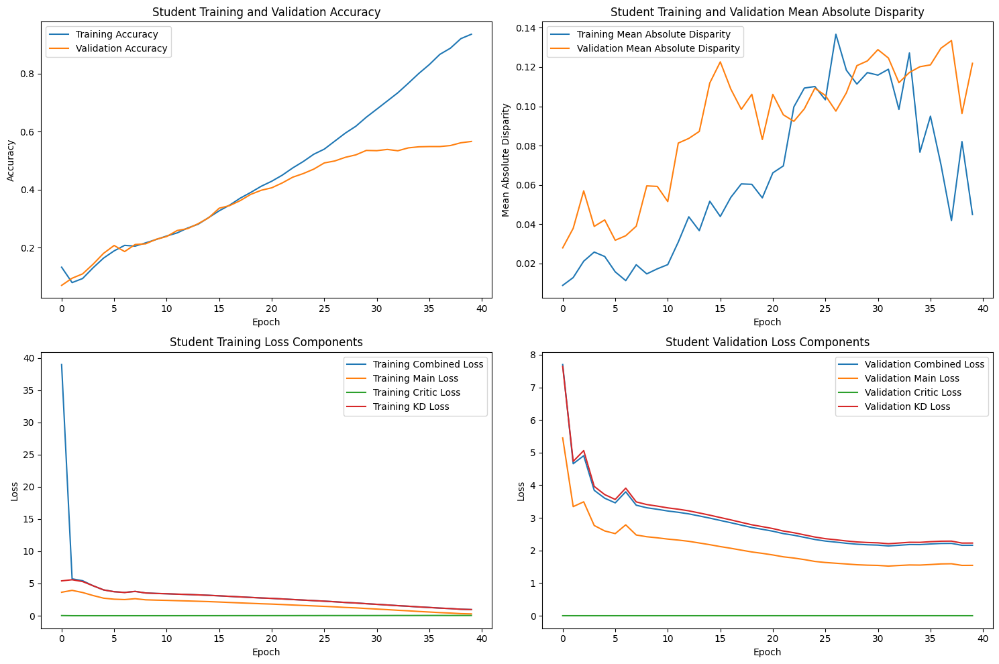

Epoch 41/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.76it/s]



STUDENT - Lambda 160 - Epoch 41 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.942458, VALIDATION Accuracy: 0.5626
TRAINING Disparity: 0.056580, VALIDATION Disparity: 0.1224
TRAINING Combined Loss: 0.938490, VALIDATION Combined Loss: 2.1664
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.024651135633794508
Class Celebration: Val Disparity = -0.027906976744186074
Class Parade: Val Disparity = 0.04198920947689422
Class Waiter_Or_Waitress: Val Disparity = -0.26879432624113475
Class Individual_Sports: Val Disparity = -0.17479888730170678
Class Surgeons: Val Disparity = 0.016117216117216115
Class Spa: Val Disparity = -0.19858156028368795
Class Law_Enforcement: Val Disparity = 0.2765804597701149
Class Business: Val Disparity = 0.03687127024722925
Class Dresses: Val Disparity = -0.42500000000000004
Class Water_Activities: Val Disparity = 0.12524461839530332
Class Picnic: Val Disparity = -0.16666666666666663
Class Resc

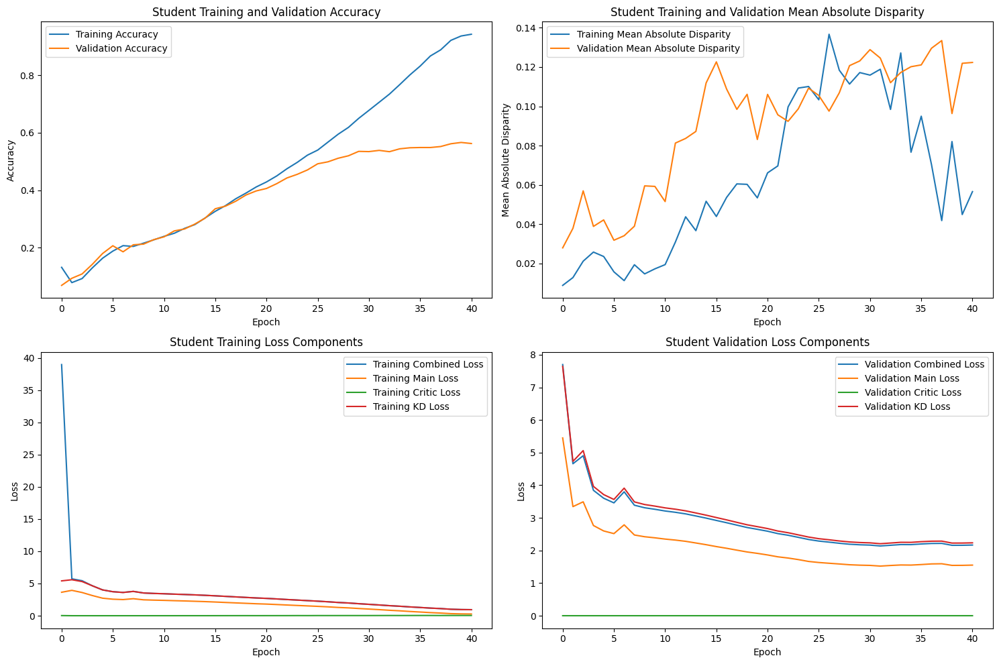

Epoch 42/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]


Early stopping triggered at epoch 42
Finished Training STUDENT with lambda value of 160. Best epoch number: 32
Training Student with Lambda Value of 140


Epoch 1/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.76it/s]



STUDENT - Lambda 140 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.173052, VALIDATION Accuracy: 0.1344
TRAINING Disparity: 0.021122, VALIDATION Disparity: 0.0328
TRAINING Combined Loss: 31.738013, VALIDATION Combined Loss: 4.3113
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.004624277456647341
Class Celebration: Val Disparity = -0.03488372093023256
Class Parade: Val Disparity = -0.02509969505043394
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.10578152018645214
Class Surgeons: Val Disparity = 0.07692307692307691
Class Spa: Val Disparity = -0.06382978723404255
Class Law_Enforcement: Val Disparity = 0.024904214559386975
Class Business: Val Disparity = -0.005328218243819273
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = -0.003587736464448786
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.05055002619172341
Class

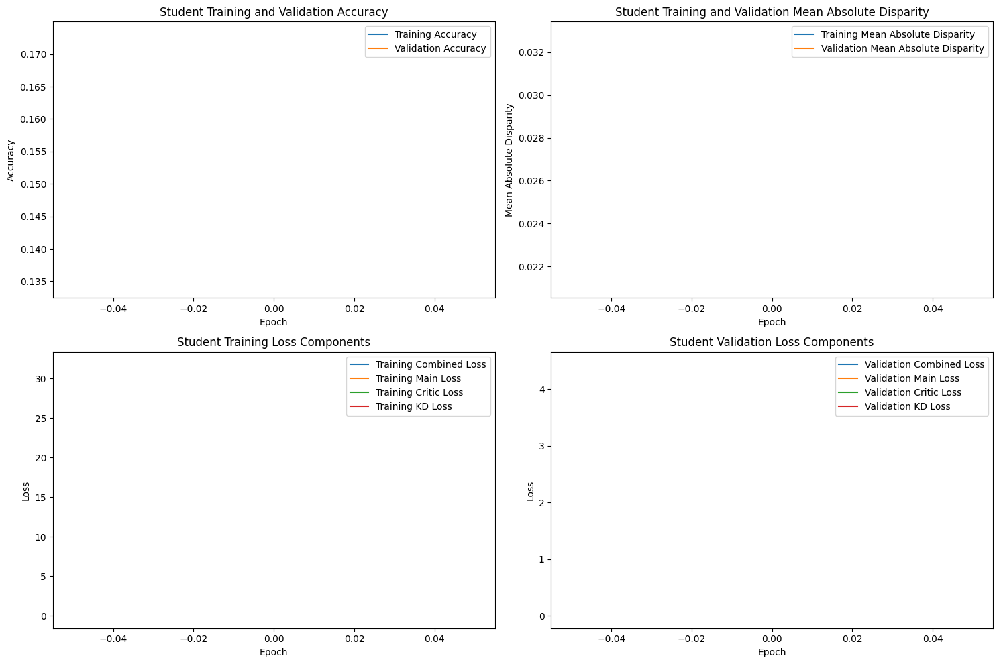

Epoch 2/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 140 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.138619, VALIDATION Accuracy: 0.1827
TRAINING Disparity: 0.020302, VALIDATION Disparity: 0.0481
TRAINING Combined Loss: 5.530442, VALIDATION Combined Loss: 4.0326
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.01456180300110932
Class Celebration: Val Disparity = -0.027906976744186074
Class Parade: Val Disparity = -0.001993901008679355
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.013119314337267818
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.15660919540229884
Class Business: Val Disparity = 0.10379369138959929
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = -0.03294194390084798
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And

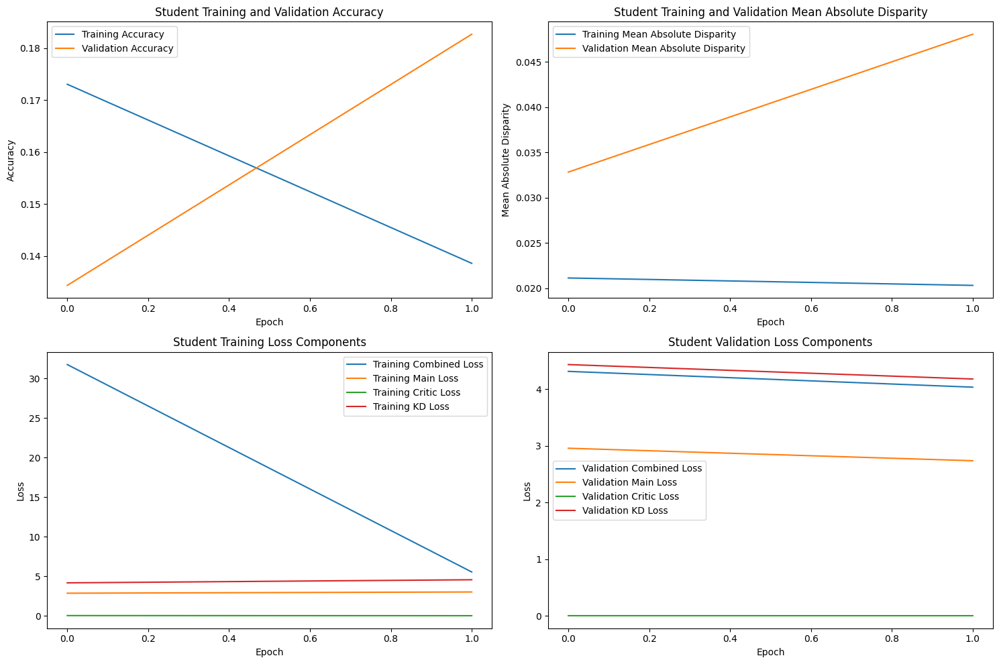

Epoch 3/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 140 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.210995, VALIDATION Accuracy: 0.1852
TRAINING Disparity: 0.023266, VALIDATION Disparity: 0.0517
TRAINING Combined Loss: 4.033575, VALIDATION Combined Loss: 3.7960
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.03948152040637598
Class Celebration: Val Disparity = -0.05813953488372092
Class Parade: Val Disparity = 0.03882242552193289
Class Waiter_Or_Waitress: Val Disparity = 0.06808510638297874
Class Individual_Sports: Val Disparity = 0.025787534771821663
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.14703065134099616
Class Business: Val Disparity = 0.04369138959931799
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.05425092411393781
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.026453640649554754
Class Cheering: Val Disparity

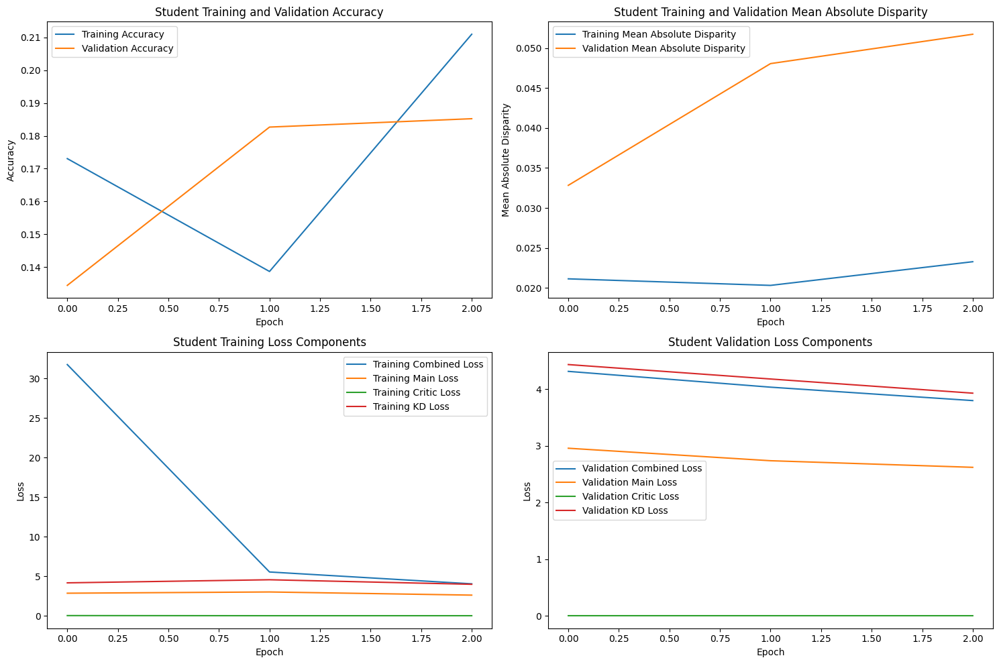

Epoch 4/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.73it/s]



STUDENT - Lambda 140 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.247859, VALIDATION Accuracy: 0.2665
TRAINING Disparity: 0.024673, VALIDATION Disparity: 0.0453
TRAINING Combined Loss: 3.641213, VALIDATION Combined Loss: 3.2797
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.02709172651369185
Class Celebration: Val Disparity = -0.03255813953488372
Class Parade: Val Disparity = -0.06978653530377671
Class Waiter_Or_Waitress: Val Disparity = -0.019858156028368802
Class Individual_Sports: Val Disparity = 0.022855424404180202
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.08716475095785442
Class Business: Val Disparity = -0.13022165387894286
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.02196129593389856
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class 

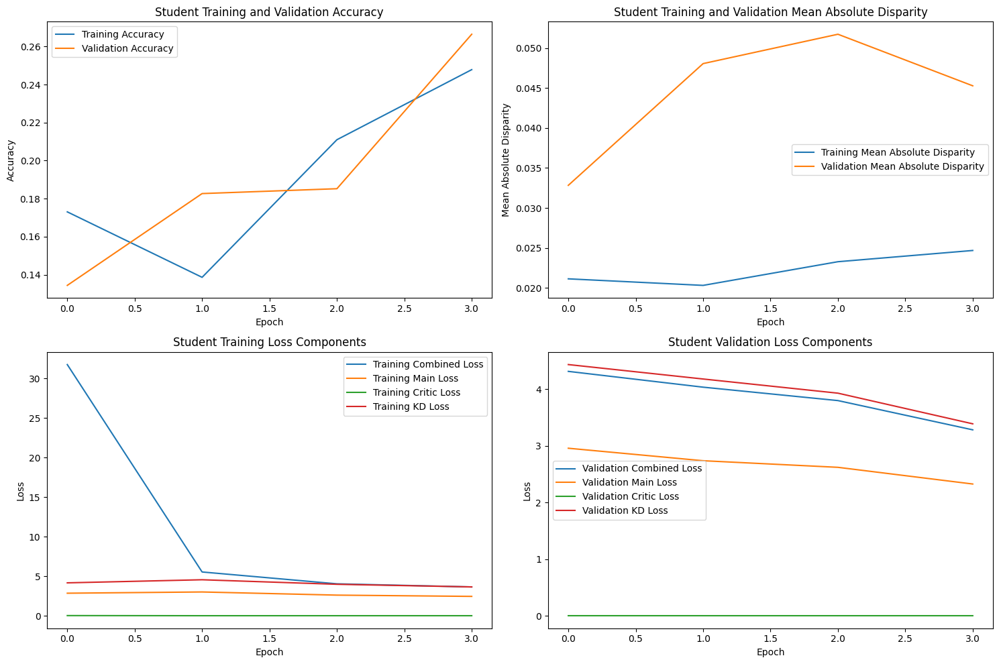

Epoch 5/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.75it/s]



STUDENT - Lambda 140 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.252855, VALIDATION Accuracy: 0.2193
TRAINING Disparity: 0.030966, VALIDATION Disparity: 0.0510
TRAINING Combined Loss: 3.896114, VALIDATION Combined Loss: 3.7723
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.02709172651369185
Class Celebration: Val Disparity = -0.03255813953488372
Class Parade: Val Disparity = -0.06978653530377671
Class Waiter_Or_Waitress: Val Disparity = -0.019858156028368802
Class Individual_Sports: Val Disparity = 0.022855424404180202
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.08716475095785442
Class Business: Val Disparity = -0.13022165387894286
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.02196129593389856
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class 

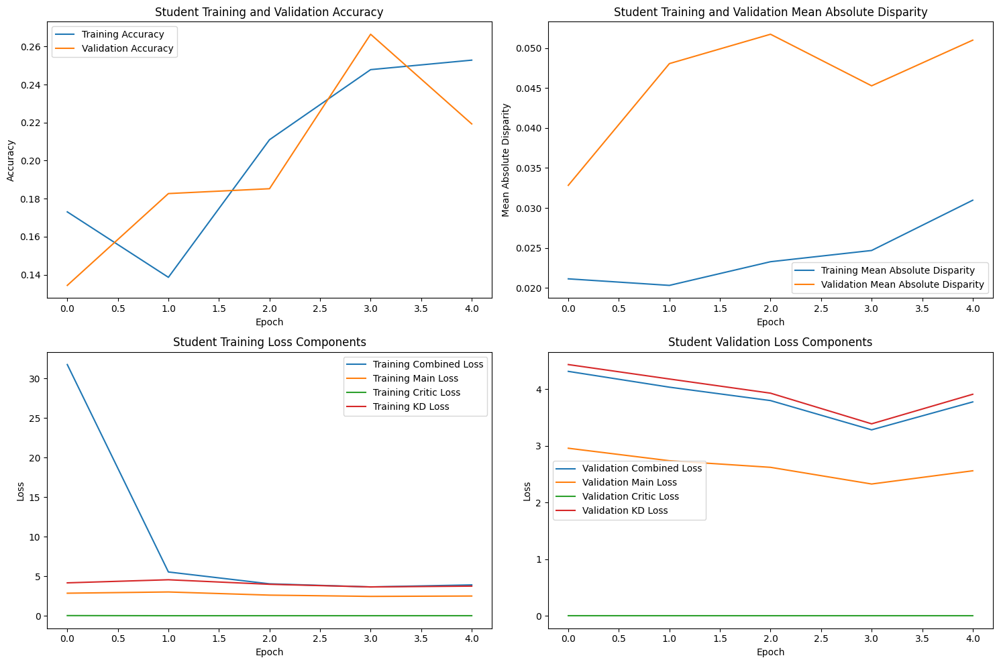

Epoch 6/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 140 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.236304, VALIDATION Accuracy: 0.2687
TRAINING Disparity: 0.025491, VALIDATION Disparity: 0.0268
TRAINING Combined Loss: 3.812674, VALIDATION Combined Loss: 3.2928
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.02709172651369185
Class Celebration: Val Disparity = -0.03255813953488372
Class Parade: Val Disparity = -0.06978653530377671
Class Waiter_Or_Waitress: Val Disparity = -0.019858156028368802
Class Individual_Sports: Val Disparity = 0.022855424404180202
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.08716475095785442
Class Business: Val Disparity = -0.13022165387894286
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.02196129593389856
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class 

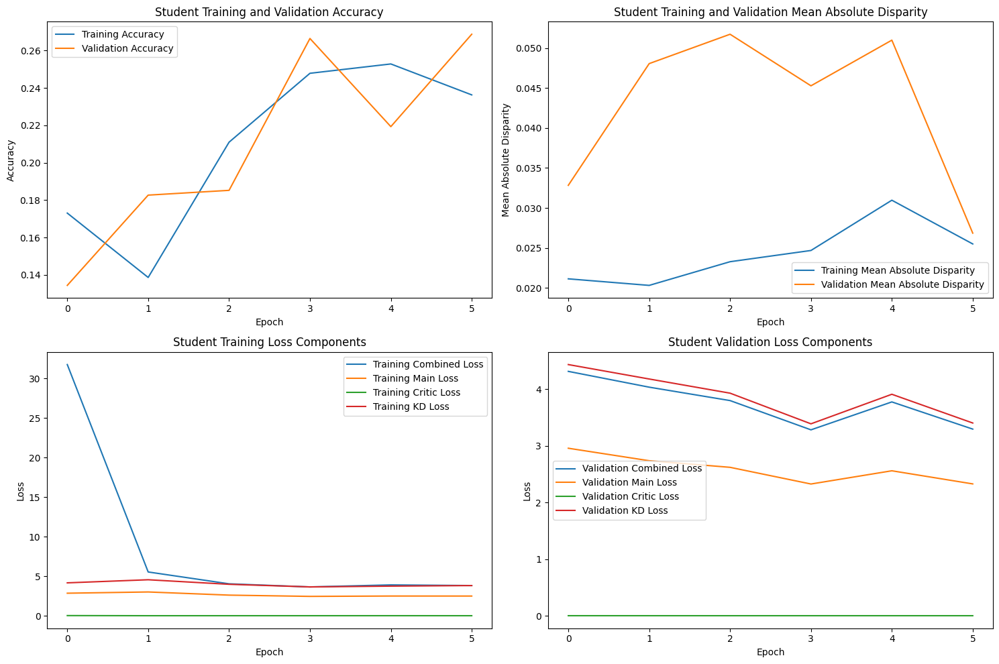

Epoch 7/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.72it/s]



STUDENT - Lambda 140 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.276003, VALIDATION Accuracy: 0.2855
TRAINING Disparity: 0.016037, VALIDATION Disparity: 0.0333
TRAINING Combined Loss: 3.393415, VALIDATION Combined Loss: 3.1073
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.0438138611549016
Class Celebration: Val Disparity = -0.037209302325581395
Class Parade: Val Disparity = 0.024395965282664744
Class Waiter_Or_Waitress: Val Disparity = -0.035460992907801414
Class Individual_Sports: Val Disparity = -0.04811668295616872
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0038314176245210704
Class Business: Val Disparity = -0.04667519181585677
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.028484453141987442
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Cla

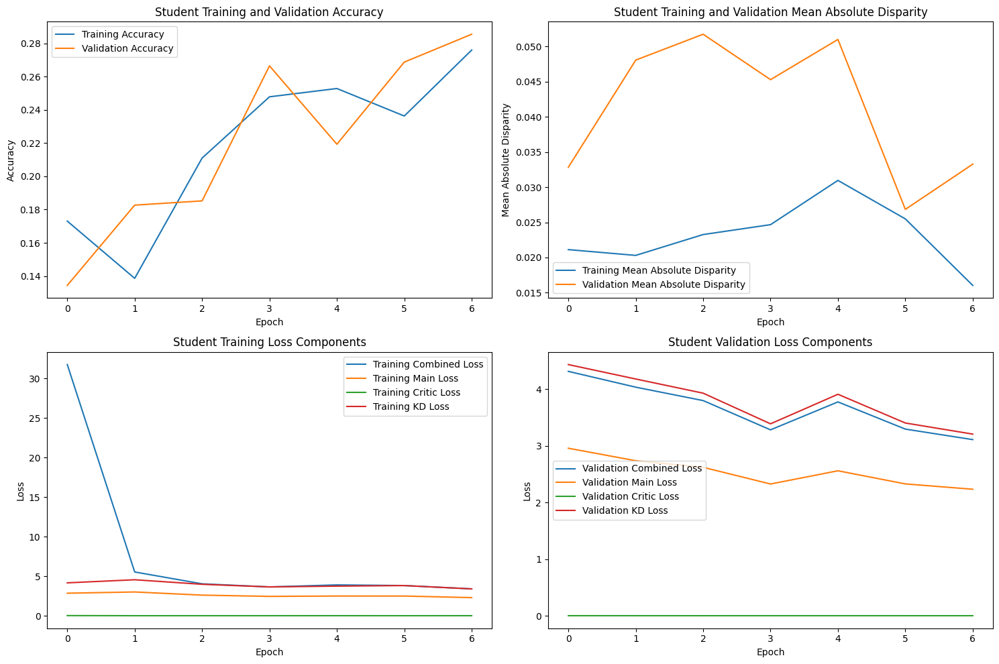

Epoch 8/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 140 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.291744, VALIDATION Accuracy: 0.3023
TRAINING Disparity: 0.024697, VALIDATION Disparity: 0.0478
TRAINING Combined Loss: 3.235417, VALIDATION Combined Loss: 3.0159
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.0553745547965202
Class Celebration: Val Disparity = -0.009302325581395321
Class Parade: Val Disparity = 0.014191883650011672
Class Waiter_Or_Waitress: Val Disparity = -0.09007092198581565
Class Individual_Sports: Val Disparity = -0.03405758965491318
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.10512452107279693
Class Business: Val Disparity = -0.04880647911338448
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.050880626223092085
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class 

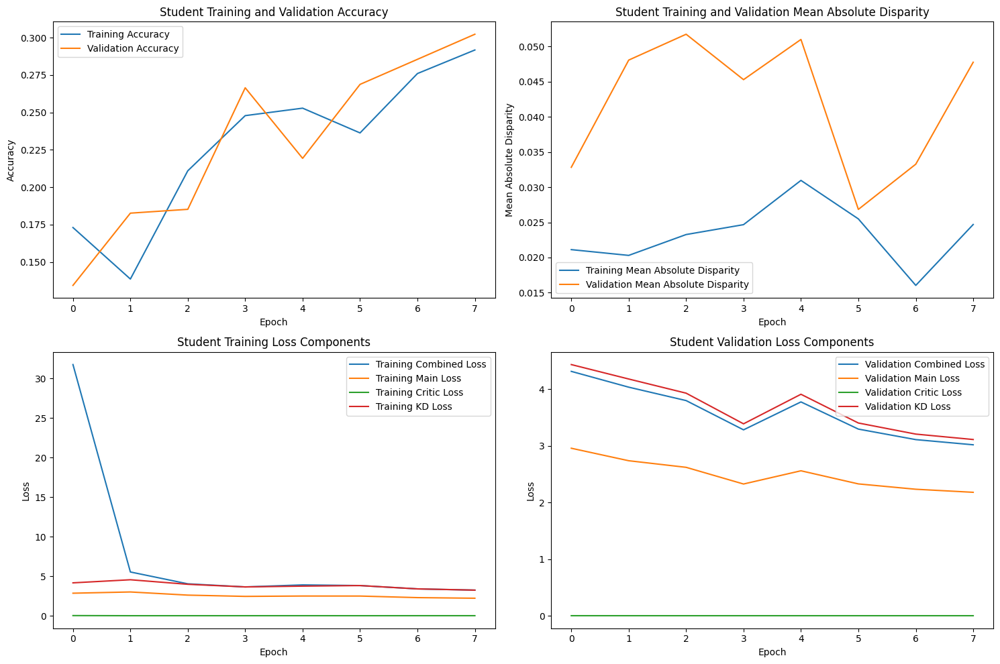

Epoch 9/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.78it/s]



STUDENT - Lambda 140 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.323881, VALIDATION Accuracy: 0.3170
TRAINING Disparity: 0.028588, VALIDATION Disparity: 0.0567
TRAINING Combined Loss: 3.131624, VALIDATION Combined Loss: 2.9295
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.003351433409236826
Class Celebration: Val Disparity = 0.013953488372093092
Class Parade: Val Disparity = 0.021815622800844425
Class Waiter_Or_Waitress: Val Disparity = -0.020567375886524852
Class Individual_Sports: Val Disparity = -0.033982407337794174
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.19204980842911876
Class Business: Val Disparity = -0.08034953111679455
Class Dresses: Val Disparity = -0.023809523809523808
Class Water_Activities: Val Disparity = 0.03642096107849535
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Di

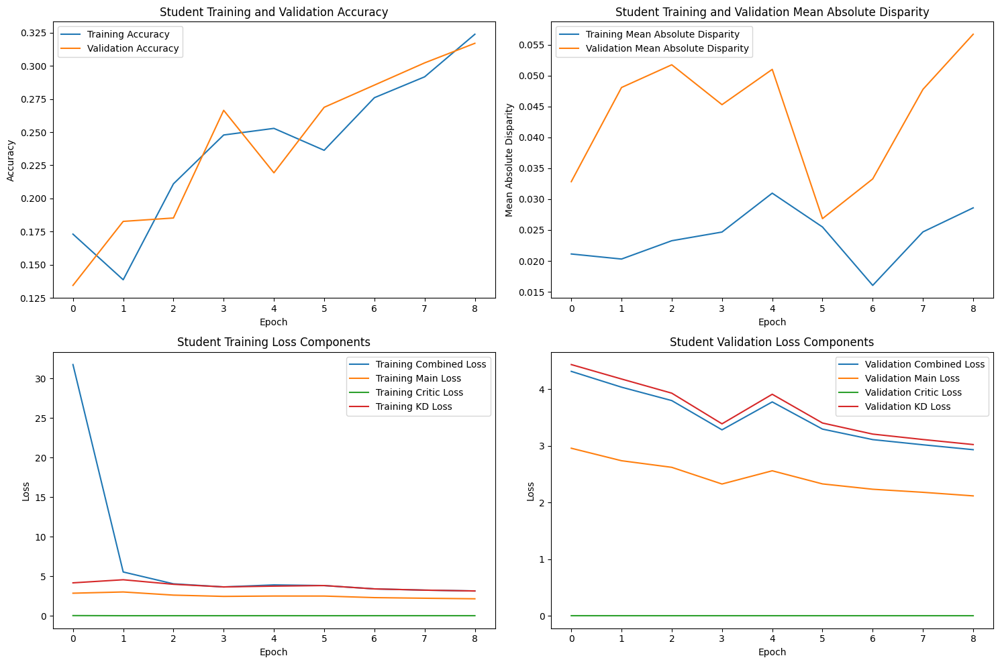

Epoch 10/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 140 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.343789, VALIDATION Accuracy: 0.3511
TRAINING Disparity: 0.035337, VALIDATION Disparity: 0.0708
TRAINING Combined Loss: 3.041203, VALIDATION Combined Loss: 2.8298
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.03879254977520863
Class Celebration: Val Disparity = -0.023255813953488358
Class Parade: Val Disparity = 0.074712643678161
Class Waiter_Or_Waitress: Val Disparity = -0.02836879432624112
Class Individual_Sports: Val Disparity = -0.05153747838508377
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.19923371647509575
Class Business: Val Disparity = -0.0705456095481671
Class Dresses: Val Disparity = -0.05357142857142857
Class Water_Activities: Val Disparity = 0.07251576429658624
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity

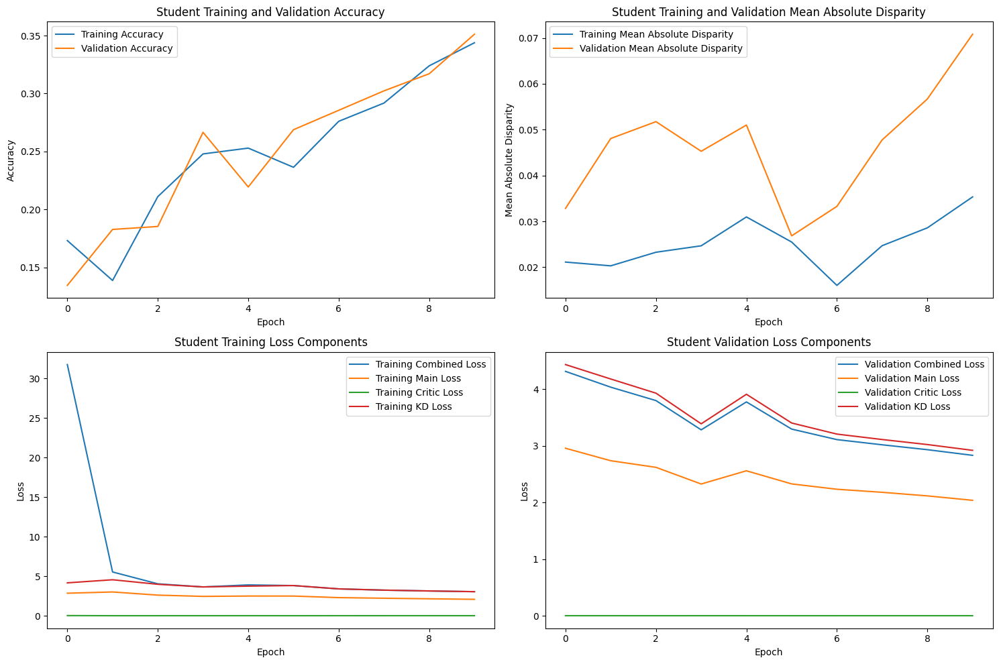

Epoch 11/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 140 - Epoch 11 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.358912, VALIDATION Accuracy: 0.3713
TRAINING Disparity: 0.054149, VALIDATION Disparity: 0.0659
TRAINING Combined Loss: 2.966483, VALIDATION Combined Loss: 2.7589
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.03043148245460381
Class Celebration: Val Disparity = 0.0023255813953488302
Class Parade: Val Disparity = 0.077175697865353
Class Waiter_Or_Waitress: Val Disparity = 0.0063829787234042645
Class Individual_Sports: Val Disparity = -0.03022329148184344
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.19276819923371652
Class Business: Val Disparity = -0.11722080136402388
Class Dresses: Val Disparity = -0.1369047619047619
Class Water_Activities: Val Disparity = 0.07034137856055661
Class Picnic: Val Disparity = -0.018518518518518517
Class Rescue: Val Disparity = 0.0
Class Chee

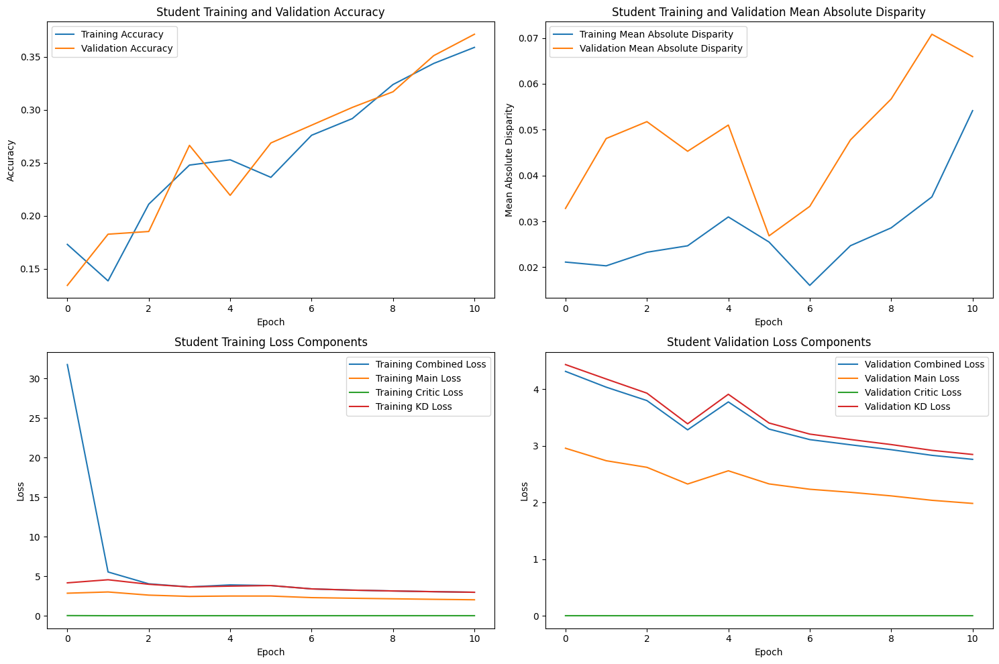

Epoch 12/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.78it/s]



STUDENT - Lambda 140 - Epoch 12 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.388657, VALIDATION Accuracy: 0.3906
TRAINING Disparity: 0.049270, VALIDATION Disparity: 0.0943
TRAINING Combined Loss: 2.874949, VALIDATION Combined Loss: 2.6871
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.020050213113796955
Class Celebration: Val Disparity = -0.03023255813953485
Class Parade: Val Disparity = 0.05993431855500819
Class Waiter_Or_Waitress: Val Disparity = -0.058865248226950384
Class Individual_Sports: Val Disparity = -0.026576949101571268
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.22772988505747122
Class Business: Val Disparity = -0.142156862745098
Class Dresses: Val Disparity = -0.25595238095238093
Class Water_Activities: Val Disparity = 0.10567514677103712
Class Picnic: Val Disparity = 0.09259259259259259
Class Rescue: Val Disparity = 0.0
Class Chee

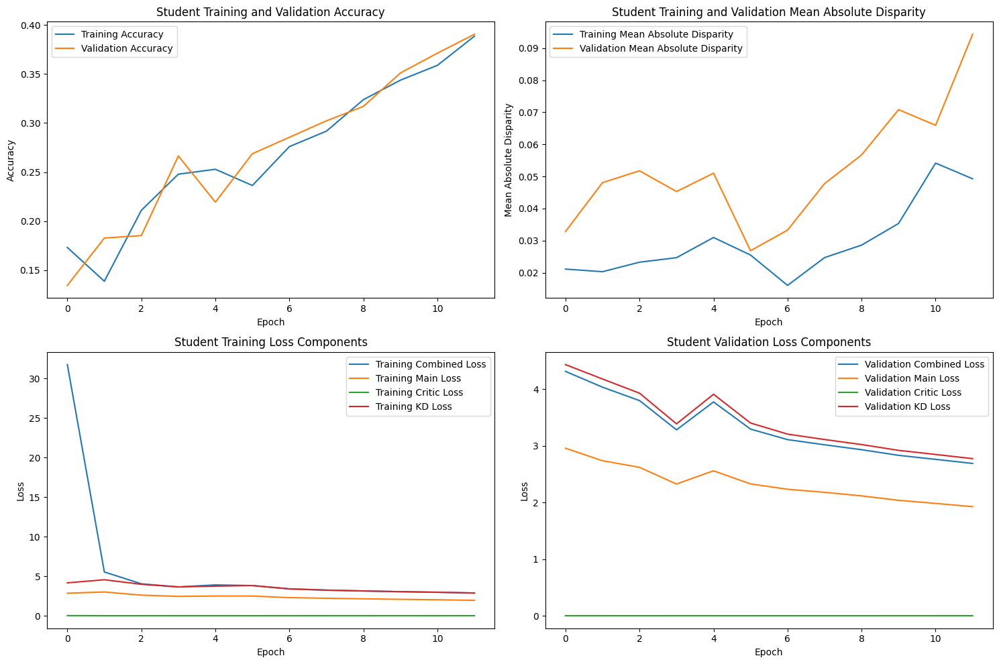

Epoch 13/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.78it/s]



STUDENT - Lambda 140 - Epoch 13 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.405652, VALIDATION Accuracy: 0.4125
TRAINING Disparity: 0.054159, VALIDATION Disparity: 0.1020
TRAINING Combined Loss: 2.788598, VALIDATION Combined Loss: 2.6005
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.010789980732177185
Class Celebration: Val Disparity = -0.05813953488372087
Class Parade: Val Disparity = 0.038822425521932824
Class Waiter_Or_Waitress: Val Disparity = -0.09361702127659571
Class Individual_Sports: Val Disparity = -0.1045410119539884
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.18630268199233713
Class Business: Val Disparity = -0.15068201193520886
Class Dresses: Val Disparity = -0.3452380952380952
Class Water_Activities: Val Disparity = 0.1258969341161122
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = -0.009690937663698268
Class Chee

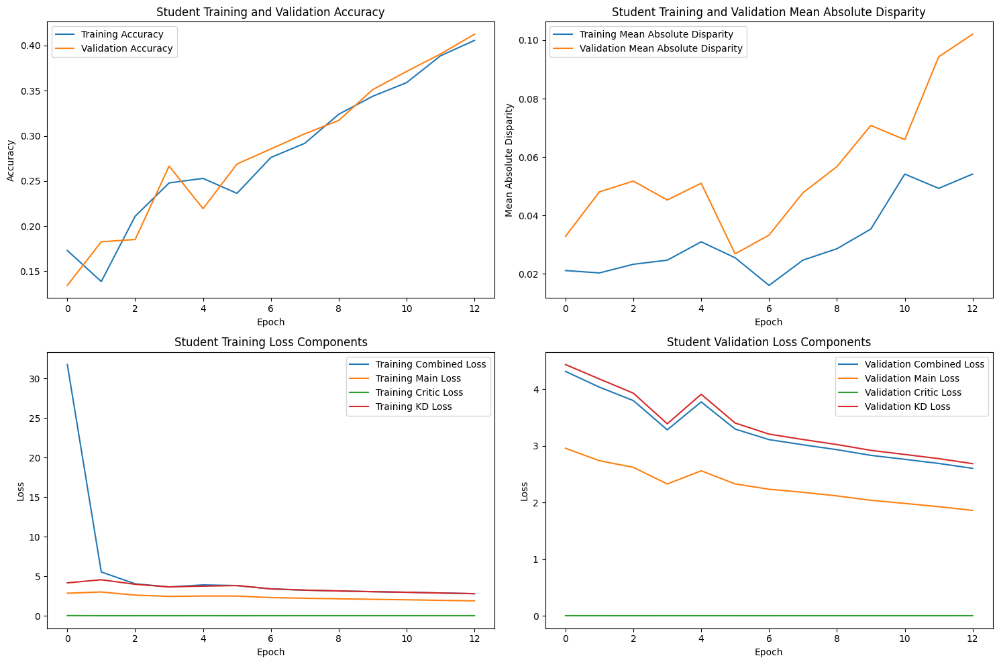

Epoch 14/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.71it/s]



STUDENT - Lambda 140 - Epoch 14 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.431790, VALIDATION Accuracy: 0.4321
TRAINING Disparity: 0.062385, VALIDATION Disparity: 0.1159
TRAINING Combined Loss: 2.696109, VALIDATION Combined Loss: 2.5211
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.028691539674198574
Class Celebration: Val Disparity = -0.0720930232558139
Class Parade: Val Disparity = 0.03307529908515128
Class Waiter_Or_Waitress: Val Disparity = -0.07092198581560283
Class Individual_Sports: Val Disparity = -0.07593414029020384
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.2138409961685825
Class Business: Val Disparity = -0.11359761295822679
Class Dresses: Val Disparity = -0.42857142857142855
Class Water_Activities: Val Disparity = 0.1280713198521417
Class Picnic: Val Disparity = 0.16666666666666663
Class Rescue: Val Disparity = -0.02173913043478

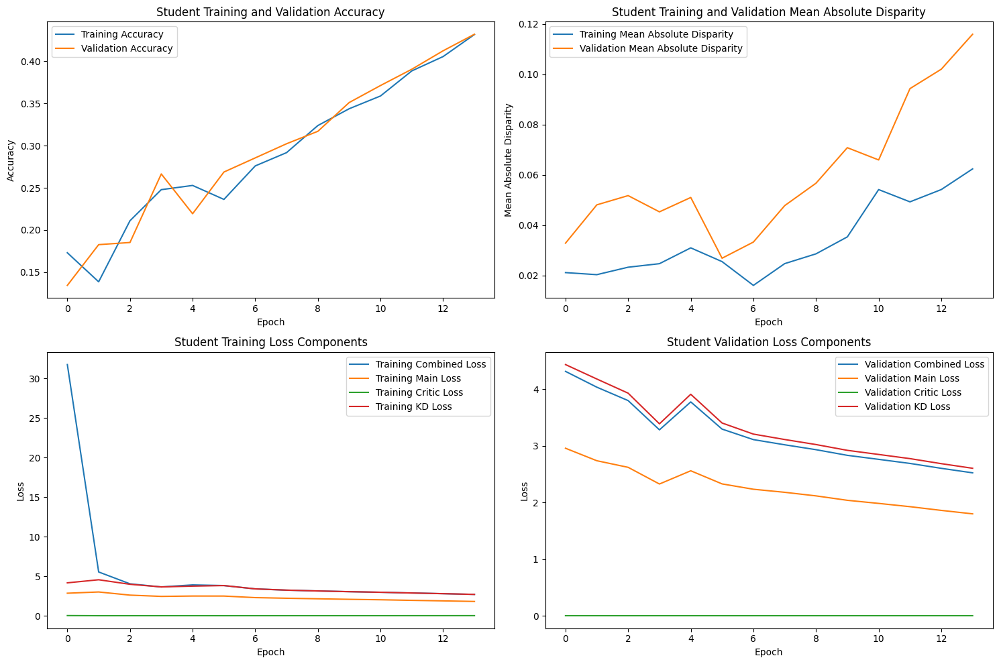

Epoch 15/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.75it/s]



STUDENT - Lambda 140 - Epoch 15 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.453877, VALIDATION Accuracy: 0.4540
TRAINING Disparity: 0.078984, VALIDATION Disparity: 0.1229
TRAINING Combined Loss: 2.617483, VALIDATION Combined Loss: 2.4501
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.03475214573480456
Class Celebration: Val Disparity = -0.020930232558139528
Class Parade: Val Disparity = 0.04210649777152242
Class Waiter_Or_Waitress: Val Disparity = -0.06028368794326239
Class Individual_Sports: Val Disparity = -0.11138260281181855
Class Surgeons: Val Disparity = 0.05128205128205129
Class Spa: Val Disparity = -0.02127659574468085
Class Law_Enforcement: Val Disparity = 0.28687739463601536
Class Business: Val Disparity = -0.1178601875532822
Class Dresses: Val Disparity = -0.5595238095238095
Class Water_Activities: Val Disparity = 0.16634050880626217
Class Picnic: Val Disparity = 0.18518518518518523
Class Rescue:

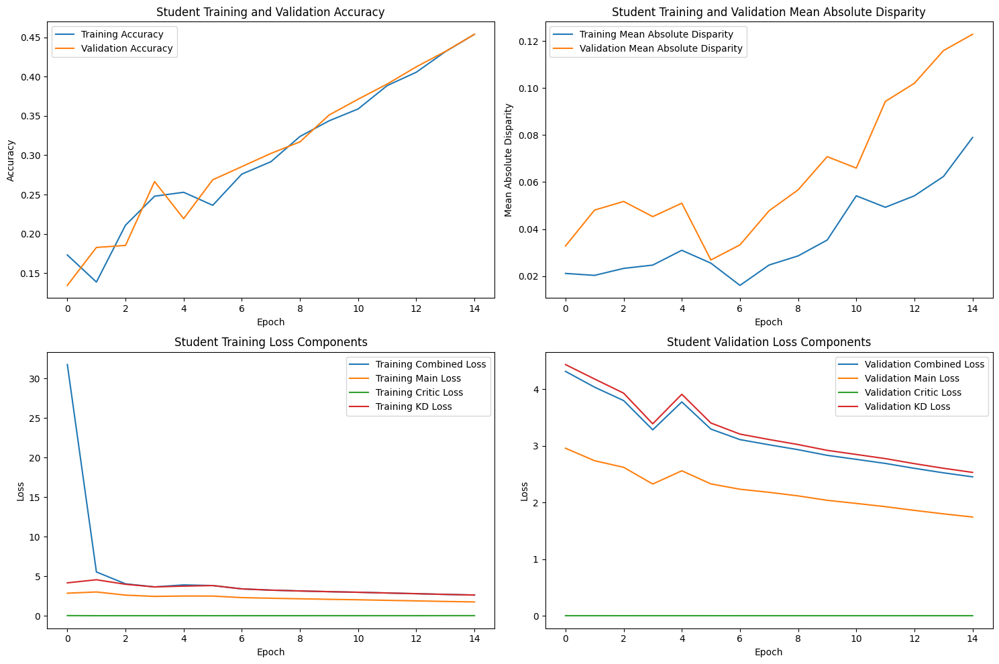

Epoch 16/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.75it/s]



STUDENT - Lambda 140 - Epoch 16 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.474653, VALIDATION Accuracy: 0.4636
TRAINING Disparity: 0.085430, VALIDATION Disparity: 0.1255
TRAINING Combined Loss: 2.533777, VALIDATION Combined Loss: 2.3831
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.005850411630758501
Class Celebration: Val Disparity = -0.020930232558139583
Class Parade: Val Disparity = 0.014661036828524376
Class Waiter_Or_Waitress: Val Disparity = -0.10283687943262415
Class Individual_Sports: Val Disparity = -0.11833696714532749
Class Surgeons: Val Disparity = 0.05128205128205129
Class Spa: Val Disparity = 0.1843971631205674
Class Law_Enforcement: Val Disparity = 0.3113026819923371
Class Business: Val Disparity = -0.06457800511508949
Class Dresses: Val Disparity = -0.45833333333333337
Class Water_Activities: Val Disparity = 0.1641661230702326
Class Picnic: Val Disparity = 0.16666666666666669
Class Rescue:

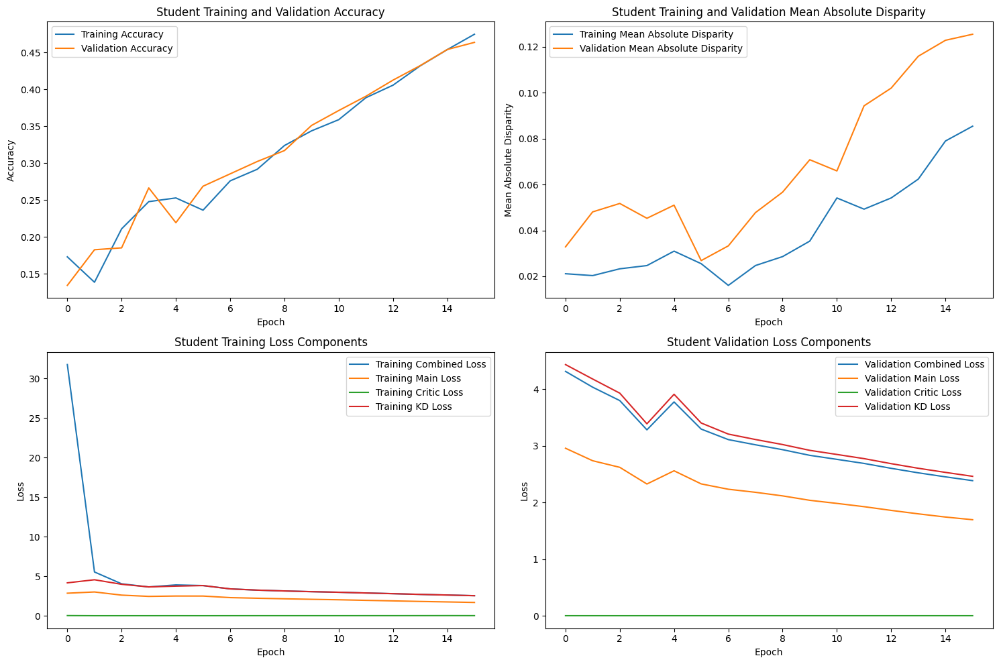

Epoch 17/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 140 - Epoch 17 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.487269, VALIDATION Accuracy: 0.4889
TRAINING Disparity: 0.097053, VALIDATION Disparity: 0.1292
TRAINING Combined Loss: 2.457269, VALIDATION Combined Loss: 2.3226
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.005570152390961702
Class Celebration: Val Disparity = -0.05348837209302337
Class Parade: Val Disparity = 0.033075299085151166
Class Waiter_Or_Waitress: Val Disparity = -0.14397163120567374
Class Individual_Sports: Val Disparity = -0.1290128561762275
Class Surgeons: Val Disparity = 0.010989010989010978
Class Spa: Val Disparity = 0.07801418439716312
Class Law_Enforcement: Val Disparity = 0.35296934865900387
Class Business: Val Disparity = -0.04816709292412613
Class Dresses: Val Disparity = -0.6071428571428571
Class Water_Activities: Val Disparity = 0.21102413568167
Class Picnic: Val Disparity = 0.07407407407407407
Class Rescue: V

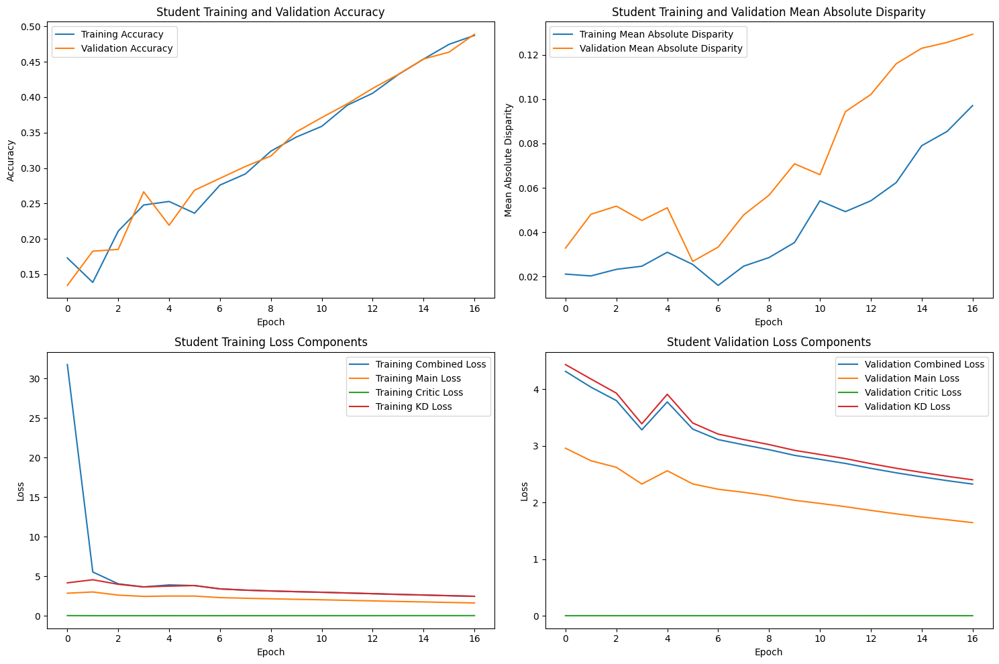

Epoch 18/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.78it/s]



STUDENT - Lambda 140 - Epoch 18 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.513792, VALIDATION Accuracy: 0.5003
TRAINING Disparity: 0.111383, VALIDATION Disparity: 0.1247
TRAINING Combined Loss: 2.375403, VALIDATION Combined Loss: 2.2600
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.0075903544111637355
Class Celebration: Val Disparity = -0.03720930232558134
Class Parade: Val Disparity = 0.10192352803190252
Class Waiter_Or_Waitress: Val Disparity = -0.17872340425531918
Class Individual_Sports: Val Disparity = -0.12893767385910837
Class Surgeons: Val Disparity = 0.03663003663003661
Class Spa: Val Disparity = -0.049645390070921946
Class Law_Enforcement: Val Disparity = 0.34626436781609204
Class Business: Val Disparity = -0.06010230179028131
Class Dresses: Val Disparity = -0.5773809523809523
Class Water_Activities: Val Disparity = 0.16851489454229174
Class Picnic: Val Disparity = 5.551115123125783e-17
Class Re

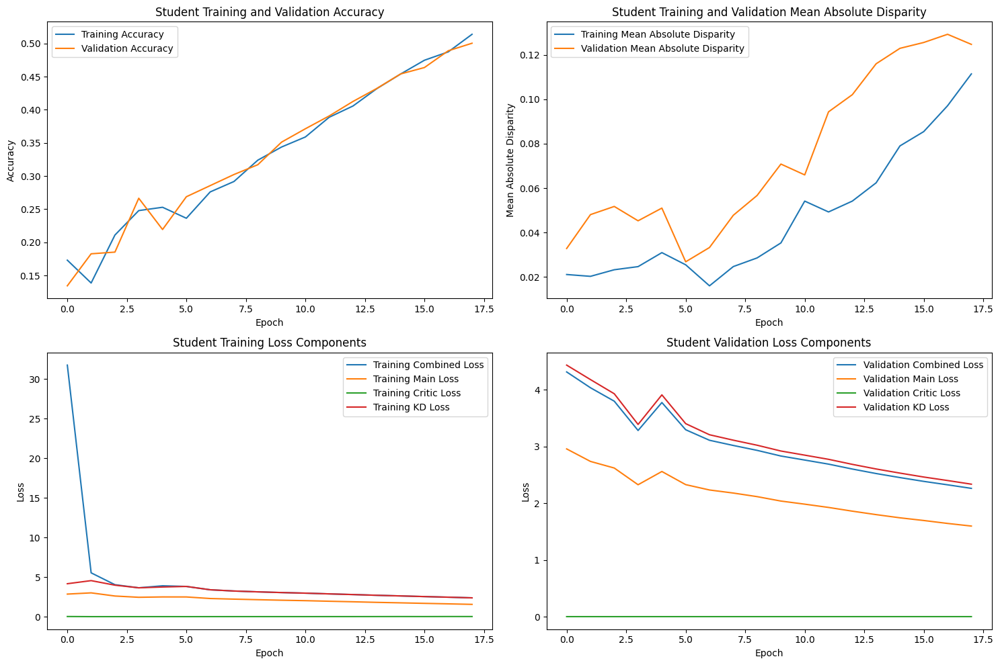

Epoch 19/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 140 - Epoch 19 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.533410, VALIDATION Accuracy: 0.5154
TRAINING Disparity: 0.110027, VALIDATION Disparity: 0.1395
TRAINING Combined Loss: 2.294982, VALIDATION Combined Loss: 2.2039
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.045693933555205124
Class Celebration: Val Disparity = -0.08604651162790694
Class Parade: Val Disparity = 0.05348346235045742
Class Waiter_Or_Waitress: Val Disparity = -0.24113475177304966
Class Individual_Sports: Val Disparity = -0.1784828208405383
Class Surgeons: Val Disparity = 0.008058608058608058
Class Spa: Val Disparity = -0.09219858156028377
Class Law_Enforcement: Val Disparity = 0.2634099616858238
Class Business: Val Disparity = -0.08184143222506396
Class Dresses: Val Disparity = -0.5833333333333333
Class Water_Activities: Val Disparity = 0.17068928027832142
Class Picnic: Val Disparity = 0.018518518518518545
Class Rescue

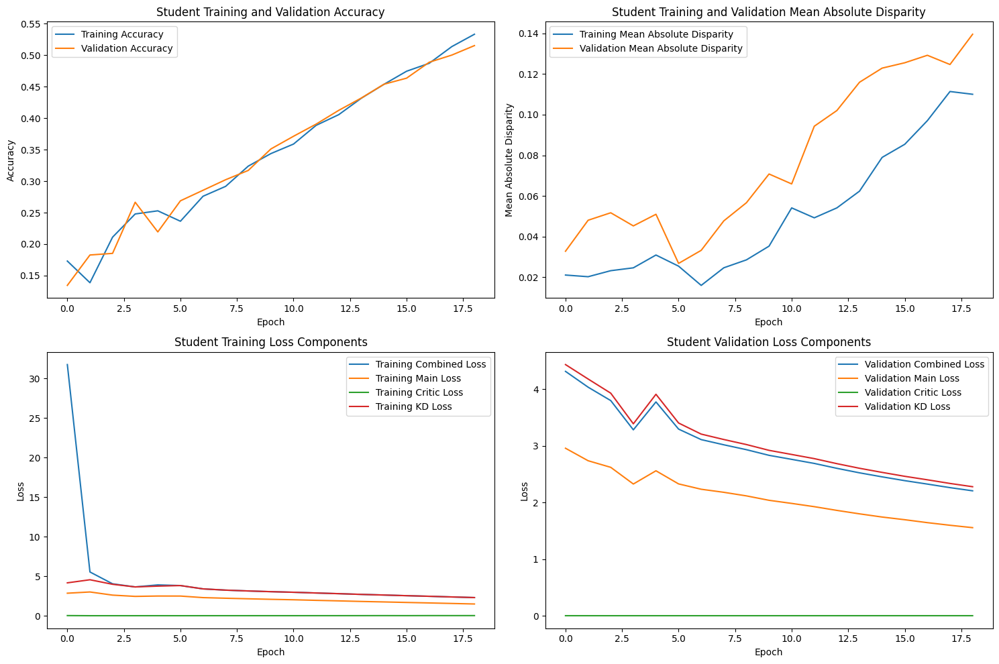

Epoch 20/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.71it/s]



STUDENT - Lambda 140 - Epoch 20 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.554417, VALIDATION Accuracy: 0.5281
TRAINING Disparity: 0.119589, VALIDATION Disparity: 0.1512
TRAINING Combined Loss: 2.208781, VALIDATION Combined Loss: 2.1610
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.030711741694400718
Class Celebration: Val Disparity = -0.12325581395348845
Class Parade: Val Disparity = 0.07389162561576357
Class Waiter_Or_Waitress: Val Disparity = -0.28226950354609937
Class Individual_Sports: Val Disparity = -0.20667618976016844
Class Surgeons: Val Disparity = -0.00366300366300365
Class Spa: Val Disparity = -0.17730496453900707
Class Law_Enforcement: Val Disparity = 0.24257662835249044
Class Business: Val Disparity = 0.02919863597612965
Class Dresses: Val Disparity = -0.6130952380952381
Class Water_Activities: Val Disparity = 0.14905414220482727
Class Picnic: Val Disparity = -0.09259259259259273
Class Rescu

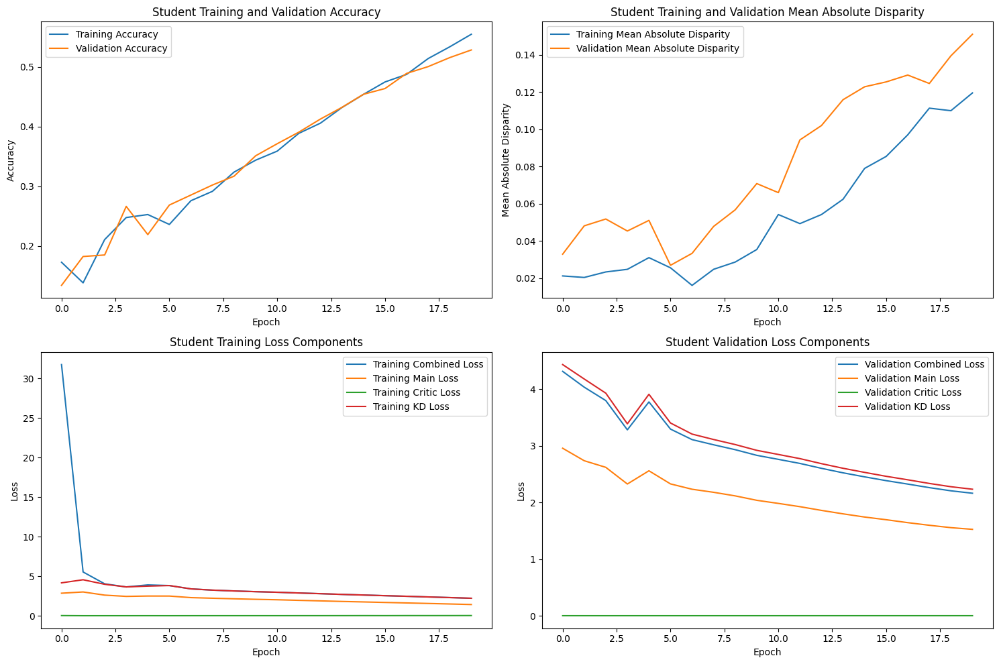

Epoch 21/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.75it/s]



STUDENT - Lambda 140 - Epoch 21 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.577643, VALIDATION Accuracy: 0.5361
TRAINING Disparity: 0.127521, VALIDATION Disparity: 0.1360
TRAINING Combined Loss: 2.126783, VALIDATION Combined Loss: 2.1046
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05607520289601209
Class Celebration: Val Disparity = -0.08604651162790694
Class Parade: Val Disparity = 0.07260145437485344
Class Waiter_Or_Waitress: Val Disparity = -0.28226950354609937
Class Individual_Sports: Val Disparity = -0.1536350650327043
Class Surgeons: Val Disparity = -0.03809523809523807
Class Spa: Val Disparity = -0.07092198581560288
Class Law_Enforcement: Val Disparity = 0.2701149425287357
Class Business: Val Disparity = -0.021952259164535415
Class Dresses: Val Disparity = -0.6071428571428572
Class Water_Activities: Val Disparity = 0.1627527723418133
Class Picnic: Val Disparity = -1.6653345369377348e-16
Class Resc

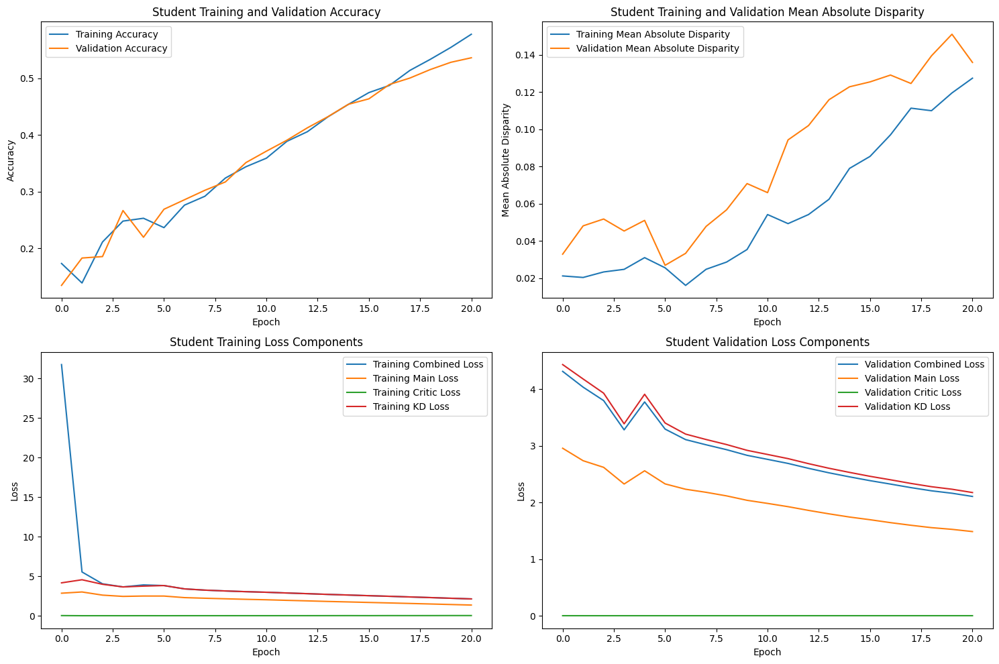

Epoch 22/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 140 - Epoch 22 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.598380, VALIDATION Accuracy: 0.5489
TRAINING Disparity: 0.091599, VALIDATION Disparity: 0.1398
TRAINING Combined Loss: 2.044204, VALIDATION Combined Loss: 2.0684
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.03935306825480245
Class Celebration: Val Disparity = -0.08837209302325577
Class Parade: Val Disparity = 0.05923058878723908
Class Waiter_Or_Waitress: Val Disparity = -0.30354609929078014
Class Individual_Sports: Val Disparity = -0.1464927449063982
Class Surgeons: Val Disparity = -0.04395604395604391
Class Spa: Val Disparity = -0.17730496453900707
Class Law_Enforcement: Val Disparity = 0.2703544061302681
Class Business: Val Disparity = 0.036871270247229304
Class Dresses: Val Disparity = -0.5892857142857144
Class Water_Activities: Val Disparity = 0.12959338986736246
Class Picnic: Val Disparity = -0.09259259259259262
Class Rescue:

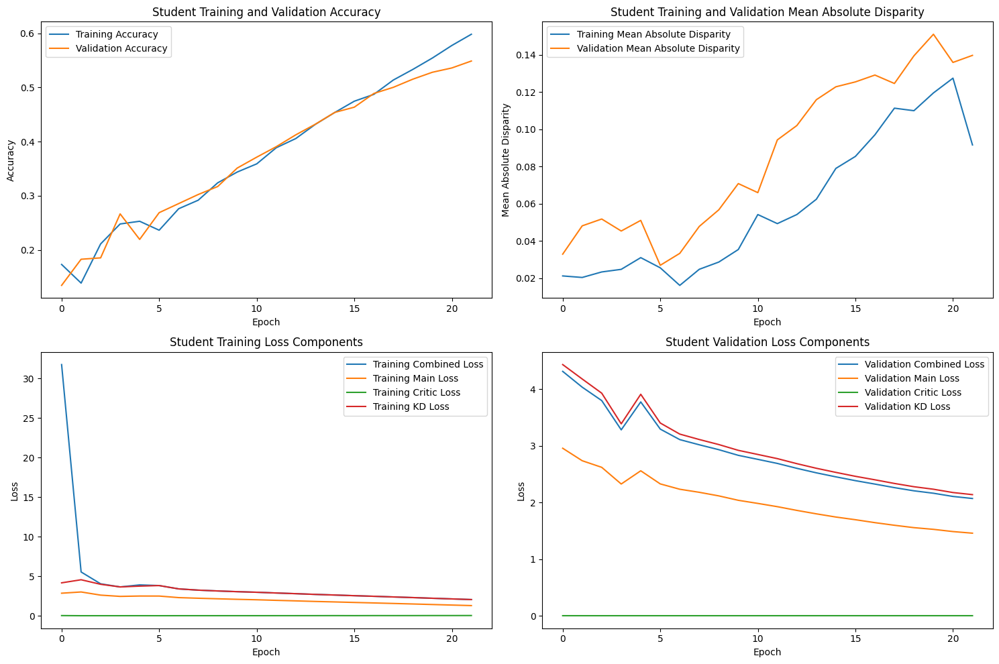

Epoch 23/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.72it/s]



STUDENT - Lambda 140 - Epoch 23 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.621335, VALIDATION Accuracy: 0.5503
TRAINING Disparity: 0.105360, VALIDATION Disparity: 0.1559
TRAINING Combined Loss: 1.957273, VALIDATION Combined Loss: 2.0479
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.021112862731359816
Class Celebration: Val Disparity = -0.09302325581395354
Class Parade: Val Disparity = 0.03553835327234345
Class Waiter_Or_Waitress: Val Disparity = -0.22482269503546104
Class Individual_Sports: Val Disparity = -0.2103977144575595
Class Surgeons: Val Disparity = -0.07545787545787552
Class Spa: Val Disparity = -0.13475177304964542
Class Law_Enforcement: Val Disparity = 0.2945402298850577
Class Business: Val Disparity = -0.016624040920716066
Class Dresses: Val Disparity = -0.7023809523809524
Class Water_Activities: Val Disparity = 0.15916503587736452
Class Picnic: Val Disparity = -0.09259259259259267
Class Rescu

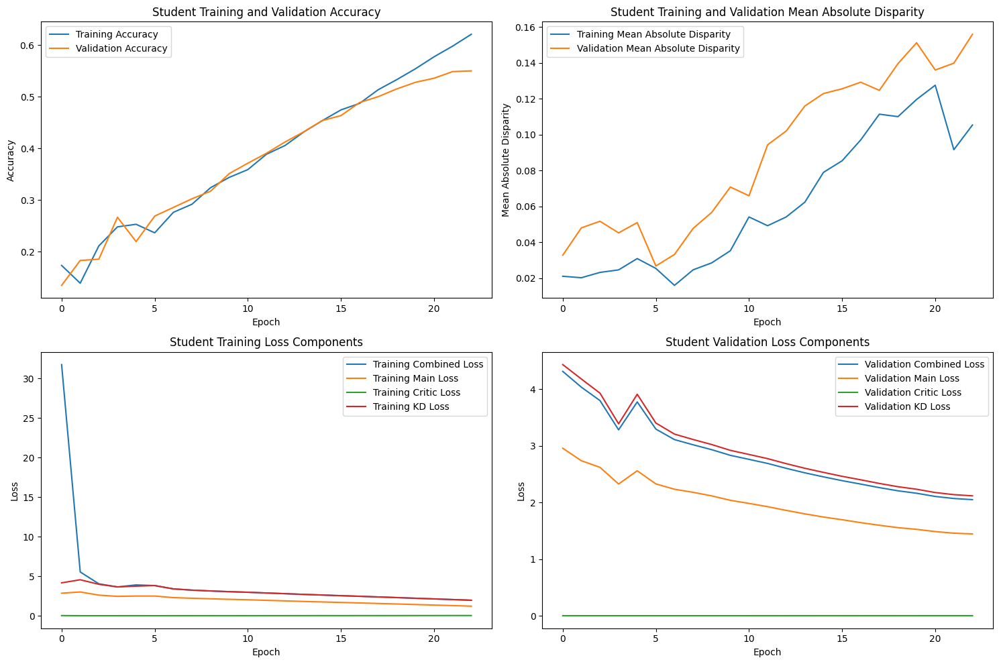

Epoch 24/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.78it/s]



STUDENT - Lambda 140 - Epoch 24 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.642149, VALIDATION Accuracy: 0.5620
TRAINING Disparity: 0.112621, VALIDATION Disparity: 0.1387
TRAINING Combined Loss: 1.869250, VALIDATION Combined Loss: 2.0178
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.030092835873182677
Class Celebration: Val Disparity = -0.08837209302325588
Class Parade: Val Disparity = 0.056650246305418706
Class Waiter_Or_Waitress: Val Disparity = -0.21418439716312054
Class Individual_Sports: Val Disparity = -0.18539959401548756
Class Surgeons: Val Disparity = 0.013186813186813195
Class Spa: Val Disparity = -0.17730496453900707
Class Law_Enforcement: Val Disparity = 0.2430555555555557
Class Business: Val Disparity = -0.010017050298380237
Class Dresses: Val Disparity = -0.6785714285714286
Class Water_Activities: Val Disparity = 0.13752989780387026
Class Picnic: Val Disparity = -0.1111111111111111
Class Resc

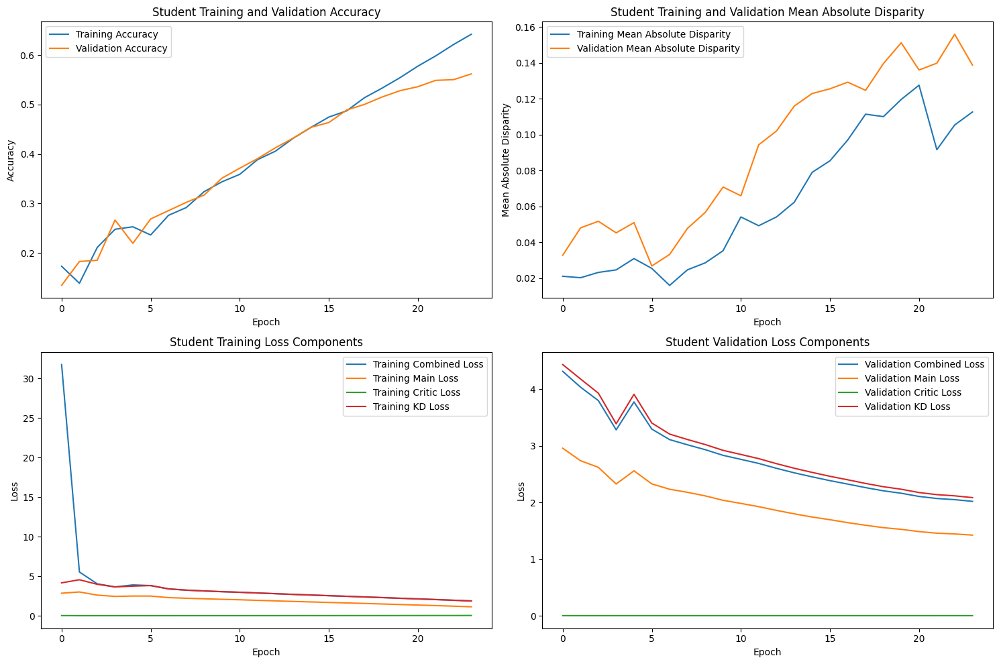

Epoch 25/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 140 - Epoch 25 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.671933, VALIDATION Accuracy: 0.5642
TRAINING Disparity: 0.113049, VALIDATION Disparity: 0.1509
TRAINING Combined Loss: 1.768001, VALIDATION Combined Loss: 2.0063
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04457289659601793
Class Celebration: Val Disparity = -0.0906976744186046
Class Parade: Val Disparity = 0.04644616467276563
Class Waiter_Or_Waitress: Val Disparity = -0.23404255319148948
Class Individual_Sports: Val Disparity = -0.17825727388918122
Class Surgeons: Val Disparity = -0.04395604395604391
Class Spa: Val Disparity = -0.17730496453900707
Class Law_Enforcement: Val Disparity = 0.24952107279693497
Class Business: Val Disparity = -0.002344416027280416
Class Dresses: Val Disparity = -0.6607142857142857
Class Water_Activities: Val Disparity = 0.1065449010654489
Class Picnic: Val Disparity = -0.25925925925925936
Class Rescue

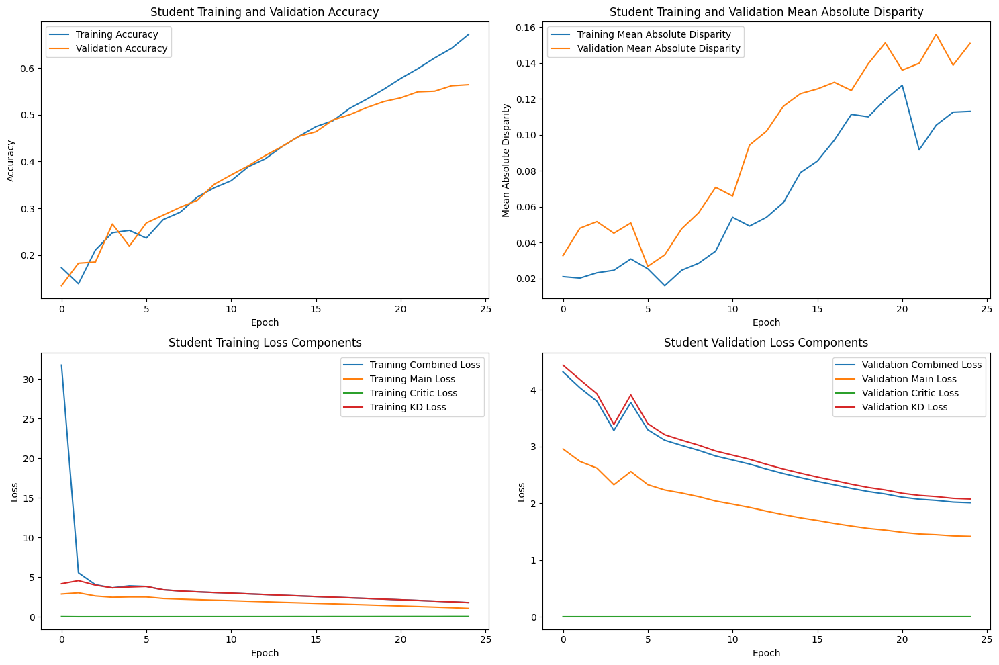

Epoch 26/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.70it/s]



STUDENT - Lambda 140 - Epoch 26 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.701292, VALIDATION Accuracy: 0.5697
TRAINING Disparity: 0.123177, VALIDATION Disparity: 0.1388
TRAINING Combined Loss: 1.681365, VALIDATION Combined Loss: 2.0115
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04457289659601793
Class Celebration: Val Disparity = -0.0906976744186046
Class Parade: Val Disparity = 0.04644616467276563
Class Waiter_Or_Waitress: Val Disparity = -0.23404255319148948
Class Individual_Sports: Val Disparity = -0.17825727388918122
Class Surgeons: Val Disparity = -0.04395604395604391
Class Spa: Val Disparity = -0.17730496453900707
Class Law_Enforcement: Val Disparity = 0.24952107279693497
Class Business: Val Disparity = -0.002344416027280416
Class Dresses: Val Disparity = -0.6607142857142857
Class Water_Activities: Val Disparity = 0.1065449010654489
Class Picnic: Val Disparity = -0.25925925925925936
Class Rescue

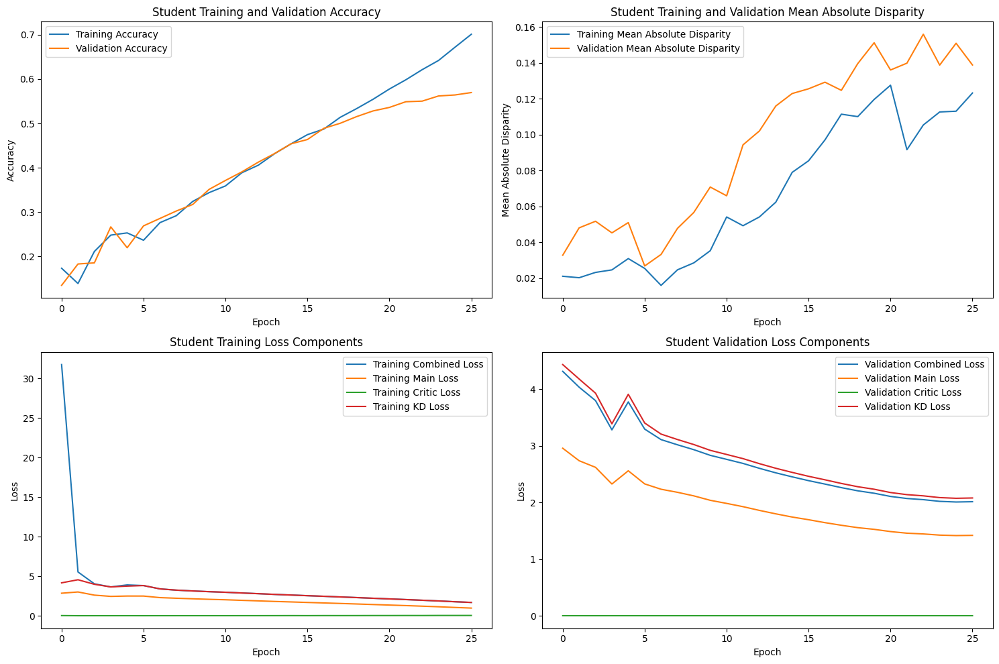

Epoch 27/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.78it/s]



STUDENT - Lambda 140 - Epoch 27 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.728819, VALIDATION Accuracy: 0.5759
TRAINING Disparity: 0.121686, VALIDATION Disparity: 0.1471
TRAINING Combined Loss: 1.594935, VALIDATION Combined Loss: 2.0082
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04457289659601793
Class Celebration: Val Disparity = -0.0906976744186046
Class Parade: Val Disparity = 0.04644616467276563
Class Waiter_Or_Waitress: Val Disparity = -0.23404255319148948
Class Individual_Sports: Val Disparity = -0.17825727388918122
Class Surgeons: Val Disparity = -0.04395604395604391
Class Spa: Val Disparity = -0.17730496453900707
Class Law_Enforcement: Val Disparity = 0.24952107279693497
Class Business: Val Disparity = -0.002344416027280416
Class Dresses: Val Disparity = -0.6607142857142857
Class Water_Activities: Val Disparity = 0.1065449010654489
Class Picnic: Val Disparity = -0.25925925925925936
Class Rescue

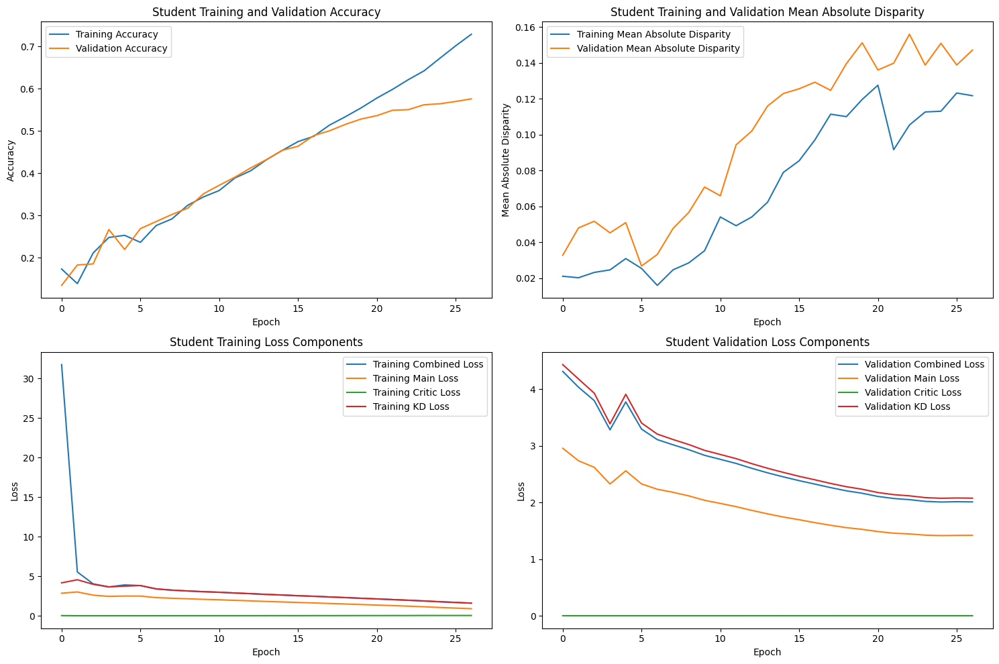

Epoch 28/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.69it/s]



STUDENT - Lambda 140 - Epoch 28 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.754128, VALIDATION Accuracy: 0.5763
TRAINING Disparity: 0.098163, VALIDATION Disparity: 0.1558
TRAINING Combined Loss: 1.499977, VALIDATION Combined Loss: 2.0103
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04457289659601793
Class Celebration: Val Disparity = -0.0906976744186046
Class Parade: Val Disparity = 0.04644616467276563
Class Waiter_Or_Waitress: Val Disparity = -0.23404255319148948
Class Individual_Sports: Val Disparity = -0.17825727388918122
Class Surgeons: Val Disparity = -0.04395604395604391
Class Spa: Val Disparity = -0.17730496453900707
Class Law_Enforcement: Val Disparity = 0.24952107279693497
Class Business: Val Disparity = -0.002344416027280416
Class Dresses: Val Disparity = -0.6607142857142857
Class Water_Activities: Val Disparity = 0.1065449010654489
Class Picnic: Val Disparity = -0.25925925925925936
Class Rescue

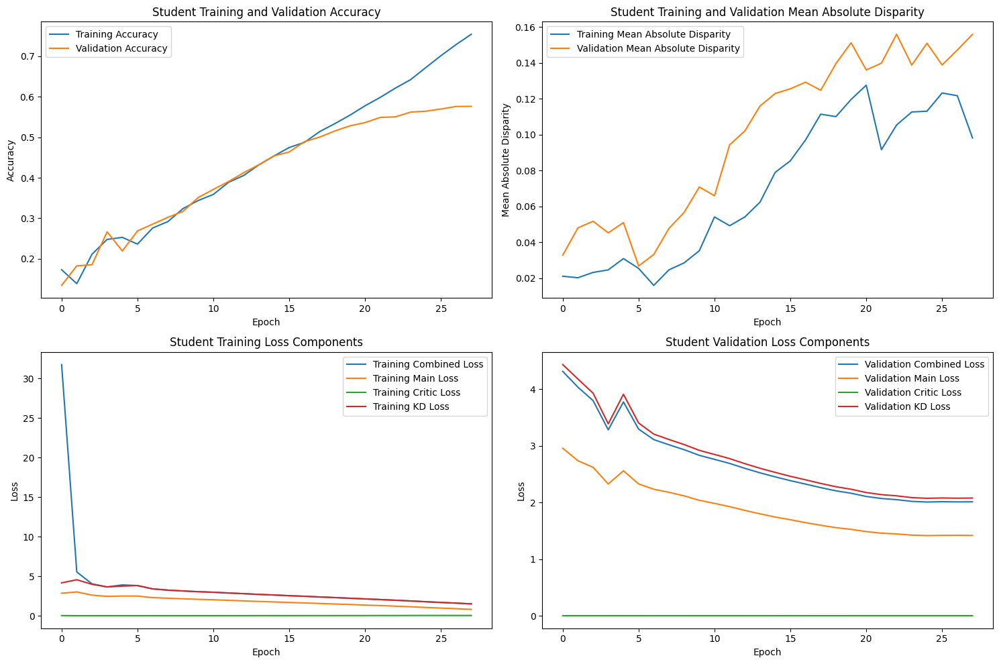

Epoch 29/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.73it/s]



STUDENT - Lambda 140 - Epoch 29 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.776524, VALIDATION Accuracy: 0.5833
TRAINING Disparity: 0.105813, VALIDATION Disparity: 0.1613
TRAINING Combined Loss: 1.417832, VALIDATION Combined Loss: 2.0144
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04457289659601793
Class Celebration: Val Disparity = -0.0906976744186046
Class Parade: Val Disparity = 0.04644616467276563
Class Waiter_Or_Waitress: Val Disparity = -0.23404255319148948
Class Individual_Sports: Val Disparity = -0.17825727388918122
Class Surgeons: Val Disparity = -0.04395604395604391
Class Spa: Val Disparity = -0.17730496453900707
Class Law_Enforcement: Val Disparity = 0.24952107279693497
Class Business: Val Disparity = -0.002344416027280416
Class Dresses: Val Disparity = -0.6607142857142857
Class Water_Activities: Val Disparity = 0.1065449010654489
Class Picnic: Val Disparity = -0.25925925925925936
Class Rescue

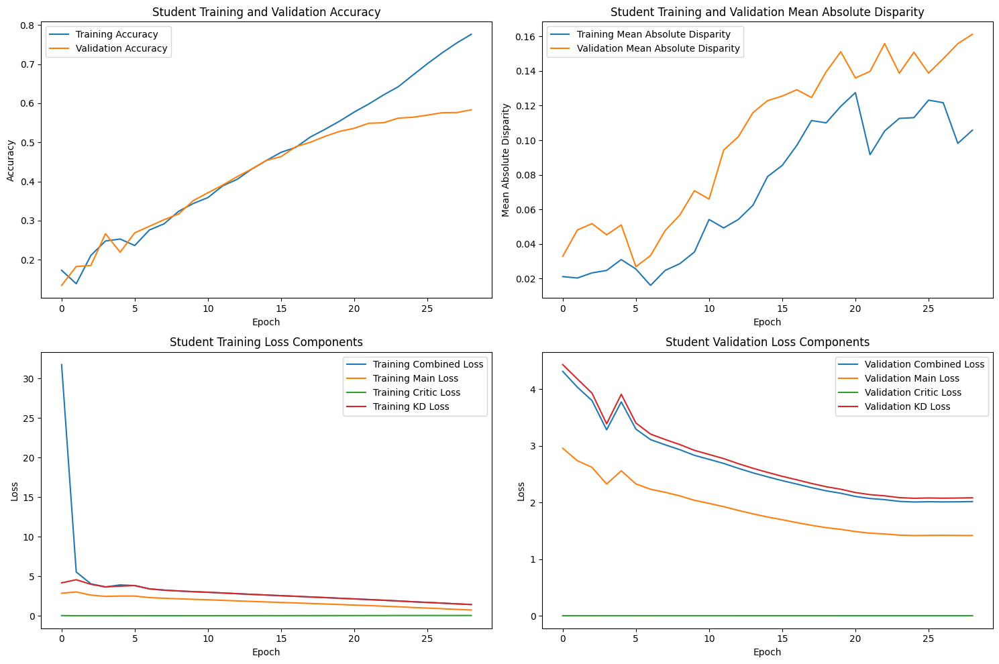

Epoch 30/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.73it/s]



STUDENT - Lambda 140 - Epoch 30 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.812384, VALIDATION Accuracy: 0.5837
TRAINING Disparity: 0.079926, VALIDATION Disparity: 0.1676
TRAINING Combined Loss: 1.323270, VALIDATION Combined Loss: 2.0690
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04457289659601793
Class Celebration: Val Disparity = -0.0906976744186046
Class Parade: Val Disparity = 0.04644616467276563
Class Waiter_Or_Waitress: Val Disparity = -0.23404255319148948
Class Individual_Sports: Val Disparity = -0.17825727388918122
Class Surgeons: Val Disparity = -0.04395604395604391
Class Spa: Val Disparity = -0.17730496453900707
Class Law_Enforcement: Val Disparity = 0.24952107279693497
Class Business: Val Disparity = -0.002344416027280416
Class Dresses: Val Disparity = -0.6607142857142857
Class Water_Activities: Val Disparity = 0.1065449010654489
Class Picnic: Val Disparity = -0.25925925925925936
Class Rescue

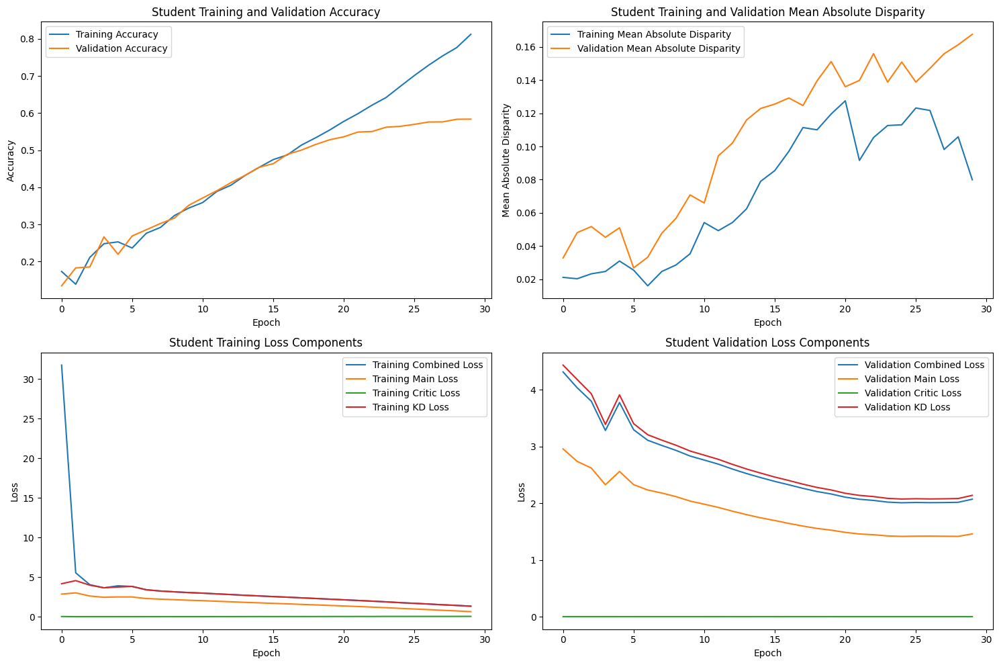

Epoch 31/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.71it/s]



STUDENT - Lambda 140 - Epoch 31 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.835745, VALIDATION Accuracy: 0.5771
TRAINING Disparity: 0.082505, VALIDATION Disparity: 0.1403
TRAINING Combined Loss: 1.242630, VALIDATION Combined Loss: 2.0743
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04457289659601793
Class Celebration: Val Disparity = -0.0906976744186046
Class Parade: Val Disparity = 0.04644616467276563
Class Waiter_Or_Waitress: Val Disparity = -0.23404255319148948
Class Individual_Sports: Val Disparity = -0.17825727388918122
Class Surgeons: Val Disparity = -0.04395604395604391
Class Spa: Val Disparity = -0.17730496453900707
Class Law_Enforcement: Val Disparity = 0.24952107279693497
Class Business: Val Disparity = -0.002344416027280416
Class Dresses: Val Disparity = -0.6607142857142857
Class Water_Activities: Val Disparity = 0.1065449010654489
Class Picnic: Val Disparity = -0.25925925925925936
Class Rescue

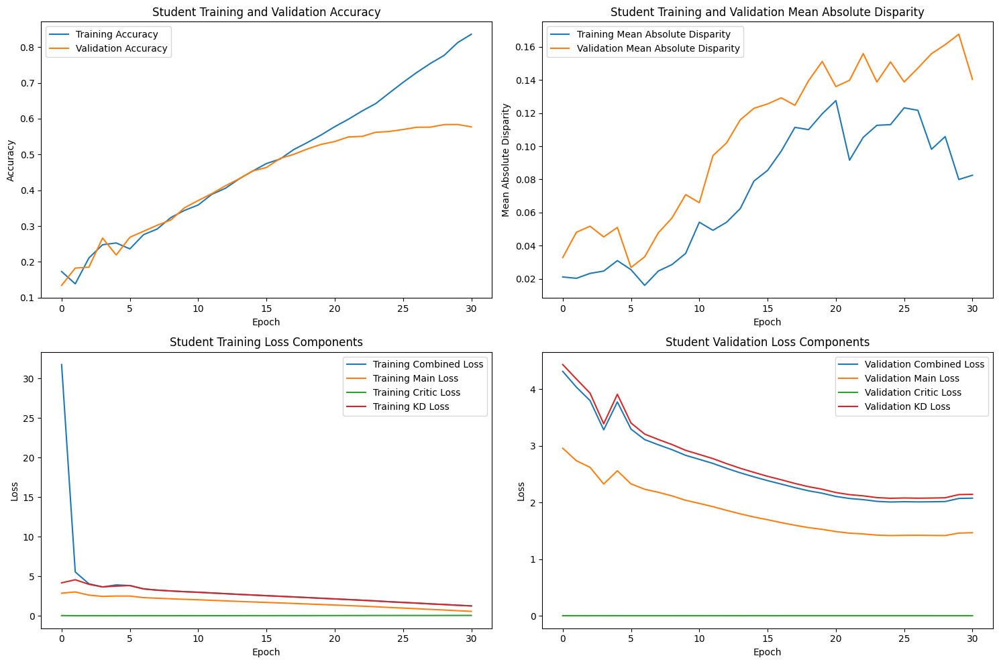

Epoch 32/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.72it/s]



STUDENT - Lambda 140 - Epoch 32 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.883005, VALIDATION Accuracy: 0.5876
TRAINING Disparity: 0.077906, VALIDATION Disparity: 0.1527
TRAINING Combined Loss: 1.108664, VALIDATION Combined Loss: 2.0270
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04457289659601793
Class Celebration: Val Disparity = -0.0906976744186046
Class Parade: Val Disparity = 0.04644616467276563
Class Waiter_Or_Waitress: Val Disparity = -0.23404255319148948
Class Individual_Sports: Val Disparity = -0.17825727388918122
Class Surgeons: Val Disparity = -0.04395604395604391
Class Spa: Val Disparity = -0.17730496453900707
Class Law_Enforcement: Val Disparity = 0.24952107279693497
Class Business: Val Disparity = -0.002344416027280416
Class Dresses: Val Disparity = -0.6607142857142857
Class Water_Activities: Val Disparity = 0.1065449010654489
Class Picnic: Val Disparity = -0.25925925925925936
Class Rescue

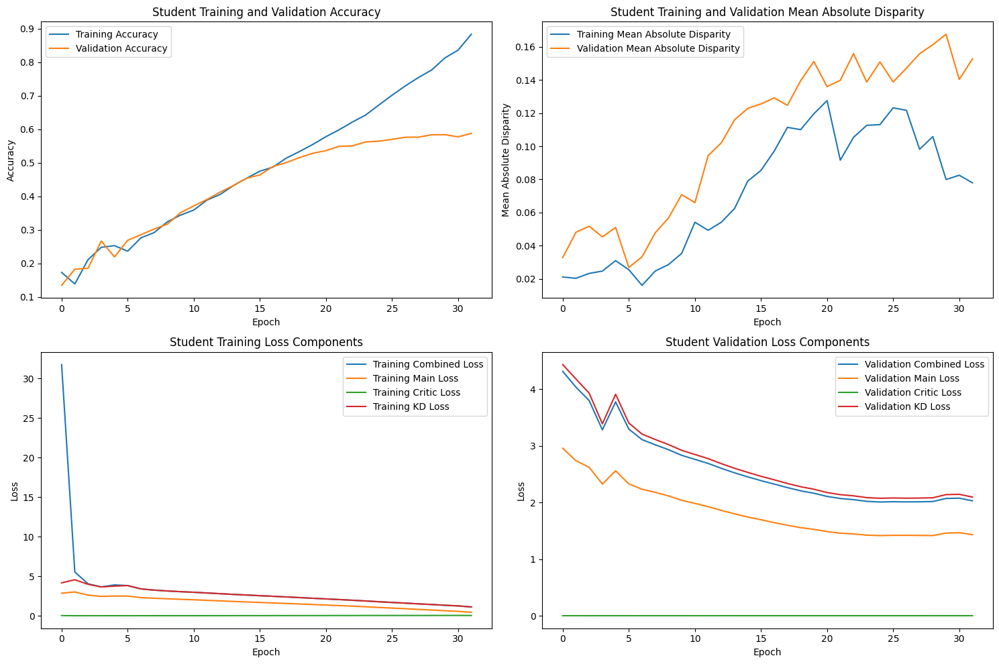

Epoch 33/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.72it/s]



STUDENT - Lambda 140 - Epoch 33 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.896740, VALIDATION Accuracy: 0.5851
TRAINING Disparity: 0.057850, VALIDATION Disparity: 0.1391
TRAINING Combined Loss: 1.066967, VALIDATION Combined Loss: 2.0328
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04457289659601793
Class Celebration: Val Disparity = -0.0906976744186046
Class Parade: Val Disparity = 0.04644616467276563
Class Waiter_Or_Waitress: Val Disparity = -0.23404255319148948
Class Individual_Sports: Val Disparity = -0.17825727388918122
Class Surgeons: Val Disparity = -0.04395604395604391
Class Spa: Val Disparity = -0.17730496453900707
Class Law_Enforcement: Val Disparity = 0.24952107279693497
Class Business: Val Disparity = -0.002344416027280416
Class Dresses: Val Disparity = -0.6607142857142857
Class Water_Activities: Val Disparity = 0.1065449010654489
Class Picnic: Val Disparity = -0.25925925925925936
Class Rescue

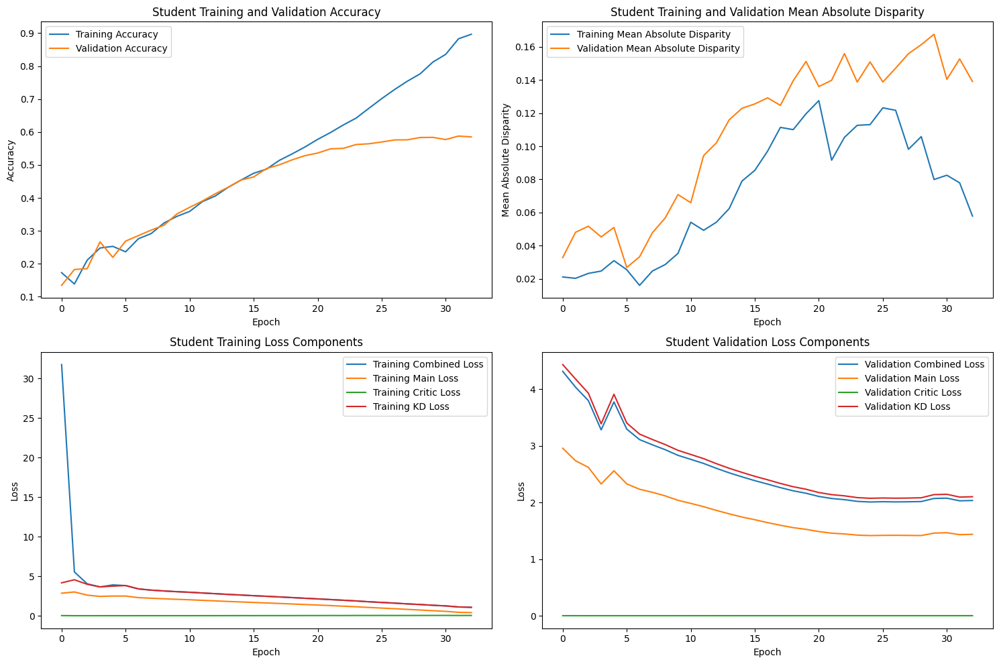

Epoch 34/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.76it/s]



STUDENT - Lambda 140 - Epoch 34 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.904880, VALIDATION Accuracy: 0.5913
TRAINING Disparity: 0.053475, VALIDATION Disparity: 0.1380
TRAINING Combined Loss: 1.050936, VALIDATION Combined Loss: 2.0312
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04457289659601793
Class Celebration: Val Disparity = -0.0906976744186046
Class Parade: Val Disparity = 0.04644616467276563
Class Waiter_Or_Waitress: Val Disparity = -0.23404255319148948
Class Individual_Sports: Val Disparity = -0.17825727388918122
Class Surgeons: Val Disparity = -0.04395604395604391
Class Spa: Val Disparity = -0.17730496453900707
Class Law_Enforcement: Val Disparity = 0.24952107279693497
Class Business: Val Disparity = -0.002344416027280416
Class Dresses: Val Disparity = -0.6607142857142857
Class Water_Activities: Val Disparity = 0.1065449010654489
Class Picnic: Val Disparity = -0.25925925925925936
Class Rescue

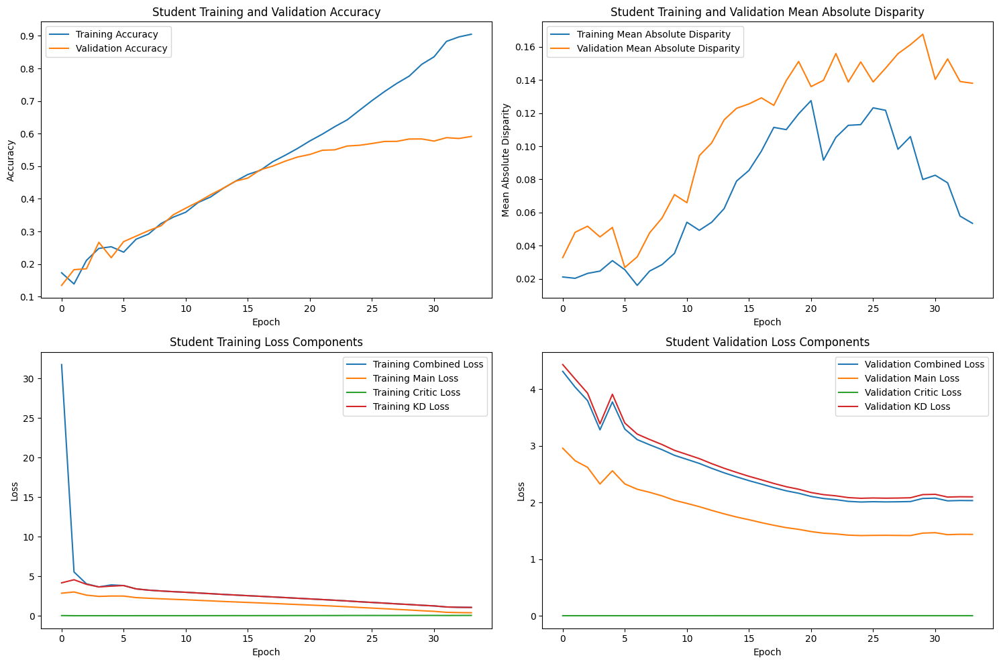

Epoch 35/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]


Early stopping triggered at epoch 35
Finished Training STUDENT with lambda value of 140. Best epoch number: 25
Training Student with Lambda Value of 120


Epoch 1/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.75it/s]



STUDENT - Lambda 120 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.185590, VALIDATION Accuracy: 0.1665
TRAINING Disparity: 0.010859, VALIDATION Disparity: 0.0219
TRAINING Combined Loss: 19.911727, VALIDATION Combined Loss: 3.7183
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05872598820575703
Class Celebration: Val Disparity = 0.030232558139534904
Class Parade: Val Disparity = -0.024161388693408337
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.014397413728291106
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.006944444444444445
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.008592471358428803
Class Performance_And_Entertainment: V

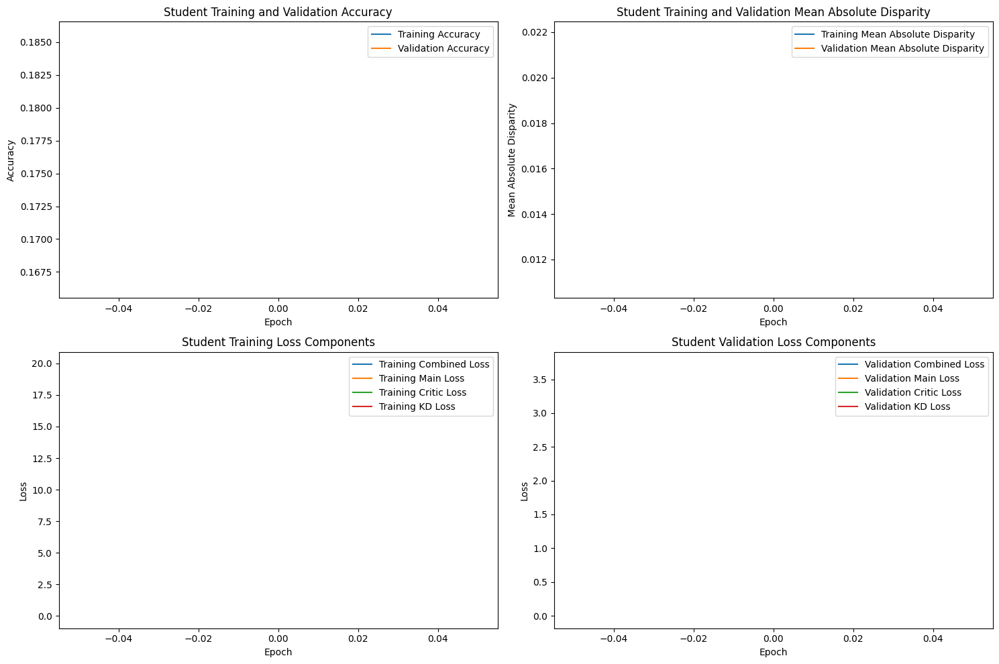

Epoch 2/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.71it/s]



STUDENT - Lambda 120 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.182948, VALIDATION Accuracy: 0.1699
TRAINING Disparity: 0.016644, VALIDATION Disparity: 0.0214
TRAINING Combined Loss: 5.881096, VALIDATION Combined Loss: 3.8122
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05872598820575703
Class Celebration: Val Disparity = 0.030232558139534904
Class Parade: Val Disparity = -0.024161388693408337
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.014397413728291106
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.006944444444444445
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.008592471358428803
Class Performance_And_Entertainment: Va

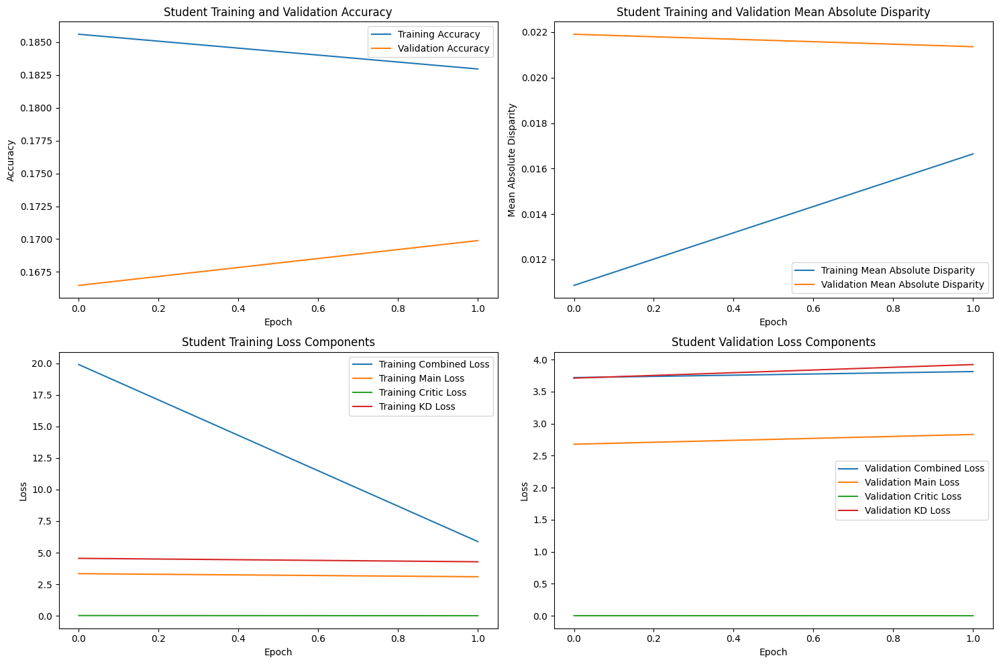

Epoch 3/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 120 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.198476, VALIDATION Accuracy: 0.2136
TRAINING Disparity: 0.018896, VALIDATION Disparity: 0.0328
TRAINING Combined Loss: 3.712751, VALIDATION Combined Loss: 3.4058
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.051918024172359356
Class Celebration: Val Disparity = -0.046511627906976744
Class Parade: Val Disparity = -0.008327468918601925
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.03672656191263818
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.006944444444444444
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: Val Disparity = 0.

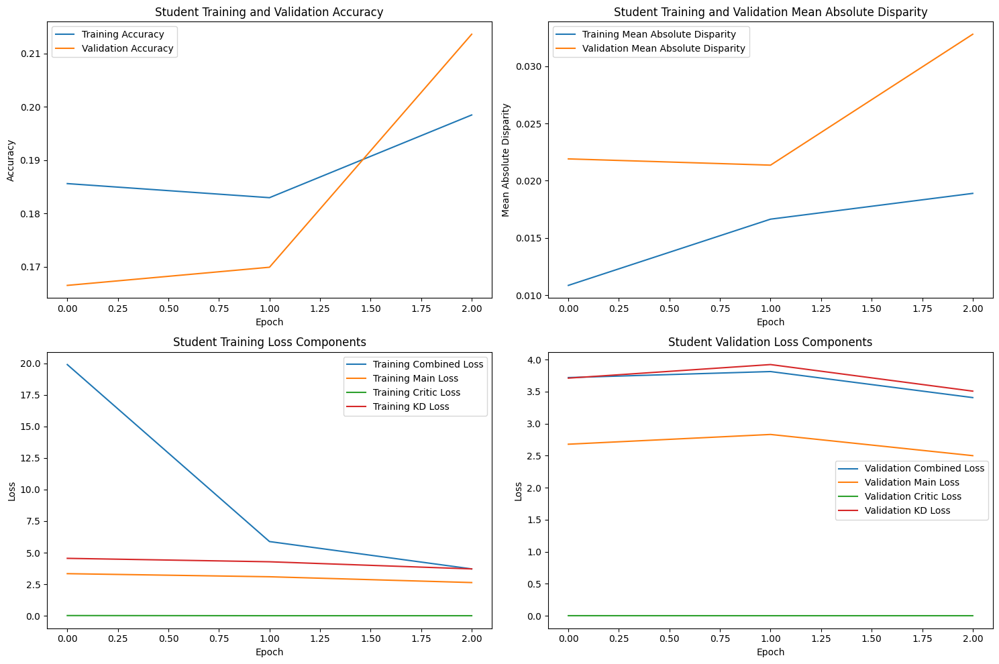

Epoch 4/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.75it/s]



STUDENT - Lambda 120 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.221624, VALIDATION Accuracy: 0.2358
TRAINING Disparity: 0.027427, VALIDATION Disparity: 0.0778
TRAINING Combined Loss: 3.488786, VALIDATION Combined Loss: 3.2624
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05455713201377943
Class Celebration: Val Disparity = -0.07209302325581393
Class Parade: Val Disparity = -0.05500821018062402
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.07920457108488083
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.1113505747126437
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: Val Disparity = 0.10108

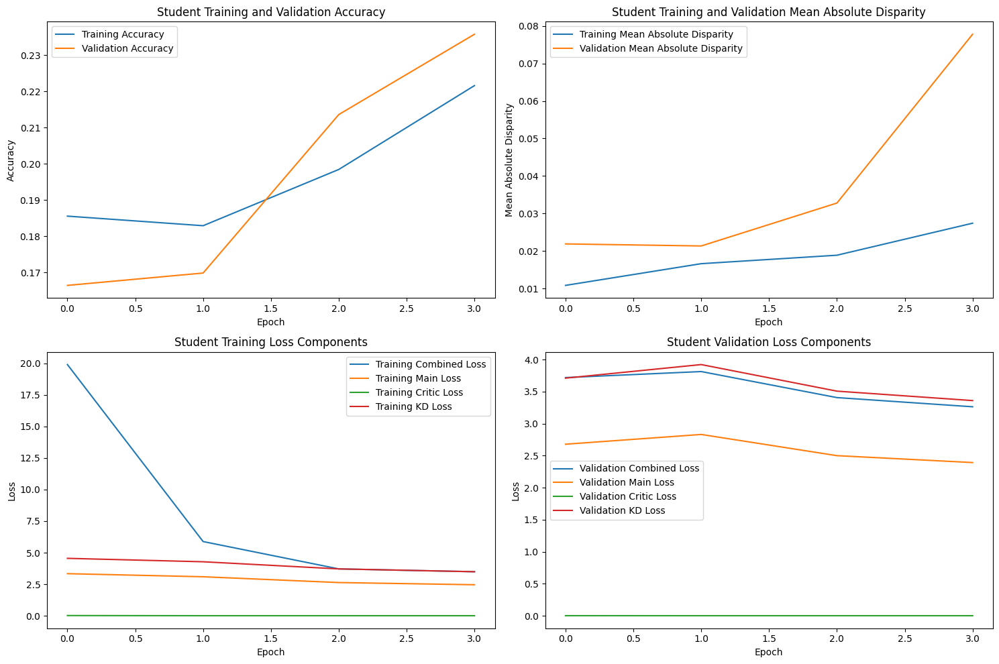

Epoch 5/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 120 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.253048, VALIDATION Accuracy: 0.2625
TRAINING Disparity: 0.042654, VALIDATION Disparity: 0.0722
TRAINING Combined Loss: 3.353178, VALIDATION Combined Loss: 3.1333
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.014713610089332585
Class Celebration: Val Disparity = -0.10000000000000002
Class Parade: Val Disparity = -0.09535538353272341
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.054168859484249265
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.19516283524904215
Class Business: Val Disparity = -0.03260869565217391
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = -0.012176560121765628
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_

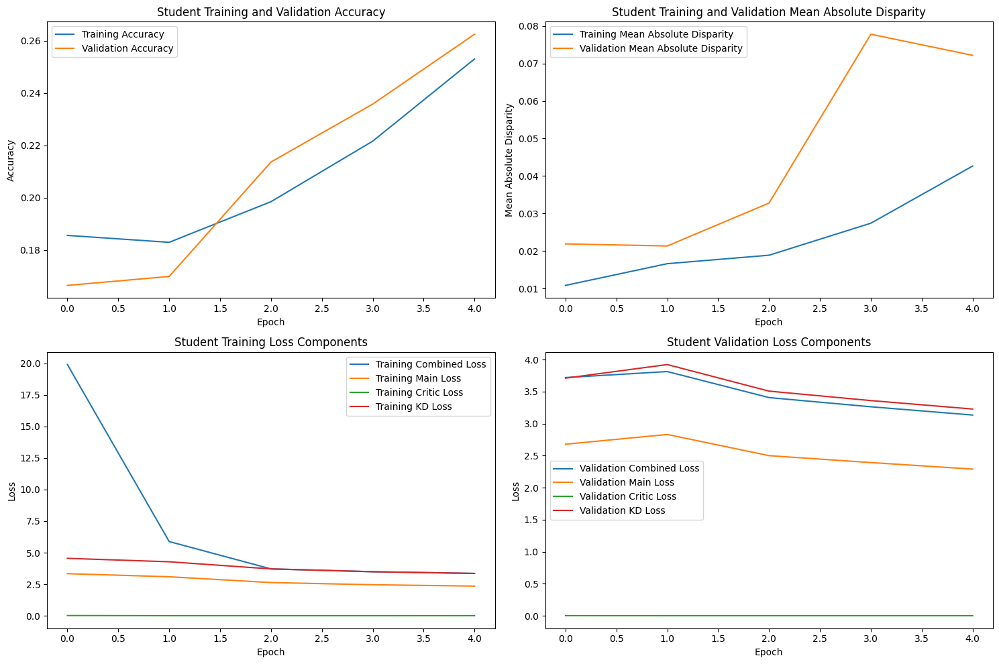

Epoch 6/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.73it/s]



STUDENT - Lambda 120 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.287924, VALIDATION Accuracy: 0.2977
TRAINING Disparity: 0.039342, VALIDATION Disparity: 0.0918
TRAINING Combined Loss: 3.222852, VALIDATION Combined Loss: 3.0138
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06595434109884979
Class Celebration: Val Disparity = -0.14418604651162792
Class Parade: Val Disparity = -0.09863945578231298
Class Waiter_Or_Waitress: Val Disparity = -0.018439716312056736
Class Individual_Sports: Val Disparity = 0.06867904668821895
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.21934865900383144
Class Business: Val Disparity = -0.05200341005967607
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = -0.004892367906066564
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class 

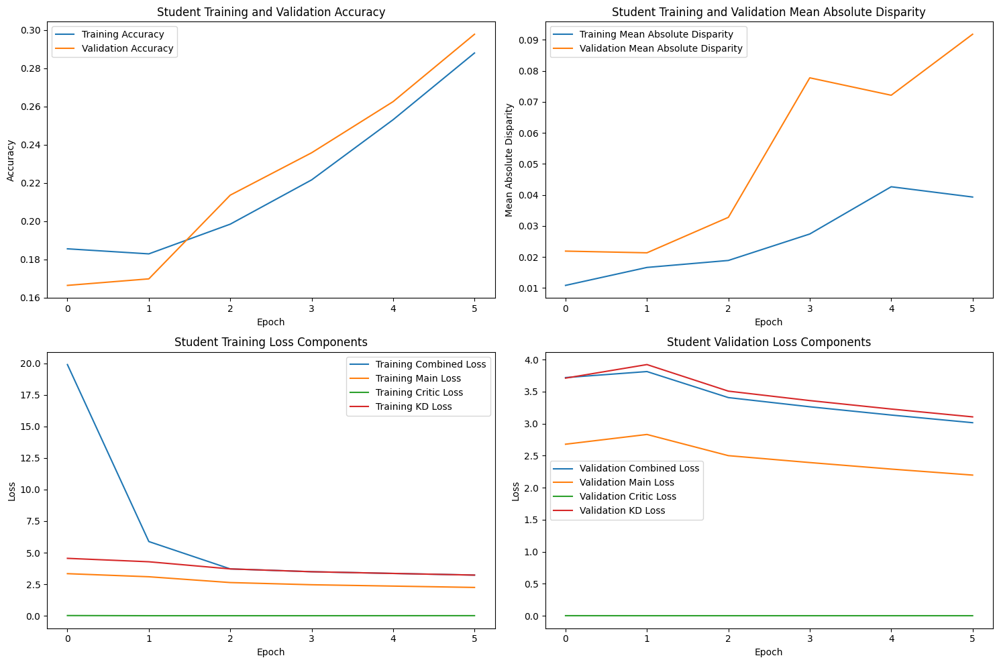

Epoch 7/200, Validation: 100%|██████████████████| 55/55 [00:19<00:00,  2.76it/s]



STUDENT - Lambda 120 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.268268, VALIDATION Accuracy: 0.2355
TRAINING Disparity: 0.031482, VALIDATION Disparity: 0.0468
TRAINING Combined Loss: 3.595183, VALIDATION Combined Loss: 3.4664
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06595434109884979
Class Celebration: Val Disparity = -0.14418604651162792
Class Parade: Val Disparity = -0.09863945578231298
Class Waiter_Or_Waitress: Val Disparity = -0.018439716312056736
Class Individual_Sports: Val Disparity = 0.06867904668821895
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.21934865900383144
Class Business: Val Disparity = -0.05200341005967607
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = -0.004892367906066564
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class 

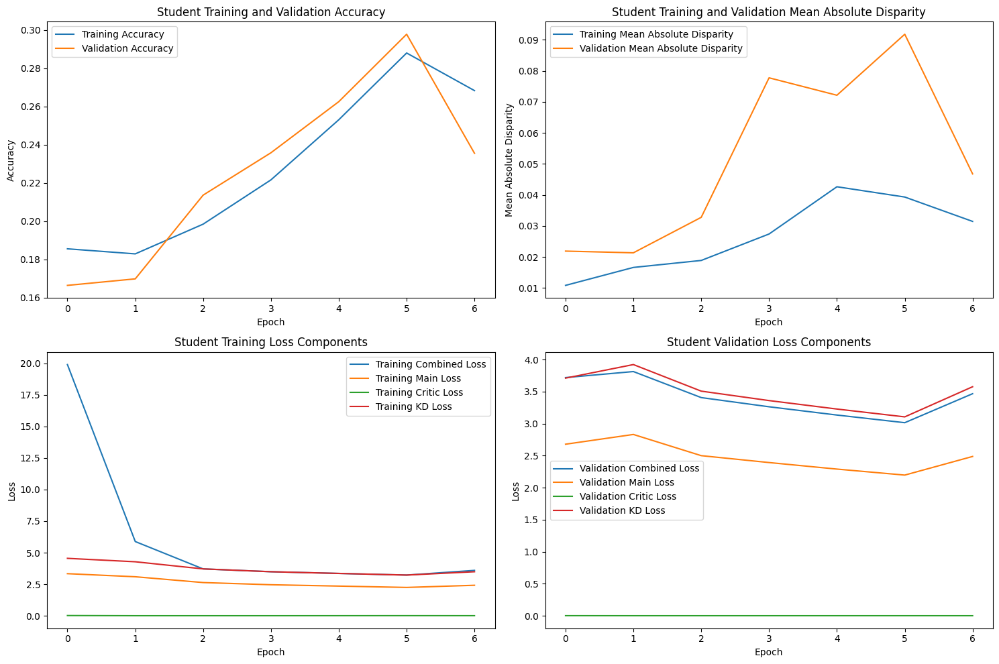

Epoch 8/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 120 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.259066, VALIDATION Accuracy: 0.2767
TRAINING Disparity: 0.035149, VALIDATION Disparity: 0.0634
TRAINING Combined Loss: 3.415419, VALIDATION Combined Loss: 3.1008
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06595434109884979
Class Celebration: Val Disparity = -0.14418604651162792
Class Parade: Val Disparity = -0.09863945578231298
Class Waiter_Or_Waitress: Val Disparity = -0.018439716312056736
Class Individual_Sports: Val Disparity = 0.06867904668821895
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.21934865900383144
Class Business: Val Disparity = -0.05200341005967607
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = -0.004892367906066564
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class 

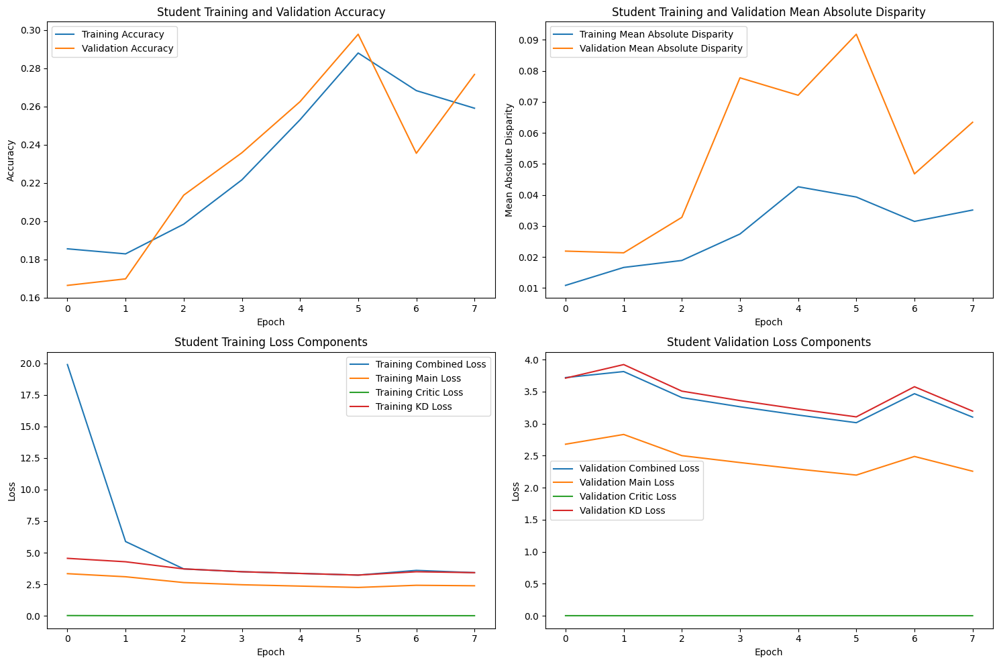

Epoch 9/200, Validation: 100%|██████████████████| 55/55 [00:20<00:00,  2.75it/s]



STUDENT - Lambda 120 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.296682, VALIDATION Accuracy: 0.3151
TRAINING Disparity: 0.050549, VALIDATION Disparity: 0.0771
TRAINING Combined Loss: 3.172897, VALIDATION Combined Loss: 2.9388
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.019431307292578914
Class Celebration: Val Disparity = 0.01627906976744181
Class Parade: Val Disparity = -0.014543748533896339
Class Waiter_Or_Waitress: Val Disparity = -0.02624113475177306
Class Individual_Sports: Val Disparity = 0.06871663784677845
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.21288314176245215
Class Business: Val Disparity = -0.1344842284739983
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = -0.021417699499891252
Class Picnic: Val Disparity = 0.1111111111111111
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparit

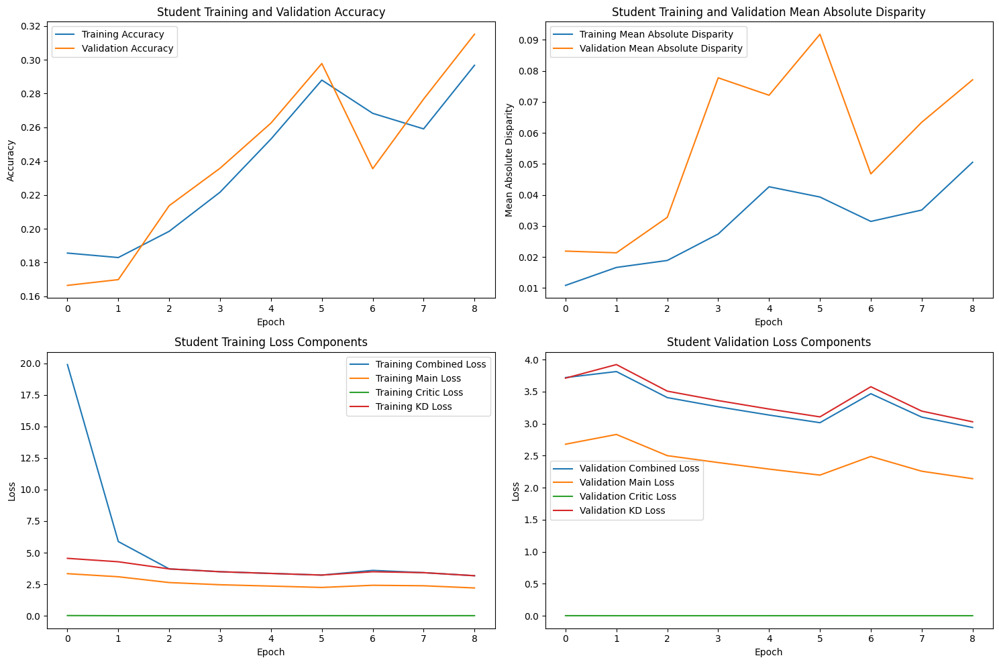

Epoch 10/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.80it/s]



STUDENT - Lambda 120 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.331443, VALIDATION Accuracy: 0.3366
TRAINING Disparity: 0.047967, VALIDATION Disparity: 0.0928
TRAINING Combined Loss: 3.027957, VALIDATION Combined Loss: 2.8314
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.08453319320371344
Class Celebration: Val Disparity = -0.0046511627906976605
Class Parade: Val Disparity = -0.006920009383063586
Class Waiter_Or_Waitress: Val Disparity = -0.012765957446808529
Class Individual_Sports: Val Disparity = -0.019584993609503
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.28280651340996177
Class Business: Val Disparity = -0.09974424552429668
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.06370950206566639
Class Picnic: Val Disparity = 0.18518518518518515
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Dispa

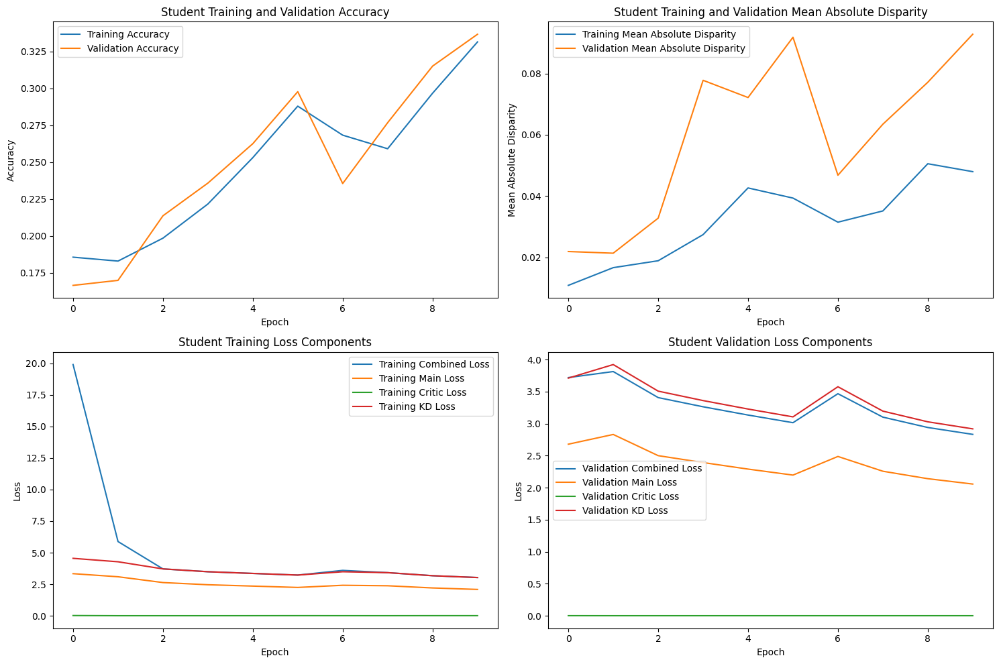

Epoch 11/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 120 - Epoch 11 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.358005, VALIDATION Accuracy: 0.3670
TRAINING Disparity: 0.054328, VALIDATION Disparity: 0.0996
TRAINING Combined Loss: 2.910207, VALIDATION Combined Loss: 2.7398
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.08425293396391653
Class Celebration: Val Disparity = -0.032558139534883734
Class Parade: Val Disparity = 0.040816326530612235
Class Waiter_Or_Waitress: Val Disparity = -0.0326241134751773
Class Individual_Sports: Val Disparity = 0.0015412375009398738
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.27610153256704983
Class Business: Val Disparity = -0.07885763000852511
Class Dresses: Val Disparity = -0.017857142857142856
Class Water_Activities: Val Disparity = 0.10056534029136771
Class Picnic: Val Disparity = 0.22222222222222227
Class Rescue: Val Disparity = 0.0
Class Ch

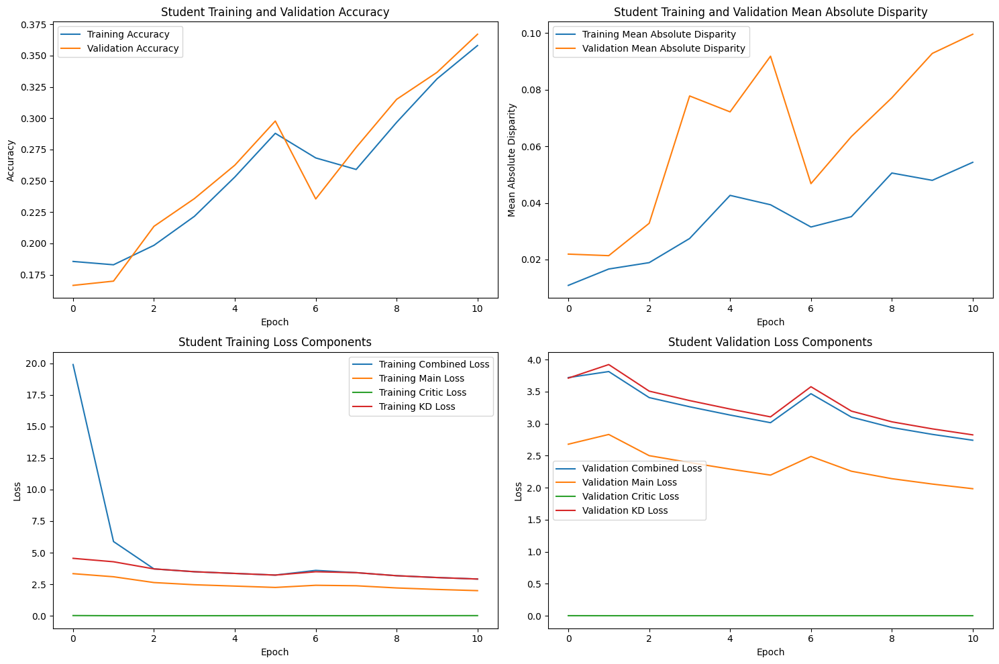

Epoch 12/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.82it/s]



STUDENT - Lambda 120 - Epoch 12 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.393962, VALIDATION Accuracy: 0.3932
TRAINING Disparity: 0.053312, VALIDATION Disparity: 0.1133
TRAINING Combined Loss: 2.798319, VALIDATION Combined Loss: 2.6512
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07409353652128214
Class Celebration: Val Disparity = -0.03255813953488368
Class Parade: Val Disparity = 0.03190241613886918
Class Waiter_Or_Waitress: Val Disparity = -0.019148936170212683
Class Individual_Sports: Val Disparity = -0.062100593940305204
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.29358237547892724
Class Business: Val Disparity = -0.038576300085251536
Class Dresses: Val Disparity = -0.125
Class Water_Activities: Val Disparity = 0.0681669928245271
Class Picnic: Val Disparity = 0.27777777777777773
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Dis

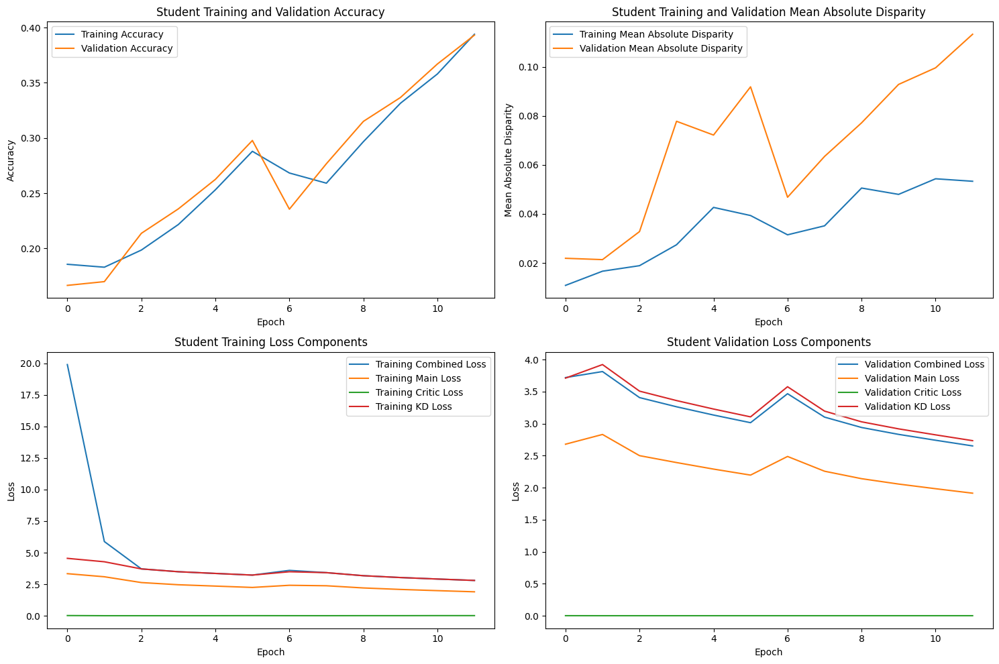

Epoch 13/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 120 - Epoch 13 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.422473, VALIDATION Accuracy: 0.4114
TRAINING Disparity: 0.057058, VALIDATION Disparity: 0.1055
TRAINING Combined Loss: 2.683243, VALIDATION Combined Loss: 2.5703
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.08043440182168504
Class Celebration: Val Disparity = -0.037209302325581395
Class Parade: Val Disparity = 0.059934318555008304
Class Waiter_Or_Waitress: Val Disparity = -0.040425531914893564
Class Individual_Sports: Val Disparity = -0.05507104728967749
Class Surgeons: Val Disparity = 0.07399267399267401
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.29358237547892724
Class Business: Val Disparity = -0.0002131287297527651
Class Dresses: Val Disparity = -0.26785714285714285
Class Water_Activities: Val Disparity = 0.08262665796912361
Class Picnic: Val Disparity = 0.18518518518518512
Class Rescue: Val Dispar

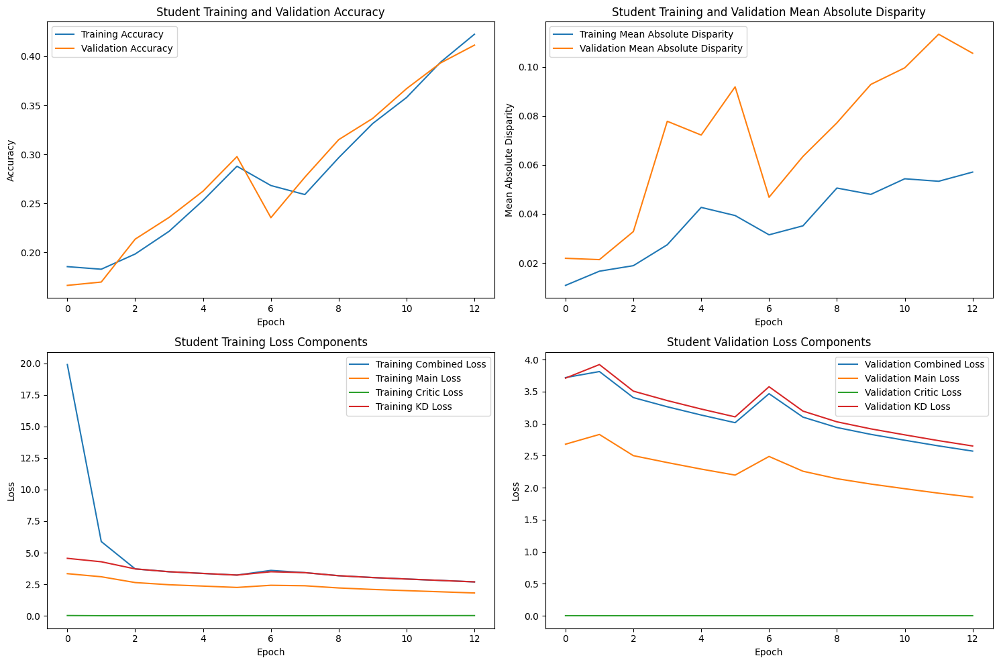

Epoch 14/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.71it/s]



STUDENT - Lambda 120 - Epoch 14 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.462056, VALIDATION Accuracy: 0.4406
TRAINING Disparity: 0.072477, VALIDATION Disparity: 0.1108
TRAINING Combined Loss: 2.555025, VALIDATION Combined Loss: 2.4759
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07611373854148418
Class Celebration: Val Disparity = -0.08372093023255806
Class Parade: Val Disparity = 0.10837438423645318
Class Waiter_Or_Waitress: Val Disparity = -0.1028368794326241
Class Individual_Sports: Val Disparity = -0.12901285617622738
Class Surgeons: Val Disparity = 0.12234432234432235
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.29046934865900387
Class Business: Val Disparity = -0.04177323103154307
Class Dresses: Val Disparity = -0.3333333333333333
Class Water_Activities: Val Disparity = 0.08621439443357254
Class Picnic: Val Disparity = 0.037037037037037035
Class Rescue: Val Disparity = 

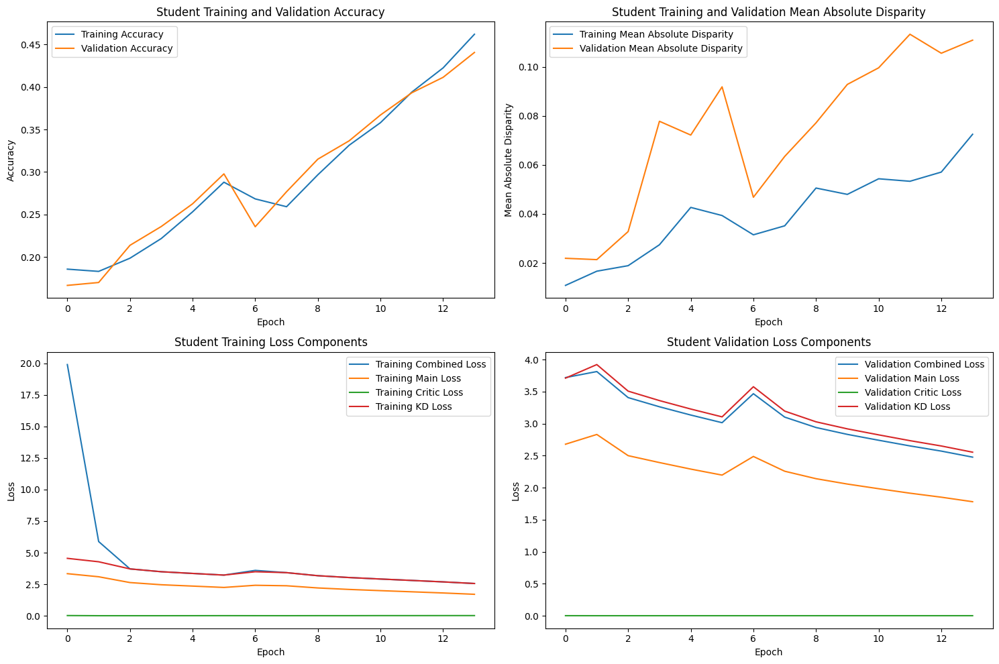

Epoch 15/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.75it/s]



STUDENT - Lambda 120 - Epoch 15 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.491107, VALIDATION Accuracy: 0.4676
TRAINING Disparity: 0.066531, VALIDATION Disparity: 0.0909
TRAINING Combined Loss: 2.438817, VALIDATION Combined Loss: 2.3651
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05467390669702821
Class Celebration: Val Disparity = -0.05813953488372092
Class Parade: Val Disparity = 0.047853624208304024
Class Waiter_Or_Waitress: Val Disparity = -0.09361702127659571
Class Individual_Sports: Val Disparity = -0.13972633636568682
Class Surgeons: Val Disparity = -0.0007326007326007855
Class Spa: Val Disparity = -0.02127659574468085
Class Law_Enforcement: Val Disparity = 0.2765804597701149
Class Business: Val Disparity = 0.0019181585677749413
Class Dresses: Val Disparity = -0.27023809523809517
Class Water_Activities: Val Disparity = 0.0833876929767341
Class Picnic: Val Disparity = 0.03703703703703698
Class Res

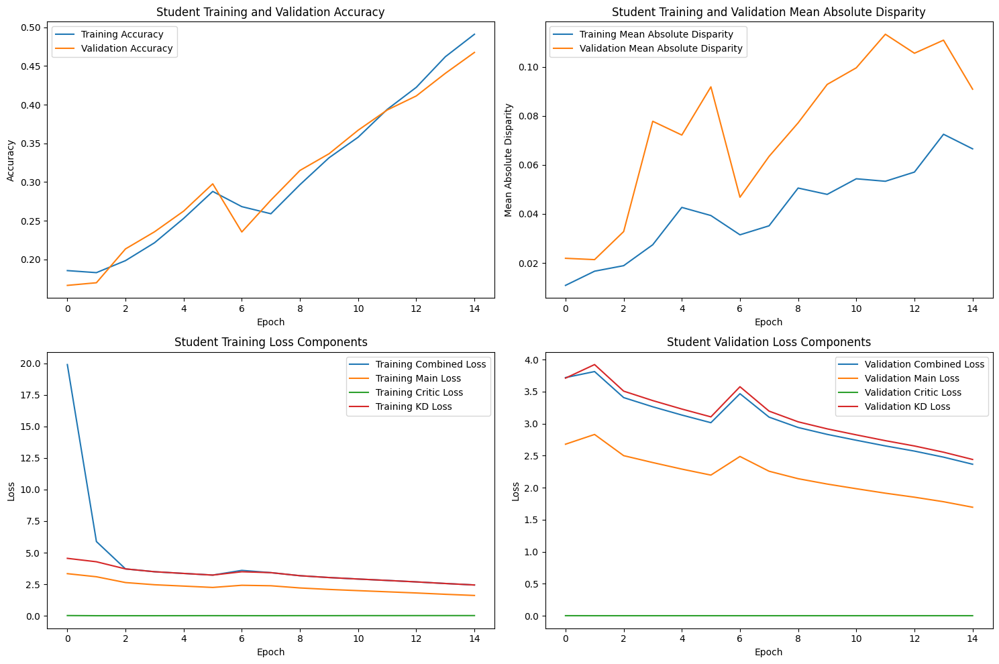

Epoch 16/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.75it/s]



STUDENT - Lambda 120 - Epoch 16 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.526080, VALIDATION Accuracy: 0.4909
TRAINING Disparity: 0.091095, VALIDATION Disparity: 0.1193
TRAINING Combined Loss: 2.317309, VALIDATION Combined Loss: 2.2819
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.058434051497635364
Class Celebration: Val Disparity = -0.04418604651162783
Class Parade: Val Disparity = 0.09125029322073663
Class Waiter_Or_Waitress: Val Disparity = -0.09999999999999998
Class Individual_Sports: Val Disparity = -0.17506202541162325
Class Surgeons: Val Disparity = 0.0761904761904762
Class Spa: Val Disparity = 0.2695035460992908
Class Law_Enforcement: Val Disparity = 0.2598180076628353
Class Business: Val Disparity = 0.04006820119352089
Class Dresses: Val Disparity = -0.3833333333333334
Class Water_Activities: Val Disparity = 0.027832137421178516
Class Picnic: Val Disparity = 0.12962962962962954
Class Rescue: Va

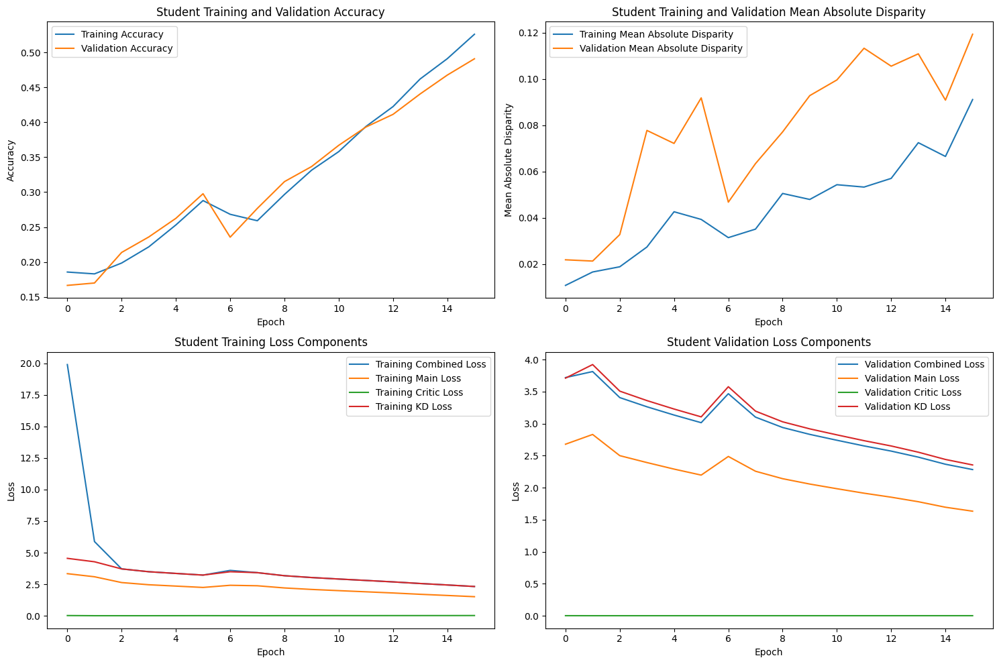

Epoch 17/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 120 - Epoch 17 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.557716, VALIDATION Accuracy: 0.5114
TRAINING Disparity: 0.111335, VALIDATION Disparity: 0.1454
TRAINING Combined Loss: 2.189959, VALIDATION Combined Loss: 2.1923
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04255269457581601
Class Celebration: Val Disparity = -0.006976744186046546
Class Parade: Val Disparity = 0.09688013136288998
Class Waiter_Or_Waitress: Val Disparity = -0.28510638297872337
Class Individual_Sports: Val Disparity = -0.21054807909179762
Class Surgeons: Val Disparity = -0.03223443223443223
Class Spa: Val Disparity = 0.12056737588652477
Class Law_Enforcement: Val Disparity = 0.2770593869731802
Class Business: Val Disparity = 0.037936913895993185
Class Dresses: Val Disparity = -0.619047619047619
Class Water_Activities: Val Disparity = 0.06968906283974785
Class Picnic: Val Disparity = -0.14814814814814808
Class Rescue:

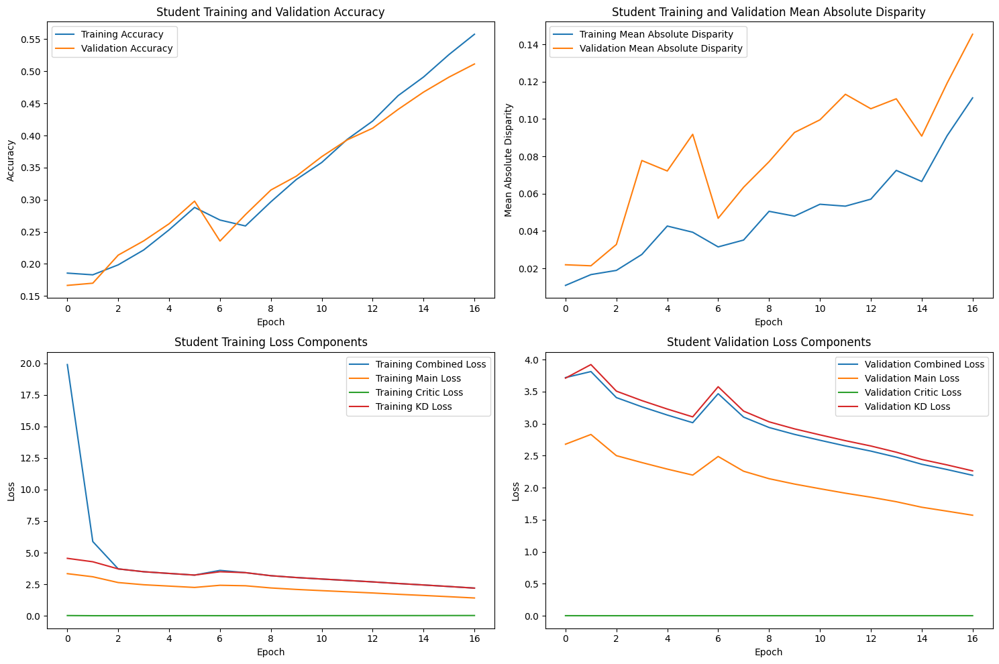

Epoch 18/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.76it/s]



STUDENT - Lambda 120 - Epoch 18 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.587037, VALIDATION Accuracy: 0.5230
TRAINING Disparity: 0.094692, VALIDATION Disparity: 0.1535
TRAINING Combined Loss: 2.074657, VALIDATION Combined Loss: 2.1342
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.016733812109534618
Class Celebration: Val Disparity = 0.0023255813953488857
Class Parade: Val Disparity = 0.08292282430213466
Class Waiter_Or_Waitress: Val Disparity = -0.20780141843971622
Class Individual_Sports: Val Disparity = -0.24599654161341256
Class Surgeons: Val Disparity = -0.03809523809523807
Class Spa: Val Disparity = 0.28368794326241137
Class Law_Enforcement: Val Disparity = 0.29070881226053646
Class Business: Val Disparity = 0.0019181585677749413
Class Dresses: Val Disparity = -0.5952380952380952
Class Water_Activities: Val Disparity = 0.0625135899108501
Class Picnic: Val Disparity = -0.3148148148148149
Class Rescu

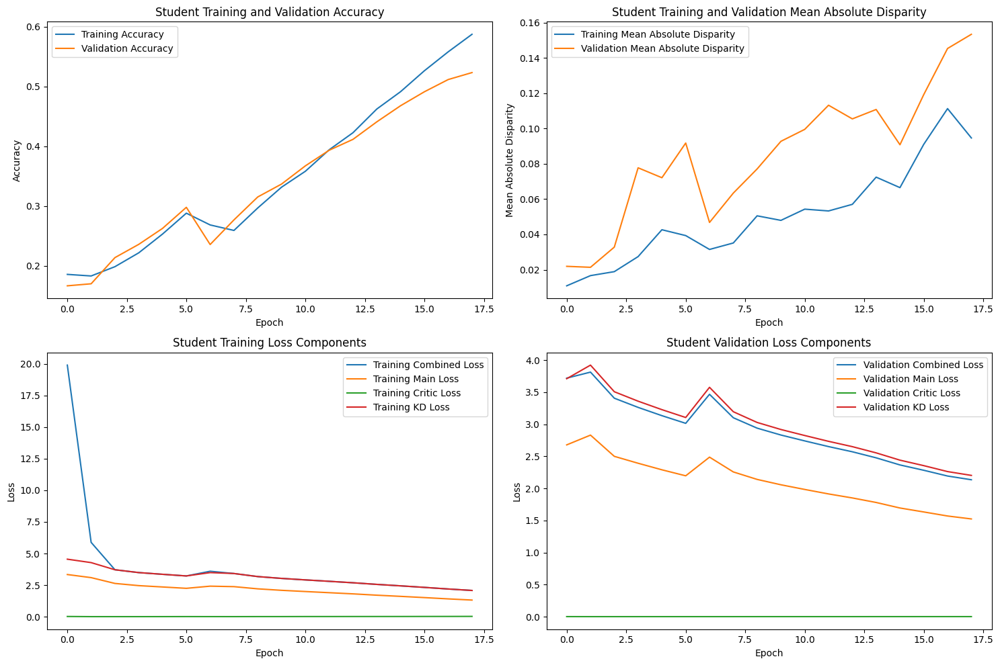

Epoch 19/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.75it/s]



STUDENT - Lambda 120 - Epoch 19 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.616628, VALIDATION Accuracy: 0.5443
TRAINING Disparity: 0.104502, VALIDATION Disparity: 0.1161
TRAINING Combined Loss: 1.963968, VALIDATION Combined Loss: 2.0835
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.048554913294797664
Class Celebration: Val Disparity = -0.011627906976744207
Class Parade: Val Disparity = 0.09887403237156939
Class Waiter_Or_Waitress: Val Disparity = -0.23404255319148948
Class Individual_Sports: Val Disparity = -0.1962634388391849
Class Surgeons: Val Disparity = 0.013186813186813084
Class Spa: Val Disparity = -0.02836879432624112
Class Law_Enforcement: Val Disparity = 0.28424329501915707
Class Business: Val Disparity = -0.02962489343563507
Class Dresses: Val Disparity = -0.31428571428571433
Class Water_Activities: Val Disparity = 0.074037834311807
Class Picnic: Val Disparity = -0.16666666666666663
Class Rescu

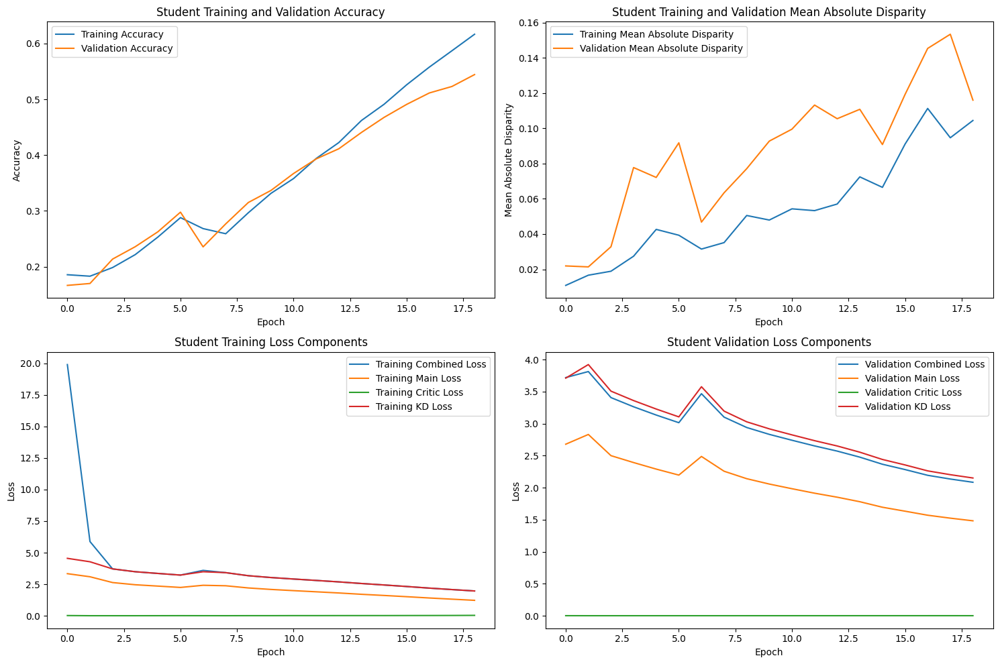

Epoch 20/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 120 - Epoch 20 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.645833, VALIDATION Accuracy: 0.5486
TRAINING Disparity: 0.104627, VALIDATION Disparity: 0.1525
TRAINING Combined Loss: 1.851064, VALIDATION Combined Loss: 2.0425
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05989373503824369
Class Celebration: Val Disparity = 0.030232558139534904
Class Parade: Val Disparity = 0.10450387051372267
Class Waiter_Or_Waitress: Val Disparity = -0.226241134751773
Class Individual_Sports: Val Disparity = -0.17852041199909774
Class Surgeons: Val Disparity = 0.09010989010989018
Class Spa: Val Disparity = 0.15602836879432624
Class Law_Enforcement: Val Disparity = 0.2775383141762453
Class Business: Val Disparity = 0.020460358056266004
Class Dresses: Val Disparity = -0.6666666666666667
Class Water_Activities: Val Disparity = 0.048053924766253586
Class Picnic: Val Disparity = -0.09259259259259262
Class Rescue: V

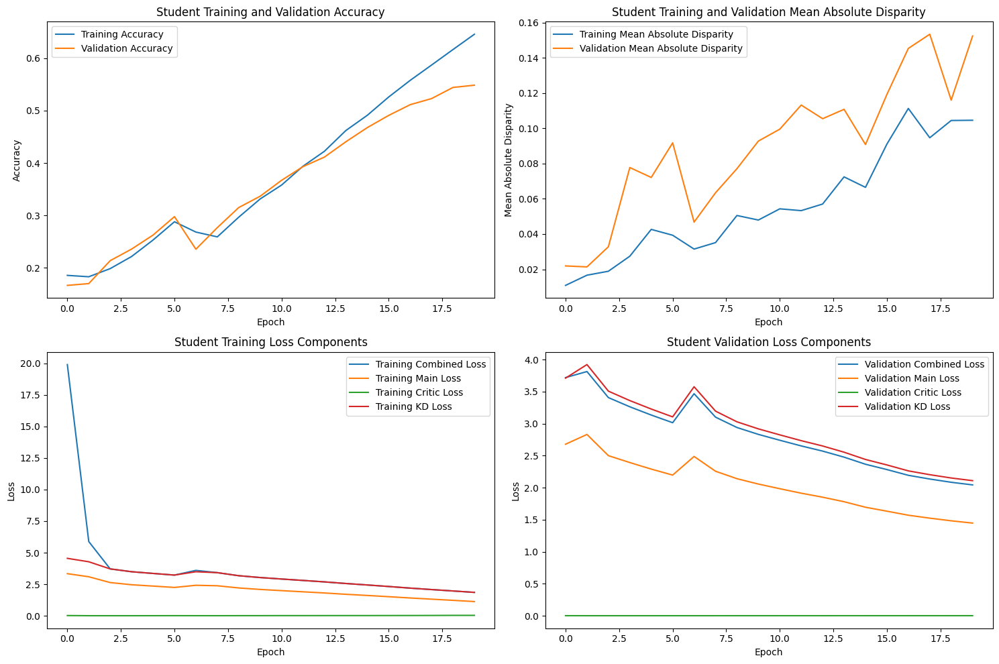

Epoch 21/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.75it/s]



STUDENT - Lambda 120 - Epoch 21 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.679147, VALIDATION Accuracy: 0.5599
TRAINING Disparity: 0.098657, VALIDATION Disparity: 0.1418
TRAINING Combined Loss: 1.742909, VALIDATION Combined Loss: 2.0321
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05293396391662297
Class Celebration: Val Disparity = -0.044186046511627886
Class Parade: Val Disparity = 0.04761904761904767
Class Waiter_Or_Waitress: Val Disparity = -0.21418439716312054
Class Individual_Sports: Val Disparity = -0.2246071723930531
Class Surgeons: Val Disparity = 0.035897435897435936
Class Spa: Val Disparity = 0.049645390070921946
Class Law_Enforcement: Val Disparity = 0.24952107279693508
Class Business: Val Disparity = -0.021739130434782594
Class Dresses: Val Disparity = -0.6428571428571428
Class Water_Activities: Val Disparity = 0.07979995651228522
Class Picnic: Val Disparity = -0.22222222222222215
Class Resc

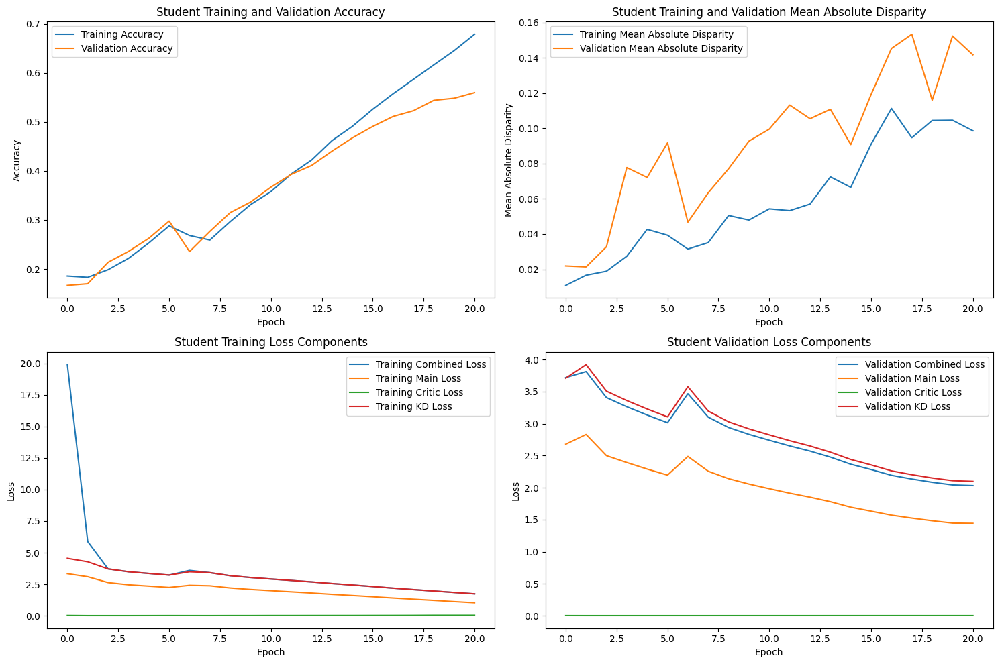

Epoch 22/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.78it/s]



STUDENT - Lambda 120 - Epoch 22 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.705883, VALIDATION Accuracy: 0.5608
TRAINING Disparity: 0.108198, VALIDATION Disparity: 0.1333
TRAINING Combined Loss: 1.629671, VALIDATION Combined Loss: 2.0383
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05293396391662297
Class Celebration: Val Disparity = -0.044186046511627886
Class Parade: Val Disparity = 0.04761904761904767
Class Waiter_Or_Waitress: Val Disparity = -0.21418439716312054
Class Individual_Sports: Val Disparity = -0.2246071723930531
Class Surgeons: Val Disparity = 0.035897435897435936
Class Spa: Val Disparity = 0.049645390070921946
Class Law_Enforcement: Val Disparity = 0.24952107279693508
Class Business: Val Disparity = -0.021739130434782594
Class Dresses: Val Disparity = -0.6428571428571428
Class Water_Activities: Val Disparity = 0.07979995651228522
Class Picnic: Val Disparity = -0.22222222222222215
Class Resc

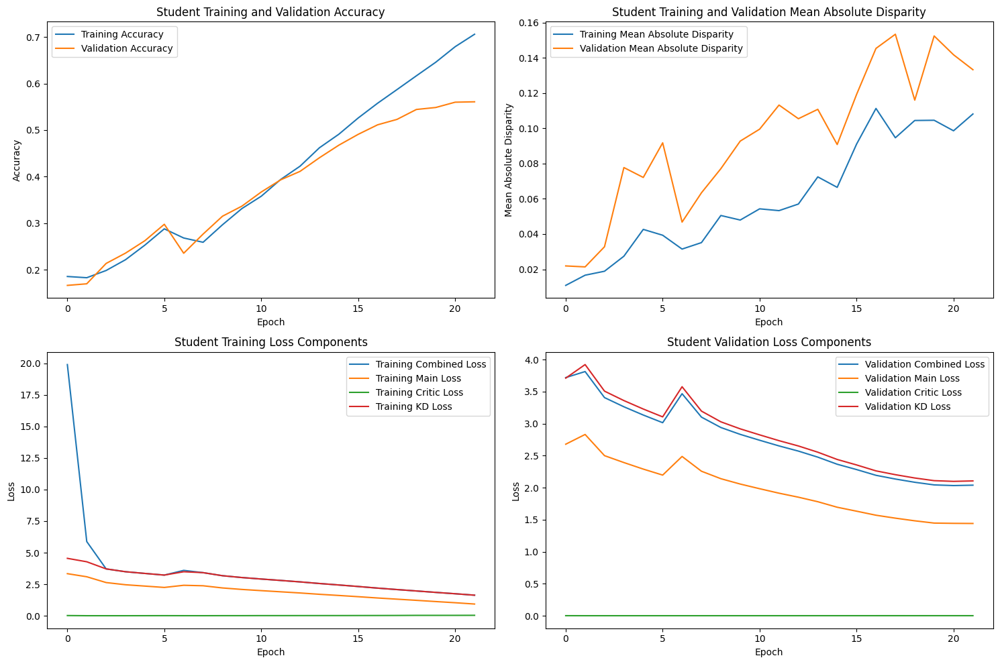

Epoch 23/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 120 - Epoch 23 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.741995, VALIDATION Accuracy: 0.5676
TRAINING Disparity: 0.097172, VALIDATION Disparity: 0.1429
TRAINING Combined Loss: 1.523865, VALIDATION Combined Loss: 2.0104
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07325275880189164
Class Celebration: Val Disparity = -0.05581395348837209
Class Parade: Val Disparity = 0.12749237626084908
Class Waiter_Or_Waitress: Val Disparity = -0.1716312056737589
Class Individual_Sports: Val Disparity = -0.16416058942936607
Class Surgeons: Val Disparity = -0.015384615384615441
Class Spa: Val Disparity = -0.21985815602836883
Class Law_Enforcement: Val Disparity = 0.19779693486590044
Class Business: Val Disparity = 0.01726342710997436
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.08632311372037405
Class Picnic: Val Disparity = -0.0925925925925925
Class Rescue:

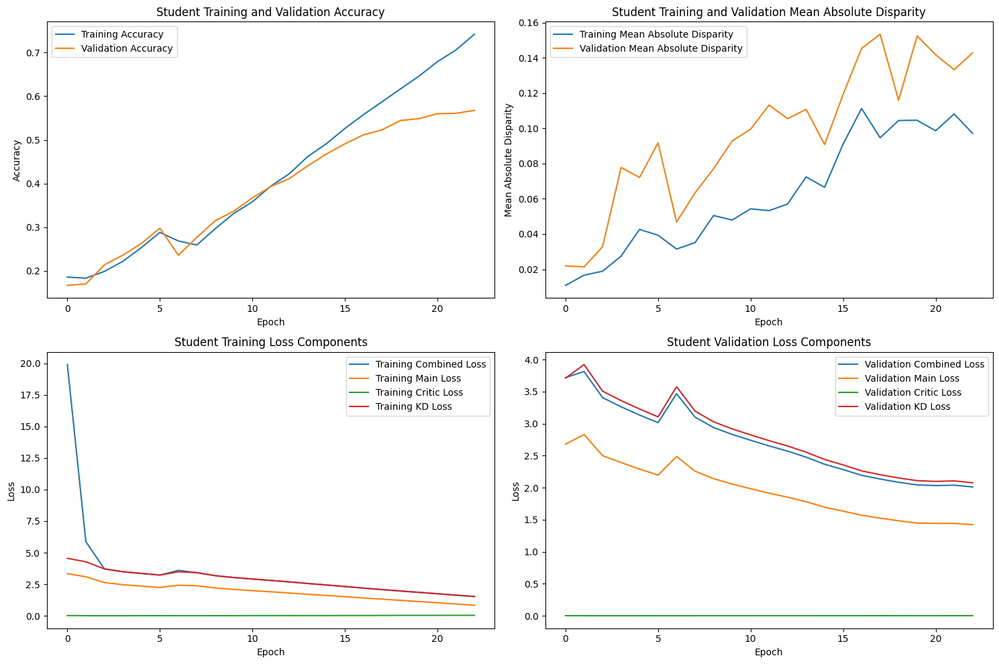

Epoch 24/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.75it/s]



STUDENT - Lambda 120 - Epoch 24 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.777758, VALIDATION Accuracy: 0.5696
TRAINING Disparity: 0.088171, VALIDATION Disparity: 0.1501
TRAINING Combined Loss: 1.414325, VALIDATION Combined Loss: 2.0370
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07325275880189164
Class Celebration: Val Disparity = -0.05581395348837209
Class Parade: Val Disparity = 0.12749237626084908
Class Waiter_Or_Waitress: Val Disparity = -0.1716312056737589
Class Individual_Sports: Val Disparity = -0.16416058942936607
Class Surgeons: Val Disparity = -0.015384615384615441
Class Spa: Val Disparity = -0.21985815602836883
Class Law_Enforcement: Val Disparity = 0.19779693486590044
Class Business: Val Disparity = 0.01726342710997436
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.08632311372037405
Class Picnic: Val Disparity = -0.0925925925925925
Class Rescue:

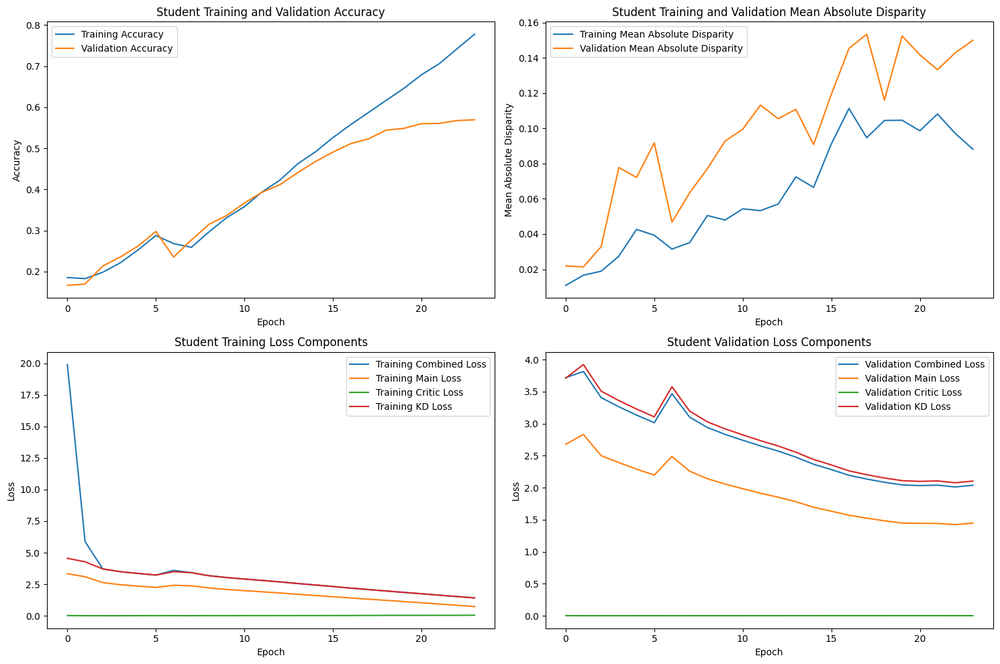

Epoch 25/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 120 - Epoch 25 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.810455, VALIDATION Accuracy: 0.5679
TRAINING Disparity: 0.079621, VALIDATION Disparity: 0.1330
TRAINING Combined Loss: 1.315207, VALIDATION Combined Loss: 2.0570
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07325275880189164
Class Celebration: Val Disparity = -0.05581395348837209
Class Parade: Val Disparity = 0.12749237626084908
Class Waiter_Or_Waitress: Val Disparity = -0.1716312056737589
Class Individual_Sports: Val Disparity = -0.16416058942936607
Class Surgeons: Val Disparity = -0.015384615384615441
Class Spa: Val Disparity = -0.21985815602836883
Class Law_Enforcement: Val Disparity = 0.19779693486590044
Class Business: Val Disparity = 0.01726342710997436
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.08632311372037405
Class Picnic: Val Disparity = -0.0925925925925925
Class Rescue:

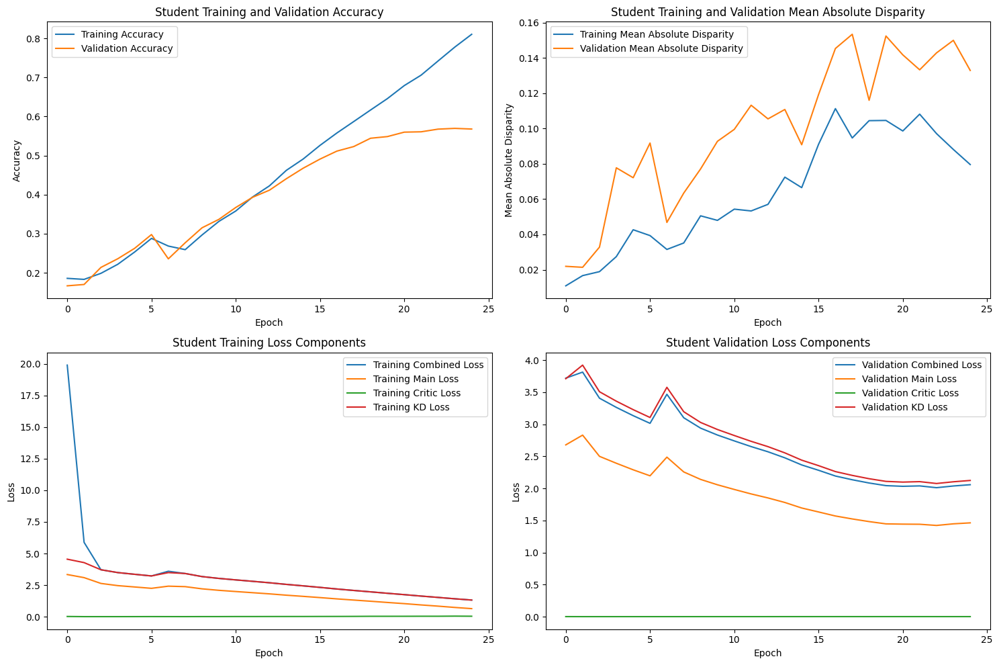

Epoch 26/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 120 - Epoch 26 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.837249, VALIDATION Accuracy: 0.5753
TRAINING Disparity: 0.079700, VALIDATION Disparity: 0.1415
TRAINING Combined Loss: 1.227143, VALIDATION Combined Loss: 2.0916
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07325275880189164
Class Celebration: Val Disparity = -0.05581395348837209
Class Parade: Val Disparity = 0.12749237626084908
Class Waiter_Or_Waitress: Val Disparity = -0.1716312056737589
Class Individual_Sports: Val Disparity = -0.16416058942936607
Class Surgeons: Val Disparity = -0.015384615384615441
Class Spa: Val Disparity = -0.21985815602836883
Class Law_Enforcement: Val Disparity = 0.19779693486590044
Class Business: Val Disparity = 0.01726342710997436
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.08632311372037405
Class Picnic: Val Disparity = -0.0925925925925925
Class Rescue:

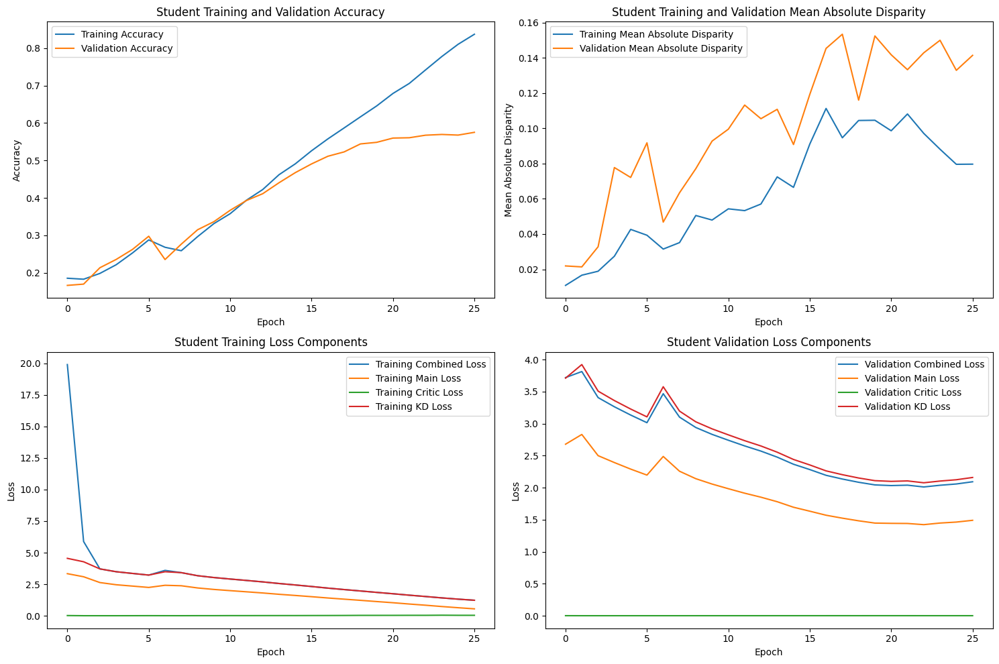

Epoch 27/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.78it/s]



STUDENT - Lambda 120 - Epoch 27 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.857330, VALIDATION Accuracy: 0.5778
TRAINING Disparity: 0.066533, VALIDATION Disparity: 0.1130
TRAINING Combined Loss: 1.159281, VALIDATION Combined Loss: 2.0717
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07325275880189164
Class Celebration: Val Disparity = -0.05581395348837209
Class Parade: Val Disparity = 0.12749237626084908
Class Waiter_Or_Waitress: Val Disparity = -0.1716312056737589
Class Individual_Sports: Val Disparity = -0.16416058942936607
Class Surgeons: Val Disparity = -0.015384615384615441
Class Spa: Val Disparity = -0.21985815602836883
Class Law_Enforcement: Val Disparity = 0.19779693486590044
Class Business: Val Disparity = 0.01726342710997436
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.08632311372037405
Class Picnic: Val Disparity = -0.0925925925925925
Class Rescue:

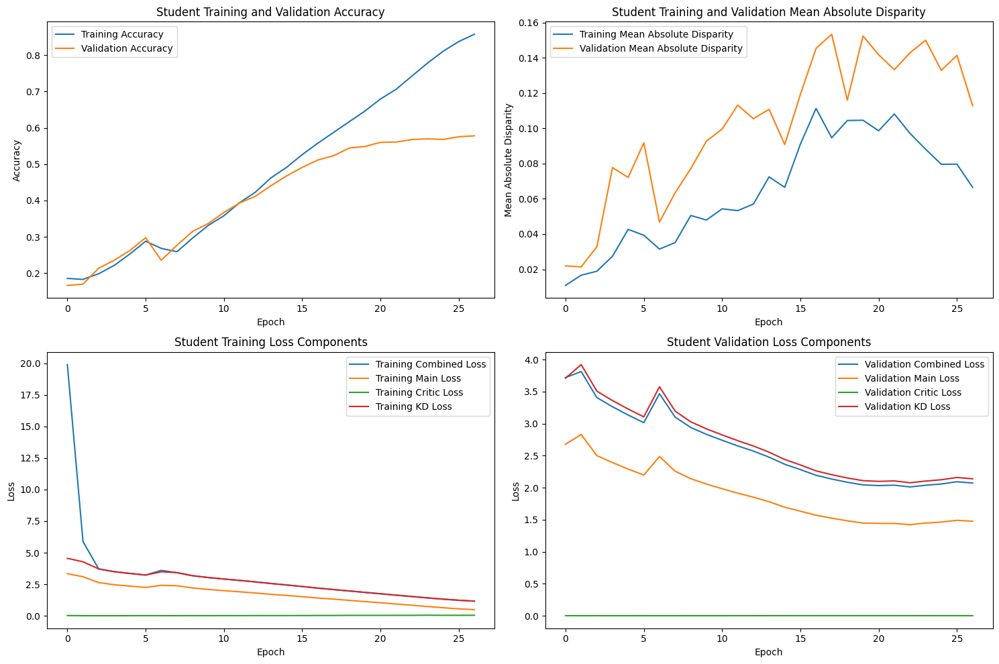

Epoch 28/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 120 - Epoch 28 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.890181, VALIDATION Accuracy: 0.5730
TRAINING Disparity: 0.052190, VALIDATION Disparity: 0.1431
TRAINING Combined Loss: 1.078003, VALIDATION Combined Loss: 2.1269
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07325275880189164
Class Celebration: Val Disparity = -0.05581395348837209
Class Parade: Val Disparity = 0.12749237626084908
Class Waiter_Or_Waitress: Val Disparity = -0.1716312056737589
Class Individual_Sports: Val Disparity = -0.16416058942936607
Class Surgeons: Val Disparity = -0.015384615384615441
Class Spa: Val Disparity = -0.21985815602836883
Class Law_Enforcement: Val Disparity = 0.19779693486590044
Class Business: Val Disparity = 0.01726342710997436
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.08632311372037405
Class Picnic: Val Disparity = -0.0925925925925925
Class Rescue:

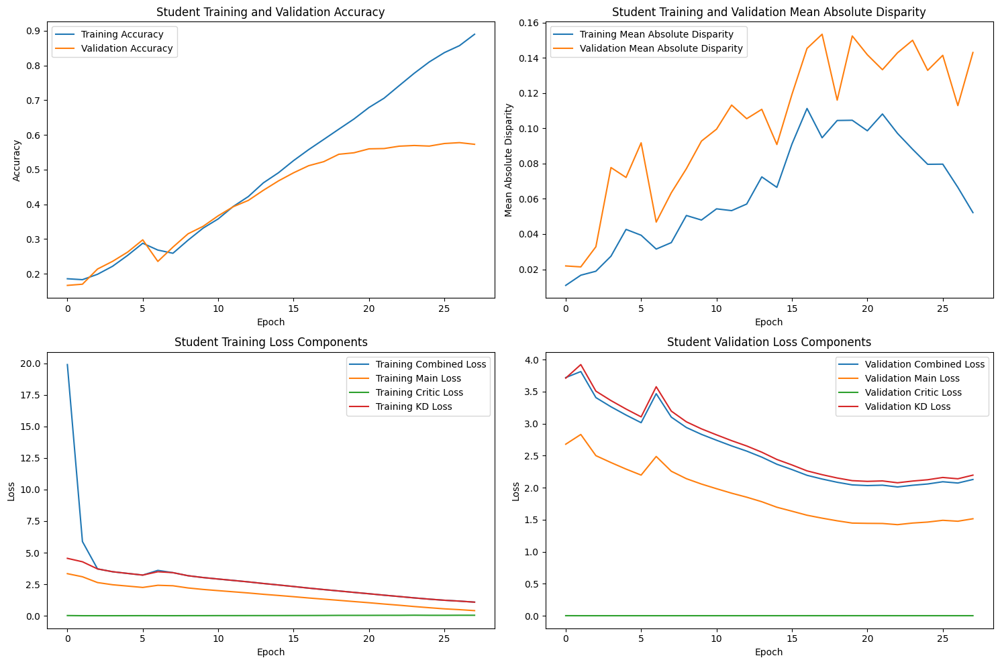

Epoch 29/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.79it/s]



STUDENT - Lambda 120 - Epoch 29 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.906848, VALIDATION Accuracy: 0.5761
TRAINING Disparity: 0.039991, VALIDATION Disparity: 0.1383
TRAINING Combined Loss: 1.022574, VALIDATION Combined Loss: 2.1087
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07325275880189164
Class Celebration: Val Disparity = -0.05581395348837209
Class Parade: Val Disparity = 0.12749237626084908
Class Waiter_Or_Waitress: Val Disparity = -0.1716312056737589
Class Individual_Sports: Val Disparity = -0.16416058942936607
Class Surgeons: Val Disparity = -0.015384615384615441
Class Spa: Val Disparity = -0.21985815602836883
Class Law_Enforcement: Val Disparity = 0.19779693486590044
Class Business: Val Disparity = 0.01726342710997436
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.08632311372037405
Class Picnic: Val Disparity = -0.0925925925925925
Class Rescue:

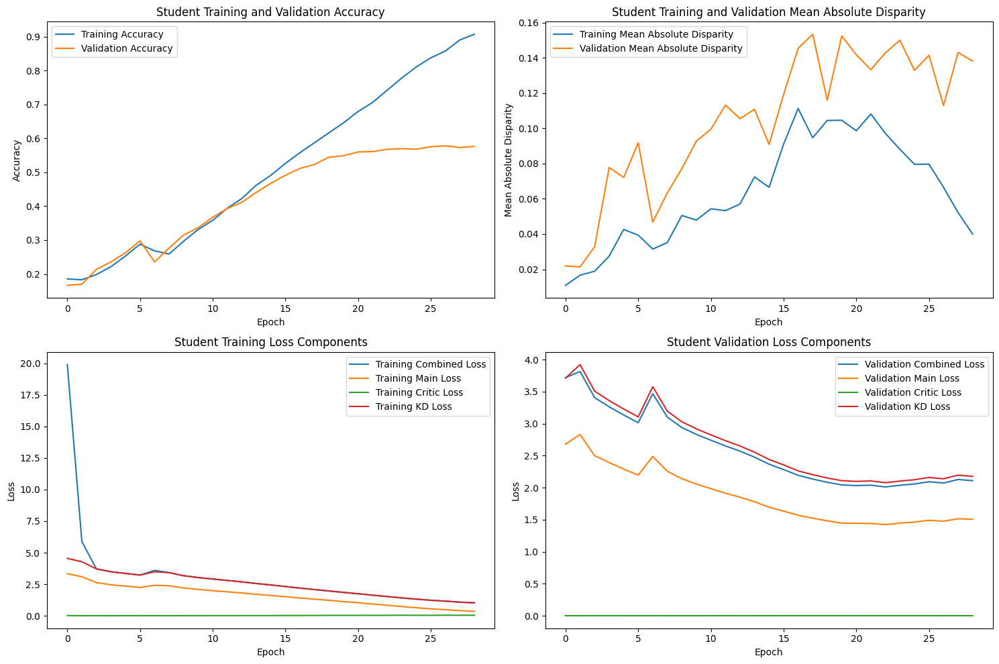

Epoch 30/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.80it/s]



STUDENT - Lambda 120 - Epoch 30 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.939352, VALIDATION Accuracy: 0.5872
TRAINING Disparity: 0.036743, VALIDATION Disparity: 0.1473
TRAINING Combined Loss: 0.922729, VALIDATION Combined Loss: 2.0232
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07325275880189164
Class Celebration: Val Disparity = -0.05581395348837209
Class Parade: Val Disparity = 0.12749237626084908
Class Waiter_Or_Waitress: Val Disparity = -0.1716312056737589
Class Individual_Sports: Val Disparity = -0.16416058942936607
Class Surgeons: Val Disparity = -0.015384615384615441
Class Spa: Val Disparity = -0.21985815602836883
Class Law_Enforcement: Val Disparity = 0.19779693486590044
Class Business: Val Disparity = 0.01726342710997436
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.08632311372037405
Class Picnic: Val Disparity = -0.0925925925925925
Class Rescue:

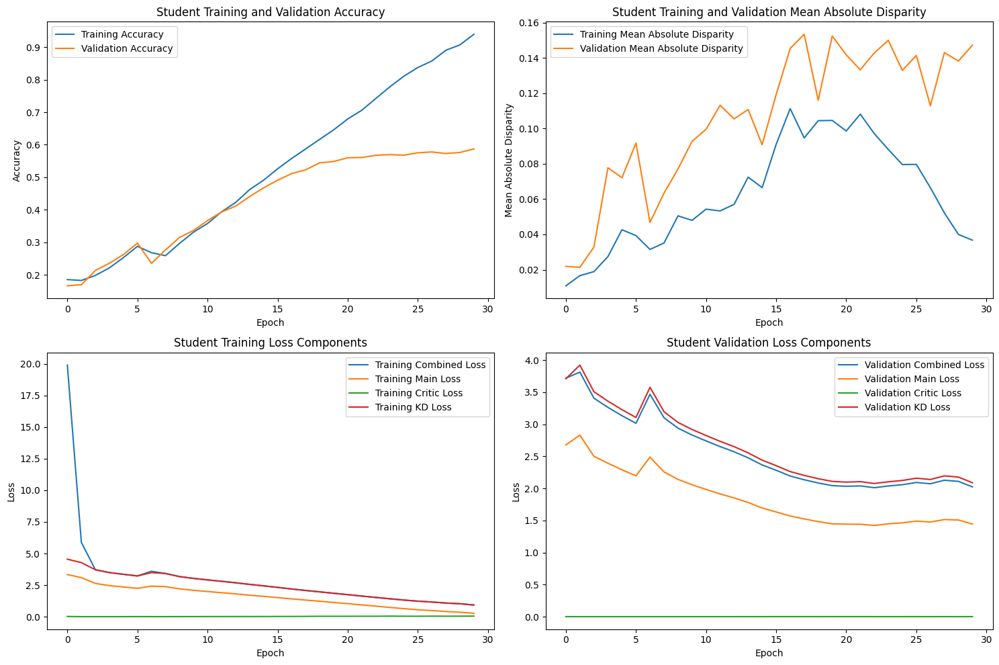

Epoch 31/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 120 - Epoch 31 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.951755, VALIDATION Accuracy: 0.5895
TRAINING Disparity: 0.040357, VALIDATION Disparity: 0.1414
TRAINING Combined Loss: 0.888924, VALIDATION Combined Loss: 2.0136
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07325275880189164
Class Celebration: Val Disparity = -0.05581395348837209
Class Parade: Val Disparity = 0.12749237626084908
Class Waiter_Or_Waitress: Val Disparity = -0.1716312056737589
Class Individual_Sports: Val Disparity = -0.16416058942936607
Class Surgeons: Val Disparity = -0.015384615384615441
Class Spa: Val Disparity = -0.21985815602836883
Class Law_Enforcement: Val Disparity = 0.19779693486590044
Class Business: Val Disparity = 0.01726342710997436
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.08632311372037405
Class Picnic: Val Disparity = -0.0925925925925925
Class Rescue:

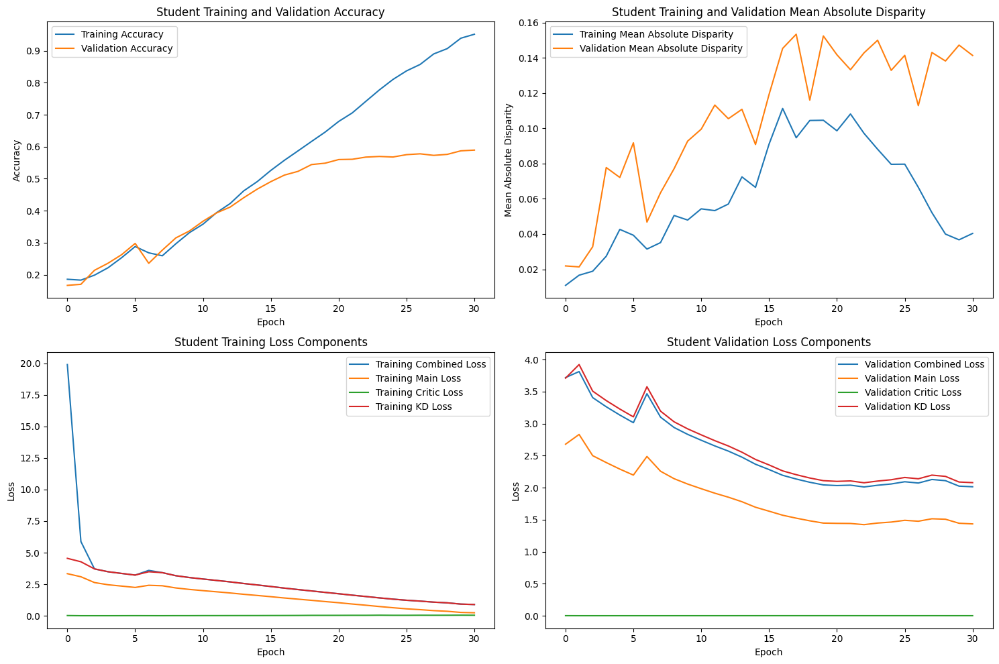

Epoch 32/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.76it/s]



STUDENT - Lambda 120 - Epoch 32 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.954205, VALIDATION Accuracy: 0.5892
TRAINING Disparity: 0.037664, VALIDATION Disparity: 0.1373
TRAINING Combined Loss: 0.870733, VALIDATION Combined Loss: 2.0098
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.0601739942780406
Class Celebration: Val Disparity = -0.10697674418604652
Class Parade: Val Disparity = 0.05148956134177829
Class Waiter_Or_Waitress: Val Disparity = -0.05531914893617018
Class Individual_Sports: Val Disparity = -0.15013908728667014
Class Surgeons: Val Disparity = -0.015384615384615385
Class Spa: Val Disparity = 0.11347517730496448
Class Law_Enforcement: Val Disparity = 0.2528735632183908
Class Business: Val Disparity = 0.013000852514919059
Class Dresses: Val Disparity = -0.6726190476190477
Class Water_Activities: Val Disparity = 0.06686236138290924
Class Picnic: Val Disparity = -0.22222222222222227
Class Rescue:

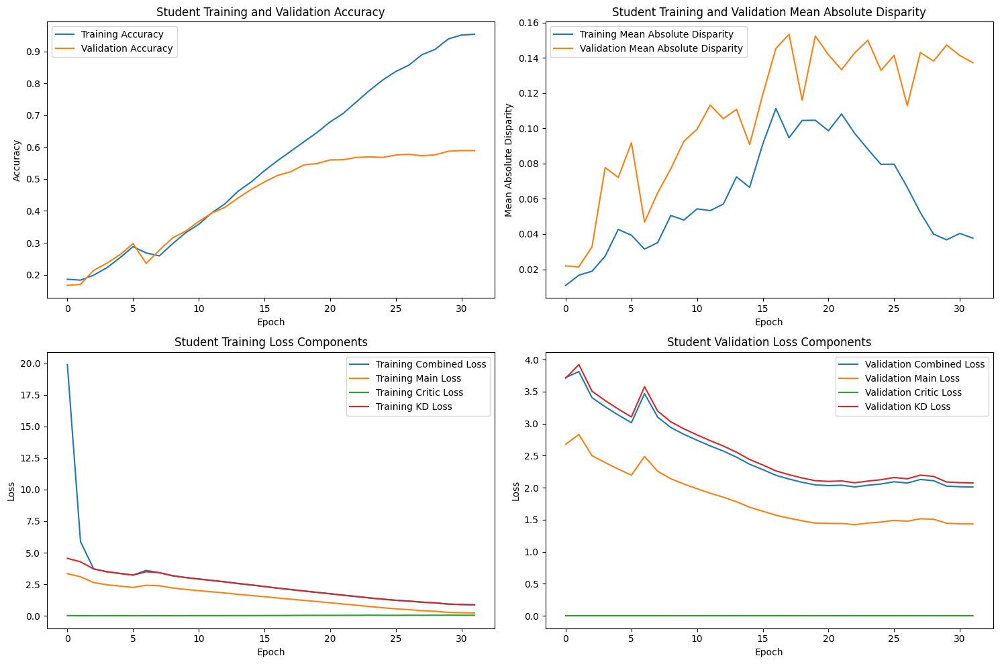

Epoch 33/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.75it/s]



STUDENT - Lambda 120 - Epoch 33 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.957909, VALIDATION Accuracy: 0.5870
TRAINING Disparity: 0.034375, VALIDATION Disparity: 0.1403
TRAINING Combined Loss: 0.860582, VALIDATION Combined Loss: 2.0183
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.0601739942780406
Class Celebration: Val Disparity = -0.10697674418604652
Class Parade: Val Disparity = 0.05148956134177829
Class Waiter_Or_Waitress: Val Disparity = -0.05531914893617018
Class Individual_Sports: Val Disparity = -0.15013908728667014
Class Surgeons: Val Disparity = -0.015384615384615385
Class Spa: Val Disparity = 0.11347517730496448
Class Law_Enforcement: Val Disparity = 0.2528735632183908
Class Business: Val Disparity = 0.013000852514919059
Class Dresses: Val Disparity = -0.6726190476190477
Class Water_Activities: Val Disparity = 0.06686236138290924
Class Picnic: Val Disparity = -0.22222222222222227
Class Rescue:

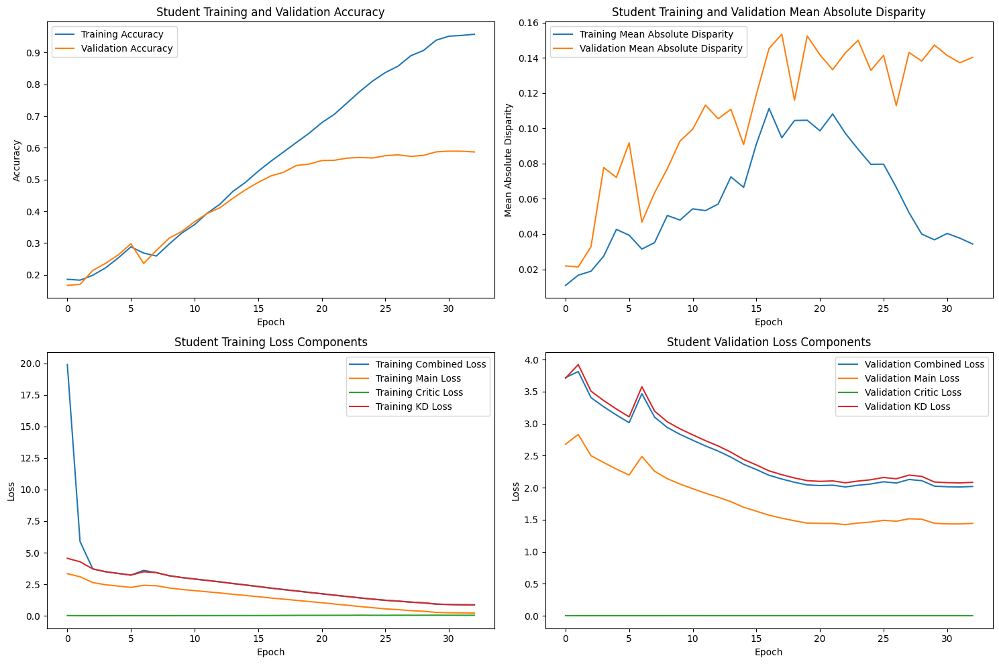

Epoch 34/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.76it/s]



STUDENT - Lambda 120 - Epoch 34 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.957832, VALIDATION Accuracy: 0.5921
TRAINING Disparity: 0.047915, VALIDATION Disparity: 0.1439
TRAINING Combined Loss: 0.845534, VALIDATION Combined Loss: 1.9999
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.046032580136626366
Class Celebration: Val Disparity = -0.06976744186046513
Class Parade: Val Disparity = 0.10321369927281265
Class Waiter_Or_Waitress: Val Disparity = -0.09929078014184378
Class Individual_Sports: Val Disparity = -0.17483647846026618
Class Surgeons: Val Disparity = -0.049816849816849695
Class Spa: Val Disparity = 0.049645390070921946
Class Law_Enforcement: Val Disparity = 0.20450191570881227
Class Business: Val Disparity = 0.062020460358056306
Class Dresses: Val Disparity = -0.6904761904761904
Class Water_Activities: Val Disparity = 0.09643400739291141
Class Picnic: Val Disparity = -0.24074074074074064
Class Res

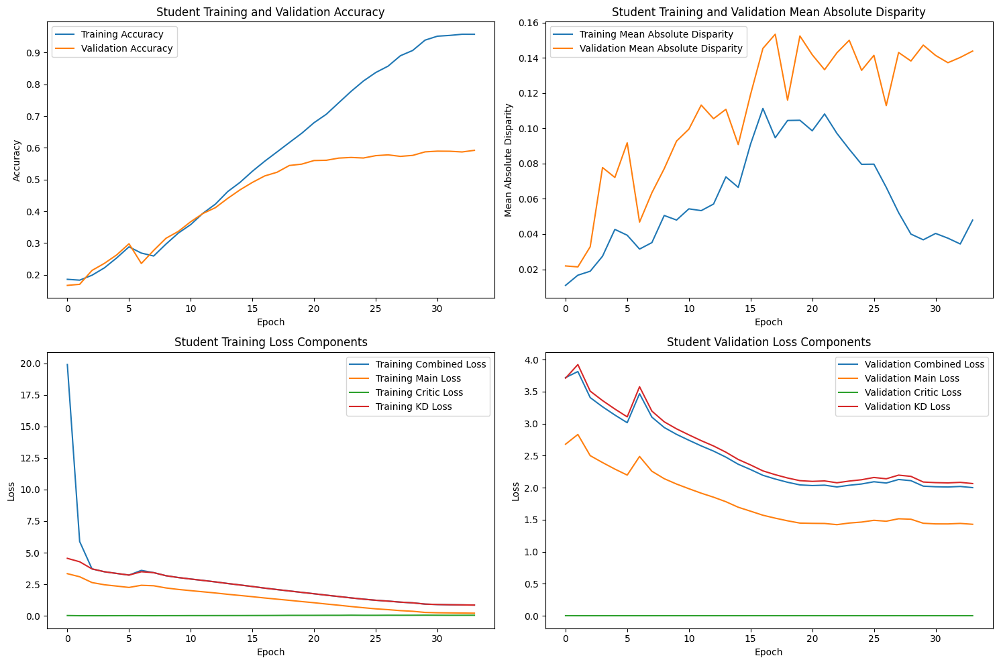

Epoch 35/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.71it/s]



STUDENT - Lambda 120 - Epoch 35 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.959047, VALIDATION Accuracy: 0.5884
TRAINING Disparity: 0.035422, VALIDATION Disparity: 0.1391
TRAINING Combined Loss: 0.840255, VALIDATION Combined Loss: 2.0007
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.046032580136626366
Class Celebration: Val Disparity = -0.06976744186046513
Class Parade: Val Disparity = 0.10321369927281265
Class Waiter_Or_Waitress: Val Disparity = -0.09929078014184378
Class Individual_Sports: Val Disparity = -0.17483647846026618
Class Surgeons: Val Disparity = -0.049816849816849695
Class Spa: Val Disparity = 0.049645390070921946
Class Law_Enforcement: Val Disparity = 0.20450191570881227
Class Business: Val Disparity = 0.062020460358056306
Class Dresses: Val Disparity = -0.6904761904761904
Class Water_Activities: Val Disparity = 0.09643400739291141
Class Picnic: Val Disparity = -0.24074074074074064
Class Res

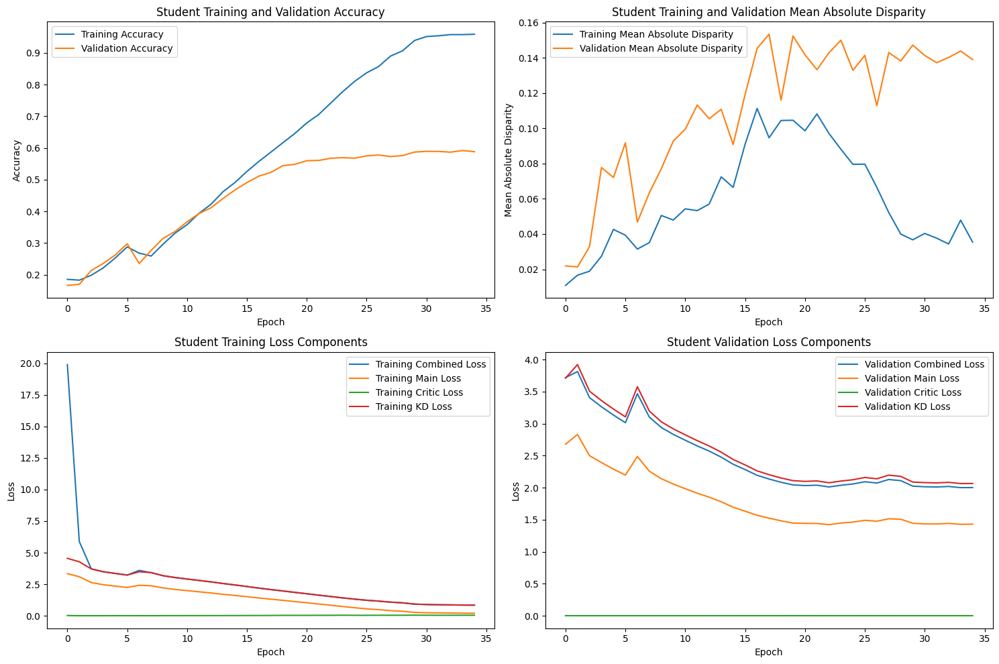

Epoch 36/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.75it/s]



STUDENT - Lambda 120 - Epoch 36 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.964950, VALIDATION Accuracy: 0.5912
TRAINING Disparity: 0.027976, VALIDATION Disparity: 0.1362
TRAINING Combined Loss: 0.819147, VALIDATION Combined Loss: 1.9914
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.03559292345419496
Class Celebration: Val Disparity = -0.10232558139534875
Class Parade: Val Disparity = 0.09429978888106971
Class Waiter_Or_Waitress: Val Disparity = -0.08865248226950362
Class Individual_Sports: Val Disparity = -0.18900834523720034
Class Surgeons: Val Disparity = -0.018315018315018305
Class Spa: Val Disparity = 0.07092198581560283
Class Law_Enforcement: Val Disparity = 0.21144636015325674
Class Business: Val Disparity = 0.04241261722080136
Class Dresses: Val Disparity = -0.6607142857142857
Class Water_Activities: Val Disparity = 0.06903674711893881
Class Picnic: Val Disparity = -0.16666666666666663
Class Rescue

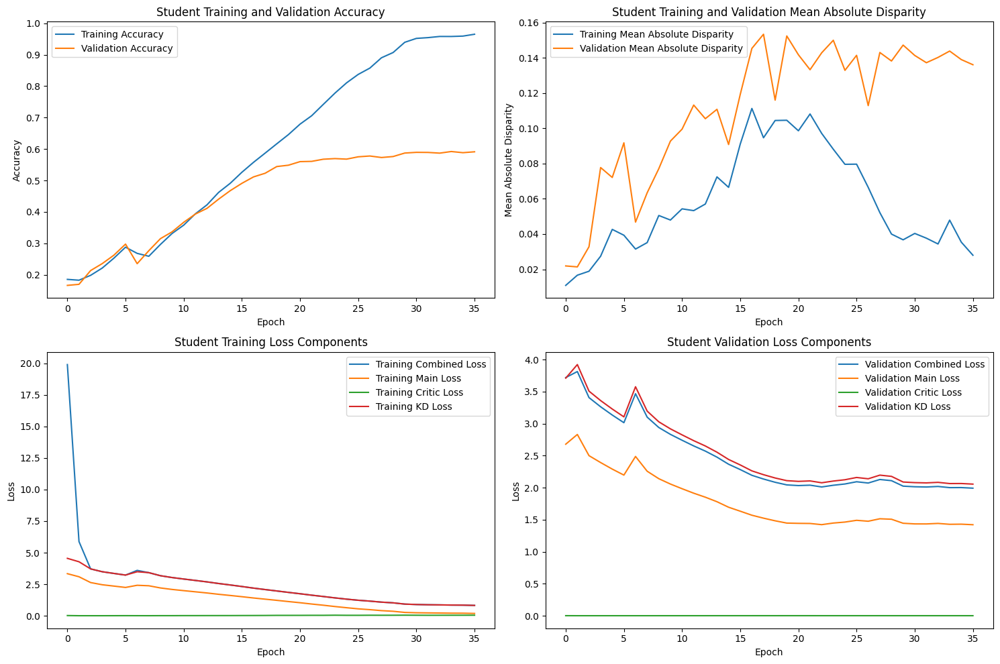

Epoch 37/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.75it/s]



STUDENT - Lambda 120 - Epoch 37 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.969695, VALIDATION Accuracy: 0.5932
TRAINING Disparity: 0.026996, VALIDATION Disparity: 0.1440
TRAINING Combined Loss: 0.811438, VALIDATION Combined Loss: 1.9802
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04227243533601921
Class Celebration: Val Disparity = -0.06511627906976747
Class Parade: Val Disparity = 0.06615059817030267
Class Waiter_Or_Waitress: Val Disparity = -0.10992907801418439
Class Individual_Sports: Val Disparity = -0.14292158484324502
Class Surgeons: Val Disparity = 0.010256410256410275
Class Spa: Val Disparity = -0.24113475177304972
Class Law_Enforcement: Val Disparity = 0.2701149425287357
Class Business: Val Disparity = 0.055413469735720366
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.06110023918243079
Class Picnic: Val Disparity = -0.20370370370370366
Class Rescue

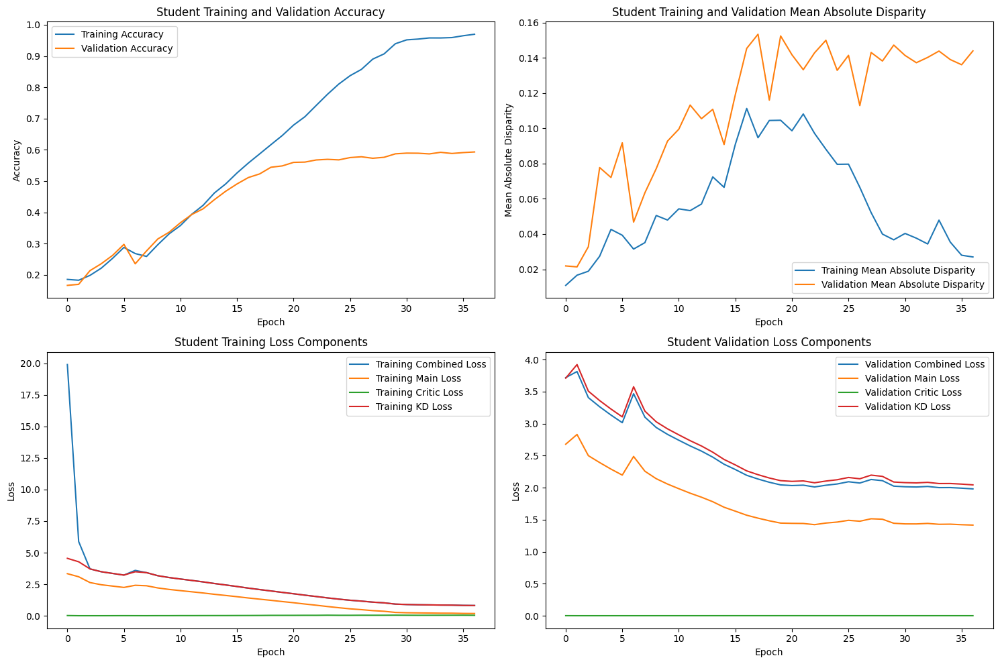

Epoch 38/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 120 - Epoch 38 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.968731, VALIDATION Accuracy: 0.5898
TRAINING Disparity: 0.032866, VALIDATION Disparity: 0.1371
TRAINING Combined Loss: 0.805981, VALIDATION Combined Loss: 1.9899
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04227243533601921
Class Celebration: Val Disparity = -0.06511627906976747
Class Parade: Val Disparity = 0.06615059817030267
Class Waiter_Or_Waitress: Val Disparity = -0.10992907801418439
Class Individual_Sports: Val Disparity = -0.14292158484324502
Class Surgeons: Val Disparity = 0.010256410256410275
Class Spa: Val Disparity = -0.24113475177304972
Class Law_Enforcement: Val Disparity = 0.2701149425287357
Class Business: Val Disparity = 0.055413469735720366
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.06110023918243079
Class Picnic: Val Disparity = -0.20370370370370366
Class Rescue

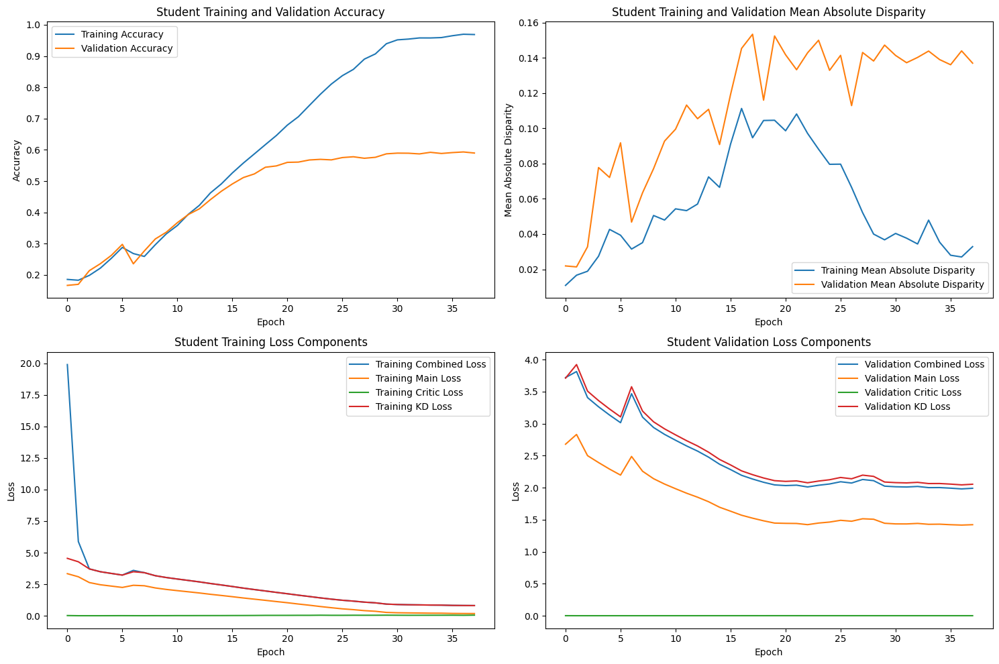

Epoch 39/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 120 - Epoch 39 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.970448, VALIDATION Accuracy: 0.5881
TRAINING Disparity: 0.031377, VALIDATION Disparity: 0.1350
TRAINING Combined Loss: 0.800585, VALIDATION Combined Loss: 2.0019
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04227243533601921
Class Celebration: Val Disparity = -0.06511627906976747
Class Parade: Val Disparity = 0.06615059817030267
Class Waiter_Or_Waitress: Val Disparity = -0.10992907801418439
Class Individual_Sports: Val Disparity = -0.14292158484324502
Class Surgeons: Val Disparity = 0.010256410256410275
Class Spa: Val Disparity = -0.24113475177304972
Class Law_Enforcement: Val Disparity = 0.2701149425287357
Class Business: Val Disparity = 0.055413469735720366
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.06110023918243079
Class Picnic: Val Disparity = -0.20370370370370366
Class Rescue

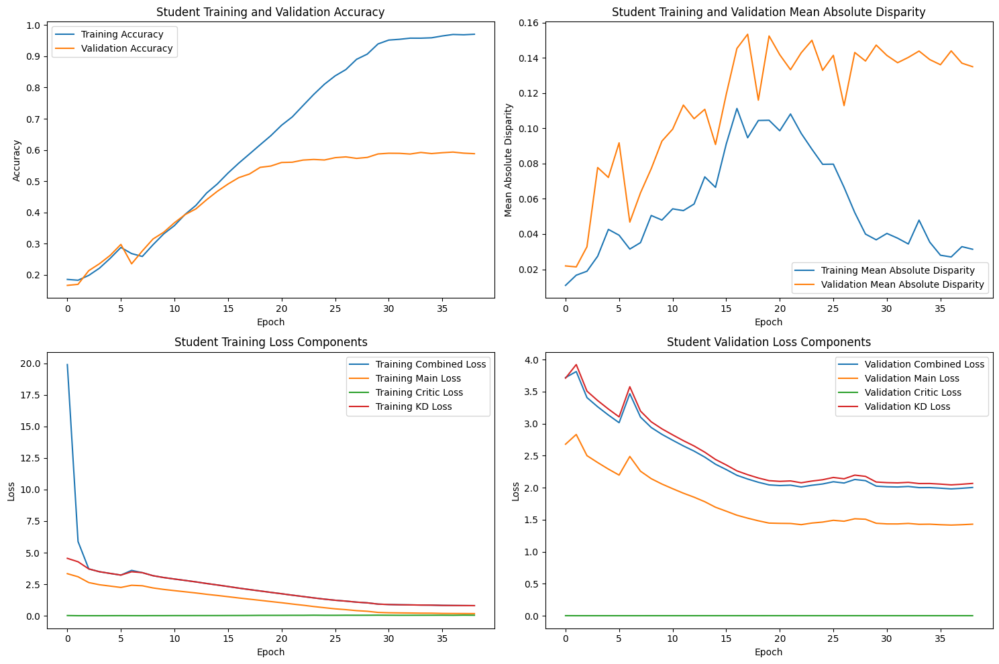

Epoch 40/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 120 - Epoch 40 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.971123, VALIDATION Accuracy: 0.5892
TRAINING Disparity: 0.033800, VALIDATION Disparity: 0.1411
TRAINING Combined Loss: 0.800220, VALIDATION Combined Loss: 1.9836
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04227243533601921
Class Celebration: Val Disparity = -0.06511627906976747
Class Parade: Val Disparity = 0.06615059817030267
Class Waiter_Or_Waitress: Val Disparity = -0.10992907801418439
Class Individual_Sports: Val Disparity = -0.14292158484324502
Class Surgeons: Val Disparity = 0.010256410256410275
Class Spa: Val Disparity = -0.24113475177304972
Class Law_Enforcement: Val Disparity = 0.2701149425287357
Class Business: Val Disparity = 0.055413469735720366
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.06110023918243079
Class Picnic: Val Disparity = -0.20370370370370366
Class Rescue

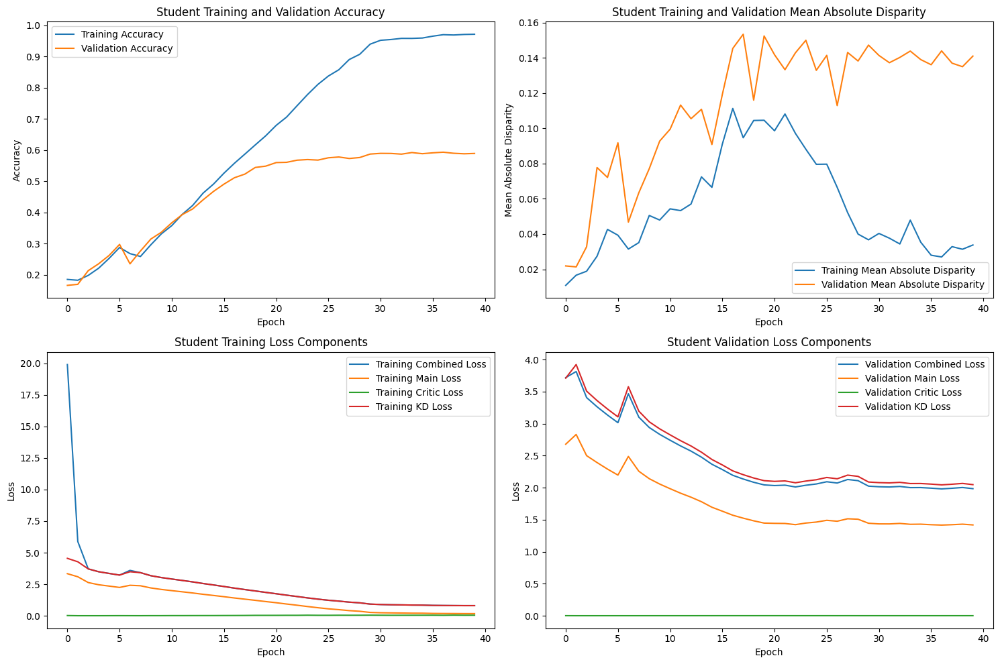

Epoch 41/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.70it/s]



STUDENT - Lambda 120 - Epoch 41 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.967265, VALIDATION Accuracy: 0.5881
TRAINING Disparity: 0.018209, VALIDATION Disparity: 0.1297
TRAINING Combined Loss: 0.806462, VALIDATION Combined Loss: 1.9887
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04227243533601921
Class Celebration: Val Disparity = -0.06511627906976747
Class Parade: Val Disparity = 0.06615059817030267
Class Waiter_Or_Waitress: Val Disparity = -0.10992907801418439
Class Individual_Sports: Val Disparity = -0.14292158484324502
Class Surgeons: Val Disparity = 0.010256410256410275
Class Spa: Val Disparity = -0.24113475177304972
Class Law_Enforcement: Val Disparity = 0.2701149425287357
Class Business: Val Disparity = 0.055413469735720366
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.06110023918243079
Class Picnic: Val Disparity = -0.20370370370370366
Class Rescue

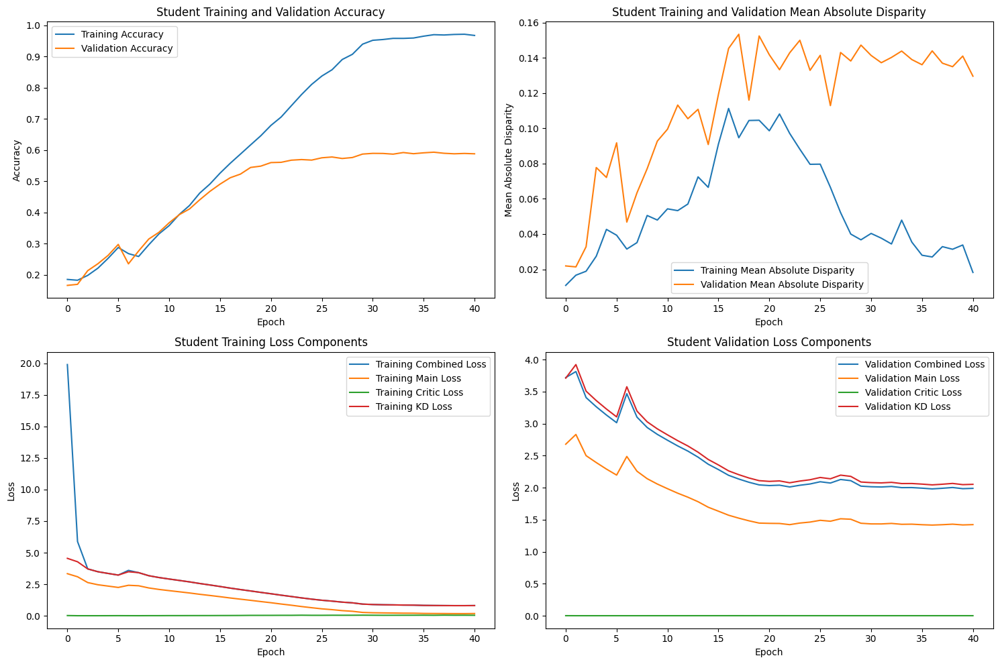

Epoch 42/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.67it/s]



STUDENT - Lambda 120 - Epoch 42 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.965258, VALIDATION Accuracy: 0.5943
TRAINING Disparity: 0.047645, VALIDATION Disparity: 0.1453
TRAINING Combined Loss: 0.805056, VALIDATION Combined Loss: 1.9849
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04227243533601921
Class Celebration: Val Disparity = -0.06511627906976747
Class Parade: Val Disparity = 0.06615059817030267
Class Waiter_Or_Waitress: Val Disparity = -0.10992907801418439
Class Individual_Sports: Val Disparity = -0.14292158484324502
Class Surgeons: Val Disparity = 0.010256410256410275
Class Spa: Val Disparity = -0.24113475177304972
Class Law_Enforcement: Val Disparity = 0.2701149425287357
Class Business: Val Disparity = 0.055413469735720366
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.06110023918243079
Class Picnic: Val Disparity = -0.20370370370370366
Class Rescue

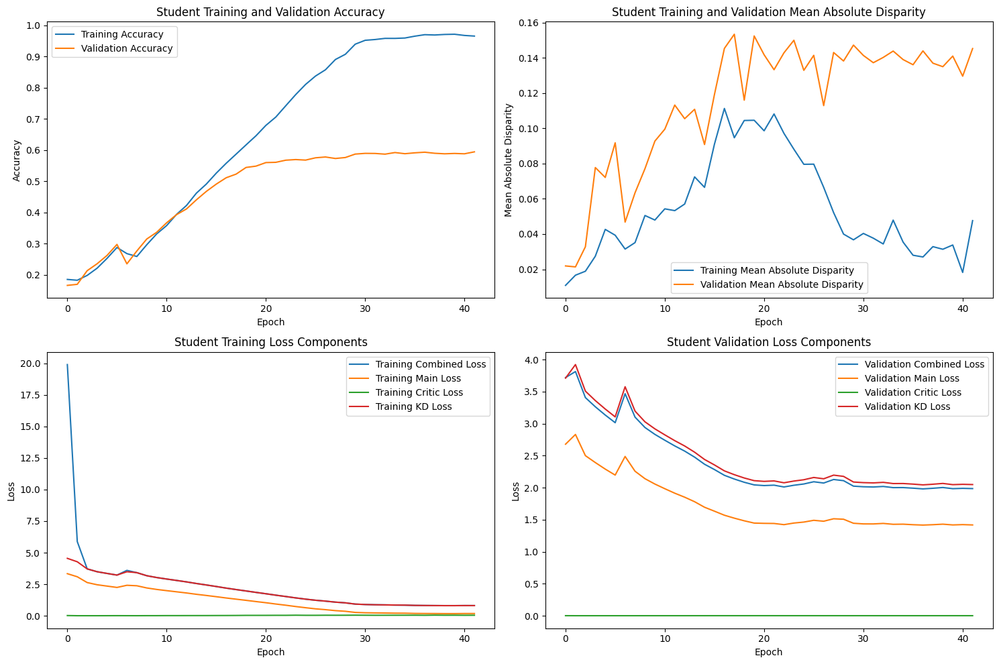

Epoch 43/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 120 - Epoch 43 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.971238, VALIDATION Accuracy: 0.5926
TRAINING Disparity: 0.036152, VALIDATION Disparity: 0.1336
TRAINING Combined Loss: 0.792288, VALIDATION Combined Loss: 1.9859
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04227243533601921
Class Celebration: Val Disparity = -0.06511627906976747
Class Parade: Val Disparity = 0.06615059817030267
Class Waiter_Or_Waitress: Val Disparity = -0.10992907801418439
Class Individual_Sports: Val Disparity = -0.14292158484324502
Class Surgeons: Val Disparity = 0.010256410256410275
Class Spa: Val Disparity = -0.24113475177304972
Class Law_Enforcement: Val Disparity = 0.2701149425287357
Class Business: Val Disparity = 0.055413469735720366
Class Dresses: Val Disparity = -0.7023809523809523
Class Water_Activities: Val Disparity = 0.06110023918243079
Class Picnic: Val Disparity = -0.20370370370370366
Class Rescue

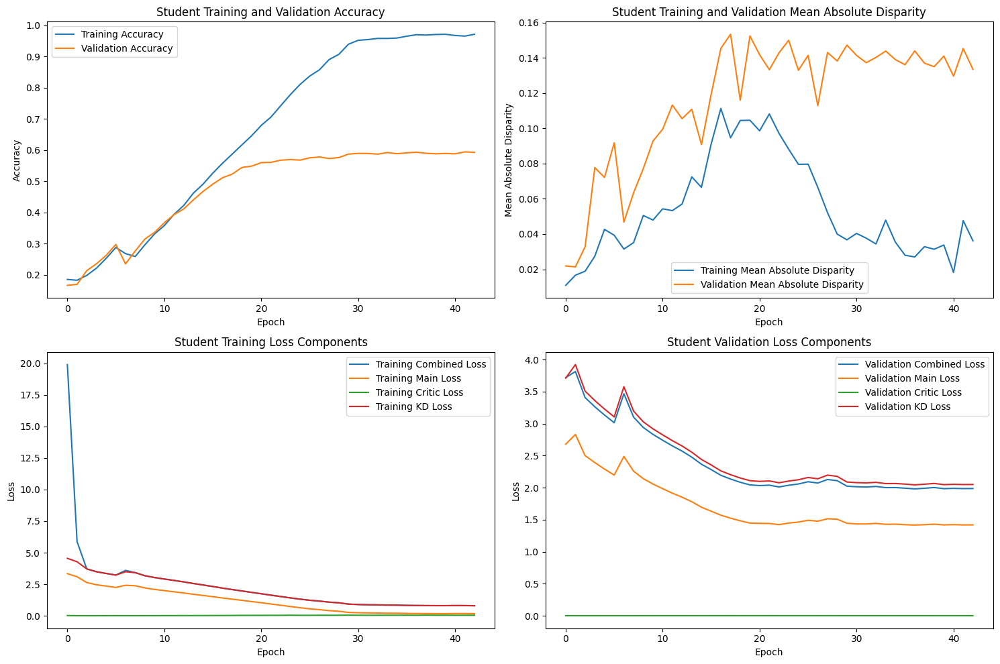

Epoch 44/200, Validation: 100%|█████████████████| 55/55 [00:27<00:00,  1.99it/s]



STUDENT - Lambda 120 - Epoch 44 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.975116, VALIDATION Accuracy: 0.5926
TRAINING Disparity: 0.018181, VALIDATION Disparity: 0.1383
TRAINING Combined Loss: 0.781803, VALIDATION Combined Loss: 1.9749
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05383312897763759
Class Celebration: Val Disparity = -0.07209302325581396
Class Parade: Val Disparity = 0.078935022284776
Class Waiter_Or_Waitress: Val Disparity = -0.1432624113475176
Class Individual_Sports: Val Disparity = -0.14998872265243213
Class Surgeons: Val Disparity = -0.015384615384615385
Class Spa: Val Disparity = 0.13475177304964536
Class Law_Enforcement: Val Disparity = 0.20785440613026812
Class Business: Val Disparity = -0.0010656436487639365
Class Dresses: Val Disparity = -0.6785714285714286
Class Water_Activities: Val Disparity = 0.04163948684496621
Class Picnic: Val Disparity = -0.20370370370370378
Class Rescue

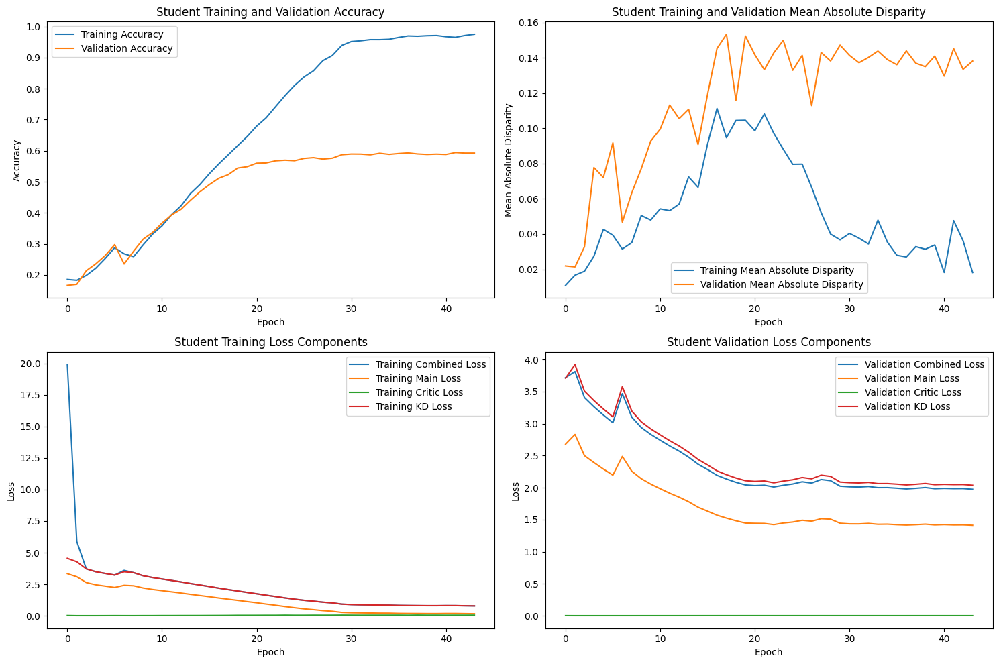

Epoch 45/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.75it/s]



STUDENT - Lambda 120 - Epoch 45 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.972762, VALIDATION Accuracy: 0.5940
TRAINING Disparity: 0.025255, VALIDATION Disparity: 0.1505
TRAINING Combined Loss: 0.784734, VALIDATION Combined Loss: 1.9802
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05383312897763759
Class Celebration: Val Disparity = -0.07209302325581396
Class Parade: Val Disparity = 0.078935022284776
Class Waiter_Or_Waitress: Val Disparity = -0.1432624113475176
Class Individual_Sports: Val Disparity = -0.14998872265243213
Class Surgeons: Val Disparity = -0.015384615384615385
Class Spa: Val Disparity = 0.13475177304964536
Class Law_Enforcement: Val Disparity = 0.20785440613026812
Class Business: Val Disparity = -0.0010656436487639365
Class Dresses: Val Disparity = -0.6785714285714286
Class Water_Activities: Val Disparity = 0.04163948684496621
Class Picnic: Val Disparity = -0.20370370370370378
Class Rescue

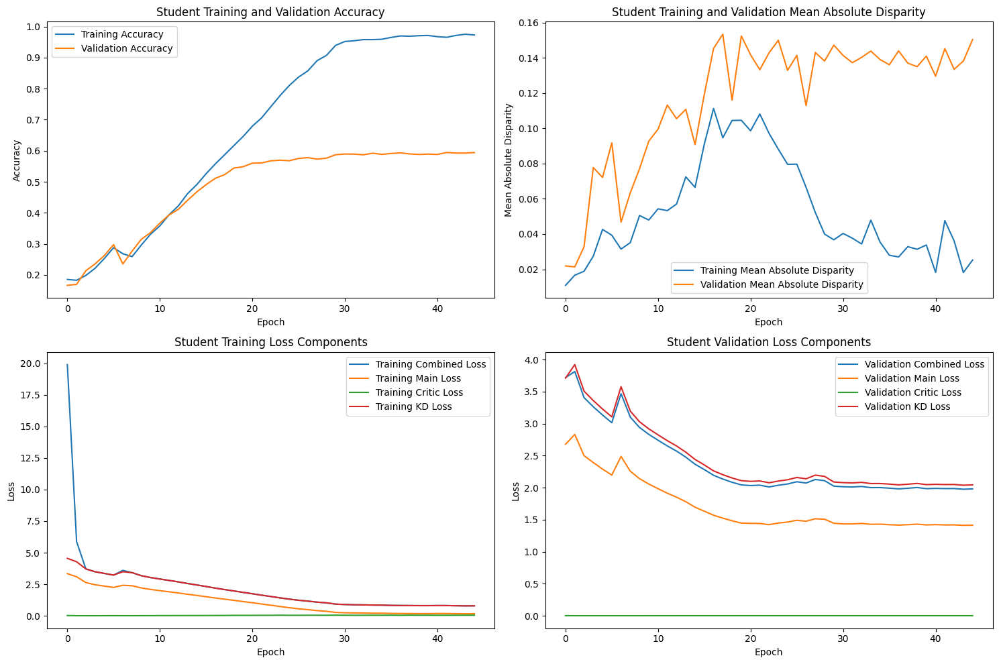

Epoch 46/200, Validation: 100%|█████████████████| 55/55 [00:20<00:00,  2.74it/s]



STUDENT - Lambda 120 - Epoch 46 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.974132, VALIDATION Accuracy: 0.5918
TRAINING Disparity: 0.021049, VALIDATION Disparity: 0.1418
TRAINING Combined Loss: 0.782793, VALIDATION Combined Loss: 1.9753
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05383312897763759
Class Celebration: Val Disparity = -0.07209302325581396
Class Parade: Val Disparity = 0.078935022284776
Class Waiter_Or_Waitress: Val Disparity = -0.1432624113475176
Class Individual_Sports: Val Disparity = -0.14998872265243213
Class Surgeons: Val Disparity = -0.015384615384615385
Class Spa: Val Disparity = 0.13475177304964536
Class Law_Enforcement: Val Disparity = 0.20785440613026812
Class Business: Val Disparity = -0.0010656436487639365
Class Dresses: Val Disparity = -0.6785714285714286
Class Water_Activities: Val Disparity = 0.04163948684496621
Class Picnic: Val Disparity = -0.20370370370370378
Class Rescue

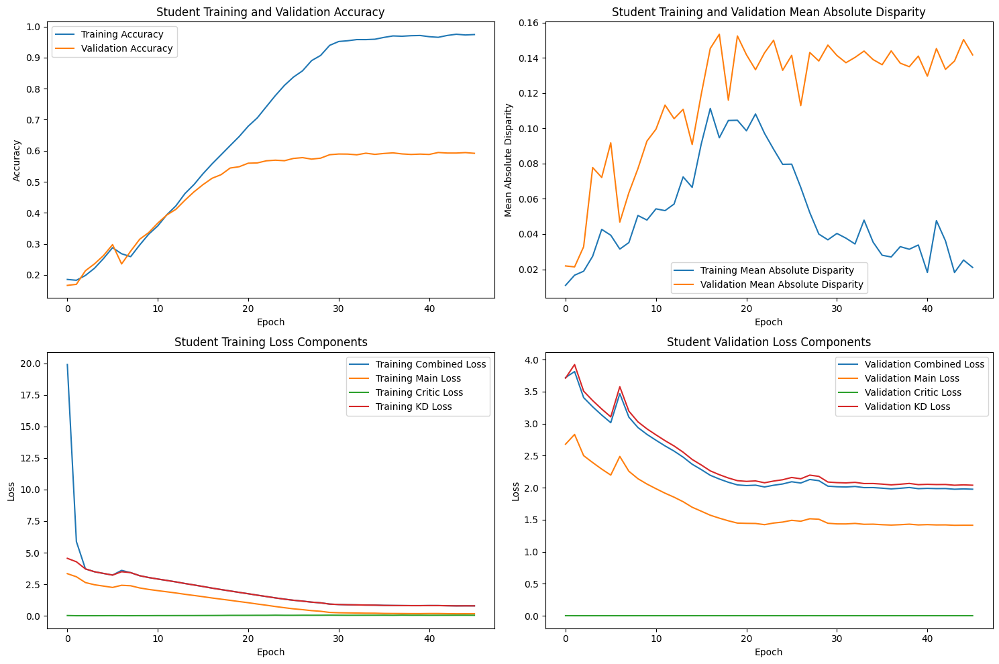

Epoch 47/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.77it/s]



STUDENT - Lambda 120 - Epoch 47 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.972608, VALIDATION Accuracy: 0.5946
TRAINING Disparity: 0.046373, VALIDATION Disparity: 0.1412
TRAINING Combined Loss: 0.782202, VALIDATION Combined Loss: 1.9704
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04715361709581367
Class Celebration: Val Disparity = -0.09767441860465126
Class Parade: Val Disparity = 0.024044100398780133
Class Waiter_Or_Waitress: Val Disparity = -0.10992907801418439
Class Individual_Sports: Val Disparity = -0.1606270205247725
Class Surgeons: Val Disparity = 0.010256410256410275
Class Spa: Val Disparity = 0.0921985815602836
Class Law_Enforcement: Val Disparity = 0.20785440613026823
Class Business: Val Disparity = 0.02280477408354631
Class Dresses: Val Disparity = -0.6547619047619048
Class Water_Activities: Val Disparity = 0.08490976299195463
Class Picnic: Val Disparity = -0.27777777777777785
Class Rescue: 

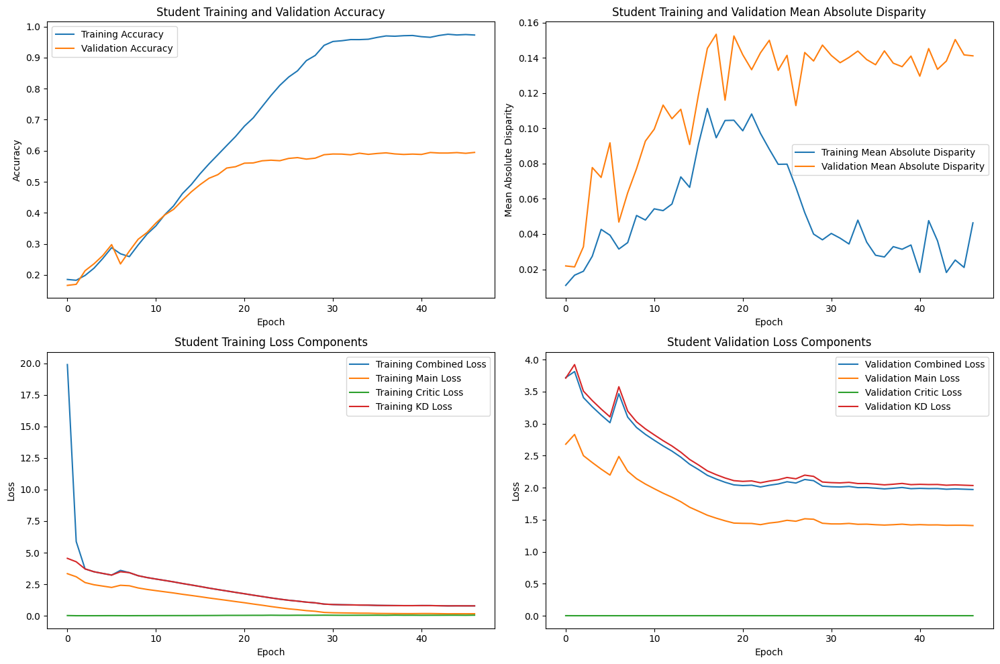

Epoch 48/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.80it/s]



STUDENT - Lambda 120 - Epoch 48 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.975116, VALIDATION Accuracy: 0.5909
TRAINING Disparity: 0.022496, VALIDATION Disparity: 0.1434
TRAINING Combined Loss: 0.779418, VALIDATION Combined Loss: 1.9729
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04715361709581367
Class Celebration: Val Disparity = -0.09767441860465126
Class Parade: Val Disparity = 0.024044100398780133
Class Waiter_Or_Waitress: Val Disparity = -0.10992907801418439
Class Individual_Sports: Val Disparity = -0.1606270205247725
Class Surgeons: Val Disparity = 0.010256410256410275
Class Spa: Val Disparity = 0.0921985815602836
Class Law_Enforcement: Val Disparity = 0.20785440613026823
Class Business: Val Disparity = 0.02280477408354631
Class Dresses: Val Disparity = -0.6547619047619048
Class Water_Activities: Val Disparity = 0.08490976299195463
Class Picnic: Val Disparity = -0.27777777777777785
Class Rescue: 

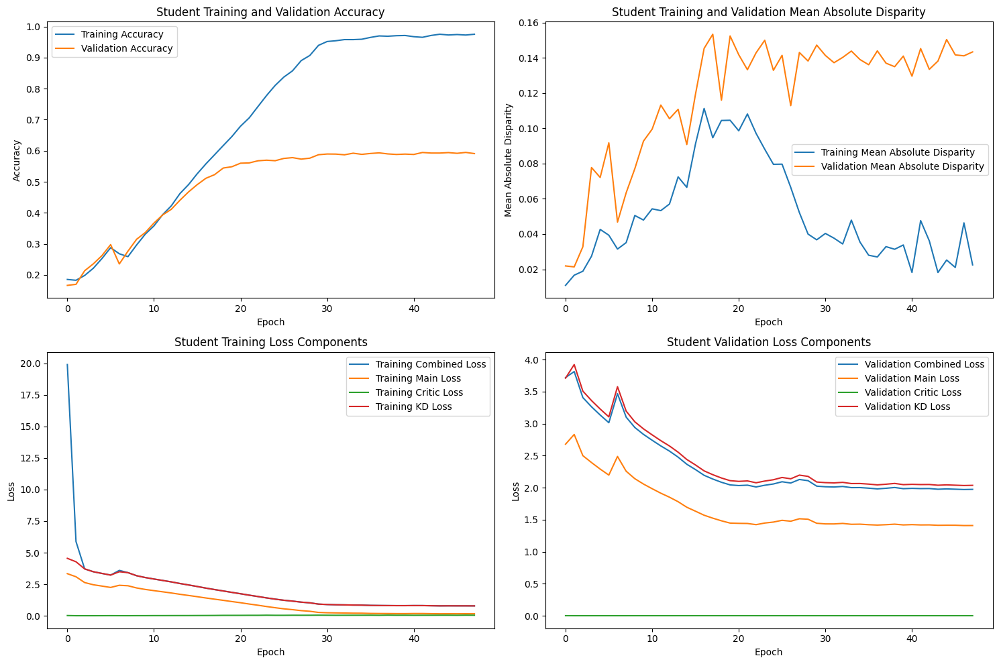

Epoch 49/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.80it/s]



STUDENT - Lambda 120 - Epoch 49 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.974923, VALIDATION Accuracy: 0.5952
TRAINING Disparity: 0.031068, VALIDATION Disparity: 0.1450
TRAINING Combined Loss: 0.778435, VALIDATION Combined Loss: 1.9742
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04715361709581367
Class Celebration: Val Disparity = -0.09767441860465126
Class Parade: Val Disparity = 0.024044100398780133
Class Waiter_Or_Waitress: Val Disparity = -0.10992907801418439
Class Individual_Sports: Val Disparity = -0.1606270205247725
Class Surgeons: Val Disparity = 0.010256410256410275
Class Spa: Val Disparity = 0.0921985815602836
Class Law_Enforcement: Val Disparity = 0.20785440613026823
Class Business: Val Disparity = 0.02280477408354631
Class Dresses: Val Disparity = -0.6547619047619048
Class Water_Activities: Val Disparity = 0.08490976299195463
Class Picnic: Val Disparity = -0.27777777777777785
Class Rescue: 

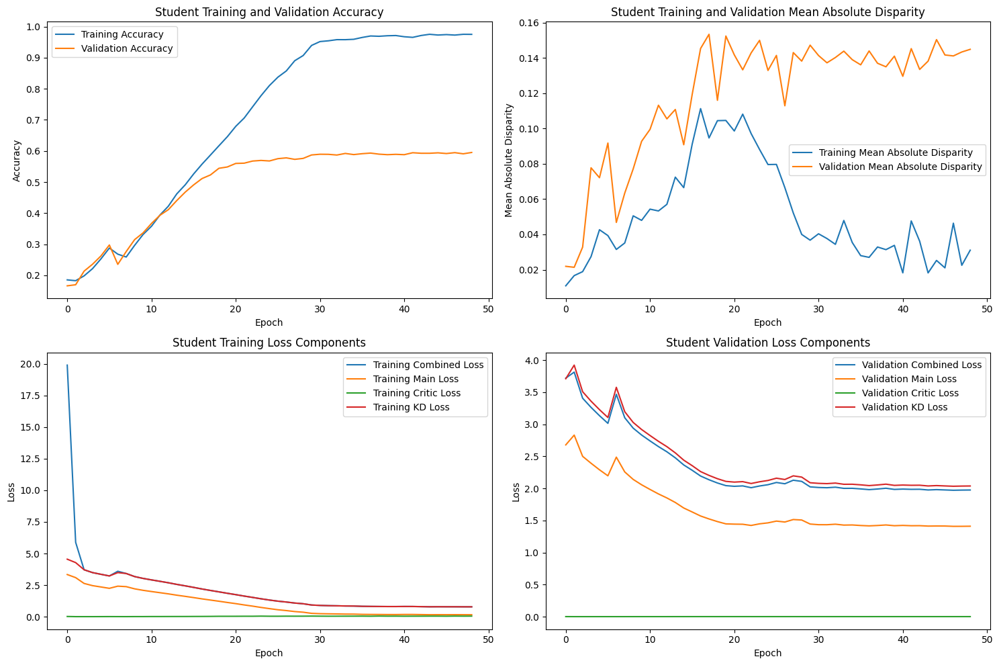

Epoch 50/200, Validation: 100%|█████████████████| 55/55 [00:19<00:00,  2.81it/s]



STUDENT - Lambda 120 - Epoch 50 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.973283, VALIDATION Accuracy: 0.5929
TRAINING Disparity: 0.019235, VALIDATION Disparity: 0.1398
TRAINING Combined Loss: 0.785048, VALIDATION Combined Loss: 1.9701
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05871431073743216
Class Celebration: Val Disparity = -0.05581395348837215
Class Parade: Val Disparity = 0.11599812338728577
Class Waiter_Or_Waitress: Val Disparity = -0.08723404255319156
Class Individual_Sports: Val Disparity = -0.13232087812946403
Class Surgeons: Val Disparity = 0.010256410256410275
Class Spa: Val Disparity = 0.0921985815602836
Class Law_Enforcement: Val Disparity = 0.22174329501915718
Class Business: Val Disparity = 0.05328218243819266
Class Dresses: Val Disparity = -0.7083333333333333
Class Water_Activities: Val Disparity = 0.035877364644487875
Class Picnic: Val Disparity = -0.24074074074074076
Class Rescue:

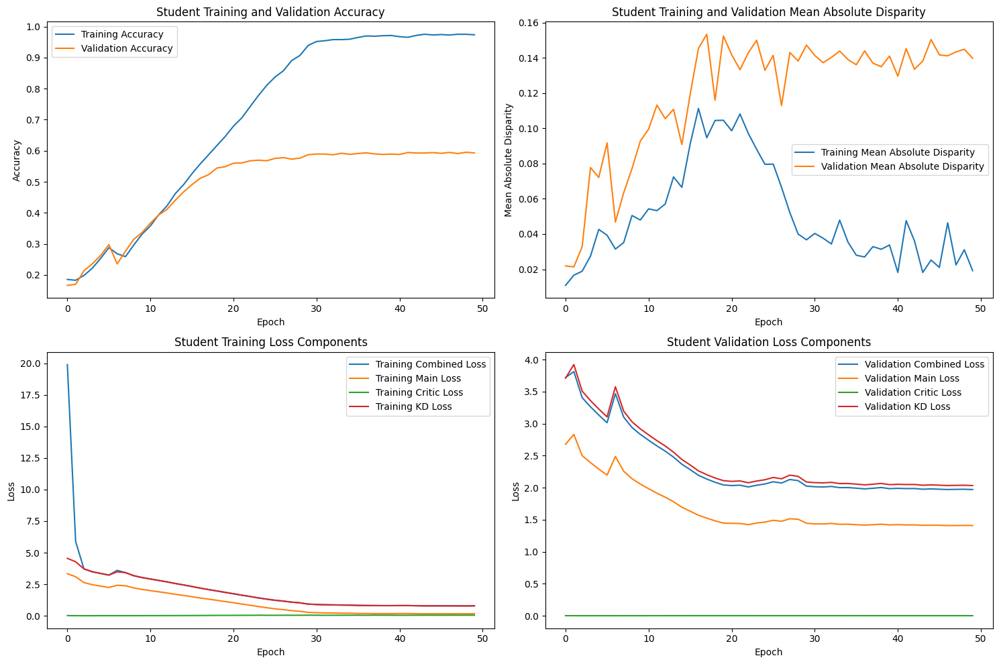

Epoch 51/200, Training:  50%|█████████         | 81/162 [00:59<00:59,  1.36it/s]

KeyboardInterrupt



In [16]:
# # STUDENT
# Create dict to store best model states
student_model_states_best = {}

# Specify the lambda_factor for the teacher model to load
lambda_factor = 0

# Define the path to the saved model file for this lambda_factor
lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lambda_factor}')
teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lambda_factor}.pth')

# Initialize the EfficientNet model without pre-trained weights
teacher = models.efficientnet_b3(pretrained=False)

# Adjust the classifier layer to match your number of classes
num_ftrs = teacher.classifier[1].in_features
teacher.classifier[1] = nn.Linear(num_ftrs, num_classes)

# Load the model state
teacher_best_model_state = torch.load(teacher_path)
teacher.load_state_dict(teacher_best_model_state['teacher_state_dict'])


# Loop through the lambda_factor_list
for lambda_factor in student_lambda_factor_list:
    # Load EfficientNet B0 model for Student
    student = models.efficientnet_b0(pretrained=True)
    
    # Determine the number of output features from the feature extractor part of EfficientNet B0
    num_ftrs = student.classifier[1].in_features  # This is the correct number of input features for your adversarial classifier
    
    # Modify the classifier layer of the EfficientNet model to match your number of classes
    student.classifier[1] = nn.Linear(num_ftrs, num_classes)
    

    # Initialize the Critic model
    critic = Critic(input_size=num_classes) # Adjust the input size based on your model's output
    critic_optimizer = optim.Adam(critic.parameters(), lr=student_learning_rate, weight_decay=weight_decay)
    critic_scheduler = lr_scheduler.ReduceLROnPlateau(critic_optimizer, mode='min', factor=0.2, patience=5, min_lr=0.0001)
    critic_loss_fn = torch.nn.MSELoss()
    
    # Redefine your main model optimizer if needed
    student_optimizer = optim.Adam(student.parameters(), lr=student_learning_rate, weight_decay=weight_decay)
    student_scheduler = lr_scheduler.ReduceLROnPlateau(student_optimizer, mode='min', factor=0.2, patience=5, min_lr=0.00001)
    student_loss_fn = nn.CrossEntropyLoss()

    # Train the model
    student_best_model_state = train_student(student, teacher, student_optimizer, student_loss_fn, critic, critic_optimizer, critic_loss_fn,
                                   lambda_factor, temperature, alpha, epsilon, margin, student_patience, student_epochs, device, base_save_dir=base_save_dir, 
                                    student_scheduler=student_scheduler, critic_scheduler=critic_scheduler)
    student_model_states_best[lambda_factor] = student_best_model_state

# Save the collective best model states to a file
student_collective_save_path = os.path.join(base_save_dir, 'student_model_states_best.pth')
torch.save(student_model_states_best, student_collective_save_path)

In [ ]:
# # load models
# collective_save_path = os.path.join(base_save_dir, 'student_model_states_best.pth')

# # Load the saved model states
# teacher_model_states_best = torch.load(collective_save_path)

# # Example: Accessing the best_val_accuracy for a specific lambda value
# lambda_value = 50
# if lambda_value in teacher_model_states_best:
#     best_model_state = teacher_model_states_best[lambda_value]
#     best_val_accuracy = best_model_state['best_val_accuracy']
#     print(f"Best validation accuracy for lambda {lambda_value}: {best_val_accuracy}")
# else:
#     print(f"No model state found for lambda {lambda_value}")

### PLOTTING

In [ ]:
def compare_performance_metrics(teacher, student, dataloader):
    teacher.eval()
    student.eval()
    
    all_labels = []
    all_teacher_preds = []
    all_student_preds = []

    for batch in dataloader:
        inputs = batch['img'].to(device)
        labels = batch['label'].to(device)
        
        with torch.no_grad():
            teacher_outputs = teacher(inputs)
            student_outputs = student(inputs)
            
        teacher_preds = torch.argmax(teacher_outputs, dim=1).cpu().numpy()
        student_preds = torch.argmax(student_outputs, dim=1).cpu().numpy()
        
        all_labels.append(labels.cpu().numpy())
        all_teacher_preds.append(teacher_preds)
        all_student_preds.append(student_preds)

    all_labels = np.concatenate(all_labels)
    all_teacher_preds = np.concatenate(all_teacher_preds)
    all_student_preds = np.concatenate(all_student_preds)
    
    metrics = {
        'accuracy': (accuracy_score(all_labels, all_teacher_preds), accuracy_score(all_labels, all_student_preds)),
        'precision': (precision_score(all_labels, all_teacher_preds, average='weighted', zero_division=0), precision_score(all_labels, all_student_preds, average='weighted', zero_division=0)),
        'recall': (recall_score(all_labels, all_teacher_preds, average='weighted'), recall_score(all_labels, all_student_preds, average='weighted')),
        'f1': (f1_score(all_labels, all_teacher_preds, average='weighted'), f1_score(all_labels, all_student_preds, average='weighted'))
    }

    return {
        'metrics': metrics,
        'all_labels': all_labels,
        'all_teacher_preds': all_teacher_preds,
        'all_student_preds': all_student_preds
    }

def compare_model_size(teacher, student):
    teacher_params = sum(p.numel() for p in teacher.parameters())
    student_params = sum(p.numel() for p in student.parameters())
    return teacher_params, student_params

def compare_inference_time(teacher, student, dataloader):
    dataiter = iter(dataloader)
    data = next(dataiter)
    inputs = data['img']
    inputs = inputs.to(device)

    teacher_time, student_time = 0, 0

    if teacher is not None:
        teacher = teacher.to(device)
        start_time = time.time()
        with torch.no_grad():
            teacher_outputs = teacher(inputs)
        teacher_time = time.time() - start_time

    if student is not None:
        student = student.to(device)
        start_time = time.time()
        with torch.no_grad():
            student_outputs = student(inputs)
        student_time = time.time() - start_time
    
    return teacher_time, student_time

In [ ]:
lambda_results = {}

# Loop through each lambda value
for lmda_teacher in teacher_lambda_factor_list:
    for lmda_student in student_lambda_factor_list:

        # Define the path to the saved model file for this lambda_factor
        lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lmda_teacher}')
        teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lmda_teacher}.pth')
        
        # Initialize the EfficientNet model without pre-trained weights
        teacher_model = models.efficientnet_b3(pretrained=False)
        
        # Adjust the classifier layer to match your number of classes
        num_ftrs = teacher.classifier[1].in_features
        teacher_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
        
        # Load the model state
        teacher_best_model_state = torch.load(teacher_path)
        teacher_model.load_state_dict(teacher_best_model_state['teacher_state_dict'])
        teacher_model = teacher_model.to(device)
        
        # Define the path to the saved model file for this lambda_factor
        lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lmda_student}')
        student_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lmda_student}.pth')
        
        # Initialize the EfficientNet model without pre-trained weights
        student_model = models.efficientnet_b0(pretrained=False)
        
        # Adjust the classifier layer to match your number of classes
        num_ftrs = student_model.classifier[1].in_features
        student_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
        
        # Load the model state
        student_best_model_state = torch.load(student_path)
        student_model.load_state_dict(student_best_model_state['student_state_dict'])
        student_model = student_model.to(device)
        
        # Compute performance metrics
        performance_metrics = compare_performance_metrics(teacher_model, student_model, testloader)
    
        # Compute model sizes
        teacher_params, student_params = compare_model_size(teacher_model, student_model)
    
        # Construct a unique key for the current combination of lambda values
        lambda_key = (lmda_teacher, lmda_student)

        # Update results for the current lambda value
        if lambda_key in lambda_results:
            lambda_results[lambda_key].update({
                'performance_metrics': performance_metrics,
                'teacher_params': teacher_params,
                'student_params': student_params
            })
        else:
            lambda_results[lambda_key] = {
                'performance_metrics': performance_metrics,
                'teacher_params': teacher_params,
                'student_params': student_params
            }

In [ ]:
# Initialize lists to store accuracies
teacher_accuracies = []
student_accuracies = []
lambda_pairs = list(lambda_results.keys())

# Iterate over the keys in lambda_results
for key in lambda_pairs:
    # Check if the key is a tuple (indicating a lambda pair)
    if isinstance(key, tuple) and len(key) == 2:
        lmda_teacher, lmda_student = key
    else:
        # If the key is not a tuple, skip this iteration
        continue

    # Access the performance metrics for each pair
    teacher_accuracy = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['accuracy'][0]
    student_accuracy = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['accuracy'][1]

    # Append accuracies to the lists
    teacher_accuracies.append((lmda_teacher, teacher_accuracy))
    student_accuracies.append((lmda_student, student_accuracy))

# To plot, you might need to separate the lambda values and accuracies
teacher_lambdas, teacher_acc = zip(*teacher_accuracies)
student_lambdas, student_acc = zip(*student_accuracies)

# Plotting only with markers and no lines
plt.scatter(teacher_lambdas, teacher_acc, label='Teacher Accuracy', marker='o')
plt.scatter(student_lambdas, student_acc, label='Student Accuracy', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('Accuracy')
plt.title('Accuracy Comparison Across Lambdas')
plt.legend()

# Show plot
plt.show()

In [ ]:
# Initialize lists to store precisions
teacher_precisions = []
student_precisions = []
lambda_pairs = list(lambda_results.keys())

# Iterate over the keys in lambda_results
for key in lambda_pairs:
    # Check if the key is a tuple (indicating a lambda pair)
    if isinstance(key, tuple) and len(key) == 2:
        lmda_teacher, lmda_student = key
        # Access the precision metrics for each pair
        teacher_precision = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['precision'][0]
        student_precision = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['precision'][1]
    else:
        # If the key is not a tuple, skip this iteration
        continue

    # Append precisions to the lists along with lambda values
    teacher_precisions.append((lmda_teacher, teacher_precision))
    student_precisions.append((lmda_student, student_precision))

# Extracting lambda values and precisions
teacher_lambdas, teacher_prec = zip(*teacher_precisions)
student_lambdas, student_prec = zip(*student_precisions)

# Creating a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_prec, label='Teacher Precision', marker='o')
plt.scatter(student_lambdas, student_prec, label='Student Precision', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('Precision')
plt.title('Precision Comparison Across Lambdas')
plt.legend()

# Displaying the plot
plt.show()

In [ ]:
# Initialize lists to store recalls
teacher_recalls = []
student_recalls = []
lambda_pairs = list(lambda_results.keys())

# Iterate over the keys in lambda_results
for key in lambda_pairs:
    # Check if the key is a tuple (indicating a lambda pair)
    if isinstance(key, tuple) and len(key) == 2:
        lmda_teacher, lmda_student = key
        # Access the recall metrics for each pair
        teacher_recall = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['recall'][0]
        student_recall = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['recall'][1]
    else:
        # If the key is not a tuple, skip this iteration
        continue

    # Append recalls to the lists along with lambda values
    teacher_recalls.append((lmda_teacher, teacher_recall))
    student_recalls.append((lmda_student, student_recall))

# Extracting lambda values and recalls
teacher_lambdas, teacher_rec = zip(*teacher_recalls)
student_lambdas, student_rec = zip(*student_recalls)

# Creating a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_rec, label='Teacher Recall', marker='o')
plt.scatter(student_lambdas, student_rec, label='Student Recall', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('Recall')
plt.title('Recall Comparison Across Lambdas')
plt.legend()

# Displaying the plot
plt.show()

In [ ]:
# Initialize lists to store F1 scores
teacher_f1s = []
student_f1s = []
lambda_pairs = list(lambda_results.keys())

# Iterate over the keys in lambda_results
for key in lambda_pairs:
    # Check if the key is a tuple (indicating a lambda pair)
    if isinstance(key, tuple) and len(key) == 2:
        lmda_teacher, lmda_student = key
        # Access the F1 scores for each pair
        teacher_f1 = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['f1'][0]
        student_f1 = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['f1'][1]
    else:
        # If the key is not a tuple, skip this iteration
        continue

    # Append F1 scores to the lists along with lambda values
    teacher_f1s.append((lmda_teacher, teacher_f1))
    student_f1s.append((lmda_student, student_f1))

# Extracting lambda values and F1 scores
teacher_lambdas, teacher_f1_scores = zip(*teacher_f1s)
student_lambdas, student_f1_scores = zip(*student_f1s)

# Creating a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_f1_scores, label='Teacher F1 Score', marker='o')
plt.scatter(student_lambdas, student_f1_scores, label='Student F1 Score', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('F1 Score')
plt.title('F1 Score Comparison Across Lambdas')
plt.legend()

# Displaying the plot
plt.show()

In [ ]:
# Initialize lists to store model sizes
teacher_sizes = []
student_sizes = []
lambda_pairs = list(lambda_results.keys())

# Iterate over the keys in lambda_results
for key in lambda_pairs:
    # Check if the key is a tuple (indicating a lambda pair)
    if isinstance(key, tuple) and len(key) == 2:
        lmda_teacher, lmda_student = key
        # Access the model sizes for each pair
        teacher_size = lambda_results[(lmda_teacher, lmda_student)]['teacher_params'] / 1e6  # Convert to millions
        student_size = lambda_results[(lmda_teacher, lmda_student)]['student_params'] / 1e6
    else:
        # If the key is not a tuple, skip this iteration
        continue

    # Append model sizes to the lists along with lambda values
    teacher_sizes.append((lmda_teacher, teacher_size))
    student_sizes.append((lmda_student, student_size))

# Extracting lambda values and model sizes
teacher_lambdas, teacher_model_sizes = zip(*teacher_sizes)
student_lambdas, student_model_sizes = zip(*student_sizes)

# Creating a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_model_sizes, label='Teacher Model Size', marker='o')
plt.scatter(student_lambdas, student_model_sizes, label='Student Model Size', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('Model Size (Millions of Parameters)')
plt.title('Model Size Comparison Across Lambdas')
plt.legend()

# Displaying the plot
plt.show()

In [ ]:
        # Define the path to the saved model file for this lambda_factor
        lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lmda_teacher}')
        teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lmda_teacher}.pth')
        
        # Initialize the EfficientNet model without pre-trained weights
        teacher_model = models.efficientnet_b3(pretrained=False)
        
        # Adjust the classifier layer to match your number of classes
        num_ftrs = teacher.classifier[1].in_features
        teacher_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
        
        # Load the model state
        teacher_best_model_state = torch.load(teacher_path)
        teacher_model.load_state_dict(teacher_best_model_state['teacher_state_dict'])
        teacher_model = teacher_model.to(device)
        
        # Define the path to the saved model file for this lambda_factor
        lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lmda_student}')
        student_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lmda_student}.pth')
        
        # Initialize the EfficientNet model without pre-trained weights
        student_model = models.efficientnet_b0(pretrained=False)
        
        # Adjust the classifier layer to match your number of classes
        num_ftrs = student_model.classifier[1].in_features
        student_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
        
        # Load the model state
        student_best_model_state = torch.load(student_path)
        student_model.load_state_dict(student_best_model_state['student_state_dict'])
        student_model = student_model.to(device)

In [ ]:
# Initialize dictionaries to store inference times for each lambda value
teacher_times = {}
student_times = {}

# Loop through each lambda value
for lmda_teacher in teacher_lambda_factor_list:
    # Define the path to the saved model file for this lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lmda_teacher}')
    teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lmda_teacher}.pth')
    
    # Initialize the EfficientNet model without pre-trained weights
    teacher_model = models.efficientnet_b3(pretrained=False)
    
    # Adjust the classifier layer to match your number of classes
    num_ftrs = teacher.classifier[1].in_features
    teacher_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
    
    # Load the model state
    teacher_best_model_state = torch.load(teacher_path)
    teacher_model.load_state_dict(teacher_best_model_state['teacher_state_dict'])
    teacher_model = teacher_model.to(device)

    teacher_time, _ = compare_inference_time(teacher_model, None, testloader)
    teacher_times[lmda_teacher] = teacher_time  # Store the inference time for the teacher model

for lmda_student in student_lambda_factor_list:
    # Define the path to the saved model file for this lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lmda_student}')
    student_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lmda_student}.pth')
    
    # Initialize the EfficientNet model without pre-trained weights
    student_model = models.efficientnet_b0(pretrained=False)
    
    # Adjust the classifier layer to match your number of classes
    num_ftrs = student_model.classifier[1].in_features
    student_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
    
    # Load the model state
    student_best_model_state = torch.load(student_path)
    student_model.load_state_dict(student_best_model_state['student_state_dict'])
    student_model = student_model.to(device)

    _, student_time = compare_inference_time(None, student_model, testloader)
    student_times[lmda_student] = student_time  # Store the inference time for the student model

# Extracting lambda values and inference times
teacher_lambdas, teacher_inference_times = zip(*teacher_times.items())
student_lambdas, student_inference_times = zip(*student_times.items())

# Creating a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_inference_times, label='Teacher Inference Time', marker='o')
plt.scatter(student_lambdas, student_inference_times, label='Student Inference Time', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('Inference Time (s)')
plt.title('Inference Time Comparison Across Lambdas')
plt.legend()

# Displaying the plot
plt.show()

In [ ]:
teacher_disparities = []
student_disparities = []

# Loop through each lambda_factor in the teacher_lambda_factor_list and extract the disparity values for the teacher
for lambda_factor in teacher_lambda_factor_list:
    # Load teacher model
    teacher_path = os.path.join(base_save_dir, f'TEACHER_lambda_{lambda_factor}', f'TEACHER_best_model_lambda_{lambda_factor}.pth')
    teacher_best_model_state = torch.load(teacher_path)
    teacher_disparities.append((lambda_factor, teacher_best_model_state['best_val_mean_abs_disparity']))

# Loop through each lambda_factor in the student_lambda_factor_list and extract the disparity values for the student
for lambda_factor in student_lambda_factor_list:
    # Load student model
    student_path = os.path.join(base_save_dir, f'STUDENT_lambda_{lambda_factor}', f'STUDENT_best_model_lambda_{lambda_factor}.pth')
    student_best_model_state = torch.load(student_path)
    student_disparities.append((lambda_factor, student_best_model_state['best_val_mean_abs_disparity']))

# Unpack the lambda factors and disparities for plotting
teacher_lambdas, teacher_disp_values = zip(*teacher_disparities)
student_lambdas, student_disp_values = zip(*student_disparities)

# Plotting
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_disp_values, label='Teacher', color='blue')
plt.scatter(student_lambdas, student_disp_values, label='Student', color='red')
plt.xlabel('Lambda Factor')
plt.ylabel('Best Val Mean Abs Disparity')
plt.title('Best Validation Mean Absolute Disparity vs Lambda Factor')
plt.legend()
plt.show()


In [ ]:
def plot_distribution(predictions, class_names, title):
    plt.figure(figsize=(6, 4))
    sns.countplot(x=predictions)
    plt.title(title)
    plt.xlabel('Class')
    plt.ylabel('Count')
    plt.xticks(range(len(class_names)), class_names, rotation=45)
    plt.tight_layout()
    plt.show()

def plot_confusion_matrix(all_labels, predictions, class_names, title):
    cm = confusion_matrix(all_labels, predictions)
    plt.figure(figsize=(6, 6))
    sns.heatmap(pd.DataFrame(cm, index=class_names, columns=class_names), annot=True, fmt='g')
    plt.title(title)
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.tight_layout()
    plt.show()

# Function to generate predictions and compute metrics
def generate_predictions_and_metrics(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []

    with torch.no_grad():
        for batch in dataloader:
            inputs = batch['img'].to(device)
            labels = batch['label'].to(device)
            
            outputs = model(inputs)
            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            
            all_labels.append(labels.cpu().numpy())
            all_preds.append(preds)

    all_labels = np.concatenate(all_labels)
    all_preds = np.concatenate(all_preds)

    return all_labels, all_preds

# Loop over each lambda value for the teacher model
for lmda_teacher in teacher_lambda_factor_list:
    # Define the path to the saved model file for this lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lmda_teacher}')
    teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lmda_teacher}.pth')
    
    # Initialize the EfficientNet model without pre-trained weights
    teacher_model = models.efficientnet_b3(pretrained=False)
    
    # Adjust the classifier layer to match your number of classes
    num_ftrs = teacher.classifier[1].in_features
    teacher_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
    
    # Load the model state
    teacher_best_model_state = torch.load(teacher_path)
    teacher_model.load_state_dict(teacher_best_model_state['teacher_state_dict'])
    teacher_model = teacher_model.to(device)
    
    # Generate predictions for the teacher model
    all_labels, all_teacher_preds = generate_predictions_and_metrics(teacher_model, testloader)

    # Plot distribution and confusion matrix for the teacher model
    plot_distribution(all_teacher_preds, class_names_new, f'Teacher Model Predictions (Lambda={lmda_teacher})')
    plot_confusion_matrix(all_labels, all_teacher_preds, class_names_new, f'Teacher Confusion Matrix (Lambda={lmda_teacher})')

    # Print classification report for the teacher model
    teacher_report = classification_report(all_labels, all_teacher_preds, target_names=class_names_new, zero_division=0)
    print(f'Classification Report - Teacher Model (Lambda={lmda_teacher})')
    print(teacher_report)

# Loop over each lambda value for the student model
for lmda_student in student_lambda_factor_list:
    # Define the path to the saved model file for this lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lmda_student}')
    student_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lmda_student}.pth')
    
    # Initialize the EfficientNet model without pre-trained weights
    student_model = models.efficientnet_b0(pretrained=False)
    
    # Adjust the classifier layer to match your number of classes
    num_ftrs = student_model.classifier[1].in_features
    student_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
    
    # Load the model state
    student_best_model_state = torch.load(student_path)
    student_model.load_state_dict(student_best_model_state['student_state_dict'])
    student_model = student_model.to(device)

    # Generate predictions for the student model
    all_labels, all_student_preds = generate_predictions_and_metrics(student_model, testloader)

    # Plot distribution and confusion matrix for the student model
    plot_distribution(all_student_preds, class_names_new, f'Student Model Predictions (Lambda={lmda_student})')
    plot_confusion_matrix(all_labels, all_student_preds, class_names_new, f'Student Confusion Matrix (Lambda={lmda_student})')

    # Print classification report for the student model
    student_report = classification_report(all_labels, all_student_preds, target_names=class_names_new, zero_division=0)
    print(f'Classification Report - Student Model (Lambda={lmda_student})')
    print(student_report)

In [ ]:
def plot_bias_variance_tradeoff(base_save_dir, model_type, lambda_list):
    bias_values = []
    accuracy_values = []

    for lambda_factor in lambda_list:
        model_path = os.path.join(base_save_dir, f'{model_type.upper()}_lambda_{lambda_factor}', f'{model_type.upper()}_best_model_lambda_{lambda_factor}.pth')
        if os.path.exists(model_path):
            model_state = torch.load(model_path)

            disparity = model_state['best_val_mean_abs_disparity']
            accuracy = model_state['best_val_accuracy']
            bias_values.append(disparity)
            accuracy_values.append(accuracy)

    # Plotting
    plt.figure(figsize=(10, 6))
    plt.scatter(bias_values, accuracy_values, label=f'{model_type.title()} Model')
    plt.xlabel('Mean Absolute Disparity')
    plt.ylabel('Validation Accuracy')
    plt.title(f'{model_type.title()} Model Accuracy vs Disparity')
    for i, lambda_factor in enumerate(lambda_list):
        plt.annotate(f'λ={lambda_factor}', (bias_values[i], accuracy_values[i]), textcoords="offset points", xytext=(0,10), ha='center')
    plt.legend()
    plt.show()

# Plot for Teacher
plot_bias_variance_tradeoff(base_save_dir, 'teacher', teacher_lambda_factor_list)

# Plot for Student
plot_bias_variance_tradeoff(base_save_dir, 'student', student_lambda_factor_list)

In [ ]:
def compare_performance_metrics_for_demo(teacher, student, dataloader):
    teacher.eval()
    student.eval()

    detailed_info = []

    for batch in dataloader:
        inputs = batch['img'].to(device)
        labels = batch['label'].to(device)
        # Assuming gender or other attributes are part of 'target'
        attributes = batch['target'].to(device)  

        with torch.no_grad():
            teacher_outputs = teacher(inputs)
            student_outputs = student(inputs)

        teacher_preds = torch.argmax(teacher_outputs, dim=1)
        student_preds = torch.argmax(student_outputs, dim=1)

        for i in range(inputs.size(0)):
            if teacher_preds[i] != labels[i] and student_preds[i] == labels[i]:
                info = {
                    'image': inputs[i],
                    'actual_class': labels[i].item(),
                    'teacher_pred_class': teacher_preds[i].item(),
                    'student_pred_class': student_preds[i].item(),
                    'actual_attribute': attributes[i].item(),  # Modify based on your dataset
                    # If your model also predicts attributes, include them here
                }
                detailed_info.append(info)

    return detailed_info

In [ ]:
def plot_images_with_class_filter(info_list, display_class, new_label_mapping, rows=10, cols=5):
    # Filter the info list based on the specified class, student correct and teacher incorrect predictions
    filtered_info = [info for info in info_list if info['actual_class'] == display_class and 
                     info['student_pred_class'] == display_class and 
                     info['teacher_pred_class'] != display_class]

    # Calculate the number of images to display based on the length of the filtered list
    num_images = len(filtered_info)
    if num_images == 0:
        print(f"No images to display for class {display_class}.")
        return  # Skip this class as there are no images to display

    total_plots = min(rows * cols, num_images)  # Ensure we don't exceed the number of filtered images

    # Determine the number of rows needed based on the number of images
    rows = (total_plots + cols - 1) // cols

    # Create a figure with the adjusted number of rows and columns
    fig, axes = plt.subplots(rows, cols, figsize=(15, 3 * rows))
    axes = axes.ravel()

    for i in range(total_plots):
        data = filtered_info[i]
        image = data['image']
        actual_class = new_label_mapping[data['actual_class']]  # Get class name from the mapping
        teacher_pred_class = new_label_mapping[data['teacher_pred_class']]  # Get class name from the mapping
        student_pred_class = new_label_mapping[data['student_pred_class']]  # Get class name from the mapping
        actual_attribute = round(data['actual_attribute'], 3)
    
        # Normalize the image for display
        image_display = image.cpu().numpy().transpose(1, 2, 0)
        image_display = (image_display - image_display.min()) / (image_display.max() - image_display.min())
    
        # Set the title with the class and attribute information
        title = f'Attr: {actual_attribute}\nTrue: {actual_class}\nTeacher: {teacher_pred_class}\nStudent: {student_pred_class}'
    
        axes[i].imshow(image_display)
        axes[i].set_title(title, fontsize=12, pad=4)
        axes[i].axis('off')

    # Turn off any unused axes
    for i in range(total_plots, len(axes)):
        axes[i].axis('off')

    # Adjust layout for clarity
    plt.tight_layout()
    plt.subplots_adjust(wspace=0.5, hspace=0.6)
    plt.show()


In [ ]:
# Load the Teacher Model for a specific lambda value
def load_teacher_model(lambda_factor):
    lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lambda_factor}')
    teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lambda_factor}.pth')

    teacher_model = models.efficientnet_b3(pretrained=False)
    num_ftrs = teacher_model.classifier[1].in_features
    teacher_model.classifier[1] = torch.nn.Linear(num_ftrs, num_classes)

    teacher_best_model_state = torch.load(teacher_path)
    teacher_model.load_state_dict(teacher_best_model_state['teacher_state_dict'])
    teacher_model = teacher_model.to(device)
    return teacher_model

# Load the Student Model for a specific lambda value
def load_student_model(lambda_factor):
    lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lambda_factor}')
    student_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lambda_factor}.pth')

    student_model = models.efficientnet_b0(pretrained=False)
    num_ftrs = student_model.classifier[1].in_features
    student_model.classifier[1] = torch.nn.Linear(num_ftrs, num_classes)

    student_best_model_state = torch.load(student_path)
    student_model.load_state_dict(student_best_model_state['student_state_dict'])
    student_model = student_model.to(device)
    return student_model

# Load models for a specific lambda value
teacher_lambda_factor = 0 
student_lambda_factor = 50

teacher_model = load_teacher_model(teacher_lambda_factor)
student_model = load_student_model(student_lambda_factor)

# Assuming 'testloader', 'new_label_mapping', and 'num_classes' are defined
# Get detailed info where student is correct and teacher is wrong
detailed_info = compare_performance_metrics_for_demo(teacher_model, student_model, testloader)

# Plot images
for i in range(num_classes):
    print('='*60)
    print(f'CLASS {i}: {new_label_mapping[i]}')
    print('='*60)
    plot_images_with_class_filter(detailed_info, display_class=i, new_label_mapping=new_label_mapping, rows=100, cols=5)
